<a href="https://colab.research.google.com/github/kevinroccapriore/Notebooks-papers/blob/master/Distortion_STEM_Analysis_GP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size = 6> Microscope distortion mapping and correction </font>

---

This notebook measures both the <font color = 'crimson'>**temporal**</font> and <font color = 'crimson'>**spatial**</font> distortion of a STEM image stack and does so in the following manner:

  ```i) Extracts atomic trajectories in image stacks and performs PCA on them```

  ```ii) Generates 'ideal' indexed coordinate system```

  ```iii) Indexes the atoms in each frame of experimental data and compares to ideal coordinates to create atomic displacement map```

  ```iv) Performs Gaussian Process (GP) analysis on the displacement maps to learn the microscope distortion function in space, i.e.,``` $D(x,y)$

  ```v) Performs PCA on the stack of GP distortions in space, to extract any time dependence of the distortion function, i.e.,``` $D(x,y,t)$

---

Prepared by Maxim Ziatdinov and Kevin Roccapriore 

Last update: (1/11/2021)

---

In [ ]:
#@title Install modules

# DM3 reader no longer necessary if data is already in numpy format
# Uncomment out if your data is in DM3 format!

# Install pydm3reader
# dm3r = !python -c "from pydm3reader import dm3_lib as dm3" 2>/dev/null; echo $?
# if int(dm3r[0]):
#   !echo "Installing package for reading dm3 files..."
#   !wget https://bitbucket.org/piraynal/pydm3reader/get/d06ab6b3aa0f.zip
#   !unzip d06ab6b3aa0f.zip -d pydm3reader > /dev/null && mv pydm3reader/*/* pydm3reader
#   !find ./pydm3reader -type d -empty -delete
#   !cd pydm3reader && python setup.py install

# Git clone AICrystallographer
aicr = !cd AICrystallographer 2>/dev/null; echo $?
if int(aicr[0]):
  !echo -e "\nCloning package for atom finding..."
  !git clone https://github.com/pycroscopy/AICrystallographer.git
  !cp -r AICrystallographer/AtomNet/* .
  !sed -i '26i\    torch.set_default_tensor_type(torch.FloatTensor)' dcnn.py
  
# Install Pyro
ppl = !python -c "import pyro" 2>/dev/null; echo $?
if int(ppl[0]):
  !echo -e "\nInstalling Pyro..."
  !pip install pyro-ppl==0.4.1
  !pip install git+https://github.com/ziatdinovmax/atomai.git@dev --upgrade

############################################


Cloning package for atom finding...
Cloning into 'AICrystallographer'...
remote: Enumerating objects: 1704, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 1704 (delta 0), reused 0 (delta 0), pack-reused 1701
Receiving objects: 100% (1704/1704), 166.18 MiB | 29.22 MiB/s, done.
Resolving deltas: 100% (961/961), done.
Checking out files: 100% (276/276), done.

Installing Pyro...
     |████████████████████████████████| 276kB 6.9MB/s 
  Created wheel for pyro-ppl: filename=pyro_ppl-0.4.1-cp37-none-any.whl size=371732 sha256=98547d55a795ee36d50f35334f7c8e3143e0a45c562fad40f4e3711ce42536d7
  Stored in directory: /root/.cache/pip/wheels/fb/47/97/848e699fb40fc9fd17f421c135cf7bc121dcf3f0c8519e89b2
Successfully built pyro-ppl
  Cloning https://github.com/ziatdinovmax/atomai.git (to revision dev) to /tmp/pip-req-build-5isbpnbt
  Running command git clone -q https://github.com/ziatdinovmax/atomai.git /tmp/pip-req-build-5isbpnbt
  Runn

In [ ]:
#@title Import libraries
import os
import glob
import time
import string
from collections import OrderedDict
from tqdm import tqdm

import numpy as np
import scipy.interpolate
import scipy.spatial as spatial
from scipy.spatial import Voronoi, voronoi_plot_2d
from scipy import fftpack, ndimage
from sklearn import decomposition

from skimage.transform import resize
from skimage.feature import blob_log
from skimage.feature import peak_local_max
from scipy.ndimage.filters import maximum_filter
from scipy.optimize import minimize
from scipy.interpolate import griddata

# from pydm3reader import dm3_lib as dm3   #

import cv2
import imageio
import matplotlib.pyplot as plt
from matplotlib import patches
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import numpy.ma as ma
import matplotlib.patches as patches

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

# Atom finding

import dcnn   #
import atomai as aoi
from atomfind import dl_image, find_atoms   #
# import pycroscopy as px
from dcnn import resatomsegnet_s2

import pyro
import pyro.contrib.gp as gp
import pyro.distributions as dist
pyro.enable_validation(True)
pyro.set_rng_seed(0)

In [ ]:
#@title Load helper functions { form-width: "20%" }

#### FFT-based atom displacement analysis ####

def get_coord(img):
    """
    Finds (x, y) coordinates of blobs in thresholded 2-d image

    Args:
        img: binary ndarray
            2-d image after binary thresholding

    Returns:
        c x 2 ndarray
            array with coordinates (c - number of the identified centers)
    """

    labels, nlabels = ndimage.label(img)
    coordinates =  ndimage.center_of_mass(img, labels, np.arange(nlabels)+1)
    coordinates = np.array(coordinates, dtype=np.float)
    coordinates = coordinates.reshape(coordinates.shape[0], 2)

    return coordinates


def FFTfilter(img, thresh, winsize, orgpoint, r_cut):
    '''
    Cleans the image my filtering out everything except the "major" FFT spots

    Args:
        img: 2D numpy array
            Raw image data
        thresh: float
            threshold value for FFT data
        wsz: integer
            window size around each FFT spot to be filtered
        orgpoint: list with two integers
            x, y coordinates of the FFT image center
        r_cut: list with two integers
            filters FFT spots inside/outside the given radius
        plot: boolean
            plots the FFT with the spots to be preserved

    Returns:
        Reconstructed image and constructed FFT mask   
    '''
    r_cut_out, r_cut_in = r_cut
    wsz = winsize
    # Take FFT
    F = fftpack.fft2(img)
    F_shift = fftpack.fftshift(F)
    # Take amplitude of FFT
    F_shift_t = np.log(np.abs(F_shift))
    F_shift_t = (F_shift_t - np.amin(F_shift_t))/np.ptp(F_shift_t)
    # Threshold FFT 2-d image and find coordinates of the spots
    _, F_shift_t = cv2.threshold(F_shift_t, thresh, 1, cv2.THRESH_BINARY)
    coordinates = get_coord(F_shift_t)
    # Create a mask to filter out everything except for the identified spots
    w, h = F_shift.shape
    mask = np.zeros((w, h), np.uint8)
    coordinates_for_patches = np.empty((0, 2))
    for c in coordinates:
        dist = np.linalg.norm(c-orgpoint)
        if dist < r_cut_out and dist > r_cut_in:
            coordinates_for_patches = np.append(coordinates_for_patches, [c], axis=0)
            mask[int(np.round(c[0]))-wsz:int(np.round(c[0]))+wsz,
                int(np.round(c[1]))-wsz:int(np.round((c[1])))+wsz] = 1
    # Remove everything except the identified peaks
    F_shift_m = F_shift*mask
    # Reconstruct real-space image
    reconstr = fftpack.ifft2(fftpack.ifftshift(F_shift_m))
    reconstr = np.abs(reconstr)
    
    return reconstr, coordinates_for_patches, F_shift


def delta(img_coord, img_r_coord, deltamax=5):
    '''
    Calculates xy displacement of every atom
    
    Args:
        img: N*2 numpy array (N: number of atoms)
            atomic coordinates in raw data
        img_r: N*2 numpy array (N: number of atoms)
            atomic coordinates in filtered/"reconstructed" data
        deltamax: integer
            maximum displacement to store
    
    Returns:
        atom_xy: N*2 numpy array (N: number of atoms)
            atomic xy positions
        delta_xy: N*2 numpy array (N: number of atoms)
            atomic delta_x, delta_y displacements
    '''

    deltamax = deltamax
    atoms_xy = np.empty((0, 2))
    delta_xy = np.empty((0, 2))
    tree = spatial.cKDTree(img_r_coord[:, :2])
    for c in img_coord[:,:2]:
        d, idx = tree.query(c)
        if d <= deltamax:
            dx = img_r_coord[idx][0] - c[0]
            dy = img_r_coord[idx][1] - c[1]
            dxy = np.array([dx, dy]).reshape(1, -1)
            atoms_xy = np.append(atoms_xy, [c], axis=0)
            delta_xy = np.append(delta_xy, dxy, axis=0)
    return atoms_xy, delta_xy


def atomfinder(image_data, model, dist_edge=25, thresh=0.5, use_gpu=True):
    """
    Applies pre-trained CNN model to image of atomic lattice

    Args:
        image_data: 2D or 3D numpy array
            image stack or a single image (all greyscale)
        model: object
            trained pytorch model (skeleton+weights)
        dist_edge: int
            coordinates with this distance to image edges are discarded
    """
    torch.set_default_tensor_type(torch.FloatTensor)
    _, img_dec = dl_image(image_data, model, use_gpu=use_gpu).decode()
    img_coord = find_atoms(
        img_dec, threshold=thresh).get_all_coordinates(dist_edge=dist_edge)
    
    return img_dec, img_coord

def refinementcorrection(originalcoords, refinedcoords, imagedata, pixthreshold, intensitythresh):
  '''Reverts any refined position back to its original position
  if threshold is exceeded, where threshold is simply the difference
  between refined and original positions

  Additionally prevents "false positives" by ensuring there is a minimum
  (averaged & normalized) intensity in the region surrounding each
  coordinate in the experimental image data. If the intensity falls
  below the input intensity threshold (default = 0.2), this coordinate is
  thrown away.
  
  --Inputs--
  coords:           Coordinates provided by neural network
  refinedcoords:    Gaussian-refined coordinates
  imagedata:        imgdata loaded previously. Assumed to be in a stack.
  pixthreshold:     Pixels that if exceeded, refined coordinate reverts
                    to unrefined position
  intensitythresh:  intensity threshold that, if lower than, the coordinate
                    is set to NaN value
                    
  --Outputs--
  coord_r_cor:      corrected refined atomic coordinates
  numreverts:       number of refined atoms that reverted back to original
  '''
  pixthresh = pixthreshold  # if all atoms are well-resolved, keep this value higher (~5 seems good) so "numreverts" is zero.
                 # if some atoms are questionable due to few number of pixels/noise/etc., keep this value ~1
  coordlist = []
  for ii in range(len(refinedcoords)):
    coordlist.append(originalcoords[ii].shape[0])
  coordshape0 = np.max(coordlist)

  coord_r_cor = np.zeros((len(refinedcoords), coordshape0, refinedcoords[0].shape[1]))
  numreverts = np.zeros((len(refinedcoords)))

  for kk in range(len(refinedcoords)):
    for ii in range(coordlist[kk]):
      if np.sqrt((originalcoords[kk][ii, 0] - refinedcoords[kk][ii, 0])**2 + \
                 (originalcoords[kk][ii, 1] - refinedcoords[kk][ii, 1])**2) > pixthresh:
        coord_r_cor[kk][ii] = originalcoords[kk][ii]
        numreverts[kk] += 1
      else:
        coord_r_cor[kk][ii] = refinedcoords[kk][ii]

  # set extra array elements that are by default (0,0) instead to (NaN, NaN)
  for kk in range(coord_r_cor.shape[0]):
    for ii in range(coord_r_cor[kk].shape[0]):
      if coord_r_cor[kk][ii,0] == 0 and coord_r_cor[kk][ii,1] == 0:
        coord_r_cor[kk][ii] = np.nan, np.nan, np.nan

  min_intensity = intensitythresh   # Remember, this is a *Normalized* intensity
  radius = 1

  imgdata_norm = np.zeros_like((imagedata))
  for kk in range(imgdata_norm.shape[0]):
    imgdata_norm[kk] = (imagedata[kk] - np.min(imagedata[kk])) / np.ptp(imagedata[kk])

  for kk in range(coord_r_cor.shape[0]):
    for ii in range(coord_r_cor[kk].shape[0]):
      try:
        pixavg = np.mean(imgdata_norm[kk][int(round(coord_r_cor[kk][ii][0]))-radius:int(round(coord_r_cor[kk][ii][0]))+radius,
                                          int(round(coord_r_cor[kk][ii][1]))-radius:int(round(coord_r_cor[kk][ii][1]))+radius])
      except ValueError:
        pass
      if pixavg < min_intensity:
        coord_r_cor[kk][ii]  = np.nan, np.nan, np.nan  

  return coord_r_cor, numreverts

def atomic_analysis(img, model, fft_thresh, winsize, orgpoint, r_cut,
                    nn_thresh=0.5, dist_edge=25, use_gpu=1, plot=0):
    """Runs FFT-based filtering on the input image, finds coordinates in 
    both original and filtered images and calculates atomic displacements"""
    
    img_coord = atomfinder(img, model, dist_edge, nn_thresh, use_gpu)[1]
    img_r, spots_coord, F_shift = FFTfilter(img, fft_thresh, winsize, orgpoint, r_cut)
    img_r_coord = atomfinder(img_r, model, dist_edge, nn_thresh, use_gpu)[1]
    atoms_xy, delta_xy = delta(img_coord[0], img_r_coord[0])
    
    if plot:
        plt.figure(figsize=(5, 5))
        plt.imshow(img, origin='lower')
        plt.title('Original data')
        plt.show()
        _, ax = plt.subplots(1, 1, figsize=(5, 5))
        ax.imshow(np.log(np.abs(F_shift)))
        for point in spots_coord:
            startx = int(np.round(point[0] - winsize))
            starty = int(np.round(point[1] - winsize))
            p = patches.Rectangle(
                (starty, startx), winsize*2, winsize*2,
                fill=False, edgecolor='red', lw=1)
            ax.add_patch(p)
        plt.title('FFT spots used for "filtering"')
        plt.show()
        _, ax = plt.subplots(1, 1, figsize=(5, 5))
        ax.quiver(atoms_xy[:, 1], atoms_xy[:, 0],
                  delta_xy[:, 1], delta_xy[:, 0])
        plt.title('Image difference (as atomic displacements)')
        plt.show()


    return atoms_xy, delta_xy


#### Gaussian processes ####

def get_kernel(kernel_type='RBF', input_dim=3, on_gpu=True, **kwargs):
    """
    Initalizes one of the following kernels: 
    RBF, Rational Quadratic, Matern, Periodic kernel

    Args:
        kernel_type: str
            kernel type ('RBF', 'Rational Quadratic', 'Periodic', Matern52')
        input_dim: int
            number of input dimensions
            (equal to number of feature vector columns)
        on_gpu: bool
            sets default tensor type to torch.cuda.DoubleTensor

    **Kwargs:
        lengthscale: list of two lists
            determines lower (1st list) and upper (2nd list) bounds 
            for kernel lengthscale(s) (default is from 0.1 to 20); 
            number of elements in each list is equal to the input dimensions 
        amplitude: list with two floats
            determines bounds on kernel amplitude parameter
            (default is from 1e-4 to 10)
        len_dim: int
            number of lengthscale tensor dimensions
            (allows using only one lengthscale for >1D feature vector)

    Returns:
        kernel object
    """

    if on_gpu:
        torch.set_default_tensor_type(torch.cuda.DoubleTensor)
    
    # initialize the kernel
    kernel_book = lambda input_dim, len_dim: {
        'RBF': gp.kernels.RBF(
            input_dim, lengthscale=torch.ones(len_dim)
            ),
        'RationalQuadratic': gp.kernels.RationalQuadratic(
            input_dim, lengthscale=torch.ones(len_dim)
            ),
        'Matern52': gp.kernels.Matern52(
            input_dim, lengthscale=torch.ones(len_dim)
            ),
        'Periodic': gp.kernels.Periodic(
            input_dim, lengthscale=torch.ones(len_dim))
    }
    len_dim = kwargs.get('len_dim') if 'len_dim' in kwargs else input_dim
    try:
        kernel = kernel_book(input_dim, len_dim)[kernel_type]
    except KeyError:
        print('Select one of the currently available kernels:',\
              '"RBF", "RationalQuadratic", "Matern52", "Periodic"')
        raise

    # set priors
    amp = kwargs.get('amplitude') if 'amplitude' in kwargs else [1e-4, 10.]
    lscale = kwargs.get('lengthscale')
    if lscale is None:
        lscale = [[.1 for l in range(len_dim)],
                  [20. for l in range(len_dim)]]
    
    kernel.set_prior(
        "variance",
        dist.Uniform(
            torch.tensor(amp[0]),
            torch.tensor(amp[1])
        )
    )
    kernel.set_prior(
        "lengthscale",
        dist.Uniform(
            torch.tensor(lscale[0]),
            torch.tensor(lscale[1])
        ).to_event()
    )

    return kernel

def GP_Regressor(X, y, **kwargs):
    """
    Performs exact gaussian process regression 
    for variable with < 6000 data points.
    Performs sparse gaussian process regression
    for variable with > 6000 points.
    Args:
        X: numpy array
            ndarray of features, with dimensions (n_samples x n_features)
        y: numpy array
            ndarray with function falues, with dimensions (n_samples,)
    **Kwargs:
        epochs: int
            number of iterations
    Returns:
        calculated mean and variance
    """
    pyro.clear_param_store()
    epochs = kwargs.get('epochs', 200)
    X = X[:, np.newaxis] if np.ndim(X) == 1 else X
    y = y[:, 0] if np.ndim(y) > 1 else y
    if torch.cuda.is_available():
        torch.set_default_tensor_type(torch.cuda.FloatTensor)
    else:
        torch.set_default_tensor_type(torch.FloatTensor)
    X = torch.from_numpy(X)
    y = torch.from_numpy(y)
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
        X, y = X.cuda(), y.cuda()
    if len(X) < 6000:
        gpr = gp.models.GPRegression(
            X, y, gp.kernels.RBF(input_dim=X.shape[-1]))
    else:
        indp_step = 2
        gpr = gp.models.SparseGPRegression(
            X, y, 
            gp.kernels.RBF(input_dim=X.shape[-1]), 
            Xu=torch.tensor(X[::indp_step]), 
            jitter=1.0e-5)
    if torch.cuda.is_available():
        gpr.cuda()
    optimizer = torch.optim.Adam(gpr.parameters(), lr=5e-2)
    loss_fn = pyro.infer.Trace_ELBO().differentiable_loss
    for i in range(epochs):
        optimizer.zero_grad()
        loss = loss_fn(gpr.model, gpr.guide)
        loss.backward()
        optimizer.step()
        print('\rIteration {} / {}'.format(i+1, epochs), end="")
    with torch.no_grad():
            mean, cov = gpr(X, full_cov=False, noiseless=False)
    return gpr, mean.cpu().numpy(), cov.sqrt().cpu().numpy()

def GP_Regressor_showloss(X, y, **kwargs):
    """
    Performs exact gaussian process regression 
    for variable with < 6000 data points.
    Performs sparse gaussian process regression
    for variable with > 6000 points.
    Args:
        X: numpy array
            ndarray of features, with dimensions (n_samples x n_features)
        y: numpy array
            ndarray with function falues, with dimensions (n_samples,)
    **Kwargs:
        epochs: int
            number of iterations
    Returns:
        calculated mean and variance
    """
    losses = []
    pyro.clear_param_store()
    epochs = kwargs.get('epochs', 200)
    X = X[:, np.newaxis] if np.ndim(X) == 1 else X
    y = y[:, 0] if np.ndim(y) > 1 else y
    if torch.cuda.is_available():
        torch.set_default_tensor_type(torch.cuda.FloatTensor)
    else:
        torch.set_default_tensor_type(torch.FloatTensor)
    X = torch.from_numpy(X)
    y = torch.from_numpy(y)
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
        X, y = X.cuda(), y.cuda()
    if len(X) < 6000:
        gpr = gp.models.GPRegression(
            X, y, gp.kernels.RBF(input_dim=X.shape[-1]))
    else:
        indp_step = 2
        gpr = gp.models.SparseGPRegression(
            X, y, 
            gp.kernels.RBF(input_dim=X.shape[-1]), 
            Xu=torch.tensor(X[::indp_step]), 
            jitter=1.0e-5)
    if torch.cuda.is_available():
        gpr.cuda()
    optimizer = torch.optim.Adam(gpr.parameters(), lr=5e-2)
    loss_fn = pyro.infer.Trace_ELBO().differentiable_loss
    for i in range(epochs):
        optimizer.zero_grad()
        loss = loss_fn(gpr.model, gpr.guide)
        loss.backward()
        optimizer.step()
        losses.append(loss.item())
        print('\rIteration {} / {}'.format(i+1, epochs), end="")
    with torch.no_grad():
            mean, cov = gpr(X, full_cov=False, noiseless=False)
    return gpr, mean.cpu().numpy(), cov.sqrt().cpu().numpy(), losses

def UseTrainedGP(X, model):
  '''Applies a previously trained GPR model to predict output
  on (typically) a denser grid of points.

  Inputs:

  X:      Array of points for which GP is to be evaluated. Shape?
  model:  Previously obtained GPR model, from GPRegressor function.

  Outputs:

  Mean:   The output prediction of GPR at every point 
          provided by the X array input
  std:    Uncertainty in predicton 
  '''
  # pyro.clear_param_store()
  X = X[:, np.newaxis] if np.ndim(X) == 1 else X
  if torch.cuda.is_available():
      torch.set_default_tensor_type(torch.cuda.FloatTensor)
  else:
      torch.set_default_tensor_type(torch.FloatTensor)
  X = torch.from_numpy(X)
  gpr = model
  if torch.cuda.is_available():
      torch.cuda.empty_cache()
      X = X.cuda()
  with torch.no_grad():
    mean, cov = gpr(X, full_cov=False, noiseless=False)

  return mean.cpu().numpy(), cov.sqrt().cpu().numpy()

def contour_plot(x, y, z, npoints=100, figtitle='No title', show=True):
    """
    Makes a contour plot from xyz data
    
    Args:
        x: 2D numpy array
            x coordinate
        y: 2D numpy array
            y coordinate
        z: 1D numpy array
            function value at each (x, y) point
        npoints: integer
            number of points used in scipy.interpolation
    """
    # Set up a regular grid of interpolation points
    xi = np.linspace(x.min(), x.max(), npoints)
    yi = np.linspace(y.min(), y.max(), npoints)
    xi, yi = np.meshgrid(xi, yi)
    # Interpolate
    rbf = scipy.interpolate.Rbf(x, y, z, function='linear')
    zi = rbf(xi, yi)
    # Plot
    if show:
        plt.figure(figsize = (8, 8))
        plt.imshow(zi, vmin=z.min(), vmax=z.max(), origin='lower',
                extent=[x.min(), x.max(), y.min(), y.max()], cmap='jet')
        plt.colorbar()
        plt.title(figtitle)
        plt.show()

    return (xi, yi, zi)

def contour_plot2(x, y, z, npoints=100, figtitle='No title', show=True):
    """
    Makes a contour plot from xyz data
    
    Args:
        x: 2D numpy array
            x coordinate
        y: 2D numpy array
            y coordinate
        z: 1D numpy array
            function value at each (x, y) point
        npoints: integer
            number of points used in scipy.interpolation
    """
    # Set up a regular grid of interpolation points
    xi = np.linspace(x.min(), x.max(), npoints)
    yi = np.linspace(y.min(), y.max(), npoints)
    xi, yi = np.meshgrid(xi, yi)
    # Interpolate
    rbf = scipy.interpolate.Rbf(y, x, z, function='linear')
    zi = rbf(xi, yi)
    # Plot
    if show:
        plt.figure(figsize = (10, 10))
        plt.imshow(zi, vmin=z.min(), vmax=z.max(), origin='lower',
                extent=[x.min(), x.max(), y.min(), y.max()], cmap='RdBu')
        plt.colorbar()
        plt.title(figtitle)
        plt.show()

    return (xi, yi, zi)

#### Make animations ####

def make_quiver_animation(atoms_xy_d, delta_xy_d,
                          figdir='quiver', moviename='quiver'):
    '''
    Creates and saves a gif animation from decoded "movie" data
    
    Args:
        atoms_xy_d: dict
            Coordinates of atoms in each frame (key: frame number)
        delta_xy_d: dict
            Displacements of atoms in each frame (key: frame number)
        figdir: string
            Directory for saving individual frames and gif animation
        moviename: string
            Name of animation file
    '''
    # Create new directory
    if not os.path.exists(figdir):
        os.makedirs(figdir)  
    # Store movie frames as .png files in the new directory
    fig, ax = plt.subplots(1, 1, figsize = (8, 8), dpi=100)
    for k in range(len(atoms_xy_d)):
        for _ax in fig.axes:
            _ax.cla()
        atoms_xy, delta_xy = atoms_xy_d[k], delta_xy_d[k]
        ax.quiver(atoms_xy[:, 1], atoms_xy[:, 0], delta_xy[:, 1], delta_xy[:, 0])
        for _ax in fig.axes:
            _ax.axis('off')
        fig.savefig(os.path.join(figdir, '{}.png'.format(k)))
    plt.close(fig)
    # Read saved movie frames and save them as .gif animation
    png_dir = figdir
    images = []
    for file_name in sorted(os.listdir(png_dir),
                            key=lambda fname: int(fname.split('.')[0])):
        if file_name.endswith('.png'):
            images.append(imageio.imread(os.path.join(png_dir, file_name)))
    imageio.mimsave(os.path.join(figdir, moviename + '.gif'), images)
    return

def make_surface_animation(xy_test_d, mean_all_d, 
                           figdir='surface_plot',
                           moviename='surface_plot'):
    '''
    Creates and saves a gif animation from decoded "movie" data
    
    Args:
        xy_test_d: dict
            Coordinates of atoms in each frame (key: frame number)
        mean_all_d: dict
            Predictive mean for each frame (key: frame number)
        figdir: string
            Directory for saving individual frames and gif animation
        moviename: string
            Name of animation file
    '''
    # Create new directory
    if not os.path.exists(figdir):
        os.makedirs(figdir)  
    # Store movie frames as .png files in the new directory
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (8, 8), dpi=100)
    mean_1_all_d, mean_2_all_d = mean_all_d
    for k in range(len(xy_test_d)):
        x, y = xy_test_d[k][:, 0], xy_test_d[k][:, 1]
        z, z_ = mean1_all_d[k], mean2_all_d[k]
        for _ax in fig.axes:
            _ax.cla()
        xi, yi, zi = contour_plot(x, y, z, show=False)
        ax1.imshow(zi, vmin=z.min(), vmax=z.max(), origin='lower',
                extent=[x.min(), x.max(), y.min(), y.max()], cmap='jet')
        #plt.colorbar()
        ax1.set_title('Prediction (component 1)')
        xi, yi, zi_ = contour_plot(x, y, z_, show=False)
        ax2.imshow(zi_, vmin=z_.min(), vmax=z_.max(), origin='lower',
                extent=[x.min(), x.max(), y.min(), y.max()], cmap='jet')
        #plt.colorbar()
        ax2.set_title('Prediction (component 2)')
        for _ax in fig.axes:
            _ax.axis('off')
        fig.savefig(os.path.join(figdir, '{}.png'.format(k)))
    plt.close(fig)
    # Read saved movie frames and save them as .gif animation
    png_dir = figdir
    images = []
    for file_name in sorted(os.listdir(png_dir),
                            key=lambda fname: int(fname.split('.')[0])):
        if file_name.endswith('.png'):
            images.append(imageio.imread(os.path.join(png_dir, file_name)))
    imageio.mimsave(os.path.join(figdir, moviename + '.gif'), images)
    return

################################
### ADDED INDEXING FUNCTIONS ###
################################



def gauss2d_atom(x,y,sigma,amp=1,xlen=512,ylen=512,numpix=512):
    '''2D Gaussian blob generator'''
    xx = np.linspace(0,xlen,numpix)
    yy = np.linspace(0,ylen,numpix)
    mx, my = np.meshgrid(xx,yy)
    return amp*np.exp(-((mx-x)**2+(my-y)**2)/sigma)

def generate_gaussian_image_padded(atomcoords, atomsize=5, imgsize = 512, padwidth=50, plot = True):
    '''Generates gaussian image based on atom coords (can imagine this as
    a type of image filter). Also creates a needed padded (with zeros) image for later processing
    
    Input: atomcoords (typically in shape of [xx, 2] where xx is # of atoms and 2 for x,y coord)
           atomsize: gaussian blur parameter
           padwidth: how many pixels to pad on each side. Eg, padwidth 50 for a 512x512 input
                     image creates a 612x612 output image'''
    atomcoords = atomcoords
    atomsize = atomsize      # gaussian blur
    imgsize = imgsize
    image_gauss_ = np.zeros((imgsize,imgsize))  # default is 512 but could eventually change # updated for generality 3.13.20
    for kk in range(len(atomcoords)):
        if np.isnan(atomcoords[kk,1]) == True:
          pass
        else:
          image_gauss_ += gauss2d_atom(atomcoords[kk,1], atomcoords[kk,0], sigma = atomsize, xlen = imgsize, ylen = imgsize, numpix = imgsize)
          image_gauss = (image_gauss_ - np.min(image_gauss_))/np.ptp(image_gauss_) # normalize
    distorted_image_gauss_padded = np.pad(image_gauss, padwidth, mode = 'constant')
    if plot == True:
      plt.figure(figsize=(7,7))
      plt.imshow(distorted_image_gauss_padded)
    else:
      pass
    return image_gauss, distorted_image_gauss_padded


# Need a rotation transformation to revolve around specified origin
# def rotate_points(origin, points, angle):
#   ox, oy = origin
#   points = points
#   rotated = np.zeros((points.shape[0], points.shape[1]))
#   for ii in range(points.shape[0]):
#     x, y = points[ii]
#     qx = ox + np.cos(np.deg2rad(angle)) * (x - ox) + np.sin(np.deg2rad(angle)) * (y - oy)
#     qy = oy + -np.sin(np.deg2rad(angle)) * (x - ox) + np.cos(np.deg2rad(angle)) * (y - oy)
#     rotated[ii] = qx,qy
#   return rotated

def modify_lattice(origin, points2d, alpha, delta):
  '''Modifies the ideal lattice by performing lattice rotation and scaling.
  This version rotates about a specified origin by alpha, and scales relative to 
  that origin by delta.
  
  Args

  origin:       Tuple containing (x,y) coordinates for origin. i.e., use "startloc"
  points2d:     First guess of ideal lattice coordinates. In the form of [ii,jj,2] hence the "2d"
  alpha:        Lattice rotation angle
  delta:        Scaling parameter for lattice. If lattice constant is 5, a delta of 0.1 will modify
                the lattice constant to 5.1
                
  Outputs
  
  modified:     Modified lattice in the same shape as the input lattice array'''

  ox, oy = origin
  points = points2d
  modified = np.zeros((points.shape[0], points.shape[1], points.shape[2]))
  for ii in range(points.shape[0]):
    for jj in range(points.shape[1]):
      x, y = points[ii,jj]
      qx = ox + (1+delta)*(np.cos(np.deg2rad(alpha)) * (x - ox)) + (1+delta)*(np.sin(np.deg2rad(alpha)) * (y - oy))
      qy = oy + (1+delta)*(-np.sin(np.deg2rad(alpha)) * (x - ox)) + (1+delta)*(np.cos(np.deg2rad(alpha)) * (y - oy))
      modified[ii,jj] = qx,qy
  return modified

def modify_lattice_2latticespacing(origin, points2d, alpha, delta1, delta2):
  '''Modifies the ideal lattice by performing lattice rotation and scaling.
  This version rotates about a specified origin by alpha, and scales relative to 
  that origin by delta1 and delta2.
  There are two deltas here, to allow different scaling in x and y (x and y coordinate system of the lattice)
  
  Args

  origin:       Tuple containing (x,y) coordinates for origin. i.e., use "startloc"
  points2d:     First guess of ideal lattice coordinates. In the form of [ii,jj,2] hence the "2d"
  alpha:        Lattice rotation angle
  delta1:       X scaling parameter for lattice. If lattice constant in X is 5, delta = 0.1 will modify
                the lattice constant to 5.1
  delta2:       Y scaling parameter for lattice. 

  Outputs
  
  modified:     Modified lattice in the same shape as the input lattice array'''

  ox, oy = origin
  points = points2d
  modified = np.zeros((points.shape[0], points.shape[1], points.shape[2]))
  for ii in range(points.shape[0]):
    for jj in range(points.shape[1]):
      x, y = points[ii,jj]
      qx = ox + (1+delta1)*(np.cos(np.deg2rad(alpha)) * (x - ox)) + (1+delta2)*(np.sin(np.deg2rad(alpha)) * (y - oy))
      qy = oy + (1+delta1)*(-np.sin(np.deg2rad(alpha)) * (x - ox)) + (1+delta2)*(np.cos(np.deg2rad(alpha)) * (y - oy))
      modified[ii,jj] = qx,qy
  return modified


def minimize_distance(initial_params, distorted, ideal, startloc):
  '''Calculates the distance between ideal atoms and real atoms, overall, based on the lattice parameters of the ideal system
  
  Args
  initial_params:     List/tuple of alpha and delta, which are the lattice modification parameters
  distorted:          distorted lattice coordinates. Found in previous step by indexing atoms
  ideal:              Initial guess of ideal lattice. Found by using average NN distances (obtained from NN output statistics)
                      and the angle found by FFT
  startloc:           The coordinate for where i,j = [0,0] exists. Same startloc as was used in the indexer and generating the
                      first ideal lattice
                      
  Output:
  Z:                  sum of all the differences between atom coords in the real and ideal system (we will minimize Z by 
                      varying alpha and delta with scipy.optimize.minimize in subsequent step)'''
                      
  alpha = initial_params[0]
  delta = initial_params[1]
  mod_ideal = modify_lattice(startloc, ideal, alpha, delta)
  difference = mod_ideal - distorted
  Z_i = np.sqrt(difference[:,:,0]**2 + difference[:,:,1]**2)  # Reverted back to include sqrt
  Z_ = np.nan_to_num(Z_i, copy=True)
  Z = np.sum(Z_)
  return Z

# def displacement_interp(image, distorted_coords, bestfit_ideal, nnd_aver, optimized_params, units = 'Pixels'):
#   '''Calcualtes the difference between the real lattice and the (optimized)
#   ideal lattice. This array of differences is mapped to a regular lattice, 
#   i.e., the bestfit_ideal lattice. This is then interpolated onto a regular grid,
#   the same size as the original input image
  
#   INPUTS
#   image:              input image (single frame) which was used for prior analysis
#   distorted_coords:   indexed coordinates of the distorted system. Shape (i,j,2)
#   bestfit_ideal:      best-fit ideal coordinates. Same shape as distorted_coords
#   nnd_aver:           nearest neighbor average distance previously obtained
#   optimized_params:   Object obtained via minimization function
#   units:              Currently supports "pixels" or "lattice" units
  
#   OUTPUTS
#   zi:                 Interpolated scalar distortion
#   distortion_x0:      Interpolated X distortion
#   distortion_y0:      Interpolated Y distortion
#   '''
#   # initialize parameters
#   distorted_coords = distorted_coords
#   optimized_params = optimized_params
#   nnd_aver = nnd_aver
#   if image.ndim == 3:
#     print("Requires single frame image")
#   imgsize = image.shape[0]
#   units = units
#   distortion_array = bestfit_ideal - distorted_coords
#   if units == "Pixels" or units == "pixels" or units == "pixel" or units == "Pixel":
#     scalefactor = 1
#   elif units == "Lattice" or units == "lattice":
#     scalefactor = (nnd_aver)*(1+optimized_params['x'][1])  # The new lattice constant

#   # Setup scalar field by simplying taking root of sum of squares
#   distortion_array_scalar = np.zeros((bestfit_ideal.shape[0], bestfit_ideal.shape[1], bestfit_ideal.shape[2]))
#   distortion_array_scalar_ = np.sqrt(distortion_array[:,:,0]**2 + distortion_array[:,:,1]**2)
#   try:
#     distortion_array_scalar = distortion_array_scalar_/scalefactor 
  
#     # gridding this on an ideal coordinate system makes more sense as it is a regular grid already
#     X_ = bestfit_ideal[:,:,0]
#     Y_ = bestfit_ideal[:,:,1]
#     Z_ = distortion_array_scalar[:,:]

#     # reshape (gets rid of indices)
#     Xi = np.reshape(X_, (X_.shape[0]*X_.shape[1]))
#     Yi = np.reshape(Y_, (Y_.shape[0]*Y_.shape[1]))
#     Zi = np.reshape(Z_, (Z_.shape[0]*Z_.shape[1]))

#     # replace nan with 0 (nan were the OOB coordinates)
#     X = np.nan_to_num(Xi, copy=True)
#     Y = np.nan_to_num(Yi, copy=True)
#     Z = np.nan_to_num(Zi, copy=True)

#     # create linear space
#     xi = np.linspace(0,imgsize,imgsize)
#     yi = np.linspace(0,imgsize,imgsize)

#     # grid the data
#     zi = griddata((X, Y), Z, (xi[None,:], yi[:,None]), method='cubic')

#     ########################
#     ## X and Y separately ##
#     ########################

#     distortion_array_x = distortion_array[:,:,0]/scalefactor
#     distortion_array_y = distortion_array[:,:,1]/scalefactor

#     distortion_x0_ = np.reshape(distortion_array_x, (distortion_array_x.shape[0]*distortion_array_x.shape[1]))
#     distortion_x0g = np.nan_to_num(distortion_x0_, copy=True)
#     distortion_y0_ = np.reshape(distortion_array_y, (distortion_array_y.shape[0]*distortion_array_y.shape[1]))
#     distortion_y0g = np.nan_to_num(distortion_y0_, copy=True)

#     distortion_x0 = griddata((X, Y), distortion_x0g, (xi[None,:], yi[:,None]), method='cubic')
#     distortion_y0 = griddata((X, Y), distortion_y0g, (xi[None,:], yi[:,None]), method='cubic')

#     distortion_xy0 = np.zeros((imgsize,imgsize,2))
#     distortion_xy0[:,:,0]= distortion_x0
#     distortion_xy0[:,:,1]= distortion_y0

#     cminx = np.min(distortion_x0g)
#     cminy = np.min(distortion_y0g)
#     cmaxx = np.max(distortion_x0g)
#     cmaxy = np.max(distortion_y0g)

#     minx, maxx = -np.max([np.abs(cminx), np.abs(cmaxx)]), np.max([np.abs(cminx), np.abs(cmaxx)])
#     miny, maxy = -np.max([np.abs(cminy), np.abs(cmaxy)]), np.max([np.abs(cminy), np.abs(cmaxy)])

#     plt.figure(figsize=(18,5))
#     gs = gridspec.GridSpec(1,3, wspace = 0.5)
#     ax1 = plt.subplot(gs[0])
#     ax2 = plt.subplot(gs[1])
#     ax3 = plt.subplot(gs[2])
#     # ax4 = plt.subplot(gs[0,0:2])

#     ### XY together ###
#     im1 = ax1.imshow(zi,cmap = 'jet', origin = 'upper')
#     cbar = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04) # draw colorbar
#     if scalefactor == 1:  # then this is in pixels 
#       cbar.set_label('{}'.format("Pixels"), labelpad = 30, y = 0.55,fontsize = 14, rotation = 0)
#     else:
#       cbar.set_label('{}'.format("Lattice \nspacings"), labelpad = 33, y = 0.55,fontsize = 14, rotation = 0)
#     cbar.ax.tick_params(labelsize = 14)
#     ax1.set_title("Interpolated scalar distortion", fontsize = 16);
#     ax1.axis('off')

#     colormap = 'magma_r'

#     ### X axis ###
#     ax2.imshow(imgdata[0])
#     im2 = ax2.imshow(distortion_x0,origin = 'upper', cmap = colormap)
#     cbar = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04) # draw colorbar
#     if scalefactor == 1:  # if scalefactor = 1, then units are in pixels 
#       cbar.set_label('{}'.format("Pixels"), labelpad = 30, y = 0.55,fontsize = 14, rotation = 0)
#     else:
#       cbar.set_label('{}'.format("Lattice \nspacings"), labelpad = 33, y = 0.55,fontsize = 14, rotation = 0)
#     cbar.ax.tick_params(labelsize = 14)
#     ax2.set_title('Interpolated X distortion', fontsize = 16)
#     ax2.axis('off')

#     ### Y axis ###
#     ax3.imshow(imgdata[0])
#     im3 = ax3.imshow(distortion_y0,origin = 'upper', cmap = colormap)
#     cbar = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04) # draw colorbar
#     if scalefactor == 1:  # then this is in pixels 
#       cbar.set_label('{}'.format("Pixels"), labelpad = 30, y = 0.55,fontsize = 14, rotation = 0)
#     else:
#       cbar.set_label('{}'.format("Lattice \nspacings"), labelpad = 33, y = 0.55,fontsize = 14, rotation = 0)
#     cbar.ax.tick_params(labelsize = 14)
#     ax3.set_title('Interpolated Y distortion', fontsize = 16);
#     ax3.axis('off')

#     # ax4.imshow(imgdata[0])
#     # ax4.axis('off')
#   except UnboundLocalError:
#     print('Unrecognized units. Choose either "pixels" or "lattice"')

#   return zi, distortion_x0, distortion_y0
#############################
### Distortion Correction ###
#############################

def undistort(distorted_image, distortion_x, distortion_y, scalefactor, interpolation = 'cubic'):
  '''Corrects a distorted image given the distortion maps obtained
  previously in the notebook. Distortion maps are assumed to be
  separated into X component and Y components. Additionally, when
  distortion maps are calculated previously, their output is scaled
  in terms of lattice spacing. To correct the distortion, we must
  convert this back into units of pixels, which is why 'scalefactor 
  is also needed.
  
  ---Inputs---
  distorted_image:      image which needs distortion correct
  distortion_x:         x-component of the distortion, obtained by GP
  distortion_y:         y-component of the distortion, obtained by GP
  scalefactor:          conversion factor to switch between pixel units
                        and units of lattice spacings
  interpolation:        Method for interpolating the irregularly spaced
                        points. Cubic is default. Nearest may work too.
  ---Outputs---
  coordarray_undistort: corrected array of coordinates and associated 
                        intensities, i.e., (x,y,z)
  coordarray :          original image converted into (x,y,z) format. 
                        Used to compare against coordarray_undistort
                        to ensure pixel shifts occurred as intended
  undistorted_image_r:  corrected, resized array, in image format. 
                        Due to irregular spacings between pixels, 
                        slight interpolation is required to create 
                        a smooth grid. Note this likely means the 
                        output image is NON SQUARE!'''

  interpolation = interpolation
  imageshape = distorted_image.shape[0]
  distortionshape = distortion_x.shape[0]
  coordarray = np.zeros((imageshape, imageshape, 3))
  coordarray_undistort = np.zeros((imageshape, imageshape, 3))
  if imageshape != distortionshape:
    distortion_X = resize(distortion_x, (imageshape,imageshape))
    distortion_Y = resize(distortion_y, (imageshape,imageshape))
  else:
    pass 
  # Place image data into coordinate/value array
  for ii in range(imageshape):
    for jj in range(imageshape):
      coordarray[ii,jj,0] = ii
      coordarray[ii,jj,1] = jj
      coordarray[ii,jj,2] = distorted_image[jj,ii]
      coordarray_undistort[ii,jj,2] = distorted_image[jj,ii]

  # Apply distortion to the coordinates (pixel shifting) while retaining value at those coordinates.
  # also, apply scale factor to go back to units of pixels (from units of lattice spacing)
  for ii in range(imageshape):
    for jj in range(imageshape):
      coordarray_undistort[ii,jj,0] = coordarray[ii,jj,0] + distortion_X[jj,ii]*scalefactor  
      coordarray_undistort[ii,jj,1] = coordarray[ii,jj,1] + distortion_Y[jj,ii]*scalefactor

  # Convert coordinate array to image format by creating grid of points:

  xx = np.linspace(np.min(coordarray_undistort[:,:,0]), np.max(coordarray_undistort[:,:,0]),imageshape)
  yy = np.linspace(np.min(coordarray_undistort[:,:,1]), np.max(coordarray_undistort[:,:,1]),imageshape)
  X_ = coordarray_undistort[:,:,0]
  Y_ = coordarray_undistort[:,:,1]
  Z_ = coordarray_undistort[:,:,2]
  X = np.reshape(X_, (X_.shape[0]*X_.shape[1]))
  Y = np.reshape(Y_, (Y_.shape[0]*Y_.shape[1]))
  Z = np.reshape(Z_, (Z_.shape[0]*Z_.shape[1]))

  undistorted_image_ = griddata((X,Y), Z, (xx[None,:], yy[:,None]), method=interpolation)
  # correct scaling of the image by masking the distorted image array with thresholding
  # according to the limits (or very close to the limits) of the original image
  
  # percent = 0.02  
  # mask1 = undistorted_image_ < (1-percent)*np.min(distorted_image)
  # mask2 = undistorted_image_ > (1+percent)*np.max(distorted_image)
  # intermediate = ma.array(undistorted_image_, mask = mask1)
  # undistorted_image = ma.array(intermediate, mask=mask2)

  # Instead of masking, just set NaN to zeros, and anything that is
  # out of the original limits (due to interpolation probably) also to zero

  undistorted_image = np.nan_to_num(undistorted_image_)
  undistorted_image[np.where(undistorted_image < coordarray_undistort[:,:,2].min())] = 0
  undistorted_image[np.where(undistorted_image > coordarray_undistort[:,:,2].max())] = 0

  # resize the image, since it is not on a square grid! I think easier to do at this stage
  # rather than with the griddata itself (is it even possible there)

  xmin, xmax = np.nanmin(coordarray_undistort[:,:,0]), np.nanmax(coordarray_undistort[:,:,0])
  ymin, ymax = np.nanmin(coordarray_undistort[:,:,1]), np.nanmax(coordarray_undistort[:,:,1])
  x_range = int(round((xmax-xmin))) 
  y_range = int(round((ymax-ymin)))
  # remember "x is y" when comparing scatter to image, hence reversal in resize
  # Proper resize
  undistorted_image_r = resize(undistorted_image, (y_range,x_range))

  return coordarray_undistort, coordarray, undistorted_image_r

def extract_lattice_params(image, plot=True):
    '''Extracts rotation of lattice relative to x-axis by 
    taking FFT of input image, finding the strongest peaks, and 
    computing the angles from these. Also can compute average lattice spacing
    as a comparison, but we will instead use nearest neighbor distance
    calculated separately from the atomic coordinates
    
    Input: atomically resolved image (periodic image)
    Output: rotation angle, and average lattice spacing (but latter not used)'''
    # Compute FFT, discard phase, shift FFT such that center image is origin, normalize
    FFT0 = fftpack.fft2(image)
    FFT0_shift = fftpack.fftshift(FFT0)
    FFT0_shift_amp_ = np.log(np.abs(FFT0_shift))
    FFT0_shift_amp = (FFT0_shift_amp_ - np.min(FFT0_shift_amp_))/np.ptp(FFT0_shift_amp_)
    # Peak finding on this guy
    peakcenter = peak_local_max(FFT0_shift_amp, min_distance = 3, threshold_abs = 0.75, num_peaks = 1)
    peaksearch = peak_local_max(FFT0_shift_amp, min_distance = 3, threshold_abs = 0.75, num_peaks = 5)

    # sort the peaks, compute angle from them
    anglelist_ = []
    for ii in range(peaksearch.shape[0]):
        anglelist_.append(round(np.arctan((peaksearch[ii,1]-peakcenter[0,1])/(peaksearch[ii,0]-peakcenter[0,0]))*180/np.pi,3)) 
    anglelist_ = [xx for xx in anglelist_ if ~np.isnan(xx)] # remove NaNs
    anglelist = list(dict.fromkeys(anglelist_))  # remove duplicates
    angles = -1*np.asarray(anglelist)
    for x in range(len(angles)):
      if angles[x] < 0:
        angles[x] = np.nan
    angles = [xx for xx in angles if ~np.isnan(xx)] # remove NaN again (these were previously negatives)
    if plot == True:
      plt.figure(figsize=(6,6))
      plt.imshow(FFT0_shift_amp)
      plt.axhline(image.shape[0]/2, c='r', ls = '--', alpha = 0.75)
      plt.axvline(image.shape[1]/2, c='r', ls = '--', alpha = 0.75)
      plt.scatter(peaksearch[:,1], peaksearch[:,0], s = 20, c = 'blue')
      plt.plot()
    
    # ***only for SQUARE lattice***
    # calculate average spacing ("nearest neighbor distance" from the peaks as well)
    averagespacing = []
    for ii in range(1,peaksearch.shape[0]): # Skip 0 because that's the center, dont want to compute distance b/w itself
        averagespacing.append(image.shape[0]*(1/np.sqrt((peaksearch[ii,1]-peakcenter[0,1])**2 + ((peaksearch[ii,0]-peakcenter[0,0])**2))))
    return angles, averagespacing

def generate_ideal_lattice_square(startloc, angle, spacing, offset=10, 
                                  iters = 100, imgsize=512, plot = True,
                                  axisdisplay = True):
    '''Generates an ideal lattice using essentially only a lattice spacing.
    Also requires a position for where the 0 ith and 0 jth atom will start. This is the 
    center-most atom as obtained by atomic coordinates, OR, literally the center of the image
    which in most cases will be 256,256 for a 512x512 image.
    
    ---Inputs--- 
    imgsize:      Size in pixels of image size (despite no image being needed here)
    center:       TUPLE of coordinates representing the center-most atom OR image center
    angle:        lattice rotation angle, obtained separately
    spacing:      lattice spacing obtained in previous step. Only one for square
    offset:       how many pixels to extend the ideal coordinates outside of the original image size
    iters:        number of crawls in each direction starting at the origin. 
                  Adjust for larger or smaller FOVs 
    plot:         set True to show the ideal coordinates, anything else suppresses the plot
    axisdisplay:  Boolean True or False supported. Turns on or off X/Y axes. Purely display

    ---Output---
    Ideal lattice coordinates indexed in [i,j]'''
    
    startloc = startloc
    angle = angle
    dd = spacing
    # TRUNCATE the ideal lattice appropriately in x and y direction 
    offset = offset  # adds extra pixels to the usable area of where atoms can be 
    threshold_high = imgsize + offset 
    threshold_low = 0 - offset
    iters = iters
    idealcoordinates = np.zeros((iters,iters,2))  # create larger than needed array: must be in MULTIPLES of 4 !! otherwise weird overlap
    atomnum0 = idealcoordinates.shape[0]
    atomnum1 = idealcoordinates.shape[1]
    plot = plot
    axisdisplay = axisdisplay
    # quadrant I
    for ii in range(int((1/2)*atomnum0)):
        for jj in range(int((1/2)*atomnum1)):
            if (startloc[0] + ii*dd*np.cos(angle*np.pi/180) - jj*dd*np.sin((angle*np.pi/180))) > threshold_high or\
               (startloc[0] + ii*dd*np.cos(angle*np.pi/180) - jj*dd*np.sin((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            elif (startloc[1] + ii*dd*np.sin(angle*np.pi/180) + jj*dd*np.cos((angle*np.pi/180))) > threshold_high or \
                 (startloc[1] + ii*dd*np.sin(angle*np.pi/180) + jj*dd*np.cos((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            else:
                idealcoordinates[ii,jj,0] = (startloc[0] + ii*dd*np.cos(angle*np.pi/180) - jj*dd*np.sin((angle*np.pi/180)))
                idealcoordinates[ii,jj,1] = (startloc[1] + ii*dd*np.sin(angle*np.pi/180) + jj*dd*np.cos((angle*np.pi/180)))

    # quadrant II
    for ii in range(int((1/2)*atomnum0), int(atomnum0)):
        for jj in range(int((1/2)*atomnum1)):
            if (startloc[0] - (ii-(1/2)*atomnum0)*dd*np.sin(angle*np.pi/180) - (jj-(0)*atomnum0)*dd*np.cos((angle*np.pi/180))) > threshold_high or \
               (startloc[0] - (ii-(1/2)*atomnum0)*dd*np.sin(angle*np.pi/180) - (jj-(0)*atomnum0)*dd*np.cos((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            elif (startloc[1] + (ii-(1/2)*atomnum1)*dd*np.cos(angle*np.pi/180) - (jj-(0)*atomnum1)*dd*np.sin((angle*np.pi/180))) > threshold_high or \
                 (startloc[1] + (ii-(1/2)*atomnum1)*dd*np.cos(angle*np.pi/180) - (jj-(0)*atomnum1)*dd*np.sin((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            else:
                idealcoordinates[ii,jj,0] = (startloc[0] - (ii-(1/2)*atomnum0)*dd*np.sin(angle*np.pi/180) - (jj-(0)*atomnum0)*dd*np.cos((angle*np.pi/180)))
                idealcoordinates[ii,jj,1] = (startloc[1] + (ii-(1/2)*atomnum1)*dd*np.cos(angle*np.pi/180) - (jj-(0)*atomnum1)*dd*np.sin((angle*np.pi/180)))

    # # quadrant III
    for ii in range(int((2/4)*atomnum0)):
        for jj in range(int((2/4)*atomnum1),int(atomnum1)):
            if (startloc[0] + (ii-(0)*atomnum0)*dd*np.sin(angle*np.pi/180) - (jj-(1/2)*atomnum0)*dd*np.cos((angle*np.pi/180))) > threshold_high or \
               (startloc[0] + (ii-(0)*atomnum0)*dd*np.sin(angle*np.pi/180) - (jj-(1/2)*atomnum0)*dd*np.cos((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            elif (startloc[1] - (ii-(0)*atomnum1)*dd*np.cos(angle*np.pi/180) - (jj-(1/2)*atomnum1)*dd*np.sin((angle*np.pi/180))) > threshold_high or \
                 (startloc[1] - (ii-(0)*atomnum1)*dd*np.cos(angle*np.pi/180) - (jj-(1/2)*atomnum1)*dd*np.sin((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            else:
                idealcoordinates[ii,jj,0] = (startloc[0] + (ii-(0)*atomnum0)*dd*np.sin(angle*np.pi/180) - (jj-(1/2)*atomnum0)*dd*np.cos((angle*np.pi/180)))
                idealcoordinates[ii,jj,1] = (startloc[1] - (ii-(0)*atomnum1)*dd*np.cos(angle*np.pi/180) - (jj-(1/2)*atomnum1)*dd*np.sin((angle*np.pi/180)))

    # quandrant IV
    for ii in range(int((1/2)*atomnum0), int(atomnum0)):
        for jj in range(int((1/2)*atomnum1),int(atomnum1)):
            if (startloc[0] + (ii-(1/2)*atomnum0)*dd*np.cos(angle*np.pi/180) + (jj-(1/2)*atomnum0)*dd*np.sin((angle*np.pi/180))) > threshold_high or \
               (startloc[0] + (ii-(1/2)*atomnum0)*dd*np.cos(angle*np.pi/180) + (jj-(1/2)*atomnum0)*dd*np.sin((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            elif (startloc[1] + (ii-(1/2)*atomnum1)*dd*np.sin(angle*np.pi/180) - (jj-(1/2)*atomnum1)*dd*np.cos((angle*np.pi/180))) > threshold_high or \
                 (startloc[1] + (ii-(1/2)*atomnum1)*dd*np.sin(angle*np.pi/180) - (jj-(1/2)*atomnum1)*dd*np.cos((angle*np.pi/180))) < threshold_low:
                idealcoordinates[ii,jj,0] = np.nan
                idealcoordinates[ii,jj,1] = np.nan
            else:
                idealcoordinates[ii,jj,0] = (startloc[0] + (ii-(1/2)*atomnum0)*dd*np.cos(angle*np.pi/180) + (jj-(1/2)*atomnum0)*dd*np.sin((angle*np.pi/180)))
                idealcoordinates[ii,jj,1] = (startloc[1] + (ii-(1/2)*atomnum1)*dd*np.sin(angle*np.pi/180) - (jj-(1/2)*atomnum1)*dd*np.cos((angle*np.pi/180)))
    
    # Remove duplicate entries

    for s in range(int(atomnum0/2),int(atomnum0)):
      idealcoordinates[s,0] = np.nan, np.nan  # remove Q2 duplicate row
    for s in range(int(atomnum0/2),int(atomnum0)):
      idealcoordinates[0,s] = np.nan, np.nan  # remove Q3 duplicate row
    for s in range(int(atomnum0/2),int(atomnum0)):
      idealcoordinates[s,int(atomnum0/2)] = np.nan, np.nan  # remove Q4 duplicate row #1
    for s in range(int(atomnum0/2),int(atomnum0)):
      idealcoordinates[int(atomnum0/2),s] = np.nan, np.nan  # remove Q4 duplicate row #2

    # displays plot (only if plot==True) of the coordinates and highlights the start location in blue
    if plot == True:
      fig,ax = plt.subplots(1,1,figsize=(7,7))
      ax.scatter(idealcoordinates[:,:,0],idealcoordinates[:,:,1],c='r',s=4)
      ax.scatter(startloc[0], startloc[1], color = 'b', s=6)
      ax.invert_yaxis()
      ax.tick_params(labelsize = 14)
      if axisdisplay == True:
        pass
      elif axisdisplay == False:
        plt.setp([ax], xticks=[], yticks=[])
    else:
      pass
    return idealcoordinates

def analyze_correction(image, DFx, DFy, scalefactor, pixthresh, intensitythresh, colormap):
  '''
  Packages several functions together as one for cleaner analysis:
  Corrects a selected distorted image using a selected distortion function.
  The distortion function used need not be extracted from the same frame.
  e.g., one may undistort frame #3 with distortion function # 12.

  INPUTS
  NOTE, for all of these, *be sure to specify the appropriate index*

  image:        corrected image to check how distortion correction performed
  DFx:          distortion function for X (GP). 
  DFy:          distortion function for Y (GP). 
  scalefactor:  goes between pixels and lattice spacings, previously obtained
  
  OUTPUTS
  xydistortion_cor:       scalar "distortion" remaining after correction
  xdistortion_cor:        X "distortion" remaining after correction
  ydistortion_cor:        Y "distortion" remaining after correction
  '''

  image = image
  pixthresh = pixthresh # 1 for short flyback dataset; 5 for long flyback dataset
  intensitythresh = intensitythresh # 0.2 normally
  _,__,corrected_image_ = undistort(image, DFx, DFy, scalefactor)
  corrected_image = np.reshape(corrected_image_, (1, corrected_image_.shape[0], corrected_image_.shape[1]))
  model = dcnn.load_torchmodel('cubic')

  # Old atomnet methods
  # nn_input, (img_dec, coord) = aoi.atomnet.predictor(
  #     corrected_image, model, refine=False, logits=False, use_gpu=True).run()
  # nn_input, (img_dec, coord_r) = aoi.atomnet.predictor(
  #     corrected_image, model, refine=True, d=4, logits=False, use_gpu=True).run()

  img_dec, coord = aoi.atomnet.predictor(model, refine=False, logits=False, use_gpu=True).run(corrected_image) 
  img_dec, coord_r = aoi.atomnet.predictor(model, refine=True, d = 4, logits=False, use_gpu=True).run(corrected_image)

  coord_r_cor, _ = refinementcorrection(coord, coord_r, corrected_image, 
                                        pixthreshold = pixthresh, intensitythresh = intensitythresh)
  distances_all_cor = []
  checked_coord_cor = []
  for i1, c in enumerate(coord_r_cor[0][:,:2]):
      d, i2 = spatial.cKDTree(coord_r_cor[0][:,:2]).query(c, k=2)
      if tuple((i2[-1], i1)) not in checked_coord_cor:
          checked_coord_cor.append(tuple((i1, i2[-1])))
          distances_all_cor.append(d[-1])
  nnd_aver_cor = np.mean(distances_all_cor)

  kk = 0 
  atomcoords_cor = np.zeros((coord_r_cor[kk].shape[0], 2))
  for ii in range(coord_r_cor[kk].shape[0]):
    atomcoords_cor[ii,0] = coord_r_cor[kk][ii,0]
    atomcoords_cor[ii,1] = coord_r_cor[kk][ii,1]

  angles,spacings = extract_lattice_params(corrected_image[0], plot  = False)
  angle = angles[0]

  startloc_ = int(round(corrected_image[0].shape[0]/2)), int(round(corrected_image[0].shape[1]/2))
  atomdistances_cor = np.zeros((atomcoords_cor.shape[0]))
  for ii in range(atomcoords_cor.shape[0]):
    atomdistances_cor[ii] = np.sqrt((atomcoords_cor[ii,0] - startloc_[0])**2 + (atomcoords_cor[ii,1] - startloc_[1])**2)
  startloc_center = atomcoords_cor[np.nanargmin(atomdistances_cor)][1], atomcoords_cor[np.nanargmin(atomdistances_cor)][0]

  startloc = startloc_center
  iters = 100  # Must be multiple of 4
  imgsize = 512

  idealcoordinates_cor = generate_ideal_lattice_square(startloc, angle, nnd_aver_cor, 
                                                      offset=10, iters = iters, imgsize = imgsize,
                                                      plot = False, axisdisplay = True)
  for kk in range(coord_r_cor.shape[0]):
    for ii in range(coord_r_cor[kk].shape[0]):
      if coord_r_cor[kk][ii,0] == 0 and coord_r_cor[kk][ii,1] == 0:
        coord_r_cor[kk][ii] = np.nan, np.nan, np.nan

  distorted_gaussians_cor, distorted_gaussians_cor_padded = generate_gaussian_image_padded(atomcoords_cor, plot = False)

  distorted_coords_cor = index_atoms_NEW(distorted_gaussians_cor_padded, idealcoordinates_cor,
                                    startloc, nnd_aver_cor, angle, thresholdangle = 40,
                                    windowsize = 30, padwidth = 50, gaussthresh = 0.3, thresh = 3,
                                    dfactor = 3, threshold42 = 3, gauss_size = 3, newpos_thresh = 7,
                                    newpos_close = 4, threshold43 = 2, newpos_thresh2 = 8)
  guess = (0,0)
  optimized_params_cor = minimize(minimize_distance, guess, args=(distorted_coords_cor, idealcoordinates_cor, startloc), method = 'nelder-mead')
  bestfit_ideal_cor = modify_lattice(startloc, idealcoordinates_cor, optimized_params_cor['x'][0], optimized_params_cor['x'][1])
  xydistortion_cor, xdistortion_cor, ydistortion_cor = displacement_interp(corrected_image[0], 
                                                                                          distorted_coords_cor, 
                                                                                          bestfit_ideal_cor, 
                                                                                          nnd_aver_cor, 
                                                                                          optimized_params_cor, 
                                                                                          units = "pixels", colormap = colormap);
  return xydistortion_cor, xdistortion_cor, ydistortion_cor


# def modify_lattice(origin, points2d, alpha, delta):
#   '''Modifies the ideal lattice by performing lattice rotation and scaling.
#   This version rotates about a specified origin by alpha, and scales relative to 
#   that origin by delta.
  
#   Args

#   origin:       Tuple containing (x,y) coordinates for origin. i.e., use "startloc"
#   points2d:     First guess of ideal lattice coordinates. In the form of [ii,jj,2] hence the "2d"
#   alpha:        Lattice rotation angle
#   delta:        Scaling parameter for lattice. If lattice constant is 5, a delta of 0.1 will modify
#                 the lattice constant to 5.1
                
#   Outputs
  
#   modified:     Modified lattice in the same shape as the input lattice array'''

#   ox, oy = origin
#   points = points2d
#   modified = np.zeros((points.shape[0], points.shape[1], points.shape[2]))
#   for ii in range(points.shape[0]):
#     for jj in range(points.shape[1]):
#       x, y = points[ii,jj]
#       qx = ox + (1+delta)*(np.cos(np.deg2rad(alpha)) * (x - ox)) + (1+delta)*(np.sin(np.deg2rad(alpha)) * (y - oy))
#       qy = oy + (1+delta)*(-np.sin(np.deg2rad(alpha)) * (x - ox)) + (1+delta)*(np.cos(np.deg2rad(alpha)) * (y - oy))
#       modified[ii,jj] = qx,qy
#   return modified

# def minimize_distance(initial_params, distorted, ideal, startloc):
#   '''Calculates the distance between ideal atoms and real atoms, overall, based on the lattice parameters of the ideal system
  
#   Args
#   initial_params:     List/tuple of alpha and delta, which are the lattice modification parameters
#   distorted:          distorted lattice coordinates. Found in previous step by indexing atoms
#   ideal:              Initial guess of ideal lattice. Found by using average NN distances (obtained from NN output statistics)
#                       and the angle found by FFT
#   startloc:           The coordinate for where i,j = [0,0] exists. Same startloc as was used in the indexer and generating the
#                       first ideal lattice
                      
#   Output:
#   Z:                  sum of all the differences between atom coords in the real and ideal system (we will minimize Z by 
#                       varying alpha and delta with scipy.optimize.minimize in subsequent step)'''
                      
#   alpha = initial_params[0]
#   delta = initial_params[1]
#   mod_ideal = modify_lattice(startloc, ideal, alpha, delta)
#   difference = mod_ideal - distorted
#   Z_i = np.sqrt(difference[:,:,0]**2 + difference[:,:,1]**2)  # Reverted back to include sqrt
#   Z_ = np.nan_to_num(Z_i, copy=True)
#   Z = np.sum(Z_)
#   return Z


def displacement_interp(image, distorted_coords, bestfit_ideal, nnd_aver, optimized_params, units = 'Pixels', colormap = 'magma'):
  '''Calcualtes the difference between the real lattice and the (optimized)
  ideal lattice. This array of differences is mapped to a regular lattice, 
  i.e., the bestfit_ideal lattice. This is then interpolated onto a regular grid,
  the same size as the original input image
  
  INPUTS
  image:              input image (single frame) which was used for prior analysis
  distorted_coords:   indexed coordinates of the distorted system. Shape (i,j,2)
  bestfit_ideal:      best-fit ideal coordinates. Same shape as distorted_coords
  nnd_aver:           nearest neighbor average distance previously obtained
  optimized_params:   Object obtained via minimization function
  units:              Currently supports "pixels" or "lattice" units
  
  OUTPUTS
  zi:                 Interpolated scalar distortion
  distortion_x0:      Interpolated X distortion
  distortion_y0:      Interpolated Y distortion
  '''
  # initialize parameters
  distorted_coords = distorted_coords
  optimized_params = optimized_params
  nnd_aver = nnd_aver
  if image.ndim == 3:
    print("Requires single frame image")
  imgsize = image.shape[0]
  units = units
  distortion_array = bestfit_ideal - distorted_coords
  if units == "Pixels" or units == "pixels" or units == "pixel" or units == "Pixel":
    scalefactor = 1
  elif units == "Lattice" or units == "lattice":
    scalefactor = (nnd_aver)*(1+optimized_params['x'][1])  # The new lattice constant

  # Setup scalar field by simplying taking root of sum of squares
  distortion_array_scalar = np.zeros((bestfit_ideal.shape[0], bestfit_ideal.shape[1], bestfit_ideal.shape[2]))
  distortion_array_scalar_ = np.sqrt(distortion_array[:,:,0]**2 + distortion_array[:,:,1]**2)
  try:
    distortion_array_scalar = distortion_array_scalar_/scalefactor 
  
    # gridding this on an ideal coordinate system makes more sense as it is a regular grid already
    X_ = bestfit_ideal[:,:,0]
    Y_ = bestfit_ideal[:,:,1]
    Z_ = distortion_array_scalar[:,:]

    # reshape (gets rid of indices)
    Xi = np.reshape(X_, (X_.shape[0]*X_.shape[1]))
    Yi = np.reshape(Y_, (Y_.shape[0]*Y_.shape[1]))
    Zi = np.reshape(Z_, (Z_.shape[0]*Z_.shape[1]))

    # replace nan with 0 (nan were the OOB coordinates)
    X = np.nan_to_num(Xi, copy=True)
    Y = np.nan_to_num(Yi, copy=True)
    Z = np.nan_to_num(Zi, copy=True)

    # create linear space
    xi = np.linspace(0,imgsize,imgsize)
    yi = np.linspace(0,imgsize,imgsize)

    # grid the data
    zi = griddata((X, Y), Z, (xi[None,:], yi[:,None]), method='cubic')

    ########################
    ## X and Y separately ##
    ########################

    distortion_array_x = distortion_array[:,:,0]/scalefactor
    distortion_array_y = distortion_array[:,:,1]/scalefactor

    distortion_x0_ = np.reshape(distortion_array_x, (distortion_array_x.shape[0]*distortion_array_x.shape[1]))
    distortion_x0g = np.nan_to_num(distortion_x0_, copy=True)
    distortion_y0_ = np.reshape(distortion_array_y, (distortion_array_y.shape[0]*distortion_array_y.shape[1]))
    distortion_y0g = np.nan_to_num(distortion_y0_, copy=True)

    distortion_x0 = griddata((X, Y), distortion_x0g, (xi[None,:], yi[:,None]), method='cubic')
    distortion_y0 = griddata((X, Y), distortion_y0g, (xi[None,:], yi[:,None]), method='cubic')

    distortion_xy0 = np.zeros((imgsize,imgsize,2))
    distortion_xy0[:,:,0]= distortion_x0
    distortion_xy0[:,:,1]= distortion_y0

    cminx = np.min(distortion_x0g)
    cminy = np.min(distortion_y0g)
    cmaxx = np.max(distortion_x0g)
    cmaxy = np.max(distortion_y0g)

    minx, maxx = -np.max([np.abs(cminx), np.abs(cmaxx)]), np.max([np.abs(cminx), np.abs(cmaxx)])
    miny, maxy = -np.max([np.abs(cminy), np.abs(cmaxy)]), np.max([np.abs(cminy), np.abs(cmaxy)])

    plt.figure(figsize=(18,5))
    gs = gridspec.GridSpec(1,3, wspace = 0.5)
    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[1])
    ax3 = plt.subplot(gs[2])
    # ax4 = plt.subplot(gs[0,0:2])

    ### XY together ###
    im1 = ax1.imshow(zi,cmap = colormap, origin = 'upper')
    cbar = plt.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04) # draw colorbar
    if scalefactor == 1:  # then this is in pixels 
      cbar.set_label('{}'.format("Pixels"), labelpad = 30, y = 0.55,fontsize = 14, rotation = 0)
    else:
      cbar.set_label('{}'.format("Lattice \nspacings"), labelpad = 33, y = 0.55,fontsize = 14, rotation = 0)
    cbar.ax.tick_params(labelsize = 14)
    ax1.set_title("Interpolated scalar distortion", fontsize = 16);
    ax1.axis('off')


    ### X axis ###
    ax2.imshow(imgdata[0])
    im2 = ax2.imshow(distortion_x0,origin = 'upper', cmap = colormap)
    cbar = plt.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04) # draw colorbar
    if scalefactor == 1:  # if scalefactor = 1, then units are in pixels 
      cbar.set_label('{}'.format("Pixels"), labelpad = 30, y = 0.55,fontsize = 14, rotation = 0)
    else:
      cbar.set_label('{}'.format("Lattice \nspacings"), labelpad = 33, y = 0.55,fontsize = 14, rotation = 0)
    cbar.ax.tick_params(labelsize = 14)
    ax2.set_title('Interpolated X distortion', fontsize = 16)
    ax2.axis('off')

    ### Y axis ###
    ax3.imshow(imgdata[0])
    im3 = ax3.imshow(distortion_y0,origin = 'upper', cmap = colormap)
    cbar = plt.colorbar(im3, ax=ax3, fraction=0.046, pad=0.04) # draw colorbar
    if scalefactor == 1:  # then this is in pixels 
      cbar.set_label('{}'.format("Pixels"), labelpad = 30, y = 0.55,fontsize = 14, rotation = 0)
    else:
      cbar.set_label('{}'.format("Lattice \nspacings"), labelpad = 33, y = 0.55,fontsize = 14, rotation = 0)
    cbar.ax.tick_params(labelsize = 14)
    ax3.set_title('Interpolated Y distortion', fontsize = 16);
    ax3.axis('off')

    # ax4.imshow(imgdata[0])
    # ax4.axis('off')
  except UnboundLocalError:
    print('Unrecognized units. Choose either "pixels" or "lattice"')

  return zi, distortion_x0, distortion_y0

In [ ]:
#@title Atomic Indexer (old)

def index_atoms_NEW(blobimage_pad, idealcoordinates, start, 
                        spacing, angle, thresholdangle = 40, 
                        windowsize = 30, padwidth = 50, gaussthresh = 0.3, thresh = 3, dfactor = 3,
                        threshold42 = 3, gauss_size = 3, newpos_thresh = 7, newpos_close = 4,
                        threshold43 = 2, newpos_thresh2 = 8):
    '''Indexes in [i,j] each atom in a distorted atomic resolution STEM image. Starts
    at the center atom, and propagates by one average lattice vector (angle and spacing 
    obtained previously). Searches local neighborhood for atoms (peak finder), and corrects
    the vector based on actual atom location. Repeat propagation, always using previous 
    propagation vector, which continually updates.
    
    Inputs
    
    blobimage_pad:    2d gaussian 'image', with or without distortion, represents 
                      distorted (padded) image. Normalized image, each atom expected
                      to have same intensity and intensity distribution
    idealcoordinates: Number of indices from ideal will match the experimental
    start:            Start location, originally was center atom
    spacing:          Average lattice spacing / nearest neighbor distance
    angle:            Lattice rotation
    thresholdangle:   Angle which the propagation vector is not allowed to exceed from
                      previous coordinate
    windowsize:       Size of cropped frame when searching for atoms after propagating
    padwidth:         Number of pixels added to border so edge atoms can be indexed. 
                      Larger than windowsize is fine.
    gaussthresh:      # OBSOLETE. Set to zero to turn off. # Working again 
                      Normalized [0,1] value that when propagating, there should be this
                      minimum value at the new location, otherwise we say an atom is not
                      present
    thresh:           Multiplied by spacing, this cannot be exceeded when propagating.
                      Default 3. It means propagation cannot exceed 3*spacing.
    dfactor:          Multiplicative factor, which is in reference to the previous propagation,
                      to not exceed. E.g., if previous propagation was 3 pixels, current
                      propagation cannot equal or exceed 9 pixels
    threshold42:      The answer to everything. Defaults to 1.5. Also used in blob detection
                      in the distorted subimage to ignore atoms found within this many pixels
                      (if they're TOO close to the previous atom, they likely ARE that atom) 
    gauss_size:       Half-window size centered at newpos to search for nearby atoms in any 
                      nearby pixel (amount of pixels controlled by gauss_size), and intensity
                      defined by gaussthresh. Default value of 3
    newpos_thresh:    If detected peak is farther than this value from newpos, then revert 
                      to using the peak that is closest to newpos, rather than the peak
                      closest to BOTH newpos and prev position. Default value = 7
    newpos_close:     If the newpos guess is close enough to an atom, use the closest atom in
                      the peak search, rather than using previous position ALSO. Default value: 4
    threshold43:      Indexed atoms cannot be closer than this value in both x and y directions
                      Default value = 2 (pixels)
    newpos_thresh2:   Detected atom cannot be greater than this distance from inital
                      guess position provided by newpos. Default value: 8 (though seems a bit large..)

    Outputs
    
    disortedcoordinates: Indexed in [i,j] image, whose coordinates 
                         should match the ideal in relative position
                         (but will of course not match exactly for distorted images)
    '''
    # Set up inputs
    nnd_aver = spacing
    distorted_image_gauss_padded = blobimage_pad
    imgsize = distorted_image_gauss_padded.shape[0]
    imgsize_cutoff = imgsize - 0.5
    distortedcoordinates = np.full_like((idealcoordinates), np.nan)
    distortedcoordinates_pad = np.zeros_like((idealcoordinates))
    distortedcoordinates[0,0,0], distortedcoordinates[0,0,1] = start[0], start[1]
    thresholdangle = thresholdangle  # This was 20 originally  ## (degrees) if the angle change relative to the starting projection in a quadrant exceeds this amount, stop looping
    newpos = np.zeros_like(idealcoordinates)
    winsize_x, winsize_y = windowsize, windowsize
    xdist, ydist = nnd_aver*np.cos(np.deg2rad(angle)), nnd_aver*np.sin(np.deg2rad(angle))
    iters_half, iters_full = int(round(idealcoordinates.shape[0]/2)), int(round(idealcoordinates.shape[0]))
    gaussthresh = gaussthresh  # OBSOLETE, set to zero to turn off
    thresh = 3
    thresh2 = thresh*spacing
    dfactor = dfactor
    gauss_size = gauss_size
    newpos_thresh = newpos_thresh
    newpos_close = newpos_close
    threshold43 = threshold43
    newpos_thresh2 = newpos_thresh2
    ##############################
    ####### new QUADRANT I #######
    ##############################

    for ii in range(0,iters_half):
        for jj in range(0,iters_half):
            if newpos[ii,jj,0] !=0 or newpos[ii,jj,1] !=0:
                pass # yes, pass this whole FIRST block, but not the second block (Wait, what, I want to pass the second block too!).
            else:
                newpos[ii,jj] = 0,0

    ############ MOVING in ii first ############

                if ii == 0 and jj == 0:
                    hh = 0
                    newpos[ii,jj] = idealcoordinates[0,0,0] + padwidth, idealcoordinates[0,0,1] + padwidth
                elif ii == 1 and jj == 0:
                    hh = 0
                    newpos[ii,jj] = distortedcoordinates_pad[ii-1,jj,0]+xdist, distortedcoordinates_pad[ii-1,jj,1]+ydist
                    ## Added block for (2,0) and changed (3+,0) to average previous two deltas rather than using only previous delta (bounces around alot otherwise)
                elif ii == 2 and jj == 0:
                    hh = 0
                    deltax = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    deltay = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                elif ii == 3 and jj == 0:
                    hh = 0
                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    deltax = (delta0x+delta1x) / 2
                    deltay = (delta0y+delta1y) / 2
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                elif ii > 3 and jj == 0:
                    hh = 0
                    while np.sign(newpos[ii-1,jj+hh,0])==-1: # OOB check on previous ii. 
                                                            # IF OOB, then find the smallest jj of previous ii that is in bounds. Otherwise proceed normally (hh=0)
                        newpos[ii,jj+hh] = -100,-100 # set to OOB and continue to increase hh
                        hh = hh + 1
                        if (jj+hh)>iters_full-1:
                            break
                    else:
                        # Find propagator using the in bounds jj at ii-1. We will first check to see if that new location is OOB or not.
                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                        deltax = (delta1x+delta2x) / 2
                        deltay = (delta1y+delta2y) / 2
                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                        try:
                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or \
                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                         int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                                newpos[ii,jj+hh] = -100,-100 # If OOB, set to formal OOB coordinates (-100,-100) for housekeeping, increase hh once more, and repeat
                                # print('newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                                hh = hh + 1
                                if (jj+hh)>iters_full-1:
                                    break
                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                deltax = (delta1x+delta2x) / 2
                                deltay = (delta1y+delta2y) / 2
                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                if deltax > thresh2 or deltay > thresh2:
                                    newpos[ii,jj+hh] = -100,-100
                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                                # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # ONE MORE OOB check (just for good measure)

                                    newpos[ii,jj+hh] = -100,-100
                                    hh = hh + 1
                                    if (jj+hh)>iters_full-1:
                                        break
                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                    deltax = (delta1x+delta2x) / 2
                                    deltay = (delta1y+delta2y) / 2
                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                    if deltax > thresh2 or deltay > thresh2:
                                        newpos[ii,jj+hh] = -100,-100

                                    # Added 3 more blocks of this check 
                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:                          
                                        newpos[ii,jj+hh] = -100,-100
                                        hh = hh + 1
                                        if (jj+hh)>iters_full-1:
                                            break
                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                        deltax = (delta1x+delta2x) / 2
                                        deltay = (delta1y+delta2y) / 2
                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                        if deltax > thresh2 or deltay > thresh2:
                                            newpos[ii,jj+hh] = -100,-100
                                        if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                        distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                    # Added 2 more blocks of this check                           
                                            newpos[ii,jj+hh] = -100,-100
                                            hh = hh + 1
                                            if (jj+hh)>iters_full-1:
                                                break
                                            delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                            delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                            delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                            delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                            delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                            delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                            deltax = (delta1x+delta2x) / 2
                                            deltay = (delta1y+delta2y) / 2
                                            newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                            if deltax > thresh2 or deltay > thresh2:
                                                newpos[ii,jj+hh] = -100,-100
                                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                            # Added 1 more block of this check                           
                                                newpos[ii,jj+hh] = -100,-100
                                                hh = hh + 1
                                                if (jj+hh)>iters_full-1:
                                                    break
                                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                deltax = (delta1x+delta2x) / 2
                                                deltay = (delta1y+delta2y) / 2
                                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                if deltax > thresh2 or deltay > thresh2:
                                                    newpos[ii,jj+hh] = -100,-100
                                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                # Added 1 more block of this check                           
                                                    newpos[ii,jj+hh] = -100,-100
                                                    hh = hh + 1
                                                    if (jj+hh)>iters_full-1:
                                                        break
                                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                    deltax = (delta1x+delta2x) / 2
                                                    deltay = (delta1y+delta2y) / 2
                                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                    if deltax > thresh2 or deltay > thresh2:
                                                        newpos[ii,jj+hh] = -100,-100
                                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                    # Added 1 more block of this check                           
                                                        newpos[ii,jj+hh] = -100,-100
                                                        hh = hh + 1
                                                        if (jj+hh)>iters_full-1:
                                                            break
                                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                        deltax = (delta1x+delta2x) / 2
                                                        deltay = (delta1y+delta2y) / 2
                                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                        if deltax > thresh2 or deltay > thresh2:
                                                            newpos[ii,jj+hh] = -100,-100
                            else:
                              pass
                        except ValueError:
                            newpos[ii,jj+hh] = np.nan, np.nan

                    # Angle checkpass
                    if (jj+hh)>iters_full-1:
                        break
                    prevdeltax = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    prevdeltay = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    previousangle = np.rad2deg(np.arctan(prevdeltay/prevdeltax))
                    currentangle = np.rad2deg(np.arctan(deltay/deltax))
                    if np.abs(currentangle - previousangle) > thresholdangle:
                        newpos[ii,jj+hh] = -100, -100
                        # print('angle exceeded @ {},{}'.format(ii,jj))
                    else:
                      pass

    ########################
    ### Moving in jj now ###
    ########################
    # The idea here is we first check if we have up to 2 previous jj's that are already indexed in bounds
    # From the above ii codes, we will never start a 'fresh' jj.
    # For example, if we found that ii=20 went OOB so we had to set ii=20,jj=0,1,2,3 all OOB, but jj=4 in bounds,
    # then we will have already indexed jj=4, and when we get to THIS jj part, we will begin at jj=5 (for ii=20)

    # We can have 2 scenarios: (SIMPLE case where we don't care about jj-3 or higher)
    # 1. jj-2 is OOB. In this case, we have no reference for propagation, so will use the xdist and ydist initial guess
    # 2. jj-2 is in bounds. We have a reference now, and can use (jj-1) - (jj-2) for propagation

    # other things that can happen:
    # 1. after propagating several jj, we reach OOB, so we must set that to OOB coordinate

                elif jj > 0:
                    hh = 0 # initialize hh for subimage_distorted (block 2) below. This was removed actually.
                    mm = 0
                    # Maybe the best bet here is to find where previous jj have gone OOB, then (OOB for dist_pad is nan, now)
                    while np.isnan(distortedcoordinates_pad[ii,mm,0]-padwidth) == True or np.sign(distortedcoordinates_pad[ii,mm,0])==-1:
                      mm = mm + 1
                      
                    # Get the first 3 jj's going for the normal operations
                    if jj-mm == 1:
                        newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0]-ydist, distortedcoordinates_pad[ii,jj-1,1]+xdist
                    elif jj-mm == 2:
                        deltax = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                        deltay = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                        previousangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltax/deltay))
                        if np.abs(currentangle - previousangle) > thresholdangle:
                            # print('angle exceeded @ {},{}'.format(ii,jj))
                            newpos[ii,jj] = -100, -100
                        else:
                            newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] + deltay
                    elif jj-mm == 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          deltax = (delta0x + delta1x) / 2
                          deltay = (delta0y + delta1y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] + deltay
                    elif jj-mm > 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          delta2x = np.abs(distortedcoordinates_pad[ii,jj-3,0] - distortedcoordinates_pad[ii,jj-4,0])
                          delta2y = np.abs(distortedcoordinates_pad[ii,jj-3,1] - distortedcoordinates_pad[ii,jj-4,1])
                          deltax = (delta1x + delta2x) / 2
                          deltay = (delta1y + delta2y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] + deltay
                  
                    # In case jj goes OOB during propagation, we need to stop it
                    if newpos[ii,jj,0]-padwidth > imgsize_cutoff or newpos[ii,jj,1]-padwidth > imgsize_cutoff:
                      newpos[ii,jj] = -100,-100
                      # print('went OOB @ {},{}'.format(ii,jj))

                    # QUADRANT SPECIFIC (if jj reaches a boundary, stop. No, this doesn't make much sense, ill cut off the boundary everywhere)
                    # How to make it work at the edge - currently it curves and turns back around...
                    # if newpos[ii,jj,0]-padwidth < 1 or newpos[ii,jj,1]-padwidth < 1:
                    #   newpos[ii,jj] = -100, -100

                
            ###########
            # BLOCK 2 #
            ###########
            ### ROI SEARCH FOR REAL POSITION OF ATOM, should be close to guess coordinate (newpos)

            ### 3.19.20 MODIFIED to have jj+hh instead of just jj ### (is it correct? we'll see)
            # hh = 0 for all if statements, and will only be nonzero for the out of bounds ii.
            # print(ii,jj,hh) 
            if (jj+hh)>iters_full-1:
                break
            elif np.sign(newpos[ii,jj+hh,0]) == -1 or np.sign(newpos[ii,jj+hh,1]) == -1:
                # print('Block 2, passing on: newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                # or newpos[ii,jj].all() == 0
                pass
            elif newpos[ii,jj,0] == 0 or newpos[ii,jj,1] == 0: # If these are both 0, it means this position was never indexed, and so shouldn't be passed to the 2nd block
                # print('Block 2 ZEROS: passing on: newpos[{},{}] = {}'.format(ii,jj,newpos[ii,jj]))
                pass
            else:

                try:
                # Does this need newpos[ii,jj] or newpos[ii,jj+hh] ?? originally it's always been WITHOUT.
                    subimage_distorted = distorted_image_gauss_padded[int(round(newpos[ii,jj,1]-winsize_y/2)):int(round(newpos[ii,jj,1]+winsize_y/2)), \
                                                                      int(round(newpos[ii,jj,0]-winsize_x/2)):int(round(newpos[ii,jj,0]+winsize_x/2))]

                except ValueError:
                    subimage_distorted = np.zeros((winsize_x, winsize_y))
                    
                peaksearch_distorted = blob_log(subimage_distorted, min_sigma = 0.1, max_sigma = 1.0, threshold = 0.1)
                centered_distorted = (subimage_distorted.shape[0]/2, subimage_distorted.shape[1]/2)
                differences_distorted = np.zeros((len(peaksearch_distorted)))
                differences_distorted_prev = np.zeros((len(peaksearch_distorted))) # initialized here but not necessarily used

                if ii == 0 and jj==0+hh: # The first index in the quadrant gets normal treatment (there is no prev reference)
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif jj > 0+hh:  # If we are moving in jj, (Is this the correct condition??)
                  center_previous = distortedcoordinates_pad[ii,jj-1] - newpos[ii,jj] # FOR PREVIOUS JJ. (does it need hh???)
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif ii>0:          # or if we are moving in ii,
                  center_previous = distortedcoordinates_pad[ii-1,jj] - newpos[ii,jj]
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # correct subpixel offsets (can't do the image slicing above with subpixel precision, so we correct for it here via offsetx and offsety)
                if np.isnan(newpos[ii,jj,0])==True:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                else:
                  offsetx = int(round(newpos[ii,jj,0]-winsize_x/2)) - (newpos[ii,jj,0]-winsize_x/2)
                  offsety = int(round(newpos[ii,jj,1]-winsize_y/2)) - (newpos[ii,jj,1]-winsize_y/2)
                  distortedcoordinates_pad[ii,jj,0] = newpos[ii,jj,0] - mindistances[1] + offsetx
                  distortedcoordinates_pad[ii,jj,1] = newpos[ii,jj,1] - mindistances[0] + offsety

                ## If the distance from the guess location to the found location exceeds some value, throw it out (we can't have it jumping all over the place)
                if np.sqrt((distortedcoordinates_pad[ii,jj,0]-newpos[ii,jj,0])**2 + (distortedcoordinates_pad[ii,jj,1]-newpos[ii,jj,1])**2) > newpos_thresh2:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                ## TOO FAR (or TOO SHORT??) of a propagation: PREVENTION ##
                d_current, d_previous = 5,5
                if jj == 0  and ii > 2:
                    previousdeltax = distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0]  # ADDED 3.22.20 @ angle check for ii movement (idk why didnt have before)
                    previousdeltay = distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1]
                    currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0]
                    currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1]
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                      curangle_new = 180 + curangle
                      if np.abs(prevangle - curangle_new) > thresholdangle:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        # pass
                    elif np.abs(prevangle - curangle) > thresholdangle:
                      distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > 1:
                    if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1 :# IF 1 elements ago were OOB  # added  3.5.20
                        # distortedcoordinates_pad[ii,jj,0] = -100
                        # distortedcoordinates_pad[ii,jj,1] = -100
                        pass
                    elif np.sign(distortedcoordinates_pad[ii,jj-2,0]) == -1:
                        deltax = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        deltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                        # if np.abs(originalangle - currentangle) > thresholdangle: # 2.28 was prevangle-curangle, idk why
                        #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif np.sign(distortedcoordinates_pad[ii,jj-3,0]) == -1:
                        delta0x = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        delta0y = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        delta1x = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        delta1y = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        deltax = (delta0x+delta1x)/2
                        deltay = (delta0y+delta1y)/2
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif jj > 2:
                        previousdeltax1 = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        previousdeltay1 = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        previousdeltax2 = distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0]
                        previousdeltay2 = distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                        previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    else:
                        previousdeltax = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]  # ADDED 3.2.20 @ 12:35 pm, ABSOLUTE VALUES of deltas
                        previousdeltay = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                if ii > 2 and jj > 2:
                    # For propagation DISTANCES
                    d_current = np.sqrt((distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[0]**2 + \
                                        (distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[1]**2)
                    d_previous = np.sqrt((distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[0]**2 + \
                                          (distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[1]**2)            
                    if d_current/d_previous > dfactor or d_current/d_previous == np.nan: # >40% change not allowed 
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > 1:
                    # Prevent multiple indexing of same coordinate when propagating in jj   
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii,jj-1][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii,jj-1][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # # add for ANY other previously indexed atom, make sure atoms are not indexed more than once (3.4.20 eod)
                # if jj == 0 or jj > 0:
                #   print(distortedcoordinates_pad[ii,jj])
                #   if ((distortedcoordinates_pad[ii,jj]-padwidth).tolist() == distortedcoordinates[:,:]).all(2).any():  # Check if this coordinate is in the 
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                if jj == 0:
                    # Prevent multiple indexing of same coordinate (the previous one) when propagating in ii
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii-1,jj][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii-1,jj][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # if jj > 0:
                #     # Prevent multiple indexing of same coordinate: check if ANY of the jj's in previous ii row match
                #     if np.isin(distortedcoordinates_pad[ii,jj,0],distortedcoordinates_pad[ii-1,:,0]) and np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[ii-1,:,1]):
                #         distortedcoordinates_pad[ii,jj] = np.nan, np.nan    
                #     # Prevent multiple indexing of same coordinate: Cehck if ANY of the ii's in previous jj row match
                #     if np.isin(distortedcoordinates_pad[ii,jj,0],distortedcoordinates_pad[:,jj-1,0]) and np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[:,jj-1,1]):
                #         distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if ii > 0 and jj > 0:
                    # try:
                    #   check = np.where(distortedcoordinates_pad[ii-1,:,0]==distortedcoordinates_pad[ii,jj,0])[0][0]
                    #   if np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[ii-1,check,1]) == True:
                    #     # print('MATCH! @ {},{}'.format(ii,jj))
                    #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    # except IndexError:
                    #   pass

                    # try:
                    #   check = np.where(distortedcoordinates_pad[:,jj-1,0]==distortedcoordinates_pad[ii,jj,0])[0][0]
                    #   if np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[check,jj-1,1]) == True:
                    #     # print('MATCH! @ {},{}'.format(ii,jj))
                    #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    # except IndexError:
                    #   pass
                   
                    testcheck = np.argwhere(distortedcoordinates_pad[:,:,0]==distortedcoordinates_pad[ii,jj,0])
                    for kk in range(testcheck.shape[0]):

                      if testcheck[kk][0] == ii and testcheck[kk][1] == jj:  # we dont want to count itself
                        pass
                      else:
                        if (distortedcoordinates_pad[ii,jj,0] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0] == 0 and\
                            distortedcoordinates_pad[ii,jj,1] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1] == 0) or \
                            np.sqrt((distortedcoordinates_pad[ii,jj,0] -  distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0])**2 + \
                                    (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1])**2) < threshold43:
                              distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        else:
                          pass

                # Not sure why I never had this. (was missing from quadrant I for some reason...)
                if jj == 0 and ii > 2:
                    # Prevent bad angle change when moving in ii, if it wasn't detected by the newpos
                    previousdeltax1 = (distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0])
                    previousdeltay1 = (distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1])
                    previousdeltax2 = (distortedcoordinates_pad[ii-2,jj,0] - distortedcoordinates_pad[ii-3,jj,0])
                    previousdeltay2 = (distortedcoordinates_pad[ii-2,jj,1] - distortedcoordinates_pad[ii-3,jj,1])
                    previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                    previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                    currentdeltax  = (distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0])
                    currentdeltay = (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1])
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.abs(prevangle - curangle) > thresholdangle:
                        print(ii,jj,'angle exceeded in distortedcoord final check')
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # If there are any OOBs, immediately send them to NAN for the next round to avoid screwy indexing
                # distortedcoordinates_pad[:,:,0][np.sign(distortedcoordinates_pad[:,:,0])== -1] = np.nan
                # distortedcoordinates_pad[:,:,1][np.sign(distortedcoordinates_pad[:,:,1])== -1] = np.nan
                # Update the final array with this checked and corrected entry; need to offset by padwidth when doing so.
                distortedcoordinates[ii,jj] = distortedcoordinates_pad[ii,jj] - padwidth

    ###############################
    ####### new QUADRANT II #######
    ###############################
    
    # Reset variables in case any were indexed and shouldn't have been
    # newpos[iters_half:iters_full,0:iters_half] = 0, 0
    # distortedcoordinates[iters_half:iters_full,0:iters_half] = np.nan, np.nan
    # distortedcoordinates_pad[iters_half:iters_full,0:iters_half] = 0, 0
    distortedcoordinates_pad[:,:] = 0, 0

        
    ###############################
    ####### new QUADRANT II #######
    ###############################

    for ii in range(iters_half,iters_full-1):
        for jj in range(0,iters_half):
            if newpos[ii,jj,0] !=0 or newpos[ii,jj,1] !=0:
                pass # yes, pass this whole FIRST block, but not the second block (Wait, what, I want to pass the second block too!).
            else:
                newpos[ii,jj] = 0,0
                hh=0
    ############ MOVING in ii first ############

                if ii == iters_half and jj == 0:
                    hh = 0
                    newpos[ii,jj] = idealcoordinates[0,0,0] + padwidth, idealcoordinates[0,0,1] + padwidth
                elif ii == (iters_half+1) and jj == 0:
                    hh = 0
                    newpos[ii,jj] = distortedcoordinates_pad[ii-1,jj,0]-ydist, distortedcoordinates_pad[ii-1,jj,1]+xdist
                    ## Added block for (2,0) and changed (3+,0) to average previous two deltas rather than using only previous delta (bounces around alot otherwise)
                elif ii == (iters_half+2) and jj == 0:
                    hh = 0
                    deltax = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    deltay = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] - deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                elif ii == (iters_half+3) and jj == 0:
                    hh = 0
                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    deltax = (delta0x + delta1x)/2
                    deltay = (delta0y + delta1y)/2
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] - deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                elif ii > (iters_half+3) and jj == 0:
                    hh = 0
                    while np.sign(newpos[ii-1,jj+hh,0])==-1: # OOB check on previous ii. 
                                                            # IF OOB, then find the smallest jj of previous ii that is in bounds. Otherwise proceed normally (hh=0)
                        newpos[ii,jj+hh] = -100,-100 # set to OOB and continue to increase hh
                        hh = hh + 1
                        if (jj+hh)>iters_full-1:
                            break
                    else:
                        # Find propagator using the in bounds jj at ii-1. We will first check to see if that new location is OOB or not.
                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                        deltax = (delta1x + delta2x)/2
                        deltay = (delta1y + delta2y)/2
                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] - deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                        # if ii == 114:
                        #           print('HERE. ii = {}, jj = {}, hh = {}. newpos[] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                        try:
                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,\
                                                         int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                            # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # OOB check

                                newpos[ii,jj+hh] = -100,-100 # If OOB, set to formal OOB coordinates (-100,-100) for housekeeping, increase hh once more, and repeat
                                # print('newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                                hh = hh + 1
                                if (jj+hh)>iters_full-1:
                                    break
                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                deltax = (delta1x + delta2x)/2
                                deltay = (delta1y + delta2y)/2
                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] - deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                if deltax > thresh2 or deltay > thresh2:
                                    newpos[ii,jj+hh] = -100,-100
                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,\
                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                                # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # ONE MORE OOB check (just for good measure)

                                    newpos[ii,jj+hh] = -100,-100
                                    hh = hh + 1
                                    if (jj+hh)>iters_full-1:
                                        break
                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                    deltax = (delta1x + delta2x)/2
                                    deltay = (delta1y + delta2y)/2
                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] - deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                    if deltax > thresh2 or deltay > thresh2:
                                        newpos[ii,jj+hh] = -100,-100
                                    # Added 3 more blocks of this check 
                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:                          
                                        newpos[ii,jj+hh] = -100,-100
                                        hh = hh + 1
                                        if (jj+hh)>iters_full-1:
                                            break
                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                        deltax = (delta1x+delta2x) / 2
                                        deltay = (delta1y+delta2y) / 2
                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                        if deltax > thresh2 or deltay > thresh2:
                                            newpos[ii,jj+hh] = -100,-100
                                        if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                        distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                    # Added 2 more blocks of this check                           
                                            newpos[ii,jj+hh] = -100,-100
                                            hh = hh + 1
                                            if (jj+hh)>iters_full-1:
                                                break
                                            delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                            delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                            delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                            delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                            delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                            delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                            deltax = (delta1x+delta2x) / 2
                                            deltay = (delta1y+delta2y) / 2
                                            newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                            if deltax > thresh2 or deltay > thresh2:
                                                newpos[ii,jj+hh] = -100,-100
                                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                            # Added 1 more block of this check                           
                                                newpos[ii,jj+hh] = -100,-100
                                                hh = hh + 1
                                                if (jj+hh)>iters_full-1:
                                                    break
                                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                deltax = (delta1x+delta2x) / 2
                                                deltay = (delta1y+delta2y) / 2
                                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                if deltax > thresh2 or deltay > thresh2:
                                                    newpos[ii,jj+hh] = -100,-100
                                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                # Added 1 more block of this check                           
                                                    newpos[ii,jj+hh] = -100,-100
                                                    hh = hh + 1
                                                    if (jj+hh)>iters_full-1:
                                                        break
                                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                    deltax = (delta1x+delta2x) / 2
                                                    deltay = (delta1y+delta2y) / 2
                                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                    if deltax > thresh2 or deltay > thresh2:
                                                        newpos[ii,jj+hh] = -100,-100
                                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                    # Added 1 more block of this check                           
                                                        newpos[ii,jj+hh] = -100,-100
                                                        hh = hh + 1
                                                        if (jj+hh)>iters_full-1:
                                                            break
                                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                        deltax = (delta1x+delta2x) / 2
                                                        deltay = (delta1y+delta2y) / 2
                                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                        if deltax > thresh2 or deltay > thresh2:
                                                            newpos[ii,jj+hh] = -100,-100
                            else:
                              pass
                        except ValueError:
                            newpos[ii,jj+hh] = np.nan, np.nan

                    # Angle checkpass
                    if (jj+hh)>iters_full-1:
                        break
                    prevdeltax = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    prevdeltay = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    previousangle = np.rad2deg(np.arctan(prevdeltay/prevdeltax))
                    currentangle = np.rad2deg(np.arctan(deltay/deltax))
                    if np.abs(currentangle - previousangle) > thresholdangle:
                        newpos[ii,jj+hh] = -100, -100
                    else:
                      pass

    ########################
    ### Moving in jj now ###
    ########################
    # The idea here is we first check if we have up to 2 previous jj's that are already indexed in bounds
    # From the above ii codes, we will never start a 'fresh' jj.
    # For example, if we found that ii=20 went OOB so we had to set ii=20,jj=0,1,2,3 all OOB, but jj=4 in bounds,
    # then we will have already indexed jj=4, and when we get to THIS jj part, we will begin at jj=5 (for ii=20)

    # We can have 2 scenarios: (SIMPLE case where we don't care about jj-3 or higher)
    # 1. jj-2 is OOB. In this case, we have no reference for propagation, so will use the xdist and ydist initial guess
    # 2. jj-2 is in bounds. We have a reference now, and can use (jj-1) - (jj-2) for propagation

    # other things that can happen:
    # 1. after propagating several jj, we reach OOB, so we must set that to OOB coordinate

                elif jj > 0:
                    hh = 0 # initialize hh for subimage_distorted (block 2) below. This was removed actually.
                    mm = 0
                    # Maybe the best bet here is to find where previous jj have gone OOB, then (OOB for dist_pad is nan, now)
                    while np.isnan(distortedcoordinates_pad[ii,mm,0]-padwidth) == True or np.sign(distortedcoordinates_pad[ii,mm,0])==-1:
                      mm = mm + 1
                      
                    # Get the first 3 jj's going for the normal operations
                    if jj-mm == 1:
                        newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0]-xdist, distortedcoordinates_pad[ii,jj-1,1]-ydist
                    elif jj-mm == 2:
                        deltax = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                        deltay = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                        previousangle = np.rad2deg(np.arctan(xdist/ydist))
                        currentangle = np.rad2deg(np.arctan(deltax/deltay))
                        if np.abs(currentangle - previousangle) > thresholdangle:
                            # print('angle exceeded @ {},{}'.format(ii,jj))
                            newpos[ii,jj] = -100, -100
                        else:
                            newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                    elif jj-mm == 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          deltax = (delta0x + delta1x) / 2
                          deltay = (delta0y + delta1y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                    elif jj-mm > 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          delta2x = np.abs(distortedcoordinates_pad[ii,jj-3,0] - distortedcoordinates_pad[ii,jj-4,0])
                          delta2y = np.abs(distortedcoordinates_pad[ii,jj-3,1] - distortedcoordinates_pad[ii,jj-4,1])
                          deltax = (delta1x + delta2x) / 2
                          deltay = (delta1y + delta2y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                    
                  
                    # In case jj goes OOB during propagation, we need to stop it
                    if newpos[ii,jj,0]-padwidth > imgsize_cutoff or newpos[ii,jj,1]-padwidth > imgsize_cutoff:
                      newpos[ii,jj] = -100,-100

                    # QUADRANT SPECIFIC (if jj reaches a boundary, stop. No, this doesn't make much sense, ill cut off the boundary everywhere)
                    # How to make it work at the edge - currently it curves and turns back around...
                    # if newpos[ii,jj,0]-padwidth < 1 or newpos[ii,jj,1]-padwidth < 1:
                    #   newpos[ii,jj] = -100, -100

                
            ###########
            # BLOCK 2 #
            ###########
            ### ROI SEARCH FOR REAL POSITION OF ATOM, should be close to guess coordinate (newpos)

            ### 3.19.20 MODIFIED to have jj+hh instead of just jj ### (is it correct? we'll see)
            # hh = 0 for all if statements, and will only be nonzero for the out of bounds ii.
            # print(ii,jj,hh)
            if (jj+hh)>iters_full-1:
                break 
            elif np.sign(newpos[ii,jj+hh,0]) == -1 or np.sign(newpos[ii,jj+hh,1]) == -1:
                # print('Block 2, passing on: newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                # or newpos[ii,jj].all() == 0
                pass
            elif newpos[ii,jj,0] == 0 or newpos[ii,jj,1] == 0: # If these are both 0, it means this position was never indexed, and so shouldn't be passed to the 2nd block
                # print('Block 2 ZEROS: passing on: newpos[{},{}] = {}'.format(ii,jj,newpos[ii,jj]))
                pass
            else:

                try:
                # Does this need newpos[ii,jj] or newpos[ii,jj+hh] ?? originally it's always been WITHOUT.
                    subimage_distorted = distorted_image_gauss_padded[int(round(newpos[ii,jj,1]-winsize_y/2)):int(round(newpos[ii,jj,1]+winsize_y/2)), \
                                                                      int(round(newpos[ii,jj,0]-winsize_x/2)):int(round(newpos[ii,jj,0]+winsize_x/2))]

                except ValueError:
                    subimage_distorted = np.zeros((winsize_x, winsize_y))

                peaksearch_distorted = blob_log(subimage_distorted, min_sigma = 0.1, max_sigma = 1.0, threshold = 0.1)
                centered_distorted = (subimage_distorted.shape[0]/2, subimage_distorted.shape[1]/2)
                differences_distorted = np.zeros((len(peaksearch_distorted)))
                differences_distorted_prev = np.zeros((len(peaksearch_distorted))) # initialized here but not necessarily used

                if ii == iters_half and jj==0+hh: # The first index in the quadrant gets normal treatment (there is no prev reference)
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif jj > 0+hh:  # If we are moving in jj, (Is this the correct condition??)
                  center_previous = distortedcoordinates_pad[ii,jj-1] - newpos[ii,jj] # FOR PREVIOUS JJ. (does it need hh???)
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif ii>iters_half:          # or if we are moving in ii,
                  center_previous = distortedcoordinates_pad[ii-1,jj] - newpos[ii,jj]
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # correct subpixel offsets (can't do the image slicing above with subpixel precision, so we correct for it here via offsetx and offsety)
                if np.isnan(newpos[ii,jj,0])==True:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                else:
                  offsetx = int(round(newpos[ii,jj,0]-winsize_x/2)) - (newpos[ii,jj,0]-winsize_x/2)
                  offsety = int(round(newpos[ii,jj,1]-winsize_y/2)) - (newpos[ii,jj,1]-winsize_y/2)
                  distortedcoordinates_pad[ii,jj,0] = newpos[ii,jj,0] - mindistances[1] + offsetx
                  distortedcoordinates_pad[ii,jj,1] = newpos[ii,jj,1] - mindistances[0] + offsety

                ## If the distance from the guess location to the found location exceeds some value, throw it out (we can't have it jumping all over the place)
                if np.sqrt((distortedcoordinates_pad[ii,jj,0]-newpos[ii,jj,0])**2 + (distortedcoordinates_pad[ii,jj,1]-newpos[ii,jj,1])**2) > newpos_thresh2:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                ## TOO FAR (or TOO SHORT??) of a propagation: PREVENTION ##
                d_current, d_previous = 5,5
                if jj == 0 and ii > (iters_half + 2):
                    previousdeltax = distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0]  # ADDED 3.22.20 @ angle check for ii movement (idk why didnt have before)
                    previousdeltay = distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1]
                    currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0]
                    currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1]
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                      curangle_new = 180 + curangle
                      if np.abs(prevangle - curangle_new) > thresholdangle:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        # pass
                    elif np.abs(prevangle - curangle) > thresholdangle:
                      distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > 1:
                    if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1 :# IF 1 elements ago were OOB  # added  3.5.20
                        # distortedcoordinates_pad[ii,jj,0] = -100
                        # distortedcoordinates_pad[ii,jj,1] = -100
                        pass
                    elif np.sign(distortedcoordinates_pad[ii,jj-2,0]) == -1:
                        deltax = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        deltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                        # if np.abs(originalangle - currentangle) > thresholdangle: # 2.28 was prevangle-curangle, idk why
                        #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif np.sign(distortedcoordinates_pad[ii,jj-3,0]) == -1:
                        delta0x = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        delta0y = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        delta1x = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        delta1y = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        deltax = (delta0x+delta1x)/2
                        deltay = (delta0y+delta1y)/2
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif jj > 2:
                        previousdeltax1 = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        previousdeltay1 = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        previousdeltax2 = distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0]
                        previousdeltay2 = distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                        previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    else:
                        previousdeltax = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]  # ADDED 3.2.20 @ 12:35 pm, ABSOLUTE VALUES of deltas
                        previousdeltay = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                if ii > (iters_half+2) and jj > 2:
                    # For propagation DISTANCES
                    d_current = np.sqrt((distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[0]**2 + \
                                        (distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[1]**2)
                    d_previous = np.sqrt((distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[0]**2 + \
                                          (distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[1]**2)            
                    if d_current/d_previous > dfactor or d_current/d_previous == np.nan: # >40% change not allowed 
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > 1:
                    # Prevent multiple indexing of same coordinate when propagating in jj   
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii,jj-1][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii,jj-1][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # # add for ANY other previously indexed atom, make sure atoms are not indexed more than once (3.4.20 eod)
                # if jj == 0 or jj > 0:
                #   print(distortedcoordinates_pad[ii,jj])
                #   if ((distortedcoordinates_pad[ii,jj]-padwidth).tolist() == distortedcoordinates[:,:]).all(2).any():  # Check if this coordinate is in the 
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                if jj == 0:
                    # Prevent multiple indexing of same coordinate (the previous one) when propagating in ii
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii-1,jj][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii-1,jj][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # if jj > 0:
                # #     # Prevent multiple indexing of same coordinate: check if ANY of the jj's in previous ii row match
                # #     if distortedcoordinates[ii,jj].all() == distortedcoordinates[ii-1,:].all():
                #     if np.isin(distortedcoordinates_pad[ii,jj,0],distortedcoordinates_pad[ii-1,:,0]) and np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[ii-1,:,1]):
                #         distortedcoordinates_pad[ii,jj] = np.nan, np.nan    
                #     # Prevent multiple indexing of same coordinate: Cehck if ANY of the ii's in previous jj row match
                #     if np.isin(distortedcoordinates_pad[ii,jj,0],distortedcoordinates_pad[:,jj-1,0]) and np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[:,jj-1,1]):
                #         distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if ii > iters_half and jj > 0:
                    # try:
                    #   check = np.where(distortedcoordinates_pad[ii-1,:,0]==distortedcoordinates_pad[ii,jj,0])[0][0]
                    #   if np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[ii-1,check,1]) == True:
                    #     # print('MATCH! @ {},{}'.format(ii,jj))
                    #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    # except IndexError:
                    #   pass

                    # try:
                    #   check = np.where(distortedcoordinates_pad[:,jj-1,0]==distortedcoordinates_pad[ii,jj,0])[0][0]
                    #   if np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[check,jj-1,1]) == True:
                    #     # print('MATCH! @ {},{}'.format(ii,jj))
                    #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    # except IndexError:
                    #       pass
                    testcheck = np.argwhere(distortedcoordinates_pad[:,:,0]==distortedcoordinates_pad[ii,jj,0])
                    for kk in range(testcheck.shape[0]):

                      if testcheck[kk][0] == ii and testcheck[kk][1] == jj:  # we dont want to count itself
                        pass
                      else:
                        if (distortedcoordinates_pad[ii,jj,0] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0] == 0 and\
                            distortedcoordinates_pad[ii,jj,1] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1] == 0) or \
                            np.sqrt((distortedcoordinates_pad[ii,jj,0] -  distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0])**2 + \
                                    (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1])**2) < threshold43:
                              distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        else:
                          pass

        # Not sure why I never had this.
                if jj == 0 and ii > (iters_half+2):
                    # Prevent bad angle change when moving in ii, if it wasn't detected by the newpos
                    previousdeltax1 = (distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0])
                    previousdeltay1 = (distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1])
                    previousdeltax2 = (distortedcoordinates_pad[ii-2,jj,0] - distortedcoordinates_pad[ii-3,jj,0])
                    previousdeltay2 = (distortedcoordinates_pad[ii-2,jj,1] - distortedcoordinates_pad[ii-3,jj,1])
                    previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                    previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                    currentdeltax  = (distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0])
                    currentdeltay = (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1])
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.abs(prevangle - curangle) > thresholdangle:
                        print(ii,jj,'angle exceeded in distortedcoord final check')
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # If there are any OOBs, immediately send them to NAN for the next round to avoid screwy indexing
                # distortedcoordinates_pad[:,:,0][np.sign(distortedcoordinates_pad[:,:,0])== -1] = np.nan
                # distortedcoordinates_pad[:,:,1][np.sign(distortedcoordinates_pad[:,:,1])== -1] = np.nan
                # Update the final array with this checked and corrected entry; need to offset by padwidth when doing so.
                distortedcoordinates[ii,jj] = distortedcoordinates_pad[ii,jj] - padwidth 
    ################################
    ####### new QUADRANT III #######
    ################################

    # Reset variables in case any were indexed and shouldn't have been
    # newpos[0:iters_half,iters_half:iters_full] = 0,0
    # distortedcoordinates[0:iters_half,iters_half:iters_full] = np.nan, np.nan
    # distortedcoordinates_pad[0:iters_half,iters_half:iters_full] = 0, 0
    distortedcoordinates_pad[:,:] = 0, 0

    for ii in range(0,iters_half):
        for jj in range(iters_half,iters_full-1):
            if newpos[ii,jj,0] !=0 or newpos[ii,jj,1] !=0:
                pass # yes, pass this whole FIRST block, but not the second block (Wait, what, I want to pass the second block too!).
            else:
                newpos[ii,jj] = 0,0
                hh=0
    ############ MOVING in ii first ############

                if ii == 0 and jj == iters_half:
                    hh = 0
                    newpos[ii,jj] = idealcoordinates[0,0,0] + padwidth, idealcoordinates[0,0,1] + padwidth
                elif ii == 1 and jj == iters_half:
                    hh = 0
                    newpos[ii,jj] = distortedcoordinates_pad[ii-1,jj,0]+ydist, distortedcoordinates_pad[ii-1,jj,1]-xdist
                    ## Added block for (2,0) and changed (3+,0) to average previous two deltas rather than using only previous delta (bounces around alot otherwise)
                elif ii == 2 and jj == iters_half:
                    hh = 0
                    deltax = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    deltay = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] - deltay
                elif ii == 3 and jj == iters_half:
                    hh = 0
                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    deltax = (delta0x + delta1x)/2
                    deltay = (delta0y + delta1y)/2
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] - deltay
                elif ii > 3 and jj == iters_half:
                    hh = 0
                    while np.sign(newpos[ii-1,jj+hh,0])==-1: # OOB check on previous ii. 
                                                            # IF OOB, then find the smallest jj of previous ii that is in bounds. Otherwise proceed normally (hh=0)
                        newpos[ii,jj+hh] = -100,-100 # set to OOB and continue to increase hh
                        hh = hh + 1
                        if (jj+hh)>iters_full-1:
                            break
                    else:
                        # Find propagator using the in bounds jj at ii-1. We will first check to see if that new location is OOB or not.
                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                        deltax = (delta1x+delta2x) / 2
                        deltay = (delta1y+delta2y) / 2
                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] - deltay
                        try:
                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,\
                                                         int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                            # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # OOB check

                                newpos[ii,jj+hh] = -100,-100 # If OOB, set to formal OOB coordinates (-100,-100) for housekeeping, increase hh once more, and repeat
                                # print('newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                                hh = hh + 1
                                if (jj+hh)>iters_full-1:
                                    break
                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                deltax = (delta1x+delta2x) / 2
                                deltay = (delta1y+delta2y) / 2
                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] - deltay
                                if deltax > thresh2 or deltay > thresh2:
                                    newpos[ii,jj+hh] = -100,-100
                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,\
                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                                # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # ONE MORE OOB check (just for good measure)

                                    newpos[ii,jj+hh] = -100,-100
                                    hh = hh + 1
                                    if (jj+hh)>iters_full-1:
                                        break
                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                    deltax = (delta1x+delta2x) / 2
                                    deltay = (delta1y+delta2y) / 2
                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] - deltay
                                    if deltax > thresh2 or deltay > thresh2:
                                        newpos[ii,jj+hh] = -100,-100
                                    # Added 3 more blocks of this check 
                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:                          
                                        newpos[ii,jj+hh] = -100,-100
                                        hh = hh + 1
                                        if (jj+hh)>iters_full-1:
                                            break
                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                        deltax = (delta1x+delta2x) / 2
                                        deltay = (delta1y+delta2y) / 2
                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                        if deltax > thresh2 or deltay > thresh2:
                                            newpos[ii,jj+hh] = -100,-100
                                        if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                        distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                    # Added 2 more blocks of this check                           
                                            newpos[ii,jj+hh] = -100,-100
                                            hh = hh + 1
                                            if (jj+hh)>iters_full-1:
                                                break
                                            delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                            delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                            delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                            delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                            delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                            delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                            deltax = (delta1x+delta2x) / 2
                                            deltay = (delta1y+delta2y) / 2
                                            newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                            if deltax > thresh2 or deltay > thresh2:
                                                newpos[ii,jj+hh] = -100,-100
                                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                            # Added 1 more block of this check                           
                                                newpos[ii,jj+hh] = -100,-100
                                                hh = hh + 1
                                                if (jj+hh)>iters_full-1:
                                                    break
                                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                deltax = (delta1x+delta2x) / 2
                                                deltay = (delta1y+delta2y) / 2
                                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                if deltax > thresh2 or deltay > thresh2:
                                                    newpos[ii,jj+hh] = -100,-100
                                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                # Added 1 more block of this check                           
                                                    newpos[ii,jj+hh] = -100,-100
                                                    hh = hh + 1
                                                    if (jj+hh)>iters_full-1:
                                                        break
                                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                    deltax = (delta1x+delta2x) / 2
                                                    deltay = (delta1y+delta2y) / 2
                                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                    if deltax > thresh2 or deltay > thresh2:
                                                        newpos[ii,jj+hh] = -100,-100
                                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                    # Added 1 more block of this check                           
                                                        newpos[ii,jj+hh] = -100,-100
                                                        hh = hh + 1
                                                        if (jj+hh)>iters_full-1:
                                                            break
                                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                        deltax = (delta1x+delta2x) / 2
                                                        deltay = (delta1y+delta2y) / 2
                                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                        if deltax > thresh2 or deltay > thresh2:
                                                            newpos[ii,jj+hh] = -100,-100
                            else:
                              pass
                        except ValueError:
                            newpos[ii,jj+hh] = np.nan, np.nan

                    # Angle checkpass
                    # REMOVED. this was causing problems. 
                    # There shouldn't be any reason to do this anyway, the angle check is done later anyway with distortedcoords
                    if (jj+hh)>iters_full-1:
                        break
                    prevdeltax = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    prevdeltay = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    previousangle = np.rad2deg(np.arctan(prevdeltay/prevdeltax))
                    currentangle = np.rad2deg(np.arctan(deltay/deltax))
                    if np.abs(currentangle - previousangle) > thresholdangle:
                        newpos[ii,jj+hh] = -100, -100
                        # print('angle exceeded @ {},{}: prev = {}, current = {}'.format(ii,jj+hh, previousangle, currentangle))
                    else:
                      pass

    ########################
    ### Moving in jj now ###
    ########################
    # The idea here is we first check if we have up to 2 previous jj's that are already indexed in bounds
    # From the above ii codes, we will never start a 'fresh' jj.
    # For example, if we found that ii=20 went OOB so we had to set ii=20,jj=0,1,2,3 all OOB, but jj=4 in bounds,
    # then we will have already indexed jj=4, and when we get to THIS jj part, we will begin at jj=5 (for ii=20)

    # We can have 2 scenarios: (SIMPLE case where we don't care about jj-3 or higher)
    # 1. jj-2 is OOB. In this case, we have no reference for propagation, so will use the xdist and ydist initial guess
    # 2. jj-2 is in bounds. We have a reference now, and can use (jj-1) - (jj-2) for propagation

    # other things that can happen:
    # 1. after propagating several jj, we reach OOB, so we must set that to OOB coordinate

                elif jj > iters_half:
                    hh = 0 # initialize hh for subimage_distorted (block 2) below. This was removed actually.
                    mm = iters_half  # not zero! start from beginning of THIS quadrant!
                    # Maybe the best bet here is to find where previous jj have gone OOB, then (OOB for dist_pad is nan, now)
                    while np.isnan(distortedcoordinates_pad[ii,mm,0]-padwidth) == True or np.sign(distortedcoordinates_pad[ii,mm,0])==-1:
                      mm = mm + 1
                      # print('mm = {} @ ii,jj = {},{}'.format(mm,ii,jj))
                      
                    # Get the first 3 jj's going for the normal operations
                    if jj-mm == 1:
                        newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0]-xdist, distortedcoordinates_pad[ii,jj-1,1]-ydist
                    elif jj-mm == 2:
                        deltax = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                        deltay = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                        previousangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax))
                        if np.abs(currentangle - previousangle) > thresholdangle:
                            # print('angle exceeded @ {},{}'.format(ii,jj))
                            newpos[ii,jj] = -100, -100
                        else:
                            newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                    elif jj-mm == 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          deltax = (delta0x + delta1x) / 2
                          deltay = (delta0y + delta1y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                    
                    elif jj-mm > 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          delta2x = np.abs(distortedcoordinates_pad[ii,jj-3,0] - distortedcoordinates_pad[ii,jj-4,0])
                          delta2y = np.abs(distortedcoordinates_pad[ii,jj-3,1] - distortedcoordinates_pad[ii,jj-4,1])
                          deltax = (delta1x + delta2x) / 2
                          deltay = (delta1y + delta2y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] - deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay

                    # In case jj goes OOB during propagation, we need to stop it
                    if newpos[ii,jj,0]-padwidth > imgsize_cutoff or newpos[ii,jj,1]-padwidth > imgsize_cutoff:
                      newpos[ii,jj] = -100,-100
                      # print('went OOB @ {},{}'.format(ii,jj))

                    # QUADRANT SPECIFIC (if jj reaches a boundary, stop. No, this doesn't make much sense, ill cut off the boundary everywhere)
                    # How to make it work at the edge - currently it curves and turns back around...
                    # if newpos[ii,jj,0]-padwidth < 1 or newpos[ii,jj,1]-padwidth < 1:
                    #   newpos[ii,jj] = -100, -100

                
            ###########
            # BLOCK 2 #
            ###########
            ### ROI SEARCH FOR REAL POSITION OF ATOM, should be close to guess coordinate (newpos)

            ### 3.19.20 MODIFIED to have jj+hh instead of just jj ### (is it correct? we'll see)
            # hh = 0 for all if statements, and will only be nonzero for the out of bounds ii.
            # print(ii,jj,hh) 
            if (jj+hh)>iters_full-1:
                break
            elif np.sign(newpos[ii,jj+hh,0]) == -1 or np.sign(newpos[ii,jj+hh,1]) == -1:
                # print('Block 2, passing on: newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                # or newpos[ii,jj].all() == 0
                pass
            elif newpos[ii,jj,0] == 0 or newpos[ii,jj,1] == 0: # If these are both 0, it means this position was never indexed, and so shouldn't be passed to the 2nd block
                # print('Block 2 ZEROS: passing on: newpos[{},{}] = {}'.format(ii,jj,newpos[ii,jj]))
                pass
            else:

                try:
                # Does this need newpos[ii,jj] or newpos[ii,jj+hh] ?? originally it's always been WITHOUT.
                    subimage_distorted = distorted_image_gauss_padded[int(round(newpos[ii,jj,1]-winsize_y/2)):int(round(newpos[ii,jj,1]+winsize_y/2)), \
                                                                      int(round(newpos[ii,jj,0]-winsize_x/2)):int(round(newpos[ii,jj,0]+winsize_x/2))]

                except ValueError:
                    subimage_distorted = np.zeros((winsize_x, winsize_y))

                peaksearch_distorted = blob_log(subimage_distorted, min_sigma = 0.1, max_sigma = 1.0, threshold = 0.1)
                centered_distorted = (subimage_distorted.shape[0]/2, subimage_distorted.shape[1]/2)
                differences_distorted = np.zeros((len(peaksearch_distorted)))
                differences_distorted_prev = np.zeros((len(peaksearch_distorted))) # initialized here but not necessarily used

                if ii == 0 and jj==iters_half+hh: # The first index in the quadrant gets normal treatment (there is no prev reference)
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif jj > iters_half+hh:  # If we are moving in jj, (Is this the correct condition??)
                  center_previous = distortedcoordinates_pad[ii,jj-1] - newpos[ii,jj] # FOR PREVIOUS JJ. (does it need hh???)
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif ii>0:          # or if we are moving in ii,
                  center_previous = distortedcoordinates_pad[ii-1,jj] - newpos[ii,jj]
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # correct subpixel offsets (can't do the image slicing above with subpixel precision, so we correct for it here via offsetx and offsety)
                if np.isnan(newpos[ii,jj,0])==True:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                else:
                  offsetx = int(round(newpos[ii,jj,0]-winsize_x/2)) - (newpos[ii,jj,0]-winsize_x/2)
                  offsety = int(round(newpos[ii,jj,1]-winsize_y/2)) - (newpos[ii,jj,1]-winsize_y/2)
                  distortedcoordinates_pad[ii,jj,0] = newpos[ii,jj,0] - mindistances[1] + offsetx
                  distortedcoordinates_pad[ii,jj,1] = newpos[ii,jj,1] - mindistances[0] + offsety

                ## If the distance from the guess location to the found location exceeds some value, throw it out (we can't have it jumping all over the place)
                if np.sqrt((distortedcoordinates_pad[ii,jj,0]-newpos[ii,jj,0])**2 + (distortedcoordinates_pad[ii,jj,1]-newpos[ii,jj,1])**2) > newpos_thresh2:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                ## TOO FAR (or TOO SHORT??) of a propagation: PREVENTION ##
                d_current, d_previous = 5,5
                if jj == iters_half and ii > 2:
                    previousdeltax = distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0]  # ADDED 3.22.20 @ angle check for ii movement (idk why didnt have before)
                    previousdeltay = distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1]
                    currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0]
                    currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1]
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                      curangle_new = 180 + curangle
                      if np.abs(prevangle - curangle_new) > thresholdangle:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        # pass
                    elif np.abs(prevangle - curangle) > thresholdangle:
                      distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > (iters_half+1):
                    if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1 :# IF 1 elements ago were OOB  # added  3.5.20
                        # distortedcoordinates_pad[ii,jj,0] = -100
                        # distortedcoordinates_pad[ii,jj,1] = -100
                        pass
                    elif np.sign(distortedcoordinates_pad[ii,jj-2,0]) == -1:
                        deltax = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        deltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                        # if np.abs(originalangle - currentangle) > thresholdangle: # 2.28 was prevangle-curangle, idk why
                        #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif np.sign(distortedcoordinates_pad[ii,jj-3,0]) == -1:
                        delta0x = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        delta0y = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        delta1x = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        delta1y = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        deltax = (delta0x+delta1x)/2
                        deltay = (delta0y+delta1y)/2
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif jj > (iters_half + 2):
                        previousdeltax1 = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        previousdeltay1 = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        previousdeltax2 = distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0]
                        previousdeltay2 = distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                        previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    else:
                        previousdeltax = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]  # ADDED 3.2.20 @ 12:35 pm, ABSOLUTE VALUES of deltas
                        previousdeltay = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                if ii > 2 and jj > (iters_half+2):
                    # For propagation DISTANCES
                    d_current = np.sqrt((distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[0]**2 + \
                                        (distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[1]**2)
                    d_previous = np.sqrt((distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[0]**2 + \
                                          (distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[1]**2)            
                    if d_current/d_previous > dfactor or d_current/d_previous == np.nan: # >40% change not allowed 
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > (iters_half+1):
                    # Prevent multiple indexing of same coordinate when propagating in jj   
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii,jj-1][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii,jj-1][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # # add for ANY other previously indexed atom, make sure atoms are not indexed more than once (3.4.20 eod)
                # if jj == 0 or jj > 0:
                #   print(distortedcoordinates_pad[ii,jj])
                #   if ((distortedcoordinates_pad[ii,jj]-padwidth).tolist() == distortedcoordinates[:,:]).all(2).any():  # Check if this coordinate is in the 
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                if jj == iters_half:
                    # Prevent multiple indexing of same coordinate (the previous one) when propagating in ii
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii-1,jj][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii-1,jj][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # if jj > iters_half:
                # #     # Prevent multiple indexing of same coordinate: check if ANY of the jj's in previous ii row match
                # #     if distortedcoordinates[ii,jj].all() == distortedcoordinates[ii-1,:].all():
                #     if np.isin(distortedcoordinates_pad[ii,jj,0],distortedcoordinates_pad[ii-1,:,0]) and np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[ii-1,:,1]):
                #         distortedcoordinates_pad[ii,jj] = np.nan, np.nan    
                #     # Prevent multiple indexing of same coordinate: Cehck if ANY of the ii's in previous jj row match
                #     if np.isin(distortedcoordinates_pad[ii,jj,0],distortedcoordinates_pad[:,jj-1,0]) and np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[:,jj-1,1]):
                #         distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if ii > 0 and jj > iters_half:
                    # try:
                    #   check = np.where(distortedcoordinates_pad[ii-1,:,0]==distortedcoordinates_pad[ii,jj,0])[0][0]
                    #   if np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[ii-1,check,1]) == True:
                    #     # print('MATCH! @ {},{}'.format(ii,jj))
                    #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    # except IndexError:
                    #   pass

                    # try:
                    #   check = np.where(distortedcoordinates_pad[:,jj-1,0]==distortedcoordinates_pad[ii,jj,0])[0][0]
                    #   if np.isin(distortedcoordinates_pad[ii,jj,1],distortedcoordinates_pad[check,jj-1,1]) == True:
                    #     # print('MATCH! @ {},{}'.format(ii,jj))
                    #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    # except IndexError:
                    #       pass
                    testcheck = np.argwhere(distortedcoordinates_pad[:,:,0]==distortedcoordinates_pad[ii,jj,0])
                    for kk in range(testcheck.shape[0]):

                      if testcheck[kk][0] == ii and testcheck[kk][1] == jj:  # we dont want to count itself
                        pass
                      else:
                        if (distortedcoordinates_pad[ii,jj,0] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0] == 0 and\
                            distortedcoordinates_pad[ii,jj,1] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1] == 0) or \
                            np.sqrt((distortedcoordinates_pad[ii,jj,0] -  distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0])**2 + \
                                    (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1])**2) < threshold43:
                              distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        else:
                          pass
        # Not sure why I never had this.
                if jj == iters_half and ii > 2:
                    # Prevent bad angle change when moving in ii, if it wasn't detected by the newpos
                    previousdeltax1 = (distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0])
                    previousdeltay1 = (distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1])
                    previousdeltax2 = (distortedcoordinates_pad[ii-2,jj,0] - distortedcoordinates_pad[ii-3,jj,0])
                    previousdeltay2 = (distortedcoordinates_pad[ii-2,jj,1] - distortedcoordinates_pad[ii-3,jj,1])
                    previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                    previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                    currentdeltax  = (distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0])
                    currentdeltay = (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1])
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.abs(prevangle - curangle) > thresholdangle:
                        print(ii,jj,'angle exceeded in distortedcoord final check')
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # If there are any OOBs, immediately send them to NAN for the next round to avoid screwy indexing
                # distortedcoordinates_pad[:,:,0][np.sign(distortedcoordinates_pad[:,:,0])== -1] = np.nan
                # distortedcoordinates_pad[:,:,1][np.sign(distortedcoordinates_pad[:,:,1])== -1] = np.nan
                # Update the final array with this checked and corrected entry; need to offset by padwidth when doing so.
                distortedcoordinates[ii,jj] = distortedcoordinates_pad[ii,jj] - padwidth 
    ###############################
    ####### NEW Quadrant IV #######
    ###############################

    # Reset variables in case any were indexed and shouldn't have been
    # newpos[iters_half:iters_full,iters_half:iters_full] = 0, 0
    # distortedcoordinates[iters_half:iters_full,iters_half:iters_full] = np.nan, np.nan
    # distortedcoordinates_pad[iters_half:iters_full,iters_half:iters_full] = 0, 0
    distortedcoordinates_pad[:,:] = 0, 0

    for ii in range(iters_half,iters_full-1):
        for jj in range(iters_half,iters_full-1):
            if newpos[ii,jj,0] !=0 or newpos[ii,jj,1] !=0:
                pass # yes, pass this whole FIRST block, but not the second block (Wait, what, I want to pass the second block too!).
            else:
                newpos[ii,jj] = 0,0
                hh=0
    ############ MOVING in ii first ############

                if ii == iters_half and jj == iters_half:
                    hh = 0
                    newpos[ii,jj] = idealcoordinates[0,0,0] + padwidth, idealcoordinates[0,0,1] + padwidth
                elif ii == (iters_half+1) and jj == iters_half:
                    hh = 0
                    newpos[ii,jj] = distortedcoordinates_pad[ii-1,jj,0]+xdist, distortedcoordinates_pad[ii-1,jj,1]+ydist
                    ## Added block for (2,0) and changed (3+,0) to average previous two deltas rather than using only previous delta (bounces around alot otherwise)
                elif ii == (iters_half+2) and jj == iters_half:
                    hh = 0
                    deltax = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    deltay = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                elif ii == (iters_half+3) and jj == iters_half:
                    hh = 0
                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    deltax = (delta0x + delta1x)/2
                    deltay = (delta0y + delta1y)/2
                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                elif ii > (iters_half+3) and jj == iters_half:
                    hh = 0
                    while np.sign(newpos[ii-1,jj+hh,0])==-1: # OOB check on previous ii. 
                                                            # IF OOB, then find the smallest jj of previous ii that is in bounds. Otherwise proceed normally (hh=0)
                        newpos[ii,jj+hh] = -100,-100 # set to OOB and continue to increase hh
                        hh = hh + 1
                        if (jj+hh)>iters_full-1:
                            break
                    else:
                        # Find propagator using the in bounds jj at ii-1. We will first check to see if that new location is OOB or not.
                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                        deltax = (delta1x+delta2x) / 2
                        deltay = (delta1y+delta2y) / 2
                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                        try:
                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,\
                                                         int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                            # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # OOB check

                                newpos[ii,jj+hh] = -100,-100 # If OOB, set to formal OOB coordinates (-100,-100) for housekeeping, increase hh once more, and repeat
                                # print('newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                                hh = hh + 1
                                if (jj+hh)>iters_full-1:
                                    break
                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                deltax = (delta1x+delta2x) / 2
                                deltay = (delta1y+delta2y) / 2
                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                if deltax > thresh2 or deltay > thresh2:
                                    newpos[ii,jj+hh] = -100,-100
                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,\
                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:

                                # distorted_image_gauss_padded[int(newpos[ii,jj+hh,1]), int(newpos[ii,jj+hh,0])] < gaussthresh: # ONE MORE OOB check (just for good measure)

                                    newpos[ii,jj+hh] = -100,-100
                                    hh = hh + 1
                                    if (jj+hh)>iters_full-1:
                                        break
                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                    deltax = (delta1x+delta2x) / 2
                                    deltay = (delta1y+delta2y) / 2
                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                    if deltax > thresh2 or deltay > thresh2:
                                        newpos[ii,jj+hh] = -100,-100
                                    # Added 3 more blocks of this check 
                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:                          
                                        newpos[ii,jj+hh] = -100,-100
                                        hh = hh + 1
                                        if (jj+hh)>iters_full-1:
                                            break
                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                        deltax = (delta1x+delta2x) / 2
                                        deltay = (delta1y+delta2y) / 2
                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                        if deltax > thresh2 or deltay > thresh2:
                                            newpos[ii,jj+hh] = -100,-100
                                        if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                        distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                    # Added 2 more blocks of this check                           
                                            newpos[ii,jj+hh] = -100,-100
                                            hh = hh + 1
                                            if (jj+hh)>iters_full-1:
                                                break
                                            delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                            delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                            delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                            delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                            delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                            delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                            deltax = (delta1x+delta2x) / 2
                                            deltay = (delta1y+delta2y) / 2
                                            newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay
                                            if deltax > thresh2 or deltay > thresh2:
                                                newpos[ii,jj+hh] = -100,-100
                                            if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                            distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                            # Added 1 more block of this check                           
                                                newpos[ii,jj+hh] = -100,-100
                                                hh = hh + 1
                                                if (jj+hh)>iters_full-1:
                                                    break
                                                delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                deltax = (delta1x+delta2x) / 2
                                                deltay = (delta1y+delta2y) / 2
                                                newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                if deltax > thresh2 or deltay > thresh2:
                                                    newpos[ii,jj+hh] = -100,-100
                                                if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                             int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                # Added 1 more block of this check                           
                                                    newpos[ii,jj+hh] = -100,-100
                                                    hh = hh + 1
                                                    if (jj+hh)>iters_full-1:
                                                        break
                                                    delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                    delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                    delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                    delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                    delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                    delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                    deltax = (delta1x+delta2x) / 2
                                                    deltay = (delta1y+delta2y) / 2
                                                    newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                    if deltax > thresh2 or deltay > thresh2:
                                                        newpos[ii,jj+hh] = -100,-100
                                                    if newpos[ii,jj+hh,0]-padwidth > imgsize_cutoff or newpos[ii,jj+hh,1]-padwidth > imgsize_cutoff or\
                                                    distorted_image_gauss_padded[int(newpos[ii,jj+hh,1])-gauss_size:int(newpos[ii,jj+hh,1])+gauss_size,
                                                                                 int(newpos[ii,jj+hh,0])-gauss_size:int(newpos[ii,jj+hh,0])+gauss_size].max() < gaussthresh:
                                                    # Added 1 more block of this check                           
                                                        newpos[ii,jj+hh] = -100,-100
                                                        hh = hh + 1
                                                        if (jj+hh)>iters_full-1:
                                                            break
                                                        delta0x = np.abs(distortedcoordinates_pad[ii-1,jj+hh,0] - distortedcoordinates_pad[ii-2,jj+hh,0])
                                                        delta0y = np.abs(distortedcoordinates_pad[ii-1,jj+hh,1] - distortedcoordinates_pad[ii-2,jj+hh,1])
                                                        delta1x = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                                                        delta1y = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                                                        delta2x = np.abs(distortedcoordinates_pad[ii-3,jj+hh,0] - distortedcoordinates_pad[ii-4,jj+hh,0])
                                                        delta2y = np.abs(distortedcoordinates_pad[ii-3,jj+hh,1] - distortedcoordinates_pad[ii-4,jj+hh,1])
                                                        deltax = (delta1x+delta2x) / 2
                                                        deltay = (delta1y+delta2y) / 2
                                                        newpos[ii,jj+hh] = distortedcoordinates_pad[ii-1,jj+hh,0] + deltax, distortedcoordinates_pad[ii-1,jj+hh,1] + deltay

                                                        if deltax > thresh2 or deltay > thresh2:
                                                            newpos[ii,jj+hh] = -100,-100
                            else:
                              pass
                        except ValueError:
                            newpos[ii,jj+hh] = np.nan, np.nan

                    # Angle checkpass
                    # REMOVED. this was causing problems. 
                    # There shouldn't be any reason to do this anyway, the angle check is done later anyway with distortedcoords
                    if (jj+hh)>iters_full-1:
                        break
                    prevdeltax = np.abs(distortedcoordinates_pad[ii-2,jj+hh,0] - distortedcoordinates_pad[ii-3,jj+hh,0])
                    prevdeltay = np.abs(distortedcoordinates_pad[ii-2,jj+hh,1] - distortedcoordinates_pad[ii-3,jj+hh,1])
                    previousangle = np.rad2deg(np.arctan(prevdeltay/prevdeltax))
                    currentangle = np.rad2deg(np.arctan(deltay/deltax))
                    if np.abs(currentangle - previousangle) > thresholdangle:
                        newpos[ii,jj+hh] = -100, -100
                        print('angle exceeded @ {},{}: prev = {}, current = {}'.format(ii,jj+hh, previousangle, currentangle))
                    else:
                      pass

    ########################
    ### Moving in jj now ###
    ########################
    
                elif jj > iters_half:
                    hh = 0 # initialize hh for subimage_distorted (block 2) below. This was removed actually.
                    mm = iters_half  # not zero! start from beginning of THIS quadrant!
                    # Maybe the best bet here is to find where previous jj have gone OOB, then (OOB for dist_pad is nan, now)
                    while np.isnan(distortedcoordinates_pad[ii,mm,0]-padwidth) == True or np.sign(distortedcoordinates_pad[ii,mm,0])==-1:
                      mm = mm + 1
                      # print('mm = {} @ ii,jj = {},{}'.format(mm,ii,jj))
                      
                    # Get the first 3 jj's going for the normal operations
                    if jj-mm == 1:
                        newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0]+ydist, distortedcoordinates_pad[ii,jj-1,1]-xdist
                    elif jj-mm == 2:
                        deltax = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                        deltay = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                        previousangle = np.rad2deg(np.arctan(xdist/ydist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax))
                        if np.abs(currentangle - previousangle) > thresholdangle:
                            # print('angle exceeded @ {},{}'.format(ii,jj))
                            newpos[ii,jj] = -100, -100
                        else:
                            newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] + deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                    elif jj-mm == 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          deltax = (delta0x + delta1x) / 2
                          deltay = (delta0y + delta1y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] + deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay

                    elif jj-mm > 3:
                        if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1:
                          pass
                        else:
                          delta0x = np.abs(distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0])
                          delta0y = np.abs(distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1])
                          delta1x = np.abs(distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0])
                          delta1y = np.abs(distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1])
                          delta2x = np.abs(distortedcoordinates_pad[ii,jj-3,0] - distortedcoordinates_pad[ii,jj-4,0])
                          delta2y = np.abs(distortedcoordinates_pad[ii,jj-3,1] - distortedcoordinates_pad[ii,jj-4,1])
                          deltax = (delta1x + delta2x) / 2
                          deltay = (delta1y + delta2y) / 2
                          previousangle = np.rad2deg(np.arctan(delta1y/delta1x))
                          currentangle = np.rad2deg(np.arctan(delta0y/delta0x))
                          if np.abs(currentangle - previousangle) > thresholdangle:
                              # print('angle exceeded @ {},{}'.format(ii,jj))
                              newpos[ii,jj] = -100, -100
                          else:
                              newpos[ii,jj] = distortedcoordinates_pad[ii,jj-1,0] + deltax, distortedcoordinates_pad[ii,jj-1,1] - deltay
                  
                    # In case jj goes OOB during propagation, we need to stop it
                    if newpos[ii,jj,0]-padwidth > imgsize_cutoff or newpos[ii,jj,1]-padwidth > imgsize_cutoff:
                      newpos[ii,jj] = -100,-100

                
            ###########
            # BLOCK 2 #
            ###########
            ### ROI SEARCH FOR REAL POSITION OF ATOM, should be close to guess coordinate (newpos)

            ### 3.19.20 MODIFIED to have jj+hh instead of just jj ### (is it correct? we'll see)
            # hh = 0 for all if statements, and will only be nonzero for the out of bounds ii.
            # print(ii,jj,hh) 
            if (jj+hh)>iters_full-1:
                break
            if np.sign(newpos[ii,jj+hh,0]) == -1 or np.sign(newpos[ii,jj+hh,1]) == -1:
                # print('Block 2, passing on: newpos[{},{}+{}] = {}'.format(ii,jj,hh,newpos[ii,jj+hh]))
                # or newpos[ii,jj].all() == 0
                pass
            elif newpos[ii,jj,0] == 0 or newpos[ii,jj,1] == 0: # If these are both 0, it means this position was never indexed, and so shouldn't be passed to the 2nd block
                # print('Block 2 ZEROS: passing on: newpos[{},{}] = {}'.format(ii,jj,newpos[ii,jj]))
                pass
            else:

                try:
                # Does this need newpos[ii,jj] or newpos[ii,jj+hh] ?? originally it's always been WITHOUT.
                    subimage_distorted = distorted_image_gauss_padded[int(round(newpos[ii,jj,1]-winsize_y/2)):int(round(newpos[ii,jj,1]+winsize_y/2)), \
                                                                      int(round(newpos[ii,jj,0]-winsize_x/2)):int(round(newpos[ii,jj,0]+winsize_x/2))]

                except ValueError:
                    subimage_distorted = np.zeros((winsize_x, winsize_y))

                peaksearch_distorted = blob_log(subimage_distorted, min_sigma = 0.1, max_sigma = 1.0, threshold = 0.1)
                centered_distorted = (subimage_distorted.shape[0]/2, subimage_distorted.shape[1]/2)
                differences_distorted = np.zeros((len(peaksearch_distorted)))
                differences_distorted_prev = np.zeros((len(peaksearch_distorted))) # initialized here but not necessarily used

                if ii == iters_half and jj==iters_half+hh: # The first index in the quadrant gets normal treatment (there is no prev reference)
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif jj > iters_half+hh:  # If we are moving in jj, (Is this the correct condition??)
                  center_previous = distortedcoordinates_pad[ii,jj-1] - newpos[ii,jj] # FOR PREVIOUS JJ. (does it need hh???)
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                elif ii>iters_half:          # or if we are moving in ii,
                  center_previous = distortedcoordinates_pad[ii-1,jj] - newpos[ii,jj]
                  centered_previous = centered_distorted + center_previous
                  if len(peaksearch_distorted) > 0:
                    for kk in range(len(peaksearch_distorted)):
                        differences_distorted[kk] = np.sqrt(np.abs( (centered_distorted[1]-peaksearch_distorted[kk,0])**2 + (centered_distorted[0]-peaksearch_distorted[kk,1])**2 ))
                        differences_distorted_prev[kk] = np.sqrt(np.abs( (centered_previous[1]-peaksearch_distorted[kk,0])**2 + (centered_previous[0]-peaksearch_distorted[kk,1])**2 ))
                        if differences_distorted_prev[kk] < threshold42: # basically if this is too small, then we don't want to compare it b/c its likely the previous atom
                          differences_distorted_prev[kk] = 1000 # Just set to some arbitrarily large value so it won't be selected in the argmin in next step
                    mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_close:  # If the newpos is farther then newpos_close from an atom, use 'both,' otherwise just use the closer one
                        differences_both = differences_distorted + differences_distorted_prev
                        mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_both)][:-1]
                        if np.sqrt(mindistances[0]**2+mindistances[1]**2) > newpos_thresh:
                          mindistances = centered_distorted - peaksearch_distorted[np.argmin(differences_distorted)][:-1]
                    else:
                      pass
                  elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                    distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # correct subpixel offsets (can't do the image slicing above with subpixel precision, so we correct for it here via offsetx and offsety)
                if np.isnan(newpos[ii,jj,0])==True:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                else:
                  offsetx = int(round(newpos[ii,jj,0]-winsize_x/2)) - (newpos[ii,jj,0]-winsize_x/2)
                  offsety = int(round(newpos[ii,jj,1]-winsize_y/2)) - (newpos[ii,jj,1]-winsize_y/2)
                  distortedcoordinates_pad[ii,jj,0] = newpos[ii,jj,0] - mindistances[1] + offsetx
                  distortedcoordinates_pad[ii,jj,1] = newpos[ii,jj,1] - mindistances[0] + offsety

                ## If the distance from the guess location to the found location exceeds some value, throw it out (we can't have it jumping all over the place)
                if np.sqrt((distortedcoordinates_pad[ii,jj,0]-newpos[ii,jj,0])**2 + (distortedcoordinates_pad[ii,jj,1]-newpos[ii,jj,1])**2) > newpos_thresh2:
                  distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                ## TOO FAR (or TOO SHORT??) of a propagation: PREVENTION ##
                d_current, d_previous = 5,5
                if jj == iters_half and ii > (iters_half + 2):
                    previousdeltax = distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0]  # ADDED 3.22.20 @ angle check for ii movement (idk why didnt have before)
                    previousdeltay = distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1]
                    currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0]
                    currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1]
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                      curangle_new = 180 + curangle
                      if np.abs(prevangle - curangle_new) > thresholdangle:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        # pass
                    elif np.abs(prevangle - curangle) > thresholdangle:
                      distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > (iters_half+1):
                    if np.sign(distortedcoordinates_pad[ii,jj-1,0]) == -1 :# IF 1 elements ago were OOB  # added  3.5.20
                        # distortedcoordinates_pad[ii,jj,0] = -100
                        # distortedcoordinates_pad[ii,jj,1] = -100
                        pass
                    elif np.sign(distortedcoordinates_pad[ii,jj-2,0]) == -1:
                        deltax = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        deltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                        # if np.abs(originalangle - currentangle) > thresholdangle: # 2.28 was prevangle-curangle, idk why
                        #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif np.sign(distortedcoordinates_pad[ii,jj-3,0]) == -1:
                        delta0x = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        delta0y = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        delta1x = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        delta1y = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        deltax = (delta0x+delta1x)/2
                        deltay = (delta0y+delta1y)/2
                        originalangle = np.rad2deg(np.arctan(ydist/xdist))
                        currentangle = np.rad2deg(np.arctan(deltay/deltax)) # 2.28 switched x and y, put minus sign  ### 3.4.20 SWITCHED BACK X AND Y and the minus/
                        if np.sign(originalangle) != np.sign(currentangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          curangle_new = 180 + currentangle
                          if np.abs(originalangle - curangle_new) > thresholdangle:
    #                                 distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                            pass
                        elif np.abs(originalangle - currentangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    elif jj > (iters_half+2):
                        previousdeltax1 = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]
                        previousdeltay1 = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        previousdeltax2 = distortedcoordinates_pad[ii,jj-2,0] - distortedcoordinates_pad[ii,jj-3,0]
                        previousdeltay2 = distortedcoordinates_pad[ii,jj-2,1] - distortedcoordinates_pad[ii,jj-3,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                        previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                    else:
                        previousdeltax = distortedcoordinates_pad[ii,jj-1,0] - distortedcoordinates_pad[ii,jj-2,0]  # ADDED 3.2.20 @ 12:35 pm, ABSOLUTE VALUES of deltas
                        previousdeltay = distortedcoordinates_pad[ii,jj-1,1] - distortedcoordinates_pad[ii,jj-2,1]
                        currentdeltax  = distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii,jj-1,0]
                        currentdeltay = distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii,jj-1,1]
                        prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                        curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                        if np.sign(curangle) != np.sign(prevangle):   # Added direction change in terms of the angle (3.4.20, 4pm)
                          if np.sign(curangle) == -1:
                              curangle_new = 180 + curangle
                              if np.abs(prevangle - curangle_new) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                          else:
                              prevangle_new = 180 + prevangle
                              if np.abs(prevangle_new - curangle) > thresholdangle:
                                distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        elif np.abs(prevangle - curangle) > thresholdangle:
                          distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                if ii > (iters_half+2) and jj > (iters_half+2):
                    # For propagation DISTANCES
                    d_current = np.sqrt((distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[0]**2 + \
                                        (distortedcoordinates_pad[ii,jj]-distortedcoordinates_pad[ii,jj-1])[1]**2)
                    d_previous = np.sqrt((distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[0]**2 + \
                                          (distortedcoordinates_pad[ii,jj-1]-distortedcoordinates_pad[ii,jj-2])[1]**2)            
                    if d_current/d_previous > dfactor or d_current/d_previous == np.nan: # >40% change not allowed 
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                if jj > (iters_half+1):
                    # Prevent multiple indexing of same coordinate when propagating in jj   
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii,jj-1][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii,jj-1][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                # # add for ANY other previously indexed atom, make sure atoms are not indexed more than once (3.4.20 eod)
                # if jj == 0 or jj > 0:
                #   print(distortedcoordinates_pad[ii,jj])
                #   if ((distortedcoordinates_pad[ii,jj]-padwidth).tolist() == distortedcoordinates[:,:]).all(2).any():  # Check if this coordinate is in the 
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan 
                if jj == iters_half:
                    # Prevent multiple indexing of same coordinate (the previous one) when propagating in ii
                    if distortedcoordinates_pad[ii,jj][0] == distortedcoordinates_pad[ii-1,jj][0] and \
                    distortedcoordinates_pad[ii,jj][1] == distortedcoordinates_pad[ii-1,jj][1]:
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                if ii > iters_half and jj > iters_half:

                    testcheck = np.argwhere(distortedcoordinates_pad[:,:,0]==distortedcoordinates_pad[ii,jj,0])
                    for kk in range(testcheck.shape[0]):

                      if testcheck[kk][0] == ii and testcheck[kk][1] == jj:  # we dont want to count itself
                        pass
                      else:
                        if (distortedcoordinates_pad[ii,jj,0] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0] == 0 and\
                            distortedcoordinates_pad[ii,jj,1] -   distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1] == 0) or \
                            np.sqrt((distortedcoordinates_pad[ii,jj,0] -  distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][0])**2 + \
                                    (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[testcheck[kk][0],testcheck[kk][1]][1])**2) < threshold43:
                              distortedcoordinates_pad[ii,jj] = np.nan, np.nan
                        else:
                          pass

        # Not sure why I never had this.
                if jj == iters_half and ii > (iters_half+2):
                    # Prevent bad angle change when moving in ii, if it wasn't detected by the newpos
                    previousdeltax1 = (distortedcoordinates_pad[ii-1,jj,0] - distortedcoordinates_pad[ii-2,jj,0])
                    previousdeltay1 = (distortedcoordinates_pad[ii-1,jj,1] - distortedcoordinates_pad[ii-2,jj,1])
                    previousdeltax2 = (distortedcoordinates_pad[ii-2,jj,0] - distortedcoordinates_pad[ii-3,jj,0])
                    previousdeltay2 = (distortedcoordinates_pad[ii-2,jj,1] - distortedcoordinates_pad[ii-3,jj,1])
                    previousdeltax = (previousdeltax1 + previousdeltax2) / 2
                    previousdeltay = (previousdeltay1 + previousdeltay2) / 2
                    currentdeltax  = (distortedcoordinates_pad[ii,jj,0] - distortedcoordinates_pad[ii-1,jj,0])
                    currentdeltay = (distortedcoordinates_pad[ii,jj,1] - distortedcoordinates_pad[ii-1,jj,1])
                    prevangle = np.rad2deg(np.arctan(previousdeltay/previousdeltax))
                    curangle = np.rad2deg(np.arctan(currentdeltay/currentdeltax))
                    if np.abs(prevangle - curangle) > thresholdangle:
                        print(ii,jj,'angle exceeded in distortedcoord final check')
                        distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # elif len(peaksearch_distorted) == 0: # If no peaks were found for some reason, then there better not be a coordinate here
                #     distortedcoordinates_pad[ii,jj] = np.nan, np.nan

                # If there are any OOBs, immediately send them to NAN for the next round to avoid screwy indexing
                # distortedcoordinates_pad[:,:,0][np.sign(distortedcoordinates_pad[:,:,0])== -1] = np.nan
                # distortedcoordinates_pad[:,:,1][np.sign(distortedcoordinates_pad[:,:,1])== -1] = np.nan
                # Update the final array with this checked and corrected entry; need to offset by padwidth when doing so.
                distortedcoordinates[ii,jj] = distortedcoordinates_pad[ii,jj] - padwidth 

    # get rid of OOB indexed atoms 
    distortedcoordinates[:,:,0][np.sign(distortedcoordinates[:,:,0])== -1] = np.nan
    distortedcoordinates[:,:,1][np.sign(distortedcoordinates[:,:,1])== -1] = np.nan 

    # Remove duplicate entries ( This also must be done in the ideal coordinates!)

    for s in range(iters_half,iters_full):
      distortedcoordinates[s,0] = np.nan, np.nan  # remove Q2 duplicate row: GOOD
    for s in range(iters_half,iters_full):
      distortedcoordinates[0,s] = np.nan, np.nan  # remove Q3 duplicate row
    for s in range(iters_half,iters_full):
      distortedcoordinates[s,iters_half] = np.nan, np.nan  # remove Q4 duplicate row #1
    for s in range(iters_half,iters_full):
      distortedcoordinates[iters_half,s] = np.nan, np.nan  # remove Q4 duplicate row #2
    return distortedcoordinates

In [ ]:
#@title Atomic Indexer (updated)
class Atom_Indexing():
  def __init__(self,image,coords,seed):
    """
    image: numpy array of image
    seed: seed point given as an index
    coords: data point coordinates given as a list of [x,y]
    """
    self.image = image
    self.coords = coords
    self.seed = seed
    self.N, self.M = self.image.shape

  def neighbors(self,n_nbrs):
    """
    n_nbrs: number of neighbors to look for ex: 4 for cubic, 6 for hexagonal 
    d: distances of nearest neighbors in pixels
    """
    from sklearn.neighbors import NearestNeighbors
    import numpy as np

    self.n_nbrs = n_nbrs+1
    nbrs = NearestNeighbors(n_neighbors = n_nbrs,algorithm = 'ball_tree').fit(self.coords)
    distances, indicies = nbrs.kneighbors(self.coords)

    cond1 = np.where(np.logical_and(self.coords[:,1]> self.N/6,self.coords[:,1]< self.N-(self.N/6)))
    cond2 = np.where(np.logical_and(self.coords[:,0]> self.N/6,self.coords[:,0]< self.M-(self.M/6)))
    conds=np.intersect1d(cond1,cond2)
    max_d = np.max(distances[conds,1:])+2

    self.indicies = [indicies[x][distances[x]<max_d] for x in range(len(indicies))]
    self.distances = [distances[x][distances[x]<max_d] for x in range(len(indicies))]

  def seed_props(self):
    """
    Function which takes the seed point [x,y] and determines the atom column closest 
    to that point and returns the distances and angles of the nearest neighbors
    """
    try:
      test = self.indicies
    except:
      print("Please run 'neighbors' function first")
      return

    import numpy as np
    from sklearn.cluster import KMeans

    dist = np.sum((self.coords-self.seed)**2,axis=1)
    self.seed0 = np.argmin(dist)
    self.x0 = self.coords[self.seed0][1]
    self.y0 = self.coords[self.seed0][0]

    dy = (self.coords[self.indicies[self.seed0][1:]][:,0]-self.y0)
    dx = (self.coords[self.indicies[self.seed0][1:]][:,1]-self.x0)
    self.angles = np.arctan2(dy,dx)
    self.ds = self.distances[self.seed0][1:]

    xs = np.cos(self.angles)*self.ds
    ys = np.sin(self.angles)*self.ds
    X = list(zip(np.abs(xs),np.abs(ys)))

    clust_num = int((self.n_nbrs-1)/2)
    if len(xs) < clust_num:
      clust_num = len(xs)
    if len(xs) == 1:
      print('Please choose a different seed point.  Only one lattice vector found, two are needed.')
      return

    kmeans = KMeans(n_clusters=clust_num, random_state=0).fit(X) #NOTE: Has not been tested for non-regtangular lattices
    angs0 = self.angles[kmeans.labels_==0]
    atemp0 = self.ds[kmeans.labels_==0]
    angs1 = self.angles[kmeans.labels_==1]
    atemp1 = self.ds[kmeans.labels_==1]

    self.vec_angles = [angs0[0],angs1[0]]
    self.vec_length = [atemp0[0],atemp1[0]]

  def crawl(self,d_nn=6):
    """
    Function to propagate the lattice based on seed point local lattice vectors and assign matrix indexes to each atom column as [ii,jj]

    df_lattice: pandas dataframe with lattice points and corresponding atom column index as [ii,jj]
        'x': x coordinate of projected point
        'y': y coordinate of projected point
        'xr': correction in x for atom column to get to NN output position (not corrected for change in indexing direction)
        'yr': correctoin in y for atom column to get to NN output position (not corrected for change in indexing direction)
        'ii': index in first basis direction
        'jj': index in second basis direction 
        'd-point index': list index of corresponding atom column in NN output coordinates
        'NN indicies': list of nearest neighbor indexes (with respect to NN output list)
        'distances': distance between projected point and atom column position defined by NN
        'xr_cor': correction in x for atom column to get to NN output position (corrected for change in indexing direction)
        'yr_cor': correctoin in y for atom column to get to NN output position (corrected for change in indexing direction)
    pointsx: list of ideal lattice x coordinates
    pointsy: list of ideal lattice y coordinates
    """
    try:
      self.vec_angles
    except:
      print("Please run 'seed_props' funciton before running 'crawl'.")
      return

    import numpy as np
    import pandas as pd
    from copy import deepcopy
    from sklearn.neighbors import NearestNeighbors

    N,M = self.image.shape
    pointsx = []
    pointsy = []
    ax1 = np.cos(self.vec_angles[0])*self.vec_length[0]
    ax2 = np.cos(self.vec_angles[1])*self.vec_length[1]
    ay1 = np.sin(self.vec_angles[0])*self.vec_length[0]
    ay2 = np.sin(self.vec_angles[1])*self.vec_length[1]
    xrs = []
    yrs = []
    df = pd.DataFrame(data={'x':self.coords[:,1],'y':self.coords[:,0],'label':['Data']*len(self.coords)})
    df2 = pd.DataFrame(data={})
    df_pts = pd.DataFrame(data={})
    xr = 0
    yr = 0
    xr_col = []
    yr_col = []
    rangii = np.concatenate((np.arange(0,55),np.arange(-1,-55,-1)))
    rangjj = np.concatenate((np.arange(0,55),np.arange(-1,-55,-1)))

    for ii in rangii:
      
      xr_col_prev = deepcopy(xr_col)
      yr_col_prev = deepcopy(yr_col)
      xr_col = []
      yr_col = []
      
      for jj in rangjj:
        if ii == -1 and jj == 0:
          xr = 0
          yr = 0
        else:
          if jj == -1:
            if len(xr_col)==0:
              xr = 0
              yr = 0
            else:
              xr_col = [np.sum(xr_col[:2])]
              yr_col = [np.sum(yr_col[:2])]

          if len(xr_col)==0:
            if len(xr_col_prev)==0:
              xr = 0
              yr = 0
            else:
              xr = np.sum(xr_col_prev[:2])
              yr = np.sum(yr_col_prev[:2])
              xr_col.append(xr)
              yr_col.append(yr)
          else:
            xr = np.sum(xr_col)
            yr = np.sum(yr_col)
        xs = self.x0+(ii*ax1)+(jj*ax2)+xr
        ys = self.y0+(ii*ay1)+(jj*ay2)+yr
        if xs < N and ys < M and xs > 0 and ys >0:
          pointsx.append(xs)
          pointsy.append(ys)

          if df2.empty:
            df2=df2.append(pd.DataFrame(data={'x':xs,'y':ys,'label':['Propogation']}),ignore_index=True)
          else:
            df2.update(pd.DataFrame({'x':xs,'y':ys,'label':['Propogation']}))
      
          
          df3 = df.append(df2,ignore_index=True)
          
          all_pts = np.asarray(list(zip(df3['x'],df3['y'])))
          nbrs_x = NearestNeighbors(n_neighbors=2, algorithm = 'ball_tree').fit(all_pts)
          distances_x, indicies_x = nbrs_x.kneighbors(all_pts)
          ind = indicies_x[distances_x[:,1]<d_nn]
          try:
            ind = ind[-1]
          except:
            ind = ind[:]

          if len(ind) == 0 and len(xr_col)>1:
            del pointsx[-1]
            del pointsy[-1]
            if jj < 0:
              break
            else:
              continue
          elif len(ind)==0 and len(xr_col)<2:
            del pointsx[-1]
            del pointsy[-1]
            if len(xr_col_prev)==0:
              continue
            else:
              del xr_col[-1]
              del yr_col[-1]
              continue
          d = distances_x[ind[-1]][1]
          dpoint_ind = np.argmin(ind)
          ppoint_ind = np.argmax(ind)
          p = np.asarray([df3['x'][ind[ppoint_ind]],df3['y'][ind[ppoint_ind]]]) # projected column location
          q = np.asarray([df3['x'][ind[dpoint_ind]],df3['y'][ind[dpoint_ind]]]) # data atom column location
          dpq = q-p
          xr = dpq[0]
          xrs.append(xr)
          xr_col.append(xr)
          yr = dpq[1]
          yrs.append(yr) 
          yr_col.append(yr)
          if jj < 0:
            df_pts=df_pts.append(pd.DataFrame(data={'x':xs,'y':ys,'xr':xr,'yr':yr,'ii':ii,'jj':jj,'d-point index': ind[dpoint_ind], 'NN indicies': [self.indicies[ind[dpoint_ind]][1:]],'distances':d,'xr_cor':-xr,'yr_cor':-yr}),ignore_index=True)
          else:
            df_pts=df_pts.append(pd.DataFrame(data={'x':xs,'y':ys,'xr':xr,'yr':yr,'ii':ii,'jj':jj,'d-point index': ind[dpoint_ind], 'NN indicies': [self.indicies[ind[dpoint_ind]][1:]],'distances':d,'xr_cor':xr,'yr_cor':yr}),ignore_index=True)
    self.df_lattice = df_pts
    self.points_x = np.ravel(pointsx)
    self.points_y = np.ravel(pointsy)

  def perfect_lattice(self):
    """
    Function which calculates the 'perfect' lattice produced by the seed point basis vectors. 
    Added the keys 'x_perfect' and 'y_perfect' which correlates to the same ii,jj as the projected and identified atom columns.
    """
    N,M = self.image.shape
    pointsx = []
    pointsy = []
    ax1 = np.cos(self.vec_angles[0])*self.vec_length[0]
    ax2 = np.cos(self.vec_angles[1])*self.vec_length[1]
    ay1 = np.sin(self.vec_angles[0])*self.vec_length[0]
    ay2 = np.sin(self.vec_angles[1])*self.vec_length[1]

    dum = [np.nan]*len(self.df_lattice)
    self.df_lattice['x_perfect'] = dum
    self.df_lattice['y_perfect'] = dum

    for ii in range(-55,55):
      for jj in range(-55,55):
        xs = self.x0+(ii*ax1)+(jj*ax2)
        ys = self.y0+(ii*ay1)+(jj*ay2)
        # if xs < N and ys < M and xs > 0 and ys >0:    # this seems to be restricting the ideal lattice! It should not be constrained to image size!
        #   pointsx.append(xs)
        #   pointsy.append(ys)
        #   self.df_lattice.loc[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj']==jj),'x_perfect'] = xs
        #   self.df_lattice.loc[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj']==jj),'y_perfect'] = ys
        pointsx.append(xs)
        pointsy.append(ys)
        self.df_lattice.loc[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj']==jj),'x_perfect'] = xs
        self.df_lattice.loc[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj']==jj),'y_perfect'] = ys

        # AND if there is not already a corresponding ii and jj, we MAKE A NEW ONE!! 
        # But then how would we compute displacement if there is not an experimental point to compare...

        # df_lattice[(atom_ind.df_lattice['ii']==ii) & (atom_ind.df_lattice['jj']==jj)]
        # if len(self.df_lattice[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj'] == jj)]) == 0:  # if this is zero, then it is empty
        #   self.df_lattice.append(pd.DataFrame(data={'x_perfect':xs, 'y_perfect': ys}),ignore_index=True)
        # else:
        #   self.df_lattice.loc[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj']==jj),'x_perfect'] = xs
        #   self.df_lattice.loc[(self.df_lattice['ii'] == ii) & (self.df_lattice['jj']==jj),'y_perfect'] = ys


    # import pandas as pd
    # d = {'x':self.coords[:,1],'y':self.coords[:,0],'label':['Data']*len(self.coords)}
    # d2={'x':np.ravel(pointsx),'y':np.ravel(pointsy),'label':['Middle Seed']*len(np.ravel(pointsx))}
    # df = pd.DataFrame(data=d)
    # df2 = pd.DataFrame(data=d2)
    # df3 = df.append(df2,ignore_index=True)
    # self.perfect_x = pointsx
    # self.perfect_y = pointsy



  def plot_perfect(self):
    import matplotlib.pyplot as plt
    import numpy as np

    N,M = self.image.shape
    fig,ax = plt.subplots(figsize=(10,10))
    ax.imshow(self.image,cmap='gray',origin='lower')

    ax.plot(self.coords[:,1],self.coords[:,0],'ro',markersize=4)
    ax.plot(self.df_lattice['x_perfect'],self.df_lattice['y_perfect'],'go',markersize=4)
    ax.plot(self.coords[self.seed0,1],self.coords[self.seed0,0],'ro',markersize=5)
    ax.plot([self.x0,self.x0+self.vec_length[0]*np.cos(self.vec_angles[0])],[self.y0,self.y0+self.vec_length[0]*np.sin(self.vec_angles[0])],'r')
    ax.plot([self.x0,self.x0+self.vec_length[1]*np.cos(self.vec_angles[1])],[self.y0,self.y0+self.vec_length[1]*np.sin(self.vec_angles[1])],'r')
    plt.xlim(0,M)
    plt.ylim(0,N)

  def plot_projection(self):
    import matplotlib.pyplot as plt
    import numpy as np

    N,M = self.image.shape
    fig,ax = plt.subplots(figsize=(10,10))
    ax.imshow(self.image,cmap='gray',origin='lower')

    ax.plot(self.coords[:,1],self.coords[:,0],'ro',markersize=4)
    ax.plot(self.points_x,self.points_y,'co',markersize=4)
    ax.plot(self.coords[self.seed0,1],self.coords[self.seed0,0],'ro',markersize=5)
    ax.plot([self.x0,self.x0+self.vec_length[0]*np.cos(self.vec_angles[0])],[self.y0,self.y0+self.vec_length[0]*np.sin(self.vec_angles[0])],'r')
    ax.plot([self.x0,self.x0+self.vec_length[1]*np.cos(self.vec_angles[1])],[self.y0,self.y0+self.vec_length[1]*np.sin(self.vec_angles[1])],'r')
    plt.xlim(0,M)
    plt.ylim(0,N)

  def plot_all_lattices(self):
    import matplotlib.pyplot as plt
    import numpy as np

    N,M = self.image.shape
    fig,ax = plt.subplots(figsize=(10,10))
    ax.imshow(self.image,cmap='gray',origin='lower')

  # changed plot to scatter...
    ax.scatter(self.coords[:,1],self.coords[:,0],c='r',s=4)
    ax.scatter(self.df_lattice['x_perfect'],self.df_lattice['y_perfect'], c = 'g',s=4,label='perfect')
    ax.scatter(self.df_lattice['x'],self.df_lattice['y'],c='orange',s=4,label='projection')
    ax.scatter(self.coords[self.seed0,1],self.coords[self.seed0,0],c='b',s=5, label = 'NN coords')
    # ax.scatter([self.x0,self.x0+self.vec_length[0]*np.cos(self.vec_angles[0])],[self.y0,self.y0+self.vec_length[0]*np.sin(self.vec_angles[0])],'r')
    # ax.scatter([self.x0,self.x0+self.vec_length[1]*np.cos(self.vec_angles[1])],[self.y0,self.y0+self.vec_length[1]*np.sin(self.vec_angles[1])],'r')
    plt.xlim(0,M)
    plt.ylim(0,N)
    ax.legend()

  def plot_deviations(self,corrected=True):
    import matplotlib.pyplot as plt
    from mpl_toolkits.axes_grid1 import make_axes_locatable

    plt.rcParams.update({'font.size': 20})

    fig,ax = plt.subplots(figsize=(15,7),ncols=2)
    ax[0].imshow(self.image,cmap='gray',origin='lower')
    ax[1].imshow(self.image,cmap='gray',origin='lower')
    if corrected==True:
      im1=ax[0].scatter(self.df_lattice['x'],self.df_lattice['y'],c=self.df_lattice['xr_cor'],s=30)
      im2=ax[1].scatter(self.df_lattice['x'],self.df_lattice['y'],c=self.df_lattice['yr_cor'],s=30)
    if corrected==False:
      im1=ax[0].scatter(self.df_lattice['x'],self.df_lattice['y'],c=self.df_lattice['xr'],s=30)
      im2=ax[1].scatter(self.df_lattice['x'],self.df_lattice['y'],c=self.df_lattice['yr'],s=30)
    ax[0].axis('off')
    ax[1].axis('off')

    divider = make_axes_locatable(ax[0])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    if corrected==True:
      fig.colorbar(im1, cax=cax, orientation='vertical',label='x correction')
    if corrected==False:
      fig.colorbar(im2, cax=cax, orientation='vertical',label='y correction (uncorrected)')

    divider2 = make_axes_locatable(ax[1])
    cax = divider2.append_axes('right', size='5%', pad=0.05)
    if corrected==True:
      fig.colorbar(im2, cax=cax, orientation='vertical',label='y correction')
    if corrected==False:
      fig.colorbar(im2, cax=cax, orientation='vertical',label='y correction (uncorrected)')




## View/choose data via Drive links

In [ ]:
!gdown https://drive.google.com/uc?id=1ENrmtL3SQ4PfiDDxUedBsBnQvvHPZm-8
!gdown https://drive.google.com/uc?id=1BqmLZi3c2Fb-2hlCR0NkoMpiiX9S8-at

In [ ]:
cd "C:\Users\8kr\Colab LOCAL\Distortion 01"

C:\Users\8kr\Colab LOCAL\Distortion 01


Two datasets:

* <font color = 'crimson'>**strong**</font> fly-back distorted data ("Recording25 75 4 0 16.npy")
* <font color = 'crimson'>**weak**</font> fly-back distorted data ("20-3D Stack_10.npy")

Choose in next cell which one to analyze. Default is strong fly-back

Data contains 25 frames each at 512x512 pixels


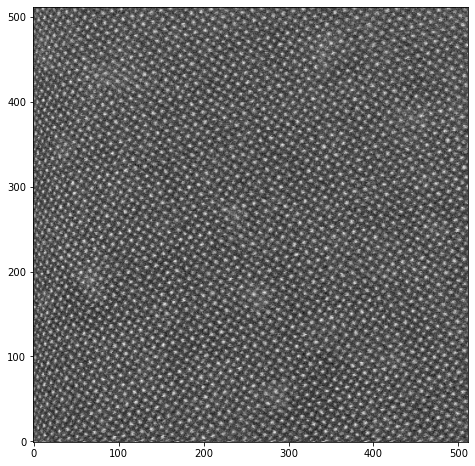

In [ ]:
# Choose file to use (comment out unused one)
Strongflyback = "Recording25 75 4 0 16.npy"
Weakflyback = "20-3D Stack_10.npy"

imgdata = np.load(Strongflyback) 
# imgdata = np.load(Weakflyback)

# Check first frame of the loaded set
plt.figure(figsize=(8,8))
plt.imshow(imgdata[0], cmap = 'gray', origin = 'lower')

print("Data contains {} frames each at {}x{} pixels".format(imgdata.shape[0], imgdata.shape[1], imgdata.shape[2]))

# Temporal analysis (via atom trajectories)

 ## 1) Atom Finding

Run regular atom finding analysis with the pre-trained neural network:

*Beware: Gaussian refinement can add a significant amount of time to the atom finding*

* For atomai version 0.5.xx 

In [ ]:
# load a pre-trained network; select symmetry
model = dcnn.load_torchmodel('cubic')

# Make a prediction without refinement
img_dec, coord = aoi.atomnet.predictor(model, refine=False, logits=False, use_gpu=True).run(imgdata)

# # Make a prediction with refinement. Use ‘d’ argument to define a half-size of a window
# # around each predicted coordinate where refinement is performed (it defaults to 1/3 of NN distance when not specified)
img_dec, coord_r = aoi.atomnet.predictor(model, refine=True, d = 4, logits=False, use_gpu=True).run(imgdata)

/usr/local/lib/python3.6/dist-packages/atomai/atomnet/infer.py:163: UserWarning: The default output of predictor.decode() and predictor.run() is now ```nn_output, coords``` instead of ```nn_input, (nn_output, coords)```
  warnings.warn(warn_msg, UserWarning)


Batch 25/25
25 images were decoded in approximately 48.1863 seconds
Batch 25/25
Refining atomic positions... 

/usr/local/lib/python3.6/dist-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


Done

25 images were decoded in approximately 204.1356 seconds


In [ ]:
# # Optional save:

# np.savez("coordinates_shortflyback",
#          img_dec = img_dec,
#          coord_r = coord_r)

# # Optional save:

# np.savez("coordinates_longflyback",
#          img_dec = img_dec,
#          coord_r = coord_r)

Correcting any outliers

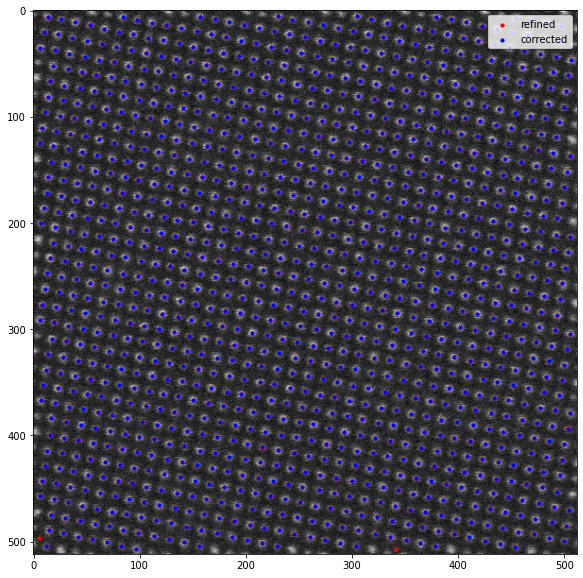

In [ ]:
coord_r_cor, num_fixes = refinementcorrection(coord, coord_r, imgdata, pixthreshold = 1, intensitythresh = 0.2)

k = 0
plt.figure(figsize=(10, 10))
plt.imshow(imgdata[k], cmap='gray'),
plt.scatter(coord_r[k][:, 1], coord_r[k][:, 0], c='r', label='refined', s=10)
plt.scatter(coord_r_cor[k][:, 1], coord_r_cor[k][:, 0], c='b', label='corrected', s=10)
plt.legend(loc='upper right')

# Place this into a dictionary
# coord_dict = {0 : coord_r_cor[0]}
# for ii in range(len(coord_r_cor)):
#   coord_dict_.update({ii : coord_r_cor[ii]})

# Place this into a dictionary AND remove the NaNs!!
coord_dict = {}
for ii in range(len(coord_r_cor)):
  no_nan = coord_r_cor[ii][~np.isnan(coord_r_cor[ii]).any(axis=1)]
  coord_dict.update({ii : no_nan})

In [ ]:
# np.savez("coordinates_shortflyback",
#          coord_dict = coord_dict
#          )

np.savez("coordinates_longflyback",
         coord_dict = coord_dict
         )

In [ ]:
testcoord = np.load("coordinates_shortflyback.npz", allow_pickle = True)
testcoord.files

['coord_dict']

In [ ]:
testdict = testcoord['coord_dict']

In [ ]:
testdict1 = testdict.tolist()

In [ ]:
# coord_r_cor.shape

# test0 = coord_r_cor[0][~np.isnan(coord_r_cor[0]).any(axis=1)]

In [ ]:
# # Place this into a dictionary
# coord_dict = {}
# for ii in range(len(coord_r_cor)):
#   no_nan = coord_r_cor[ii][~np.isnan(coord_r_cor[ii]).any(axis=1)]
#   coord_dict.update({ii : no_nan})

In [ ]:
from google.colab import files
files.upload()

Saving coordinates_shortflyback (1).npz to coordinates_shortflyback (1).npz


{'coordinates_shortflyback (1).npz': b'PK\x03\x04\x14\x00\x00\x00\x00\x00\x00\x00!\x00\\\x97\x0f-\xfd\x01#\x00\xfd\x01#\x00\x0e\x00\x14\x00coord_dict.npy\x01\x00\x10\x00\xfd\x01#\x00\x00\x00\x00\x00\xfd\x01#\x00\x00\x00\x00\x00\x93NUMPY\x01\x00v\x00{\'descr\': \'|O\', \'fortran_order\': False, \'shape\': (), }                                                               \n\x80\x03cnumpy.core.multiarray\n_reconstruct\nq\x00cnumpy\nndarray\nq\x01K\x00\x85q\x02C\x01bq\x03\x87q\x04Rq\x05(K\x01)cnumpy\ndtype\nq\x06X\x02\x00\x00\x00O8q\x07\x89\x88\x87q\x08Rq\t(K\x03X\x01\x00\x00\x00|q\nNNNJ\xff\xff\xff\xffJ\xff\xff\xff\xffK?tq\x0bb\x89]q\x0c}q\r(K\x00h\x00h\x01K\x00\x85q\x0eh\x03\x87q\x0fRq\x10(K\x01M\xea\x0eK\x03\x86q\x11h\x06X\x02\x00\x00\x00f8q\x12\x89\x88\x87q\x13Rq\x14(K\x03X\x01\x00\x00\x00<q\x15NNNJ\xff\xff\xff\xffJ\xff\xff\xff\xffK\x00tq\x16b\x89B\xf0e\x01\x00\x00z\x84\xff\xaa\x1a\x15@>n1\rCB\x1a@\x00\x00\x00\x00\x00\x00\x00\x00t\xed\x90d[t\x16@\x1fp\xc3K\xeb\x04c@\x00\x00\x00\x00\x

In [ ]:
coord_dict = np.load('coordinates_shortflyback (1).npz', allow_pickle = True)['coord_dict'].tolist()
# coord_dict

## 2) Analyze atom fit

Show a selected single atom fit:

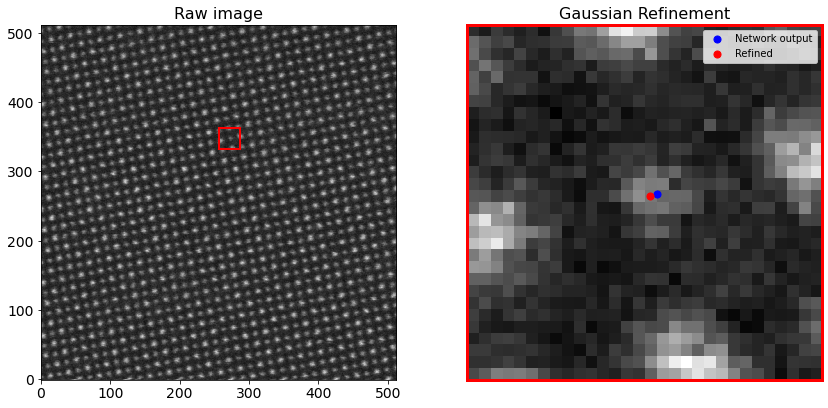

In [ ]:
k = 0             # Choose frame number
ii = 1760        # Choose atom number 
ii = 800
eps = 15          # window halfsize
interpolation = 'None' # Interpolation method of the zoomed ROI

atomfitcheck = coord_r_cor[k][ii] # image relative to CORRECTED version
slice1a, slice1b = int(round(atomfitcheck[0]-eps)), int(round(atomfitcheck[0]+eps))
slice2a, slice2b = int(round(atomfitcheck[1]-eps)), int(round(atomfitcheck[1]+eps))
slicelist0 = np.asarray([slice1a, slice1b, slice2a, slice2b])
slicelist1 = np.asarray([slice1a, slice1b, slice2a, slice2b])

# In case atom is near an edge and the window reaches there, offset things:
for K in range(len(slicelist1)):
  if slicelist1[K] < 0:
    slicelist1[K] = 0
xoff = (slicelist1 - slicelist0)[0] - (slicelist1 - slicelist0)[2]
yoff = (slicelist1 - slicelist0)[1] - (slicelist1 - slicelist0)[3]
diff = coord_r_cor[k][ii] - coord[k][ii]

fig,ax = plt.subplots(1,2,figsize=(14,7))
ax[0].imshow(imgdata[k], cmap = 'gray', origin = 'lower')
ax[0].add_patch(
     patches.Rectangle((atomfitcheck[1]-eps,atomfitcheck[0]-eps),
                       2*eps, 2*eps, color = 'r', lw=2, fill=False))
# ax[1].imshow(imgdata[k][slice1a:slice1b, slice2a:slice2b], interpolation = 'gaussian', cmap = 'gray')
ax[1].imshow(imgdata[k][slicelist1[0]:slicelist1[1], 
                        slicelist1[2]:slicelist1[3]], 
             interpolation = interpolation, cmap = 'gray',
             origin = 'lower')
ax[1].scatter(eps-diff[0]+xoff,eps-diff[1]+yoff, color='b', s = 50, label = 'Network output')
ax[1].scatter(eps+xoff,eps+yoff, color='r', s = 50, label = 'Refined')
ax[1].legend()
ax[1].set_title("Gaussian Refinement", fontsize = 16)

# Border parameters
sidelist = ['left','right','top','bottom']
for ii in range(len(sidelist)):
  ax[1].spines[sidelist[ii]].set_color('red')
  ax[1].spines[sidelist[ii]].set_linewidth(3)
ax[0].tick_params(labelsize=14)
ax[0].set_title('Raw image', fontsize = 16)
plt.setp([ax[1]], xticks=[], yticks=[]);

Plot results:

In [ ]:
img_dec.shape

(25, 512, 512, 1)

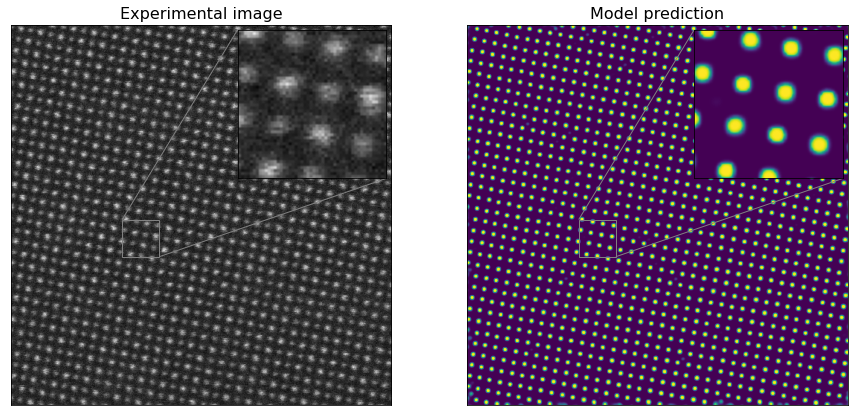

In [ ]:
k = 0  # frame to vizualize

# Parameters for zoomins

zmx1, zmx2 = 300, 400
zmy1, zmy2 = 400, 500 
extent =(0, imgdata.shape[1]*2, 0, imgdata.shape[2]*2)

# do plotting

fig, ax = plt.subplots(1, 2, figsize = (15, 12))
ax[0].imshow(imgdata[k,: , :], extent=extent, cmap = 'gray')
ax[0].set_title('Experimental image', fontsize = 16)
ax[1].imshow(img_dec[k, :, :, 0], extent=extent, Interpolation = 'Gaussian')
ax[1].set_title('Model prediction', fontsize = 16)
axins_00 = zoomed_inset_axes(ax[0], 4, loc=1)
axins_00.imshow(imgdata[k,:,:], extent=extent, cmap='gray')
axins_00.set_xlim(zmx1, zmx2)
axins_00.set_ylim(zmy1, zmy2)
axins_00.set_xticks([])
axins_00.set_yticks([])
mark_inset(ax[0], axins_00, loc1=2, loc2=4, fc="none", ec="0.5")
axins_01 = zoomed_inset_axes(ax[1], 4, loc=1)
axins_01.imshow(img_dec[k, :, :, 0], extent=extent, Interpolation='Gaussian')
axins_01.set_xlim(zmx1, zmx2)
axins_01.set_ylim(zmy1, zmy2)
axins_01.set_xticks([])
axins_01.set_yticks([])
mark_inset(ax[1], axins_01, loc1=2, loc2=4, fc="none", ec="0.5")
for ax_ in fig.axes:
    ax_.set_xticks([])
    ax_.set_yticks([])

## 3) Temporal analysis (atom trajectories)
* Trajectories in coarse grained time steps, i.e., multiple image frames:

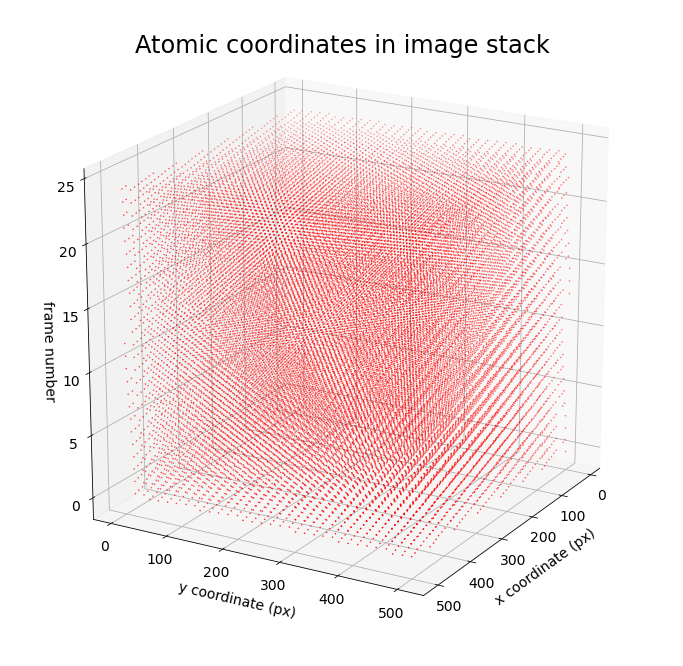

In [ ]:
fig = plt.figure(figsize = (12, 12))
ax = fig.add_subplot(111, projection = '3d')
ax.view_init(20, 30)
ax.set_xlabel('x coordinate (px)', fontsize=14)
ax.set_ylabel('y coordinate (px)', fontsize=14)
ax.set_zlabel('frame number', fontsize=14)
ax.xaxis.labelpad = 10
ax.yaxis.labelpad = 10
ax.zaxis.labelpad = 5
ax.set_title('Atomic coordinates in image stack', fontsize=24)
ax.dist = 10 # use it to zoom in/out
for k in range(coord_r_cor.shape[0]):
    ax.scatter(coord_r_cor[k,:,1], coord_r_cor[k,:,0], k, c='r', s=.3)
ax.tick_params(labelsize=14)

Here we calculate distribution of the nearest neighbor distances for the first frame:
* this is just a **first guess**, we will refine our lattice spacing at a later step

In [ ]:
distances_all = []
checked_coord = []
for i1, c in enumerate(coord_dict[0][:,:2]):
    if np.isnan(c[0]):
      pass
    else:
      d, i2 = spatial.cKDTree(coord_dict[0][:,:2]).query(c, k=2)
      if tuple((i2[-1], i1)) not in checked_coord:
          checked_coord.append(tuple((i1, i2[-1])))
          distances_all.append(d[-1])
nnd_aver = np.mean(distances_all)
nnd_aver

14.206269482423327

and plot it:

(12.22572049901532, 15.62973690245488)

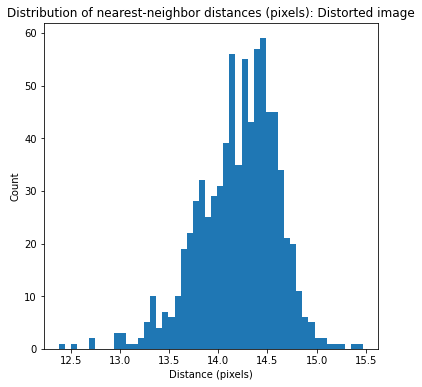

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6,6))
_ = ax.hist(distances_all, bins=50)
ax.set_title('Distribution of nearest-neighbor distances (pixels): Distorted image')
ax.set_xlabel('Distance (pixels)')
ax.set_ylabel('Count');
nndxlim1, nndxlim2 = ax.get_xlim()
nndxlim1, nndxlim2

Select a particular atomic column whose position in time you would like to track.

* Note that the variable $ck$ starts at 0 in top-left of image and proceeds left to right in a raster-like way, similar to how the image is typically scanned. 

(25, 2)

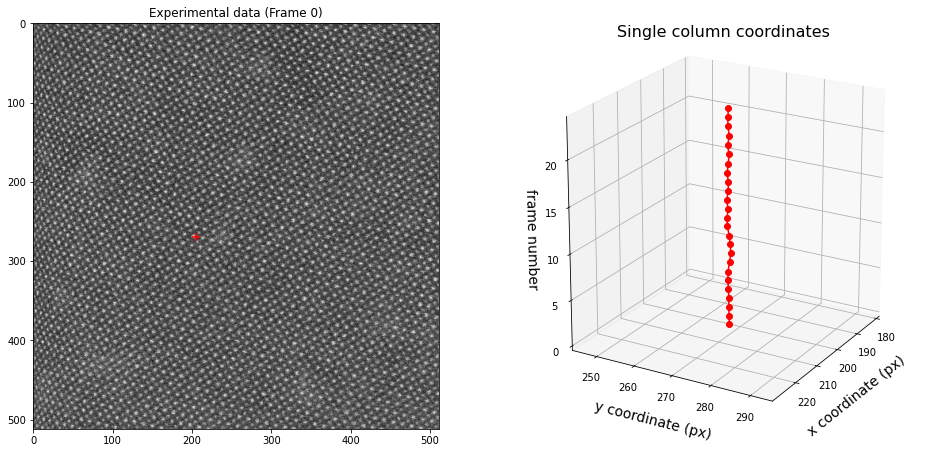

In [ ]:
# Choose index of atom that you would like to track through time
ck = 2000
deltalims = 25

# Extraction of "atom flow"
flow = np.empty((0, 2))
c0 = coord_dict[0][ck,:2]
for k, c in coord_dict.items():
    d, index = spatial.cKDTree(
        c[:,:2]).query(c0, distance_upper_bound=2*nnd_aver)
    if d < 0.3*nnd_aver:
        flow = np.append(flow, [c[index][:2]], axis=0)
        c0 = c[index][:2]

# Plotting results
fig = plt.figure(figsize=(16, 8))
ax1 = fig.add_subplot(121)
ax1.imshow(imgdata[0,:,:], cmap='gray')
ax1.scatter(c0[1], c0[0], c='red', marker='+', s=80)
ax1.set_title('Experimental data (Frame 0)')
ax2 = fig.add_subplot(122, projection = '3d')
ax2.view_init(20, 30)
ax2.set_xlabel('x coordinate (px)', fontsize=14)
ax2.set_ylabel('y coordinate (px)', fontsize=14)
ax2.set_zlabel('frame number', fontsize=14)
ax2.xaxis.labelpad = 10
ax2.yaxis.labelpad =10
ax2.zaxis.labelpad = 5
ax2.set_title('Single column coordinates', fontsize=16)
ax2.dist = 10 # use it to zoom in/out
ax2.plot(flow[:,1], flow[:,0], np.arange(flow.shape[0]), '-o', c='red')
ax2.set_xlim(c0[1]-deltalims, c0[1]+deltalims)
ax2.set_ylim(c0[0]-deltalims, c0[0]+deltalims)
#ax2.set_aspect('equal')
flow.shape

Now extract all the columns and turn *xy* coordinates into a feature vector, that is, for a trajectory of length $l$, the feature vector dimensions are going to be $l\times2$ (for each sample/atomic column). **This may take up to 30 min.**

In [ ]:
all_flows = [] # to store coordinates
all_displ = [] # to store displacements
com = np.empty((0, 2))
# Here we go through each column
for ck in coord_dict[0][:, :2]:
    ck0 = np.copy(ck)
    flow = np.empty((0, 2))
    displacement = []
    # Find a trajectory for each selected column
    for k, c in coord_dict.items():
        distance, index = spatial.cKDTree(
            c[:, :2]).query(ck)
        if distance < 0.3*nnd_aver:
            flow = np.append(flow, c[index][:2]-ck0) #subtrating x0y0 before appending
            displacement.append(distance)
            ck = c[index][:2]
    # If no anomalies, flatten and append the extracted trajectory 
    if len(flow) == 2*len(coord_dict.keys()):
        all_flows.append(flow.flatten())
        all_displ.append(displacement)
        com = np.append(com, ck.reshape(1, -1), axis=0)
# List to ndarray
all_flows_ = np.array(all_flows, np.float)
all_displ = np.array(all_displ, np.float)
# Normalize to 1
all_flows = all_flows/np.amax(all_flows_)

We will work with $xy$ coordinates but the same analysis can be easily performed for displacements $\Delta r$.

## 4) Machine learning on trajectories

Make a PCA scree plot:

[0.35918476622124035, 0.15637765042620694, 0.10419700556486709, 0.06349960284365781, 0.031898376621874835]


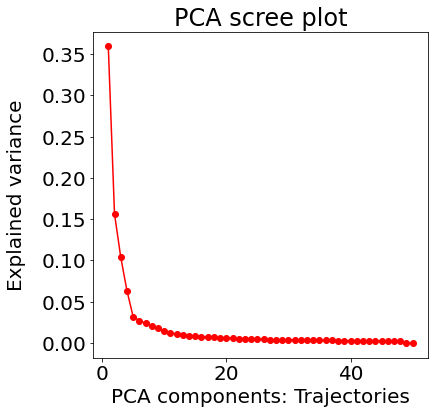

In [ ]:
# Initialize PCA
pca = decomposition.PCA(svd_solver='full')
# "Fit" the data
pca.fit(all_flows)
# Calculate explained variance
explained_var = pca.explained_variance_ratio_
print(list(explained_var[0:5]))
# Plot results
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
ax.plot(np.arange(1, len(explained_var)+1), explained_var, '-o', c = 'red')
ax.set_xlabel('PCA components: Trajectories', fontsize=20)
ax.set_ylabel('Explained variance', fontsize=20, labelpad = 15)
ax.set_title('PCA scree plot', fontsize=24)
ax.tick_params(labelsize = 20)
#ax.set_xlim(0.5, 10.5)

Plot the PCA eigenmodes and the associated loading maps (2D view based on the location of the first column in each trajectory)

NUMBER OF COMPONENTS: 6


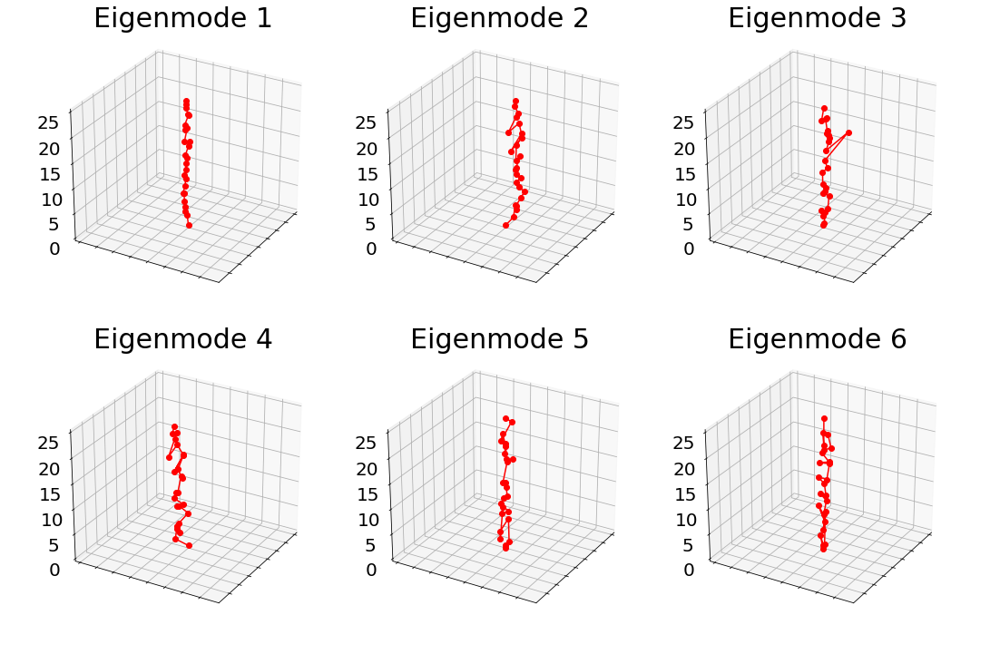

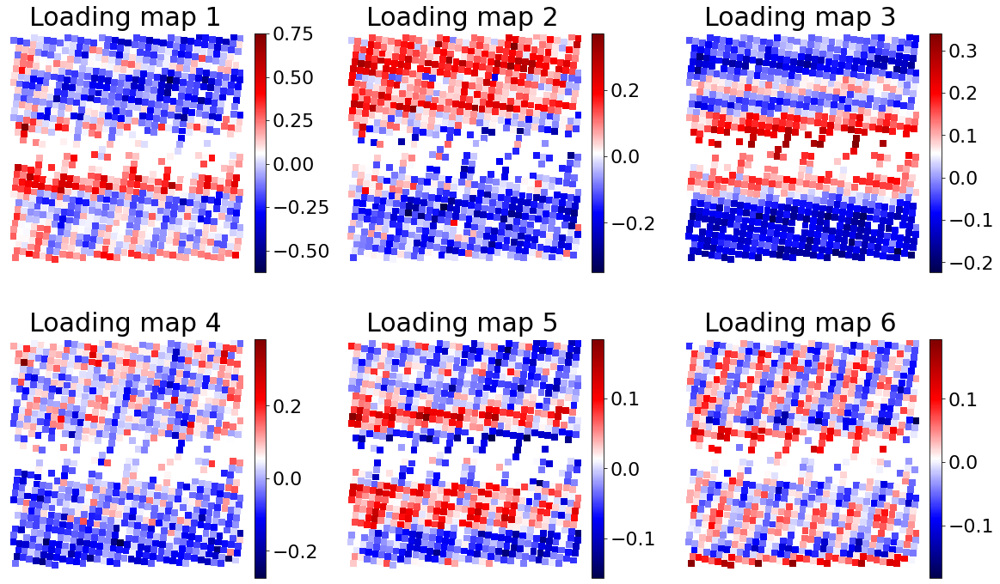

In [ ]:
nc = 6 # specify number of components
img_w, img_h = imgdata.shape[1:3]

# pca transformation
pca = decomposition.PCA(n_components=nc)
all_flows_t = pca.fit_transform(all_flows)
components = pca.components_
# components = components.reshape(nc, len(coord.keys()), 2)
components = components.reshape(nc, len(coord_dict), 2)

# Plot
HideXY = True
cols = 3
rows = int(np.ceil(float(nc/cols)))
print('NUMBER OF COMPONENTS: ' + str(nc))
gs1 = gridspec.GridSpec(rows, cols, wspace = -0.1, hspace = 0)
fig1 = plt.figure(figsize=(6.5*cols, 6.5*rows)) 
# Plotting eigenmodes
for i in range(nc):
    ax1 = fig1.add_subplot(gs1[i], projection='3d')
    ax1.view_init(30, 30)
    # ax1.set_xlabel('x coordinate (a.u.)', fontsize=8)
    # ax1.set_ylabel('y coordinate (a.u.)', fontsize=8)
    # ax1.set_zlabel('frame number', fontsize=8)
    ax1.tick_params(axis = 'x', pad=0, labelsize=6)
    ax1.tick_params(axis = 'y', pad=0, labelsize=6, labelrotation=45)
    ax1.tick_params(axis = 'z', pad=10, labelsize=20)
    ax1.xaxis.labelpad=10
    ax1.yaxis.labelpad=10
    ax1.zaxis.labelpad=5
    ax1.set_title('Eigenmode {}'.format(i+1), fontsize=30)
    ax1.dist=12 # use it to zoom in/out
    ax1.plot(components[i][:, 1], components[i][:, 0],
            #  np.arange(len(coord.keys())), '-o', c='red')
            np.arange(len(coord_dict)), '-o', c='red')
    ax1.set_xlim(np.mean(components)-1, np.mean(components)+1)
    ax1.set_ylim(np.mean(components)-1, np.mean(components)+1)
    ax1.set_zlim(0,25)
    # Hide the X and Y axes, it doesn't mean much
    if HideXY == True:
      ax1.axes.xaxis.set_ticklabels([])
      ax1.axes.yaxis.set_ticklabels([])
    # ax1.set_aspect('equal')
# Plotting loading maps    
gs2 = gridspec.GridSpec(rows, cols, wspace = 0.3)
fig2 = plt.figure(figsize=(6.5*cols, 6*rows) ) 
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im = ax2.scatter(com[:,1], com[:,0], c=all_flows_t[:,i],
                cmap='seismic', marker='s', s=48)
    ax2.set_xlim(0, img_w)
    ax2.set_ylim(img_h, 0)
    ax2.set_aspect('equal')
    ax2.axis('off')
    ax2.set_title('Loading map {}'.format(i+1), fontsize=30, pad = 10)
    cbar = plt.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)
    cbar.ax.tick_params(labelsize = 22)
    # plt.colorbar(im0,fraction=0.046, pad=0.04)


# fig2.subplots_adjust(right=0.8)
# cbar_ax = fig2.add_axes([0.85, 0.15, 0.02, 0.7])
# fig2.colorbar(im, cax=cbar_ax)

## 5) Unit cell trajectories (Voronoi)

In [ ]:
coord_dict[0].shape

(3818, 3)

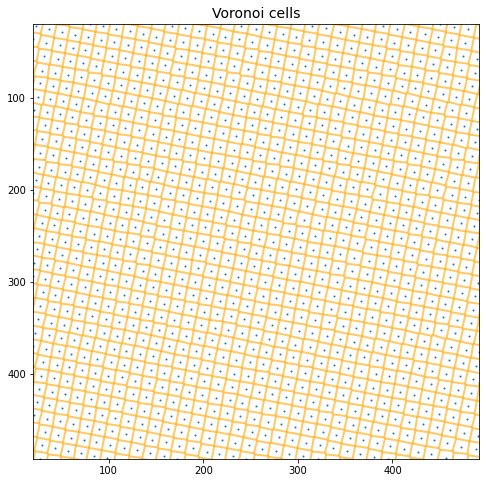

In [ ]:
# concat_ = np.concatenate((coord_dict[0][:,1][:, None], coord_dict[0][:,0][:, None]), axis=1)
# concat = concat_[~np.isnan(concat_).any(axis=1)]
# vor = Voronoi(concat)

vor = Voronoi(np.concatenate((coord_dict[0][:,1][:, None], coord_dict[0][:,0][:, None]), axis=1))

plt.rcParams["figure.figsize"] = [8,8]
voronoi_plot_2d(vor, show_vertices=False, line_colors='orange',
                line_width=2, line_alpha=0.6, point_size=2)
plt.xlim(20, img_w-20)
plt.ylim(img_h-20, 20)
plt.title('Voronoi cells', fontsize = 14)
plt.show()

# Return figure size to default values
plt.rcParams["figure.figsize"] = [8, 5.5]

We can calculate each cell area via Shoelace formula:

In [ ]:
def CellArea(x,y):
    return 0.5*np.abs(np.dot(x, np.roll(y, 1))
                      -np.dot(y, np.roll(x, 1)))

We will use this formula to calculate Voronoi cells areas for every frame:

In [ ]:
d_edge = 20 # ignore cells within this distance to the edge
coord_area_d = {}
# Run over a coordnate set for each frame
for idx, icoord in enumerate(coord_dict.values()):
    cell_area_all = []
    com_ = np.empty((0, 2))
    dictionary = OrderedDict()
    # Obtain Voronoi cells and their parameters
    concat = np.concatenate((icoord[:,1][:, None],
                              icoord[:,0][:, None]), axis=1)
    # concat = concat_[~np.isnan(concat_).any(axis=1)]
    vor = Voronoi(concat)
    vert = vor.vertices
    regions = vor.regions
    points = vor.points
    point_regions = vor.point_region
    
    # Get all the cell areas for the current frame
    cell_area = []
    for ipoint, iregion in zip(points, point_regions):   
        r = regions[iregion]
        if len(r) > 0 and -1 not in r:
            cell_co = np.array([vert[_r] for _r in r])
            # Getting rid of the annoing edge effects in Voronoi cells
            if 1 not in [len([c for c in cell_co[:,0] if c>img_w-d_edge or c<d_edge])>0, 
                         len([c for c in cell_co[:,1] if c>img_h-d_edge or c<d_edge])>0]:
                cell_area = CellArea(cell_co[:, 0], cell_co[:, 1])
                cell_area_all.append(cell_area)
                com_ = np.append(com_,
                    ipoint.reshape(1, -1), axis = 0)
    # Store the extracted data in a dictionary
    dictionary['coord'] = com_
    dictionary['area'] = cell_area_all         
    coord_area_d[idx] = dictionary

Now extract a "trajectory" for each Voronoi cell and turn those trajectories into a feature vector:

In [ ]:
all_areas = [] # to store Voronoi cells areas
com_ = np.empty((0, 2))
coord0, area0 = coord_area_d[0].values()
# Here we go through each column in the first frame
for ck, ak in zip(coord0, area0):
    ak0 = np.copy(ak)
    area = []
    # Find a "trajectory" of Voronoi cell areas for each column
    for k, v in coord_area_d.items():
        distance, index = spatial.cKDTree(v['coord']).query(ck)
        if distance < 0.3*nnd_aver:
            area.append(v['area'][index]-ak0)
            ck = v['coord'][index]
    if len(area) == len(coord_dict.keys()):
        all_areas.append(area)
        com_ = np.append(com_, ck.reshape(1, -1), axis=0)
# List to ndarray
all_areas = np.array(all_areas, np.float)
# Normalize to 1
all_areas = all_areas/np.amax(all_areas)

We now do PCA analysis, same as before. Start with a scree plot:

Trajectory PCA components:  [0.35918476622124035, 0.15637765042620694, 0.10419700556486709, 0.06349960284365781, 0.031898376621874835]
Voronoi PCA components:  [0.5590198836353224, 0.08660946855039495, 0.05919495123557828, 0.024855136872853907, 0.020733453886968706]


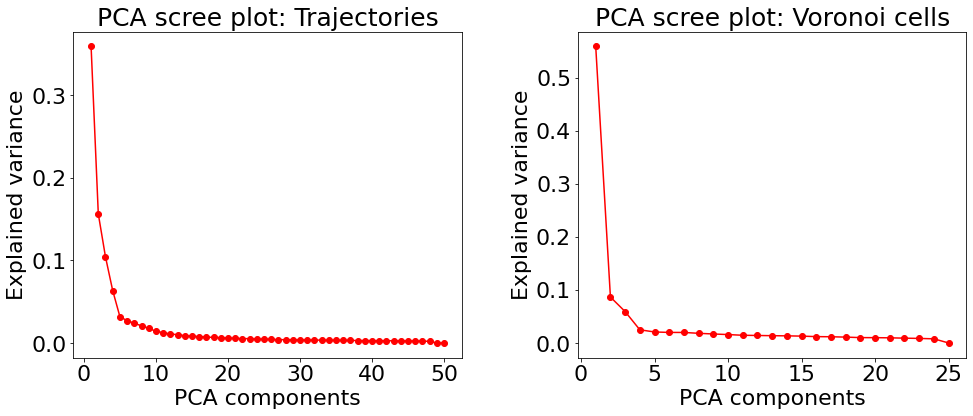

In [ ]:
# Initialize PCA
pca = decomposition.PCA(svd_solver='full')

# "Fit" the data (voronoi)
pca.fit(all_areas)
# Calculate explained variance
explained_var_vor = pca.explained_variance_ratio_

# "Fit" the data (trajectories)
pca.fit(all_flows)
# Calculate explained variance
explained_var_flows = pca.explained_variance_ratio_

print("Trajectory PCA components: ", list(explained_var_flows[0:5]))
print("Voronoi PCA components: ", list(explained_var_vor[0:5]))

# Plot results
plt.figure(figsize=(16, 6))
gs = gridspec.GridSpec(1,2,wspace = 0.3)
ax0, ax1 = plt.subplot(gs[0]), plt.subplot(gs[1])
ax0.plot(np.arange(1, len(explained_var_flows)+1), explained_var_flows, '-o', c = 'red')
ax0.set_xlabel('PCA components', fontsize=22)
ax0.set_ylabel('Explained variance', fontsize=22)
ax0.set_title('PCA scree plot: Trajectories', fontsize=25)
ax0.tick_params(labelsize = 22)
ax0.set_xticks(np.arange(0,51,10))

ax1.plot(np.arange(1, len(explained_var_vor)+1), explained_var_vor, '-o', c = 'red')
ax1.set_xlabel('PCA components', fontsize=22)
ax1.set_ylabel('Explained variance', fontsize=22)
ax1.set_title('PCA scree plot: Voronoi cells', fontsize=25)
ax1.tick_params(labelsize = 22)
ax1.set_xticks(np.arange(0,26,5))

# axs = [ax0, ax1]
# for n, ax in enumerate(axs): 
#     ax.text(-0.13, 1.1, "{})".format(string.ascii_lowercase[n]), transform=ax.transAxes, 
#             size=20, weight='bold')

Plot eigenmodes and the corresponding loading maps:

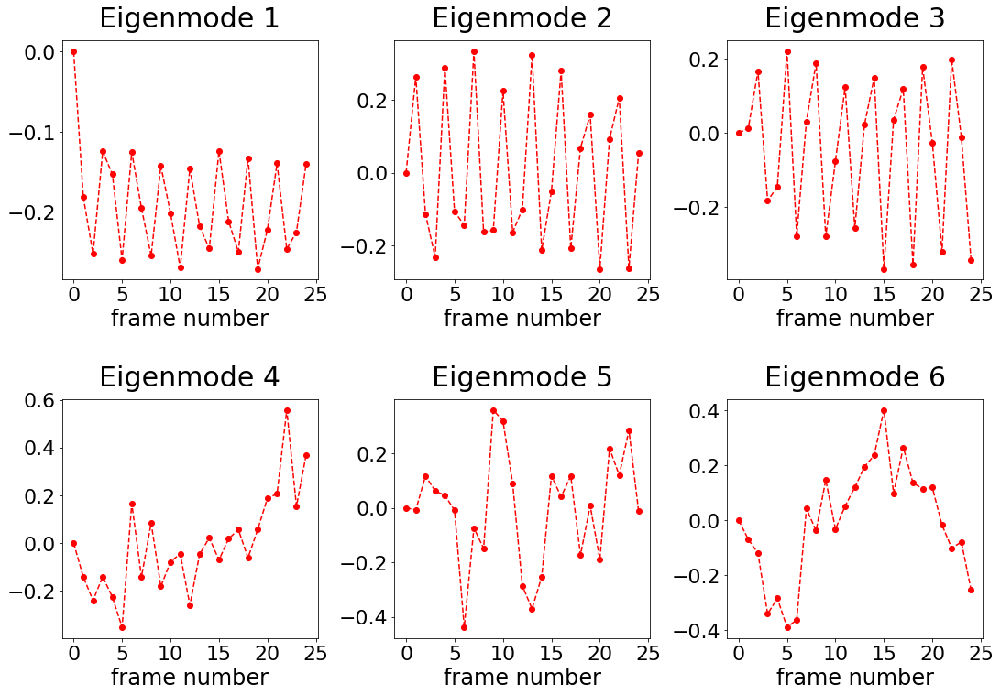

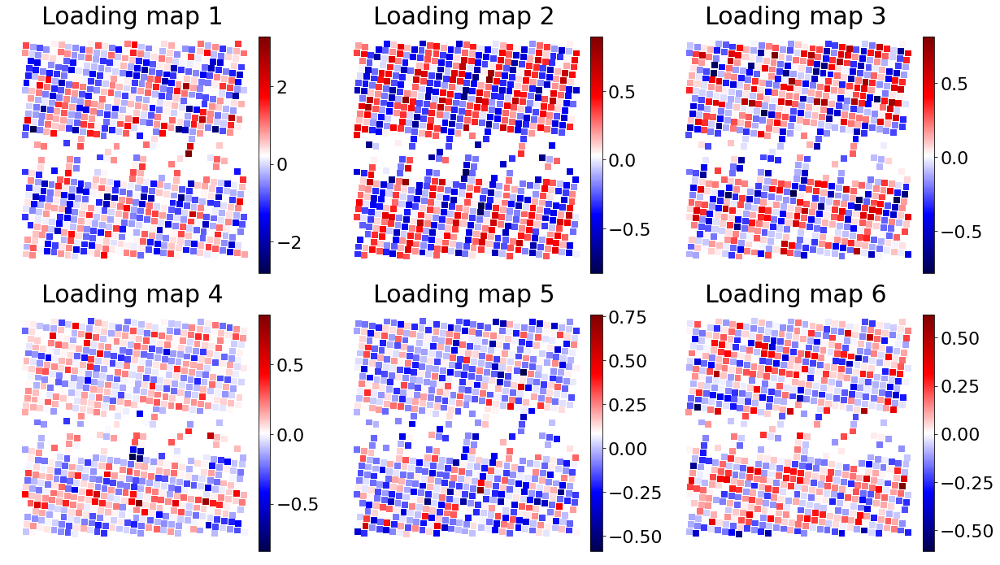

In [ ]:
nc = 6 # specify number of components

HideXY = True
# img_w, img_h = img_dec.shape[1:3]
img_w, img_h = imgdata.shape[1:3]
# pca transformation
pca = decomposition.PCA(n_components=nc)
all_areas_t = pca.fit_transform(all_areas)
components = pca.components_
components = components.reshape(nc, len(coord_area_d.keys()))

#Plot
gs1 = gridspec.GridSpec(rows, cols, hspace = 0.5, wspace = 0.3)
fig1 = plt.figure(figsize=(6*cols, 6*rows)) 
# Plotting eigenmodes
for i in range(nc):
    ax1 = fig1.add_subplot(gs1[i])
    ax1.plot(components[i, :], '--o', c = 'red' )
    ax1.set_xlabel('frame number', fontsize = 24)
    # ax1.set_ylabel('area (a.u.)')
    ax1.set_title('Eigenmode {}'.format(i+1), fontsize = 30, pad = 15)
    ax1.tick_params(labelsize=22)
    ax1.set_xticks(np.arange(0,26,5))

# Plotting loading maps
gs2 = gridspec.GridSpec(rows, cols, wspace = 0.15, hspace = 0.1)
fig2 = plt.figure(figsize=(7*cols, 6*rows) ) 
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im = ax2.scatter(com_[:,0], com_[:,1], c=all_areas_t[:,i],
                cmap='seismic', marker='s', s=48)
    ax2.set_xlim(0, img_w)
    ax2.set_ylim(img_h, 0)
    ax2.set_aspect('equal')
    ax2.axis('off')
    ax2.set_title('Loading map {}'.format(i+1), fontsize=30, pad = 0)
    cbar = plt.colorbar(im, ax=ax2, fraction=0.041, pad=0.0)
    cbar.ax.tick_params(labelsize = 22)

# Spatial analysis

For strong distortion, we use an atom indexing approach to label each atom (such that it can be compared to a corresponding 'ideal' atom).

* Generates indexed ideal lattice
* Generates indexed distorted lattice

 ## Atom Finding already done, proceed to indexing

In [ ]:
# download the coordinates
!gdown https://drive.google.com/uc?id=1JdVtvSlaTadBGXxssKug0RiFrPrMQ2Y6 # atom finding coords of shortflyback dataset

In [ ]:
# load the coordinates
coord_dict = np.load('coordinates_shortflyback.npz', allow_pickle=True)['coord_dict'].tolist()

## First frame for parameter tweak
* Use `d_nn` value best fit to the first frame for indexing **Default is 4**
* Change `seed_point` to choose where indexing begins. **Default is the center** of the image; i.e., [256,256] for a 512x512 image

In [ ]:
k=0  # Frame select
seed_point = [int(x/2) for x in imgdata[k].shape]
d_nn = 4

# Note we will use the coord_dict obtained in previous steps for this indexing

atom_ind = Atom_Indexing(imgdata[k],coord_dict[k][:,:2],seed_point) # requires image, coordinates, and seed point in [x,y]
atom_ind.neighbors(4) # set the number of nearest neighbors there should be
atom_ind.seed_props()

d_nn = 4

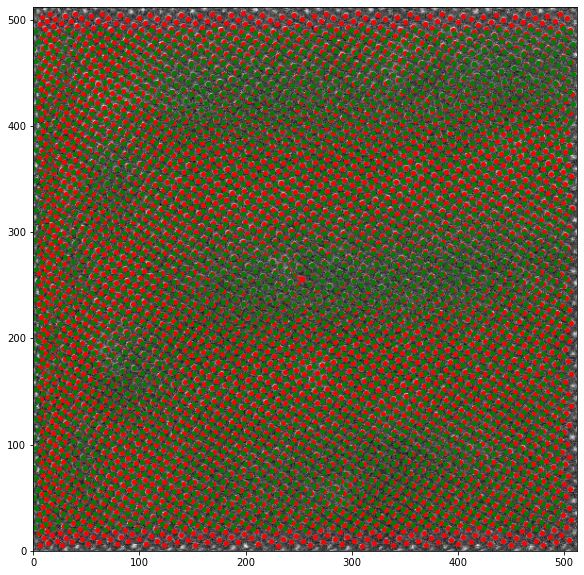

In [ ]:
atom_ind.crawl(d_nn = d_nn)
atom_ind.perfect_lattice()
atom_ind.plot_perfect()

## Extract ideal lattice 

In [ ]:
x1,x2 = atom_ind.df_lattice['ii'].min(), atom_ind.df_lattice['jj'].min()
y1,y2 = atom_ind.df_lattice['ii'].max(), atom_ind.df_lattice['jj'].max()

minval = np.asarray([x1,x2]).min()
maxval = np.asarray([y1,y2]).max()

tot = np.abs(maxval) + np.abs(minval)
# print(tot)

# All we want is enough elements in the array to cover the full range of ii and jj's.

ideal_lat = np.full((tot,tot,2), np.nan)
distort_lat = np.full((tot,tot,2), np.nan)

for ii in range(x1,y1+1):
  for jj in range(x2,y2+1):
    pos = atom_ind.df_lattice[(atom_ind.df_lattice['ii']==ii) & (atom_ind.df_lattice['jj']==jj)]
    if len(pos) == 0:  # If the index in pos is EMPTY, there's nothing to fill the array
      pass
    else:
      ideal_lat[ii,jj,0] = pos['x_perfect'].tolist()[0]
      ideal_lat[ii,jj,1] = pos['y_perfect'].tolist()[0]
      distort_lat[ii,jj,0] = pos['x'].tolist()[0]
      distort_lat[ii,jj,1] = pos['y'].tolist()[0]

* Displacements

In [ ]:
# Calculate displacements

displacements = np.full_like(distort_lat, np.nan)
displacements_scalar = np.full((displacements.shape[0], displacements.shape[1], 1), np.nan)

for ii in range(displacements.shape[0]):
  for jj in range(displacements.shape[1]):
    displacements[ii,jj] = distort_lat[ii,jj] - ideal_lat[ii,jj]
    displacements_scalar[ii,jj] = (displacements[ii,jj][0]**2 + displacements[ii,jj][1]**2)**(1/2)

* There are some elements of the ideal lattice that need to be populated (currently NaN) so we can take their difference from the distorted coordinates.
* We just need to find the vector

In [ ]:
ii,jj = 0,0
ideal_vec = ideal_lat[ii,jj] - ideal_lat[ii,jj+1]
ideal_vec

array([ 6.96428166, -4.16741869])

[  2.21923626 405.56700008]
-4.745045393089214 409.7344187712375


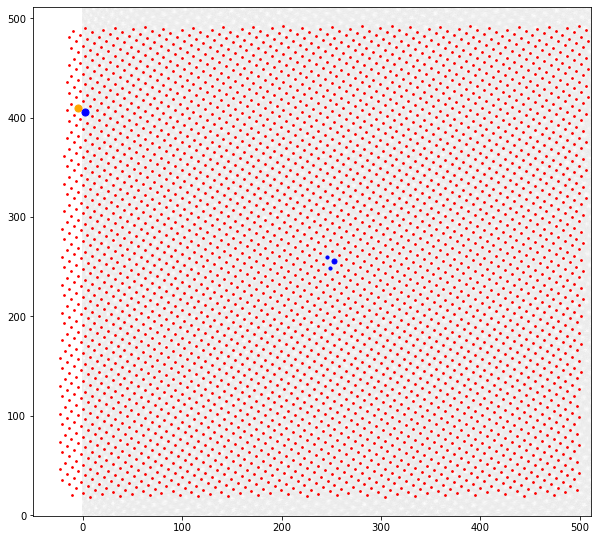

In [ ]:
ii,jj = 0, 0  # center

plt.figure(figsize=(10,10))
plt.imshow(imgdata[k], cmap = 'gray', origin = 'lower', alpha = 0.1)
plt.scatter(ideal_lat[:,:,0], ideal_lat[:,:,1], c='r', s=3)
plt.scatter(ideal_lat[ii,jj,0], ideal_lat[ii,jj,1], c='b', s = 25)
plt.scatter(ideal_lat[ii,jj+1,0], ideal_lat[ii,jj+1,1], c='b', s = 10)
plt.scatter(ideal_lat[ii+1,jj,0], ideal_lat[ii+1,jj,1], c='b', s = 10)

k1,k2 = 0, 36
plt.scatter(ideal_lat[k1,k2,0], ideal_lat[k1,k2,1], c='b', s = 50)
plt.scatter(ideal_lat[k1,k2,0] - ideal_vec[0], ideal_lat[k1,k2,1] - ideal_vec[1], c='orange', s = 50)
print(ideal_lat[k1,k2])
print(ideal_lat[k1,k2,0]- ideal_vec[0], ideal_lat[k1,k2,1]- ideal_vec[1])

## Fine-Tune ideal lattice

In [ ]:
# Find atom closest to seed point:

atomcoords = distort_lat.reshape((distort_lat.shape[0]*distort_lat.shape[1],2))
atomdistances = np.zeros((len(atomcoords)))
for ii in range(len(atomcoords)):
  atomdistances[ii] = np.sqrt((atomcoords[ii,0] - seed_point[0])**2 + (atomcoords[ii,1] - seed_point[1])**2)
seed_point_actual = atomcoords[np.nanargmin(atomdistances)][1], atomcoords[np.nanargmin(atomdistances)][0]

seed_point_actual

(255.53992706526935, 252.93337593994778)

In [ ]:
guess = (0,0) # all frames keep the same 0,0

optimized_params_a, optimized_params_b = minimize(minimize_distance, guess, args=(distort_lat, ideal_lat, seed_point_actual), method = 'nelder-mead')['x']

In [ ]:
## Bestfit ideal

bestfit_ideal = modify_lattice(seed_point_actual, ideal_lat, optimized_params_a, optimized_params_b)

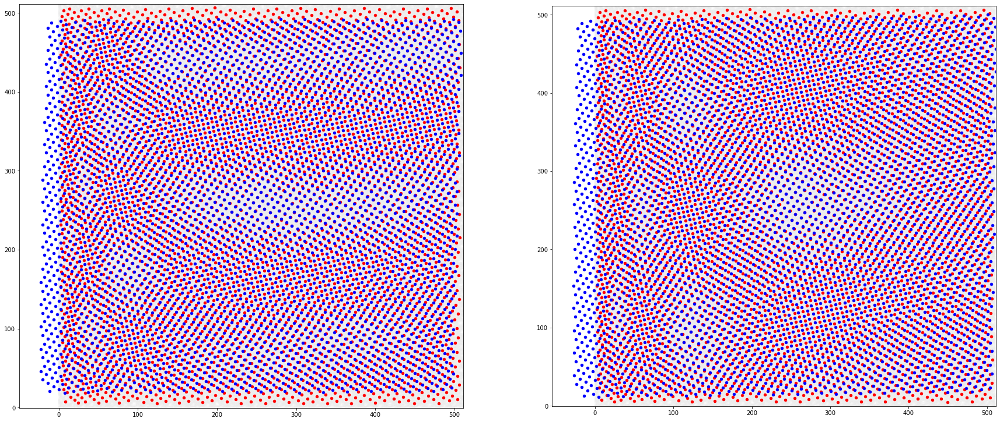

In [ ]:
# bestfit_ideal = modify_lattice(seed_point_actual, ideal_lat, -1.4, 0.06)   # MANUAL PLAY

k = 0

fig,ax = plt.subplots(1,2,figsize=(30,15))

ax[0].imshow(imgdata[k], cmap = 'gray', origin = 'lower', alpha = 0.1)       
ax[0].scatter(distort_lat[:,:,0], distort_lat[:,:,1], color = 'red', s=20) 
ax[0].scatter(ideal_lat[:,:,0], ideal_lat[:,:,1], color = 'blue', s=20) 

ax[1].imshow(imgdata[k], cmap = 'gray', origin = 'lower', alpha = 0.1)       
ax[1].scatter(distort_lat[:,:,0], distort_lat[:,:,1], color = 'red', s=20) 
ax[1].scatter(bestfit_ideal[:,:,0], bestfit_ideal[:,:,1], color = 'blue', s=20) 

NameError: ignored

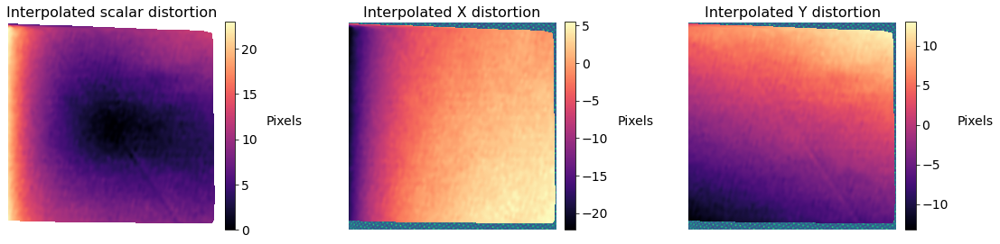

In [ ]:
displacement_array = bestfit_ideal - distort_lat

try:
  zz, xx, yy = displacement_interp(imgdata[0], distort_lat, bestfit_ideal, nnd_aver, [optimized_params_a, optimized_params_b], units = 'pixels', colormap = 'magma');
except NameError:
  zz, xx, yy = displacement_interp(imgdata[0], distort_lat, bestfit_ideal, 7.72, [optimized_params_a, optimized_params_b], units = 'pixels', colormap = 'magma');

## All frames

In [ ]:
seed_point = [int(x/2) for x in imgdata[k].shape]
d_nn = 4

SpatialDistortionAll = {}
TunedIdealAll = {}
DistortAll = {}
Optim_parameters = np.zeros((len(imgdata), 2))

for k in tqdm(range(len(imgdata))):

  atom_ind = Atom_Indexing(imgdata[k],coord_dict[k][:,:2],seed_point) # requires image, coordinates, and seed point in [x,y]
  atom_ind.neighbors(4) # set the number of nearest neighbors there should be
  atom_ind.seed_props()
  atom_ind.crawl(d_nn = d_nn)
  atom_ind.perfect_lattice()

  SpatialDistortionAll.update({k : atom_ind.df_lattice})

  x1,x2 = SpatialDistortionAll[0]['ii'].min(), SpatialDistortionAll[0]['jj'].min()
  y1,y2 = SpatialDistortionAll[0]['ii'].max(), SpatialDistortionAll[0]['jj'].max()
  minval = np.asarray([x1,x2]).min()
  maxval = np.asarray([y1,y2]).max()
  tot = np.abs(maxval) + np.abs(minval)
  ideal_lat = np.full((tot,tot,2), np.nan)
  distort_lat = np.full((tot,tot,2), np.nan)
  for ii in range(x1,y1+1):
    for jj in range(x2,y2+1):
      pos = atom_ind.df_lattice[(atom_ind.df_lattice['ii']==ii) & (atom_ind.df_lattice['jj']==jj)]
      if len(pos) == 0:  # If the index in pos is EMPTY, there's nothing to fill the array
        pass
      else:
        ideal_lat[ii,jj,0] = pos['x_perfect'].tolist()[0]
        ideal_lat[ii,jj,1] = pos['y_perfect'].tolist()[0]
        distort_lat[ii,jj,0] = pos['x'].tolist()[0]
        distort_lat[ii,jj,1] = pos['y'].tolist()[0]
  
  atomcoords = distort_lat.reshape((distort_lat.shape[0]*distort_lat.shape[1],2))
  atomdistances = np.zeros((len(atomcoords)))
  for ii in range(len(atomcoords)):
    atomdistances[ii] = np.sqrt((atomcoords[ii,0] - seed_point[0])**2 + (atomcoords[ii,1] - seed_point[1])**2)
  seed_point_actual = atomcoords[np.nanargmin(atomdistances)][1], atomcoords[np.nanargmin(atomdistances)][0]
  guess = (0,0)
  optimized_params_a, optimized_params_b = minimize(minimize_distance, guess, args=(distort_lat, ideal_lat, seed_point_actual), method = 'nelder-mead')['x']
  bestfit_ideal = modify_lattice(seed_point_actual, ideal_lat, optimized_params_a, optimized_params_b)

  Optim_parameters[k] = [optimized_params_a, optimized_params_b]
  TunedIdealAll.update({k : bestfit_ideal})
  DistortAll.update({k : distort_lat})

100%|███████████████████████████████████████████████████████████████████████████████| 25/25 [1:02:48<00:00, 150.73s/it]


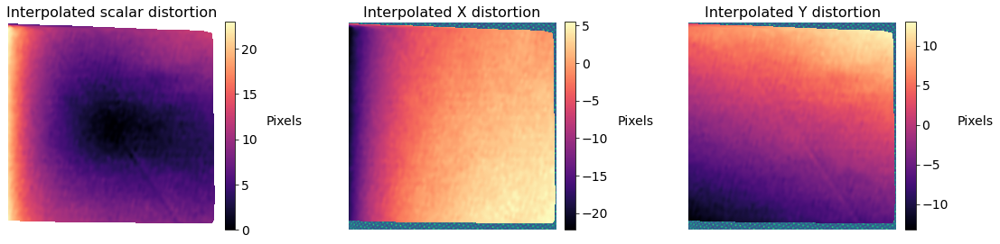

In [ ]:
k = 0
zz, xx, yy = displacement_interp(imgdata[k], DistortAll[k], TunedIdealAll[k], 7.72, [Optim_parameters[k][0], Optim_parameters[k][1]], units = 'pixels', colormap = 'magma');

# Gaussian Processes

* What we just saw above were the raw interpolations. We will instead use GP to do the interpolations.
* LENGTH SCALE is quite important here, since it is likely spread across the image, not very localized distortions - these would indicate physical distortions in the lattice most likely

In [ ]:
TunedIdealAll[0].shape

(84, 84, 2)

In [ ]:
# nnd_aver = 7.72 # Just setting this manually, it was calculated back in section 1, so in general we will already have this.

In [ ]:
np.savez("Checkpointv2_02.npz", 
         SpatialDistortionAll = SpatialDistortionAll,
         Optim_parameters = Optim_parameters,
         TunedIdealAll = TunedIdealAll,
         DistortAll = DistortAll,
         nnd_aver = nnd_aver)

In [ ]:
checkpointload = np.load('Checkpointv2_02.npz', allow_pickle=True)

SpatialDistortionAll = checkpointload['SpatialDistortionAll'].tolist()
Optim_params = checkpointload['Optim_parameters']
TunedIdealAll = checkpointload['TunedIdealAll'].tolist()
DistortAll = checkpointload['DistortAll'].tolist()
nnd_aver = checkpointload['nnd_aver']

* Displacements

In [ ]:
DistortAll

(84, 84, 2)

In [ ]:
# SpatialDistortionAll = np.copy(FrameDistortion).tolist()

# k = 0

# xx,yy,x_dist,y_dist = SpatialDistortionAll[k]['x'], SpatialDistortionAll[k]['y'], SpatialDistortionAll[k]['xr'], SpatialDistortionAll[k]['yr']

In [ ]:
# _,_,x_distortion = contour_plot2(yy,xx,x_dist,npoints = 100, show=False)
# _,_,y_distortion = contour_plot2(yy,xx,y_dist,npoints = 100, show=False)

In [ ]:
TunedIdealAll[0].shape

(84, 84, 2)

In [ ]:
# # Calculate the difference
stacksize = len(DistortAll)

distortion_array_all = np.zeros((stacksize, TunedIdealAll[0].shape[0], TunedIdealAll[0].shape[1], TunedIdealAll[0].shape[2]))
scalefactor_all = np.zeros((stacksize))
for ii in range(stacksize):
  distortion_array_all[ii] = TunedIdealAll[ii] - DistortAll[ii]
  scalefactor_all[ii] = (nnd_aver)*(1+Optim_params[ii][1])  # The new lattice constant. Recall that index [1] in opt param all is the length param, while [0] is the angle

In [ ]:
# call the arrays to be cleaned
distortedcoordsall = DistortAll
distortionarrayall = distortion_array_all

distcordall_list = []
distortionall_list = []
for s in range(stacksize):
  distcordall_list += [distortedcoordsall[s]]
  distortionall_list += [distortionarrayall[s]]

# Reshape
for ss in range(stacksize):
  distcordall_list[ss] = np.reshape(distcordall_list[ss],     (distortedcoordsall[ss].shape[0]*distortedcoordsall[ss].shape[1],distortedcoordsall[ss].shape[2]))
  distortionall_list[ss] = np.reshape(distortionall_list[ss], (distortion_array_all[ss].shape[0]*distortion_array_all[ss].shape[1],distortion_array_all[ss].shape[2]))

# remove nans (see which has more nan in it and remove the larger from both)
for sss in range(stacksize):
  distcordall_list[sss] = distcordall_list[sss][~np.isnan(distortionall_list[sss])]
  distortionall_list[sss] = distortionall_list[sss][~np.isnan(distortionall_list[sss])]

# Reshape back
for ssss in range(stacksize):
  distcordall_list[ssss] = np.reshape(distcordall_list[ssss], (int(distcordall_list[ssss].shape[0]/2),2))
  distortionall_list[ssss] = np.reshape(distortionall_list[ssss], (int(distortionall_list[ssss].shape[0]/2),2))

In [ ]:
atoms_xy_list = []
delta_xy_list = []
delta_xy_scaled_list = []

for s in range(stacksize):
  atoms_xy_list += [distcordall_list[s]]
  delta_xy_list += [distortionall_list[s]]
  delta_xy_scaled_list += [distortionall_list[s]/scalefactor_all[s]]   # in terms of lattice constants...

In [ ]:
# Define GPP inputs and outputs
X_list = []
y1_list = []
y2_list = []
for s in range(stacksize):
  X_list += [atoms_xy_list[s]]
  # y1_list += [delta_xy_list[s][:, 0]]
  # y2_list += [delta_xy_list[s][:, 1]]
  y1_list += [delta_xy_scaled_list[s][:, 0]]
  y2_list += [delta_xy_scaled_list[s][:, 1]]

# Normalize all outputs  
# --> Looks like it works (gives no error) WITHOUT normalizing!
# HOWEVER, some strange issues crop up. Let's normalize anyway, we can undo it afterwards
for ss in range(stacksize):
  y1_list[ss] = (y1_list[ss] - np.min(y1_list[ss])) / np.ptp(y1_list[ss])
  y2_list[ss] = (y2_list[ss] - np.min(y2_list[ss])) / np.ptp(y2_list[ss])

 <font color = 'crimson'>**Warning**</font>! 
**This cell can may take a long time (~hours) if # epochs on the order of 500**

(Also depends on number of atom columns)

Also be sure to **be using the GPU!** 

Those time estimates are based on GPU. CPU will be probably tens to hundreds of times slower

In [ ]:
# Final cell
%%time
epochs = 150 # ~5 epochs for testing'  Currently takes 50 minutes to run (150 epochs, 25 frames, short flyback dataset)

# Store all results in lists
mean1_list = []
mean2_list = []
sd1_list = []
sd2_list = []
loss1_list = []
loss2_list = []
model1_list = []
model2_list = []

for ii in range(stacksize):  # do GP on ALL FRAMES
# for ii in range(0,2):           # do GP on selected frame(s) only. For testing
  
  mean1_list += [np.zeros((y1_list[ii].shape))]
  sd1_list += [np.zeros((y1_list[ii].shape))]
  mean2_list += [np.zeros((y2_list[ii].shape))]
  sd2_list += [np.zeros((y2_list[ii].shape))]
  loss1_list += [np.zeros((y1_list[ii].shape))]
  loss2_list += [np.zeros((y2_list[ii].shape))]
  model1_list += [np.zeros((y1_list[ii].shape))]
  model2_list += [np.zeros((y2_list[ii].shape))]

  model1_list[ii], mean1_list[ii], sd1_list[ii], loss1_list[ii] = GP_Regressor_showloss(X_list[ii], y1_list[ii], epochs = epochs)
  model2_list[ii], mean2_list[ii], sd2_list[ii], loss2_list[ii] = GP_Regressor_showloss(X_list[ii], y2_list[ii], epochs = epochs)
  print('\rFrame {} / {}'.format(ii+1, stacksize))

Frame 1 / 25
Frame 2 / 25
Frame 3 / 25
Iteration 4 / 5

Fix the scaling

In [ ]:
for ii in range(stacksize):
  # Normalize [0,1]
  mean1_list[ii] = (mean1_list[ii] - np.min(mean1_list[ii])) / (np.ptp(mean1_list[ii]))
  mean2_list[ii] = (mean2_list[ii] - np.min(mean2_list[ii])) / (np.ptp(mean2_list[ii]))
  # convert back to appropriate scale as determined by the actual data points 
  # (we really only care about the uncertainty values which do not require any normalization processes)
  mean1_list[ii] = mean1_list[ii]*np.ptp(delta_xy_scaled_list[ii][:,0]) + np.min(delta_xy_scaled_list[ii][:,0])
  mean2_list[ii] = mean2_list[ii]*np.ptp(delta_xy_scaled_list[ii][:,1]) + np.min(delta_xy_scaled_list[ii][:,1])

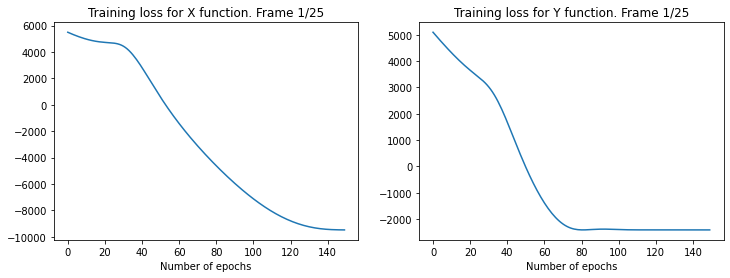

In [ ]:
# Loss inspection

ii = 0 # Frame number

f,ax=plt.subplots(1,2,figsize=(12,4))
ax[0].plot(loss1_list[ii])
ax[1].plot(loss2_list[ii])
ax[0].set_title('Training loss for X function. Frame {}/{}'.format(ii+1,stacksize))
ax[1].set_title('Training loss for Y function. Frame {}/{}'.format(ii+1,stacksize))
ax[0].set_xlabel('Number of epochs')
ax[1].set_xlabel('Number of epochs');

Check the trained model on "itself" with some interpolation between points

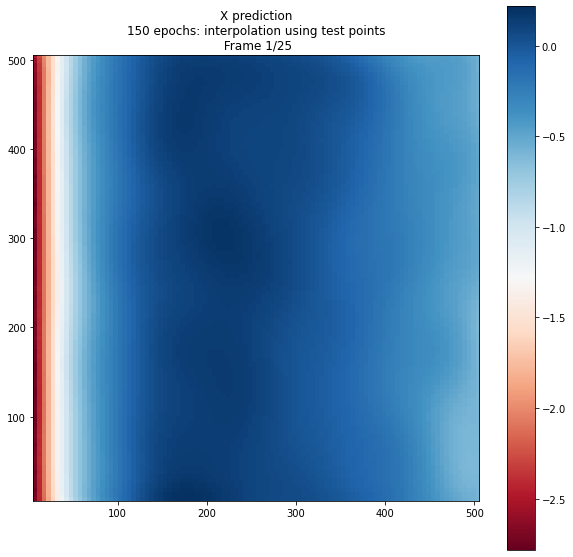

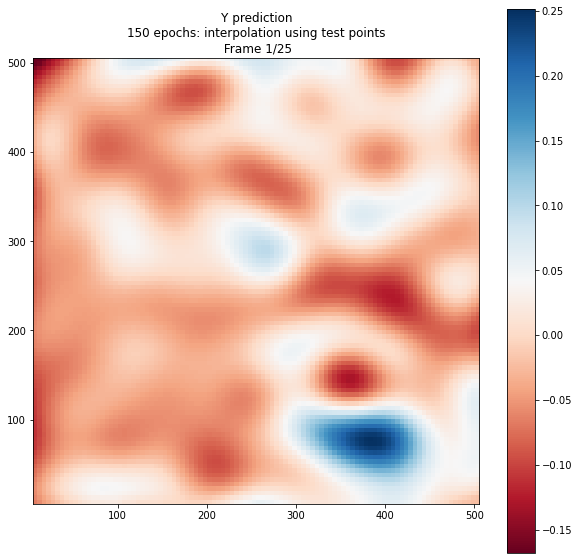

In [ ]:
ii = 0
xy_test = atoms_xy_list[ii]

contour_plot2(xy_test[:, 1], xy_test[:, 0],
             mean1_list[ii], npoints=100,
             figtitle='X prediction\n{} epochs: interpolation using test points\n Frame {}/{}'.format(epochs, ii+1, stacksize)
             );
contour_plot2(xy_test[:, 1], xy_test[:, 0],
             mean2_list[ii], npoints=100,
             figtitle='Y prediction\n{} epochs: interpolation using test points\n Frame {}/{}'.format(epochs, ii+1, stacksize)
             );

In [ ]:
savedfile = 'GP_full_stack_shortflyback4'
np.savez(savedfile,
         model1_list,
         model2_list,
         mean1_list,
         mean2_list,
         sd1_list,
         sd2_list,
         delta_xy_scaled_list,
         scalefactor_all,
         atoms_xy_list)

In [ ]:
from google.colab import files

In [ ]:
files.download(savedfile+'.npz')

# CHECKPOINT 2 (GP trained)

* Now let's use the trained GP models on test points! 
* If we have sampled the image space enough, we can do reconstruction at every pixel
  * I have personally found that this threshold seems to be about 1%:
  * i.e., if we have sampled fewer than 1% of the image space, we cannot reconstruct at every pixel and must do some interpolation. Otherwise we CAN reconstruct at every pixel (but this is a memory hog, so we will work around it later)

In [ ]:
# SHORT flyback checkpoint for GP reconstruction:

!gdown https://drive.google.com/uc?id=1UM1jzlVq032JTp2A28-5jfnT7fbVCHum # (new) normalized inputs to GP, then scaled result after training
!gdown https://drive.google.com/uc?id=15_PYuxXDa5U6XIto6tjRuMEuPJqBEwM5 # center start (updated)
# !gdown https://drive.google.com/uc?id=1x8Zbirpitw0YMIya_nO9S06j2hrN9-OH # lower right start (previous is center start)

# LONG flyback checkpoint for GP reconstruction:
!gdown https://drive.google.com/uc?id=1Vcren0vpIQq_Eo93YXv-Irmx8uOlcjMN

# In case we did not load the image data:
!gdown https://drive.google.com/uc?id=1ENrmtL3SQ4PfiDDxUedBsBnQvvHPZm-8 # Short (strong) flyback
!gdown https://drive.google.com/uc?id=1BqmLZi3c2Fb-2hlCR0NkoMpiiX9S8-at # Long (weak) flyback

Downloading...
From: https://drive.google.com/uc?id=1UM1jzlVq032JTp2A28-5jfnT7fbVCHum
To: /content/GP_full_stack_shortflyback3b.npz
9.33MB [00:00, 56.7MB/s]
Downloading...
From: https://drive.google.com/uc?id=15_PYuxXDa5U6XIto6tjRuMEuPJqBEwM5
To: /content/GP_full_stack_shortflyback4.npz
10.9MB [00:00, 50.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1Vcren0vpIQq_Eo93YXv-Irmx8uOlcjMN
To: /content/GP_full_stack_longflyback070620.npz
3.45MB [00:00, 30.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ENrmtL3SQ4PfiDDxUedBsBnQvvHPZm-8
To: /content/Recording25 75 4 0 16.npy
26.2MB [00:00, 99.2MB/s]
Downloading...
From: https://drive.google.com/uc?id=1BqmLZi3c2Fb-2hlCR0NkoMpiiX9S8-at
To: /content/20-3D Stack_10.npy
26.2MB [00:00, 99.0MB/s]


In [ ]:
# CHOOSE short or long flyback dataset

savedGP = np.load('/content/GP_full_stack_shortflyback4.npz', allow_pickle=True)
# savedGP = np.load('/content/GP_full_stack_longflyback070620.npz', allow_pickle=True)


model1_list = savedGP['arr_0']
model2_list = savedGP['arr_1']
mean1_list = savedGP['arr_2']
mean2_list = savedGP['arr_3']
sd1_list = savedGP['arr_4']
sd2_list = savedGP['arr_5']
delta_xy_scaled_list = savedGP['arr_6']
scalefactor_all = savedGP['arr_7']
atoms_xy_list = savedGP['arr_8']

stacksize = len(model1_list)

In [ ]:
# In case starting from checkpoint

imgdata = np.load('/content/Recording25 75 4 0 16.npy')
# imgdata = np.load('/content/20-3D Stack_10.npy')

**GP Reconstruction without interpolation**

* We can create a pixel array with as many pixels as we wish that make up the image space.
* For example, the original image was, say, (512x512). We can perform a GP reconstruction on a space that is the same physical size as (512x512) but downsample it to (256x256) or (128x128).
* To adjust this, change $numpix$ parameter below


* We can make it the SAME (also 512x512), but this requires segmenting the arrays and concatenating them due to memory hogging.
* Even subpixel precision if possible (though I am not sure if it makes sense to do this)

In [ ]:
# numpix = 32 gives us ~1k points
# numpix = 512 gives us a point for every pixel

numpix = 256
imgsize = 512

X_dense, Y_dense = np.meshgrid(np.linspace(0,imgsize,numpix), np.linspace(0,imgsize,numpix))

densecoords_ = np.vstack([X_dense.ravel(), Y_dense.ravel()])
densecoords = np.swapaxes(densecoords_, 0, 1)

In [ ]:
ii = 0
meantest1, std1 = UseTrainedGP(densecoords, model1_list[ii])
meantest2, std2 = UseTrainedGP(densecoords, model2_list[ii])

In [ ]:
# Repeat the scaling for anything I use the trained model on (model was trained using normalized inputs!)

# Normalize [0,1]
meantest1 = (meantest1 - np.min(meantest1)) / (np.ptp(meantest1))
meantest2 = (meantest2 - np.min(meantest2)) / (np.ptp(meantest2))
# convert back to appropriate scale as determined by the actual data points 
# (we really only care about the uncertainty values which do not require any normalization processes)
meantest1 = meantest1*np.ptp(delta_xy_scaled_list[ii][:,0]) + np.min(delta_xy_scaled_list[ii][:,0])
meantest2 = meantest2*np.ptp(delta_xy_scaled_list[ii][:,1]) + np.min(delta_xy_scaled_list[ii][:,1])

meantest1_r = np.reshape(meantest1, (numpix,numpix))
meantest2_r = np.reshape(meantest2, (numpix,numpix))
std1_r = np.reshape(std1, (numpix,numpix))
std2_r = np.reshape(std2, (numpix,numpix))

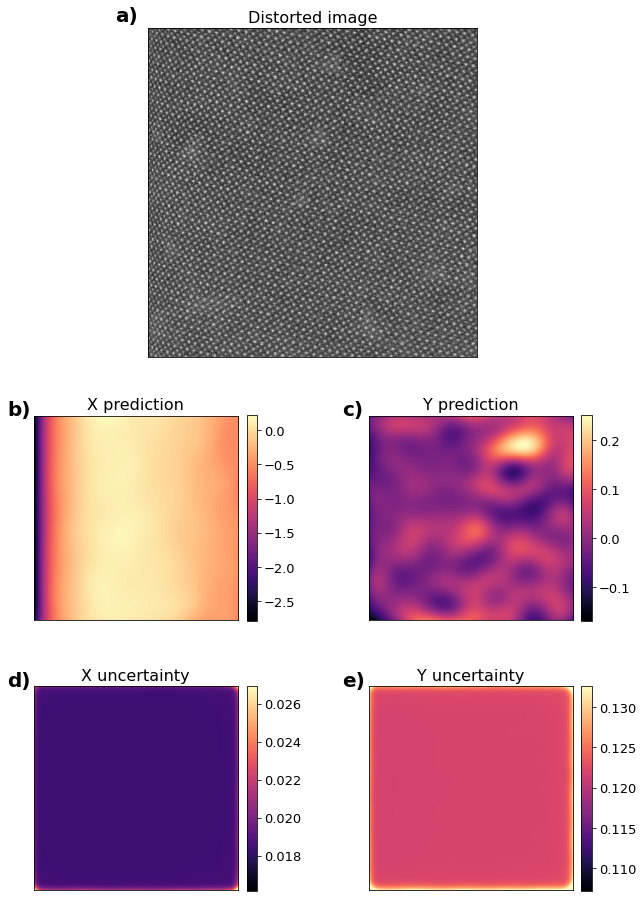

In [ ]:
in_pixels = False

if in_pixels == True:
  scalefactor = scalefactor_all[ii]
  scaleunits = "Pixels"
else:
  scalefactor = 1  # in units of lattice spacings, now
  # scaleunits = "Lattice \nspacings"  # Eh this is kind of ugly / too lengthy on the cbar
  scaleunits = ""
# Visualization preferences

colormap = 'magma'
percentmin = 0.88
percentmax = 0.88

fig = plt.figure(figsize=(10,16))
gs = gridspec.GridSpec(3,2, height_ratios=[3,2,2], wspace = 0.5)
ax00 = plt.subplot(gs[0:1,:])
ax10, ax11 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])
ax20, ax21 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1])
im00 = ax00.imshow(imgdata[0], cmap = 'gray')
im10 = ax10.imshow(meantest1_r*scalefactor, cmap = colormap)
im11 = ax11.imshow(meantest2_r*scalefactor, cmap = colormap)
im20 = ax20.imshow(std1_r, cmap = colormap, vmin = percentmin*(np.min(std1_r)), vmax = percentmax*(np.max(std1_r)))
im21 = ax21.imshow(std2_r, cmap = colormap, vmin = percentmin*(np.min(std2_r)), vmax = percentmax*(np.max(std2_r)))
cbar10 = plt.colorbar(im10, ax=ax10,fraction=0.046, pad=0.04)
cbar11 = plt.colorbar(im11, ax=ax11,fraction=0.046, pad=0.04)
cbar20 = plt.colorbar(im20, ax=ax20,fraction=0.046, pad=0.04)
cbar21 = plt.colorbar(im21, ax=ax21,fraction=0.046, pad=0.04)
cbar10.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
cbar11.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
# cbar20.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
# cbar21.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
cbar10.ax.tick_params(labelsize=13)
cbar11.ax.tick_params(labelsize=13)
cbar20.ax.tick_params(labelsize=13)
cbar21.ax.tick_params(labelsize=13)

ax00.set_title('Distorted image', fontsize = 16)
ax10.set_title('X prediction', fontsize = 16)
ax11.set_title('Y prediction', fontsize = 16)
ax20.set_title('X uncertainty', fontsize = 16)
ax21.set_title('Y uncertainty', fontsize = 16)

plt.setp([ax00,ax10,ax11,ax20,ax21], xticks=[], yticks=[])

axs = [ax10, ax11, ax20, ax21]
for n, ax in enumerate(axs): 
    ax.text(-0.13, 1, "{})".format(string.ascii_lowercase[n+1]), transform=ax.transAxes, 
            size=20, weight='bold')
ax00.text(-0.1, 1.02, "{})".format(string.ascii_lowercase[0]), transform=ax00.transAxes, 
            size=20, weight='bold');

Check some statistics...

In [ ]:
ii = 0
print('Variance: ', model1_list[ii].kernel.variance.item())
print('Length scale: ', model1_list[ii].kernel.lengthscale.item())
print('Noise: ', model1_list[ii].noise.item())

Variance:  0.24469733238220215
Length scale:  0.9986894130706787
Noise:  0.24469725598838926


To apply the model on **all pixels** in image, it must be broken into smaller batches (memory issues otherwise):
* Here we show how it can be done for a 512x512 image

In [ ]:
numpix = 256
imgsize = 256

X_00, Y_00 = np.meshgrid(np.linspace(0,imgsize,numpix), np.linspace(0,imgsize,numpix))
X_01, Y_01 = np.meshgrid(np.linspace(0,imgsize,numpix), np.linspace(imgsize,2*imgsize,numpix))
X_10, Y_10 = np.meshgrid(np.linspace(imgsize,2*imgsize,numpix), np.linspace(0,imgsize,numpix))
X_11, Y_11 = np.meshgrid(np.linspace(imgsize,2*imgsize,numpix), np.linspace(imgsize,2*imgsize,numpix))

dense_00_ = np.vstack([X_00.ravel(), Y_00.ravel()])
dense_01_ = np.vstack([X_01.ravel(), Y_01.ravel()])
dense_10_ = np.vstack([X_10.ravel(), Y_10.ravel()])
dense_11_ = np.vstack([X_11.ravel(), Y_11.ravel()])

dense_00 = np.swapaxes(dense_00_, 0, 1)
dense_01 = np.swapaxes(dense_01_, 0, 1)
dense_10 = np.swapaxes(dense_10_, 0, 1)
dense_11 = np.swapaxes(dense_11_, 0, 1)

In [ ]:
ii = 1
meantestx_00, stdx_00 = UseTrainedGP(dense_00, model1_list[ii])
meantesty_00, stdy_00 = UseTrainedGP(dense_00, model2_list[ii])

meantestx_01, stdx_01 = UseTrainedGP(dense_01, model1_list[ii])
meantesty_01, stdy_01 = UseTrainedGP(dense_01, model2_list[ii])

meantestx_10, stdx_10 = UseTrainedGP(dense_10, model1_list[ii])
meantesty_10, stdy_10 = UseTrainedGP(dense_10, model2_list[ii])

meantestx_11, stdx_11 = UseTrainedGP(dense_11, model1_list[ii])
meantesty_11, stdy_11 = UseTrainedGP(dense_11, model2_list[ii])

In [ ]:
meantestx_00_r = np.reshape(meantestx_00, (numpix,numpix))
meantestx_01_r = np.reshape(meantestx_01, (numpix,numpix))
meantestx_10_r = np.reshape(meantestx_10, (numpix,numpix))
meantestx_11_r = np.reshape(meantestx_11, (numpix,numpix))

meantesty_00_r = np.reshape(meantesty_00, (numpix,numpix))
meantesty_01_r = np.reshape(meantesty_01, (numpix,numpix))
meantesty_10_r = np.reshape(meantesty_10, (numpix,numpix))
meantesty_11_r = np.reshape(meantesty_11, (numpix,numpix))

stdx_00_r = np.reshape(stdx_00, (numpix,numpix))
stdx_01_r = np.reshape(stdx_01, (numpix,numpix))
stdx_10_r = np.reshape(stdx_10, (numpix,numpix))
stdx_11_r = np.reshape(stdx_11, (numpix,numpix))

stdy_00_r = np.reshape(stdy_00, (numpix,numpix))
stdy_01_r = np.reshape(stdy_01, (numpix,numpix))
stdy_10_r = np.reshape(stdy_10, (numpix,numpix))
stdy_11_r = np.reshape(stdy_11, (numpix,numpix))

## Concatenate the arrays
meanx_axis0 = np.concatenate((meantestx_00_r,meantestx_01_r))
meanx_axis1 = np.concatenate((meantestx_10_r,meantestx_11_r))
meany_axis0 = np.concatenate((meantesty_00_r,meantesty_01_r))
meany_axis1 = np.concatenate((meantesty_10_r,meantesty_11_r))
stdx_axis0 = np.concatenate((stdx_00_r,stdx_01_r))
stdx_axis1 = np.concatenate((stdx_10_r,stdx_11_r))
stdy_axis0 = np.concatenate((stdy_00_r,stdy_01_r))
stdy_axis1 = np.concatenate((stdy_10_r,stdy_11_r))

meanx = np.concatenate((meanx_axis0,meanx_axis1),axis=1)
meany = np.concatenate((meany_axis0,meany_axis1),axis=1)
stdx = np.concatenate((stdx_axis0,stdx_axis1),axis=1)
stdy = np.concatenate((stdy_axis0,stdy_axis1),axis=1)

In [ ]:
# Normalize [0,1]
meanx = (meanx - np.min(meanx)) / (np.ptp(meanx))
meany = (meany - np.min(meany)) / (np.ptp(meany))
# convert back to appropriate scale as determined by the actual data points 
# (we really only care about the uncertainty values which do not require any normalization processes)
meanx = meanx*np.ptp(delta_xy_scaled_list[ii][:,0]) + np.min(delta_xy_scaled_list[ii][:,0])
meany = meany*np.ptp(delta_xy_scaled_list[ii][:,1]) + np.min(delta_xy_scaled_list[ii][:,1])

In [ ]:
stdx.min(), stdx.max()

(0.0185327848159281, 0.03314429730379073)

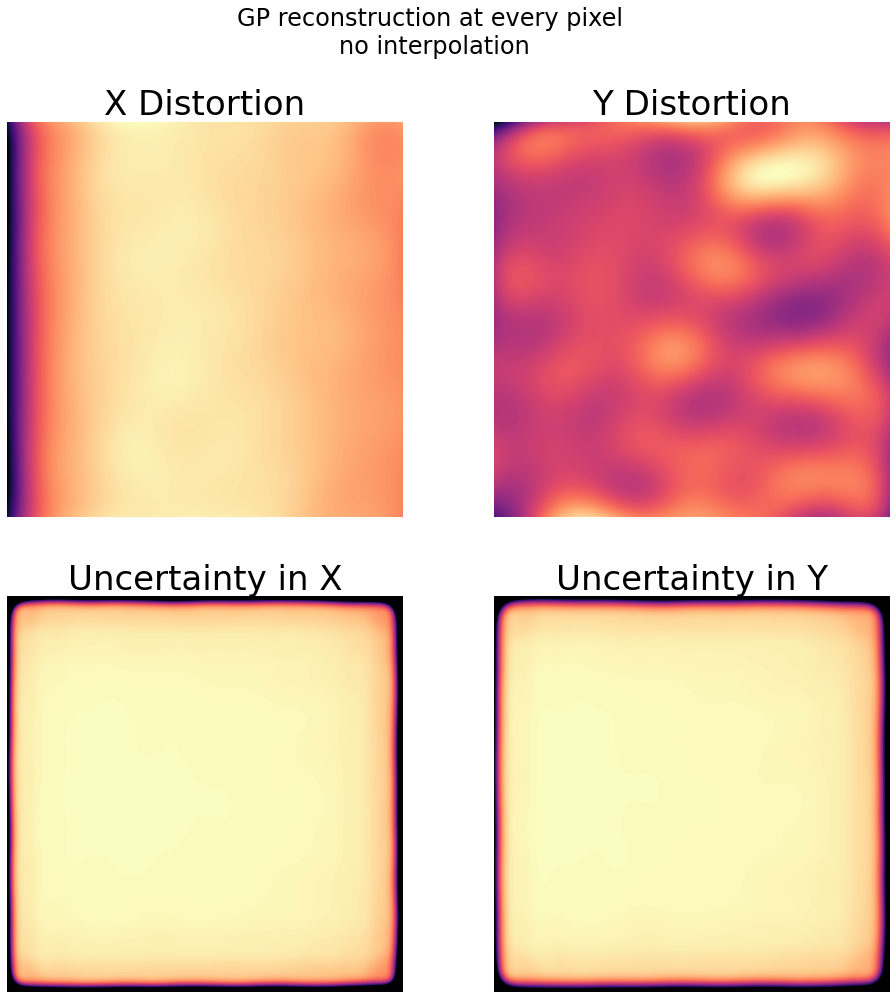

In [ ]:
f,ax = plt.subplots(2,2,figsize=(16,16))

colormap1 = 'magma'
colormap2 = 'magma_r'

plt.suptitle('GP reconstruction at every pixel \nno interpolation', fontsize = 24)
im00 = ax[0,0].imshow(meanx, cmap = colormap1)
im01 = ax[0,1].imshow(meany, cmap = colormap1)
im10 = ax[1,0].imshow(stdx, cmap = colormap2, vmin = 1.*stdx.min(), vmax = 0.6*stdx.max())  # Adjust limits only to emphasize uncertainty near edges
im11 = ax[1,1].imshow(stdy, cmap = colormap2, vmin = 1.*stdy.min(), vmax = 0.8*stdy.max())  # Adjust limits only to emphasize uncertainty near edges
# plt.colorbar(im00, ax=ax[0,0])
# plt.colorbar(im01, ax=ax[0,1])
# plt.colorbar(im10, ax=ax[1,0])
# plt.colorbar(im11, ax=ax[1,1])
ax[0,0].set_title('X prediction')
ax[0,1].set_title('Y prediction')
ax[1,0].set_title('X uncertainty')
ax[1,1].set_title('Y uncertainty');

axes = ax[0,0], ax[0,1], ax[1,0], ax[1,1]
for k in axes:
  k.axis('off')

ax[0,0].set_title('X Distortion', fontsize = 34)
ax[0,1].set_title('Y Distortion', fontsize = 34)
ax[1,0].set_title('Uncertainty in X', fontsize = 34)
ax[1,1].set_title('Uncertainty in Y', fontsize = 34);

In [ ]:
# Reversed X and Y here

ii = 0
_,_, meanx = contour_plot(atoms_xy_list[ii][:, 0], atoms_xy_list[ii][:, 1], mean1_list[ii], npoints=numpix, show = False)
_,_, meany = contour_plot(atoms_xy_list[ii][:, 0], atoms_xy_list[ii][:, 1], mean2_list[ii], npoints=numpix, show = False);
_,_, GP_x_unc = contour_plot(atoms_xy_list[ii][:, 0], atoms_xy_list[ii][:, 1], sd1_list[ii], npoints=numpix, show = False);
_,_, GP_y_unc = contour_plot(atoms_xy_list[ii][:, 0], atoms_xy_list[ii][:, 1], sd2_list[ii], npoints=numpix, show = False);

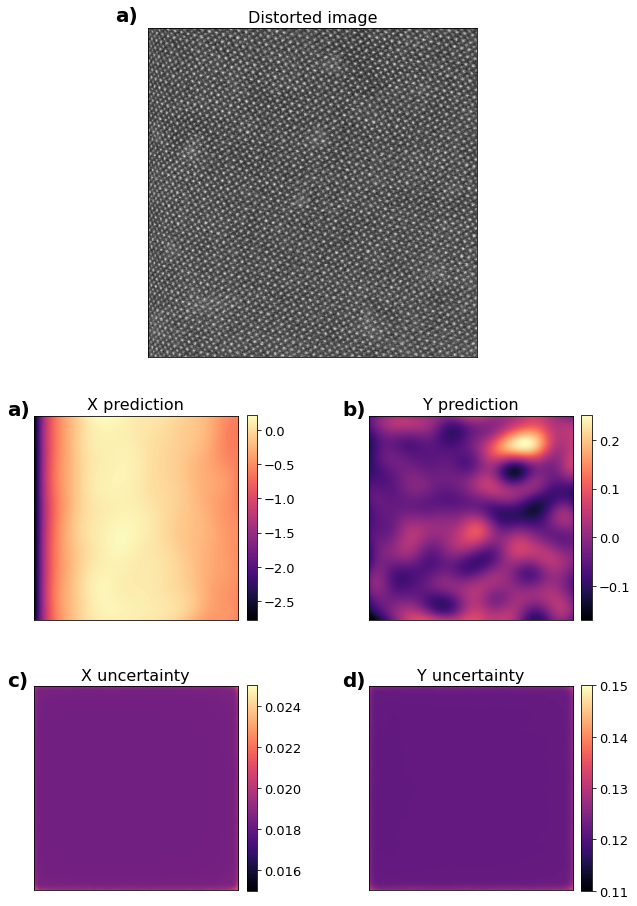

In [ ]:
in_pixels = False

if in_pixels == True:
  scalefactor = scalefactor_all[ii]
  scaleunits = "Pixels"
else:
  scalefactor = 1  # in units of lattice spacings, now
  scaleunits = ""

# Visualization preferences

colormap = 'magma'
percentmin = 1
percentmax = 0.985

fig = plt.figure(figsize=(10,16))
gs = gridspec.GridSpec(3,2, height_ratios=[3,2,2], wspace = 0.5)
ax00 = plt.subplot(gs[0:1,:])
ax10, ax11 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])
ax20, ax21 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1])
im00 = ax00.imshow(imgdata[0], cmap = 'gray')
im10 = ax10.imshow(meanx*scalefactor, cmap = colormap)
im11 = ax11.imshow(meany*scalefactor, cmap = colormap)
# im20 = ax20.imshow(GP_x_unc, cmap = colormap, vmin = percentmin*(np.min(GP_x_unc)), vmax = percentmax*(np.max(GP_x_unc)))
# im21 = ax21.imshow(GP_y_unc, cmap = colormap, vmin = percentmin*(np.min(GP_y_unc)), vmax = percentmax*(np.max(GP_y_unc)))
# im20 = ax20.imshow(GP_x_unc, cmap = colormap, vmin = 0.59, vmax = 0.64)  # long flyback
# im21 = ax21.imshow(GP_y_unc, cmap = colormap, vmin = 0.49, vmax = 0.54)  # long flyback
im20 = ax20.imshow(GP_x_unc, cmap = colormap, vmin = 0.015, vmax = 0.025)  # short (strong) flyback
im21 = ax21.imshow(GP_y_unc, cmap = colormap, vmin = 0.11, vmax = 0.15)  # short (strong) flyback
cbar10 = plt.colorbar(im10, ax=ax10,fraction=0.046, pad=0.04)
cbar11 = plt.colorbar(im11, ax=ax11,fraction=0.046, pad=0.04)
cbar20 = plt.colorbar(im20, ax=ax20,fraction=0.046, pad=0.04)
cbar21 = plt.colorbar(im21, ax=ax21,fraction=0.046, pad=0.04)
cbar10.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
cbar11.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
# cbar20.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
# cbar21.set_label('{}'.format(scaleunits), labelpad = 30, y = 0.55,fontsize = 13, rotation = 0)
cbar10.ax.tick_params(labelsize=13)
cbar11.ax.tick_params(labelsize=13)
cbar20.ax.tick_params(labelsize=13)
cbar21.ax.tick_params(labelsize=13)

ax00.set_title('Distorted image', fontsize = 16)
ax10.set_title('X prediction', fontsize = 16)
ax11.set_title('Y prediction', fontsize = 16)
ax20.set_title('X uncertainty', fontsize = 16)
ax21.set_title('Y uncertainty', fontsize = 16)

plt.setp([ax00,ax10,ax11,ax20,ax21], xticks=[], yticks=[])

axs = [ax10, ax11, ax20, ax21]
for n, ax in enumerate(axs): 
    ax.text(-0.13, 1, "{})".format(string.ascii_lowercase[n]), transform=ax.transAxes, 
            size=20, weight='bold')
ax00.text(-0.1, 1.02, "{})".format(string.ascii_lowercase[0]), transform=ax00.transAxes, 
            size=20, weight='bold');




## GP reconstruction: all frames

* Let's reconstruct each frame with (256x256) pixels first. 
* If we wish to do the full image size, this will be done in a later cell

## Interpolation for GP reconstruction (more general solution)



In [ ]:
numpix = 256    #      creates (numpix x numpix) interpolated image

meanall_x = np.zeros((stacksize, numpix, numpix))
meanall_y = np.zeros((stacksize, numpix, numpix))
GP_all_x_unc = np.zeros((stacksize, numpix, numpix))
GP_all_y_unc = np.zeros((stacksize, numpix, numpix))

for ii in range(stacksize):
  _,_, meanall_x[ii] = contour_plot(atoms_xy_list[ii][:, 1], atoms_xy_list[ii][:, 0], mean1_list[ii], npoints=numpix, show = False)
  _,_, meanall_y[ii] = contour_plot(atoms_xy_list[ii][:, 1], atoms_xy_list[ii][:, 0], mean2_list[ii], npoints=numpix, show = False);
  _,_, GP_all_x_unc[ii] = contour_plot(atoms_xy_list[ii][:, 1], atoms_xy_list[ii][:, 0], sd1_list[ii], npoints=numpix, show = False);
  _,_, GP_all_y_unc[ii] = contour_plot(atoms_xy_list[ii][:, 1], atoms_xy_list[ii][:, 0], sd2_list[ii], npoints=numpix, show = False);

In [ ]:
GP_all_x = np.zeros((stacksize, numpix, numpix))
GP_all_y = np.zeros((stacksize, numpix, numpix))

for ii in range(stacksize):
  # Normalize [0,1]
  GP_all_x[ii] = (meanall_x[ii] - np.min(meanall_x[ii])) / (np.ptp(meanall_x[ii]))
  GP_all_y[ii] = (meanall_y[ii] - np.min(meanall_y[ii])) / (np.ptp(meanall_y[ii]))
  # convert back to appropriate scale as determined by the actual data points 
  # (we really only care about the uncertainty values which do not require any normalization processes)
  GP_all_x[ii] = GP_all_x[ii]*np.ptp(delta_xy_scaled_list[ii][:,0]) + np.min(delta_xy_scaled_list[ii][:,0])
  GP_all_y[ii] = GP_all_y[ii]*np.ptp(delta_xy_scaled_list[ii][:,1]) + np.min(delta_xy_scaled_list[ii][:,1])

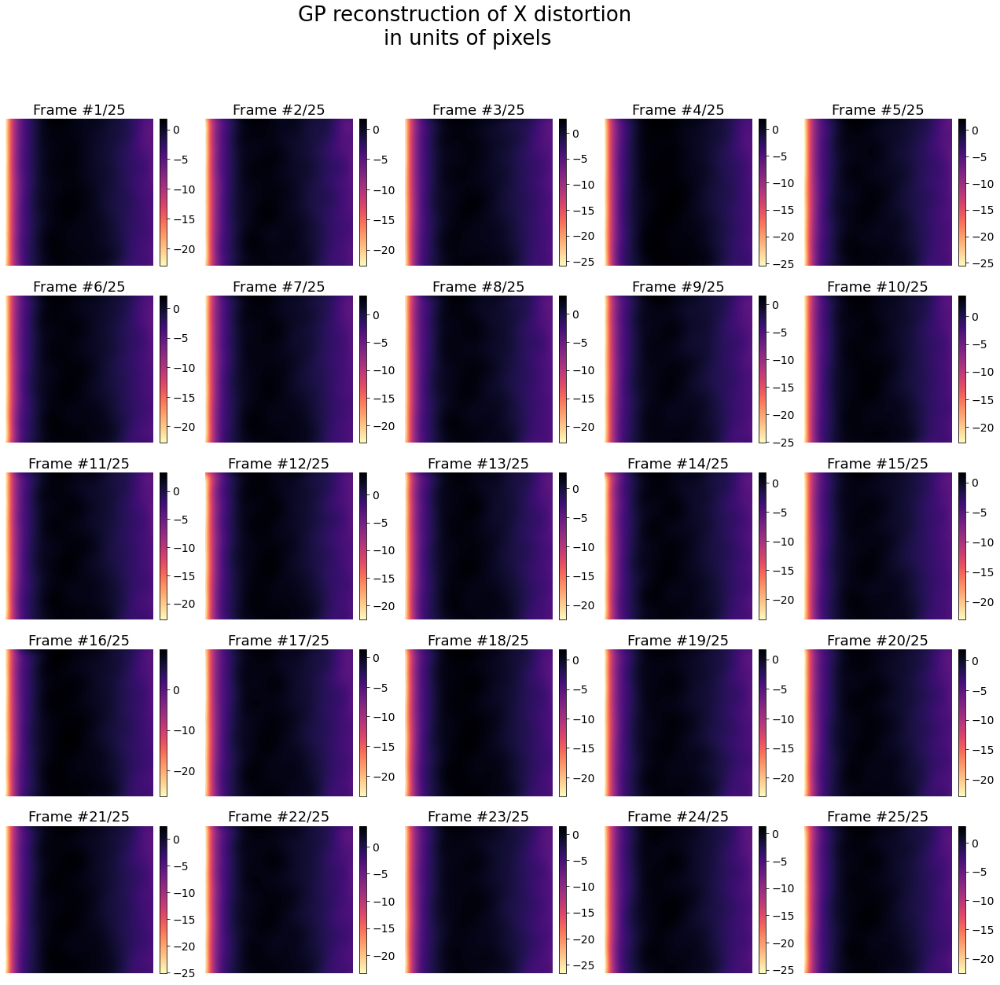

In [ ]:
in_pixels = True # False places in units of lattice spacings

colormap = 'magma_r'

nrows = int(np.sqrt(stacksize))
m,n= nrows,nrows
plt.figure(figsize=(22,20))
gs = gridspec.GridSpec(m,n)
for s in range(m):
  for q in range(n):
    ax, im = 'ax'+ str(s) + str(q), 'im'+ str(s) + str(q)
    ax = plt.subplot(gs[s,q])
    if in_pixels == True:
      im = ax.imshow(GP_all_x[m*s+q]*scalefactor_all[m*s+q], cmap = colormap) # pixel units
    else:
      im = ax.imshow(GP_all_x[m*s+q], cmap = colormap) # lattice constants

    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_title('Frame #{}/25'.format(nrows*s+q+1), fontsize = 18)
    ax.axis('off')
    cbar.ax.tick_params(labelsize=14)
if in_pixels == True:
  plt.suptitle("GP reconstruction of X distortion \nin units of pixels", fontsize = 26);
else:
  plt.suptitle("GP reconstruction of X distortion \nin units of lattice spacings", fontsize = 26);

Y Distortion for all frames

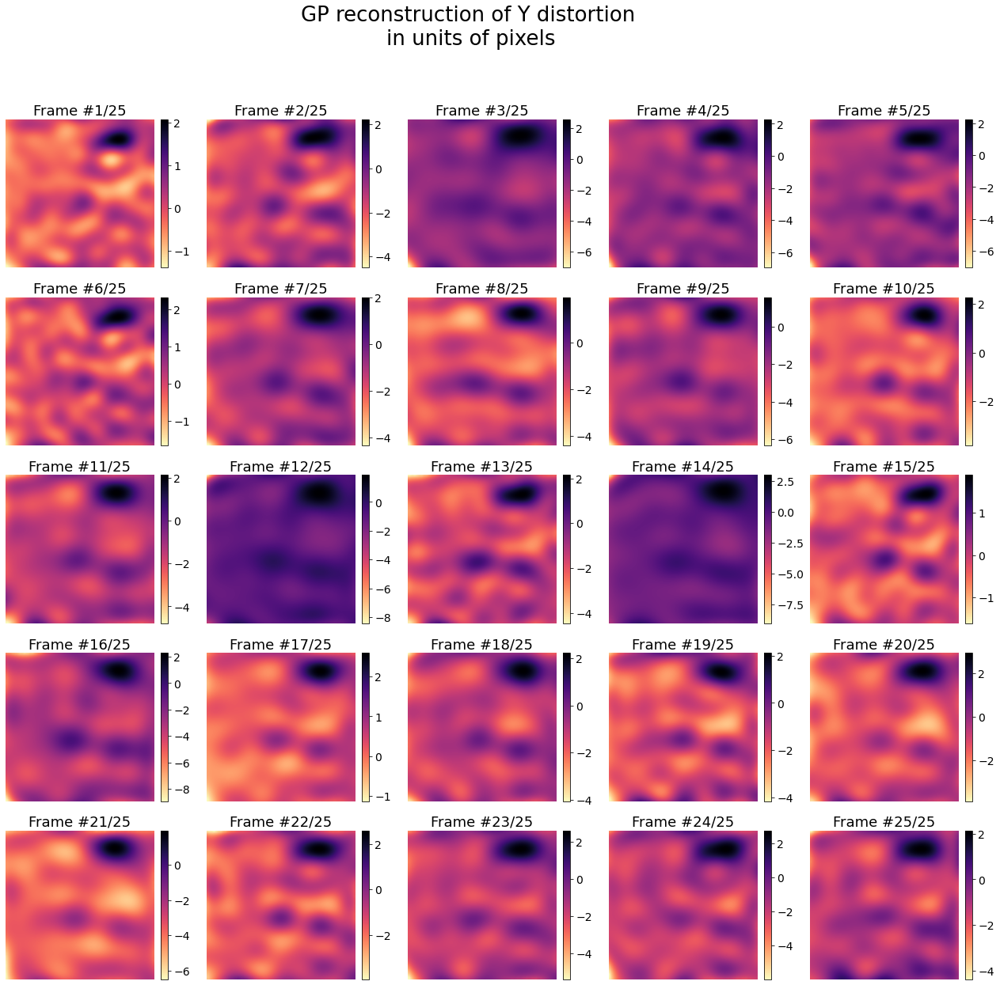

In [ ]:
in_pixels = True # False places in units of lattice spacings

colormap = 'magma_r'

nrows = int(np.sqrt(stacksize))
m,n= nrows,nrows
plt.figure(figsize=(22,20))
gs = gridspec.GridSpec(m,n)
for s in range(m):
  for q in range(n):
    ax, im = 'ax'+ str(s) + str(q), 'im'+ str(s) + str(q)
    ax = plt.subplot(gs[s,q])
    if in_pixels == True:
      im = ax.imshow(GP_all_y[m*s+q]*scalefactor_all[m*s+q], cmap = colormap) # pixel units
    else:
      im = ax.imshow(GP_all_y[m*s+q], cmap = colormap) # lattice constants

    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_title('Frame #{}/25'.format(nrows*s+q+1), fontsize = 18)
    ax.axis('off')
    cbar.ax.tick_params(labelsize=14)
if in_pixels == True:
  plt.suptitle("GP reconstruction of Y distortion \nin units of pixels", fontsize = 26);
else:
  plt.suptitle("GP reconstruction of Y distortion \nin units of lattice spacings", fontsize = 26);

View GP reconstructed distortion for a single frame

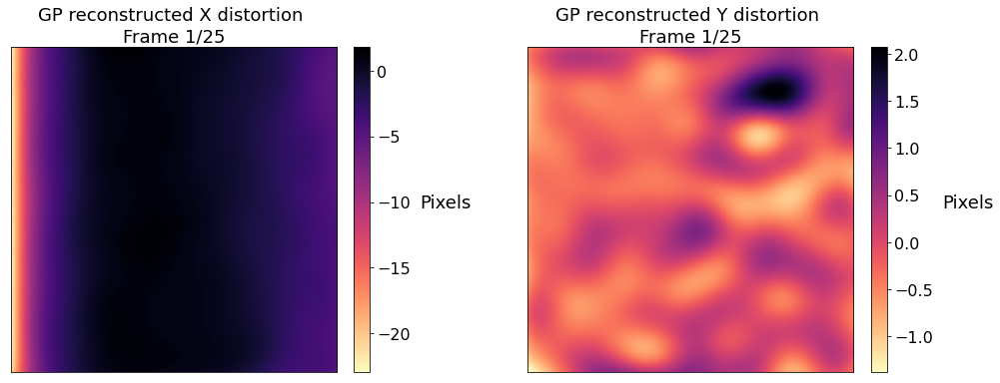

In [ ]:
ii = 0 # frame select
in_pixels = True

colormap = 'magma_r'
f,ax = plt.subplots(1,2,figsize=(17,6))
if in_pixels == True:
  im0 = ax[0].imshow(GP_all_x[ii]*scalefactor_all[ii], cmap = colormap)
  im1 = ax[1].imshow(GP_all_y[ii]*scalefactor_all[ii], cmap = colormap)
else:
  im0 = ax[0].imshow(GP_all_x[ii], cmap = colormap)
  im1 = ax[1].imshow(GP_all_y[ii], cmap = colormap)
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])
cbar0 = plt.colorbar(im0, ax=ax[0], fraction=0.046, pad=0.04)
cbar0.ax.tick_params(labelsize=16)
cbar1 = plt.colorbar(im1, ax=ax[1], fraction=0.046, pad=0.04)
cbar1.ax.tick_params(labelsize=16)
if in_pixels == True:
  cbar0.set_label('Pixels', labelpad = 35, y = 0.55,fontsize = 18, rotation = 0)
  cbar1.set_label('Pixels', labelpad = 35, y = 0.55,fontsize = 18, rotation = 0)
else:
  cbar0.set_label('Lattice \nspacings', labelpad = 45, y = 0.55,fontsize = 18, rotation = 0)
  cbar1.set_label('Lattice \nspacings', labelpad = 45, y = 0.55,fontsize = 18, rotation = 0)
ax[0].set_title('GP reconstructed X distortion \nFrame {}/{}'.format(ii+1,stacksize), fontsize = 18)
ax[1].set_title('GP reconstructed Y distortion \nFrame {}/{}'.format(ii+1,stacksize), fontsize = 18);

And the uncertainty

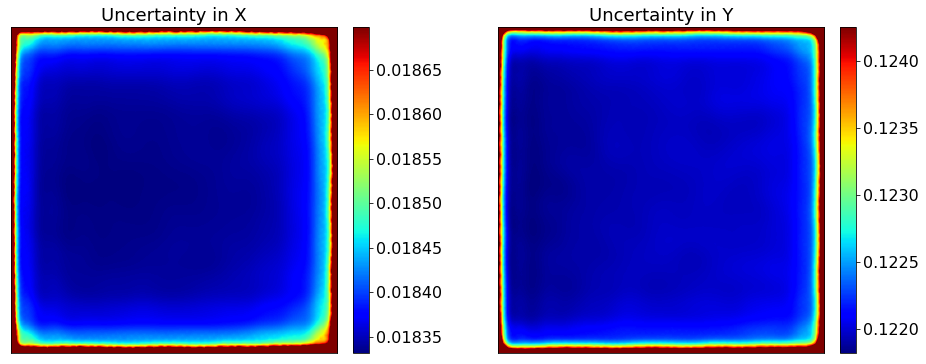

In [ ]:
ii = 0

percent = 1.02

colormap = 'jet'
f,ax = plt.subplots(1,2,figsize=(16,6))
im0 = ax[0].imshow(GP_all_x_unc[ii], cmap = colormap, vmax = percent*GP_all_x_unc[ii].min())
im1 = ax[1].imshow(GP_all_y_unc[ii], cmap = colormap, vmax = percent*GP_all_y_unc[ii].min())
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])
cbar0 = plt.colorbar(im0, ax=ax[0], fraction=0.046, pad=0.04)
cbar0.ax.tick_params(labelsize=16)
cbar1 = plt.colorbar(im1, ax=ax[1], fraction=0.046, pad=0.04)
cbar1.ax.tick_params(labelsize=16)
ax[0].set_title('Uncertainty in X', fontsize = 18)
ax[1].set_title('Uncertainty in Y', fontsize = 18);

Figure generation for X and Y distortion & uncertainty:

[]

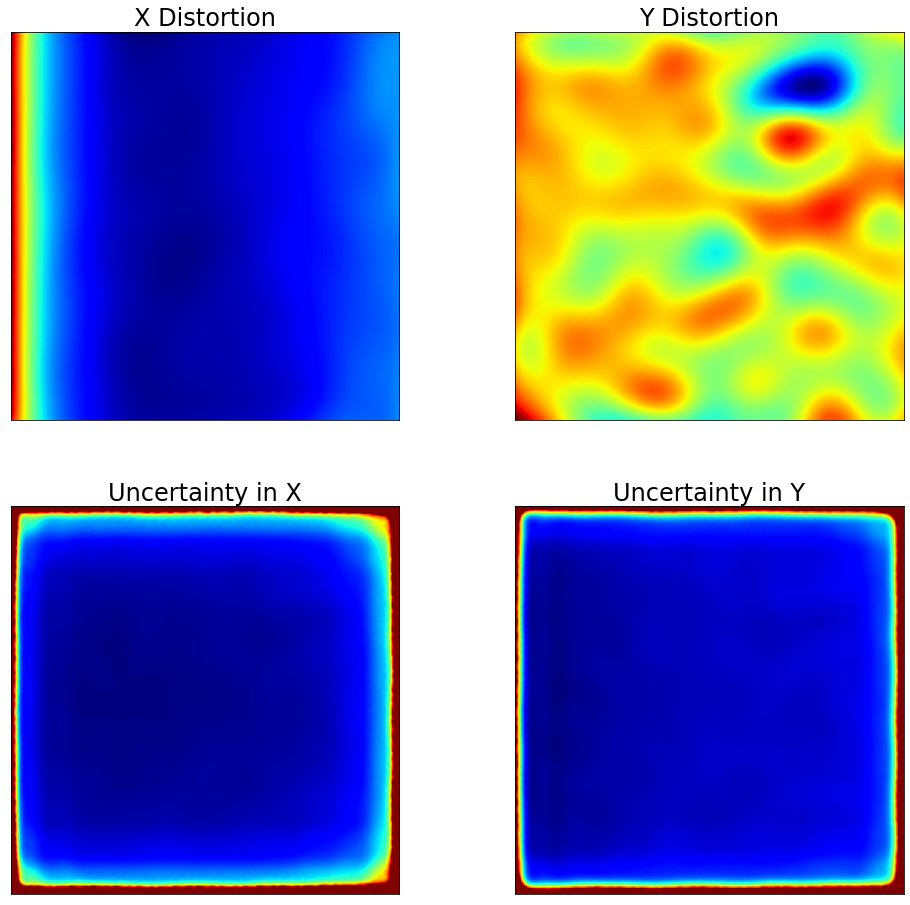

In [ ]:
ii = 0 # frame select

in_pixels = True
show_cbar = False
colormap = 'jet_r'
colormap2 = 'jet'
percent = 1.02  # Adjust to better visualize uncertainty

plt.figure(figsize=(16,16))
gs = gridspec.GridSpec(2,2,wspace = 0.3)
ax00 = plt.subplot(gs[0,0])
ax01 = plt.subplot(gs[0,1])
ax10 = plt.subplot(gs[1,0])
ax11 = plt.subplot(gs[1,1])

if in_pixels == True:
  im00 = ax00.imshow(GP_all_x[ii]*scalefactor_all[ii], cmap = colormap)
  im01 = ax01.imshow(GP_all_y[ii]*scalefactor_all[ii], cmap = colormap)
else:
  im00 = ax00.imshow(GP_all_x[ii], cmap = colormap)
  im01 = ax01.imshow(GP_all_y[ii], cmap = colormap)

### Uncertainty ###
im10 = ax10.imshow(GP_all_x_unc[ii], cmap = colormap2,vmax = percent*GP_all_x_unc[ii].min())
im11 = ax11.imshow(GP_all_y_unc[ii], cmap = colormap2,vmax = percent*GP_all_y_unc[ii].min())
# im10 = ax10.imshow(GP_all_x_unc[ii], cmap = colormap2)
# im11 = ax11.imshow(GP_all_y_unc[ii], cmap = colormap2)

if show_cbar == True:
  cbar00 = plt.colorbar(im00, ax=ax00, fraction=0.046, pad=0.04)
  cbar00.ax.tick_params(labelsize=16)
  cbar01 = plt.colorbar(im01, ax=ax01, fraction=0.046, pad=0.04)
  cbar01.ax.tick_params(labelsize=16)
  if in_pixels == True:
    cbar00.set_label('Pixels', labelpad = 35, y = 0.55,fontsize = 18, rotation = 0)
    cbar01.set_label('Pixels', labelpad = 35, y = 0.55,fontsize = 18, rotation = 0)
  else:
    cbar00.set_label('Lattice \nspacings', labelpad = 45, y = 0.55,fontsize = 18, rotation = 0)
    cbar01.set_label('Lattice \nspacings', labelpad = 45, y = 0.55,fontsize = 18, rotation = 0)

  cbar10 = plt.colorbar(im10, ax=ax10, fraction=0.046, pad=0.04)
  cbar10.ax.tick_params(labelsize=16)
  cbar11 = plt.colorbar(im11, ax=ax11, fraction=0.046, pad=0.04)
  cbar11.ax.tick_params(labelsize=16)

ax10.set_title('Uncertainty in X', fontsize = 18)
ax11.set_title('Uncertainty in Y', fontsize = 18);
ax00.set_title('GP reconstructed X distortion \nFrame {}/{}'.format(ii+1,stacksize), fontsize = 18)
ax01.set_title('GP reconstructed Y distortion \nFrame {}/{}'.format(ii+1,stacksize), fontsize = 18);

ax10.set_title('Uncertainty in X', fontsize = 24)
ax11.set_title('Uncertainty in Y', fontsize = 24);
ax00.set_title('X Distortion', fontsize = 24)
ax01.set_title('Y Distortion', fontsize = 24);

plt.setp([ax00,ax01, ax10, ax11], xticks=[], yticks=[])

## Partial frame GP reconstruction (<font color='crimson'>use for short flyback</font>)

In [ ]:
stacksize = 25

numpix = 256
imgsize = 512

X_dense, Y_dense = np.meshgrid(np.linspace(0,imgsize,numpix), np.linspace(0,imgsize,numpix))

densecoords_ = np.vstack([X_dense.ravel(), Y_dense.ravel()])
densecoords = np.swapaxes(densecoords_, 0, 1)

In [ ]:
GP_all_x_ =     np.zeros((stacksize, numpix*numpix))
GP_all_x_unc_ = np.zeros((stacksize, numpix*numpix))
GP_all_y_ =     np.zeros((stacksize, numpix*numpix))
GP_all_y_unc_ = np.zeros((stacksize, numpix*numpix))
GP_all_x =     np.zeros((stacksize, numpix,numpix))
GP_all_x_unc = np.zeros((stacksize, numpix,numpix))
GP_all_y =     np.zeros((stacksize, numpix,numpix))
GP_all_y_unc = np.zeros((stacksize, numpix,numpix))

In [ ]:
for ii in range(stacksize):
  GP_all_x_[ii], GP_all_x_unc_[ii] = UseTrainedGP(densecoords, model1_list[ii])
  GP_all_y_[ii], GP_all_y_unc_[ii] = UseTrainedGP(densecoords, model2_list[ii])

In [ ]:
for ii in range(stacksize):
  GP_all_x[ii]     = np.reshape(GP_all_x_[ii], (numpix,numpix))
  GP_all_x_unc[ii] = np.reshape(GP_all_x_unc_[ii], (numpix,numpix))
  GP_all_y[ii]     = np.reshape(GP_all_y_[ii], (numpix,numpix))
  GP_all_y_unc[ii] = np.reshape(GP_all_y_unc_[ii], (numpix,numpix))

In [ ]:
# Scaling step

# Normalize [0,1]
for ii in range(stacksize):
  GP_all_x[ii] = (GP_all_x[ii] - np.min(GP_all_x[ii] )) / (np.ptp(GP_all_x[ii]))
  GP_all_y[ii]  = (GP_all_y[ii] - np.min(GP_all_y[ii])) / (np.ptp(GP_all_y[ii]))
# convert back to appropriate scale as determined by the actual data points 
# (we really only care about the uncertainty values which do not require any normalization processes)
for ii in range(stacksize):
  GP_all_x[ii] = GP_all_x[ii]*np.ptp(delta_xy_scaled_list[ii][:,0]) + np.min(delta_xy_scaled_list[ii][:,0])
  GP_all_y[ii] = GP_all_y[ii]*np.ptp(delta_xy_scaled_list[ii][:,1]) + np.min(delta_xy_scaled_list[ii][:,1])

X Distortion for all frames

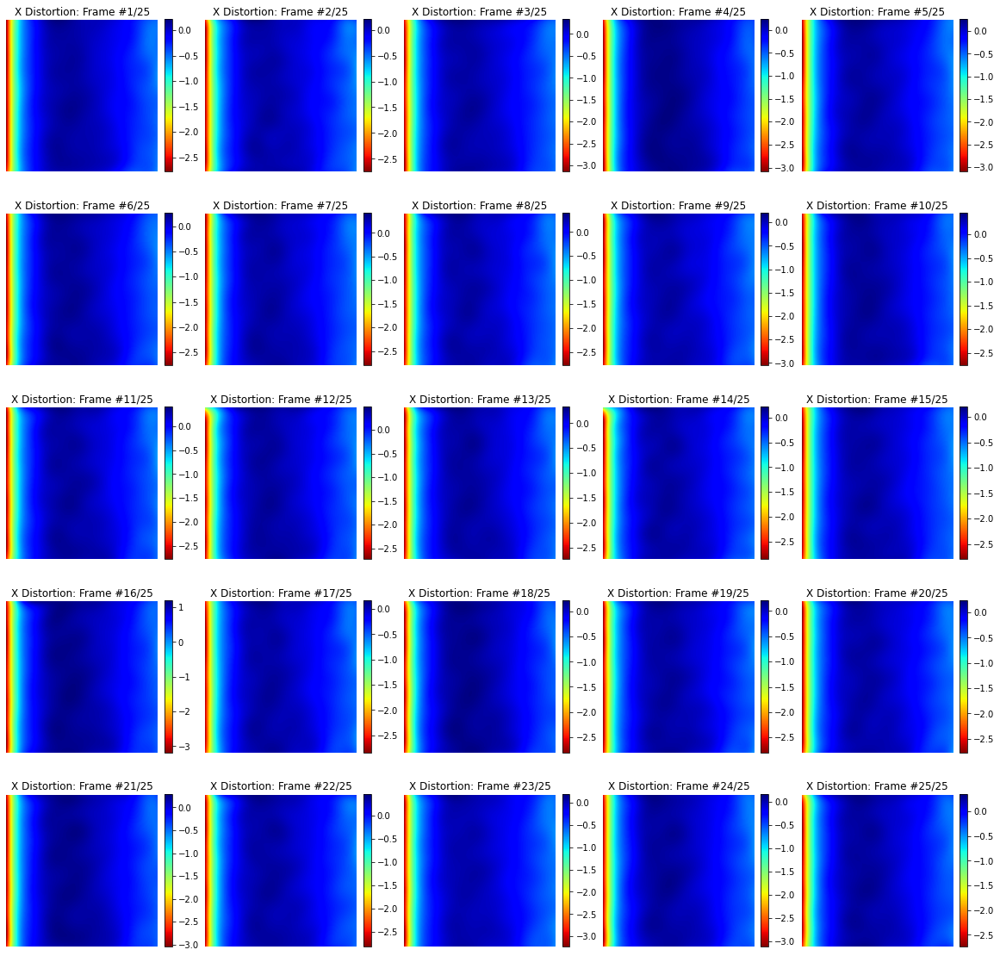

In [ ]:
colormap = 'jet_r'

m,n= 5,5
plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(m,n)
for s in range(5):
  for q in range(5):
    ax, im = 'ax'+ str(s) + str(q), 'im'+ str(s) + str(q)
    ax = plt.subplot(gs[s,q])
    im = ax.imshow(GP_all_x[m*s+q], cmap = colormap)
    plt.colorbar(im, ax=ax, fraction = 0.046, pad = 0.04)
    ax.set_title('X Distortion: Frame #{}/{}'.format(5*s+q+1,stacksize))
    ax.axis('off')

* In case flyback is very strong, it may be hard to see other distortions
* Adjust vmin and vmax to saturate the flyback and make clear others
  * This can be done with the $percent$ parameter below in a somewhat more reasonable manner

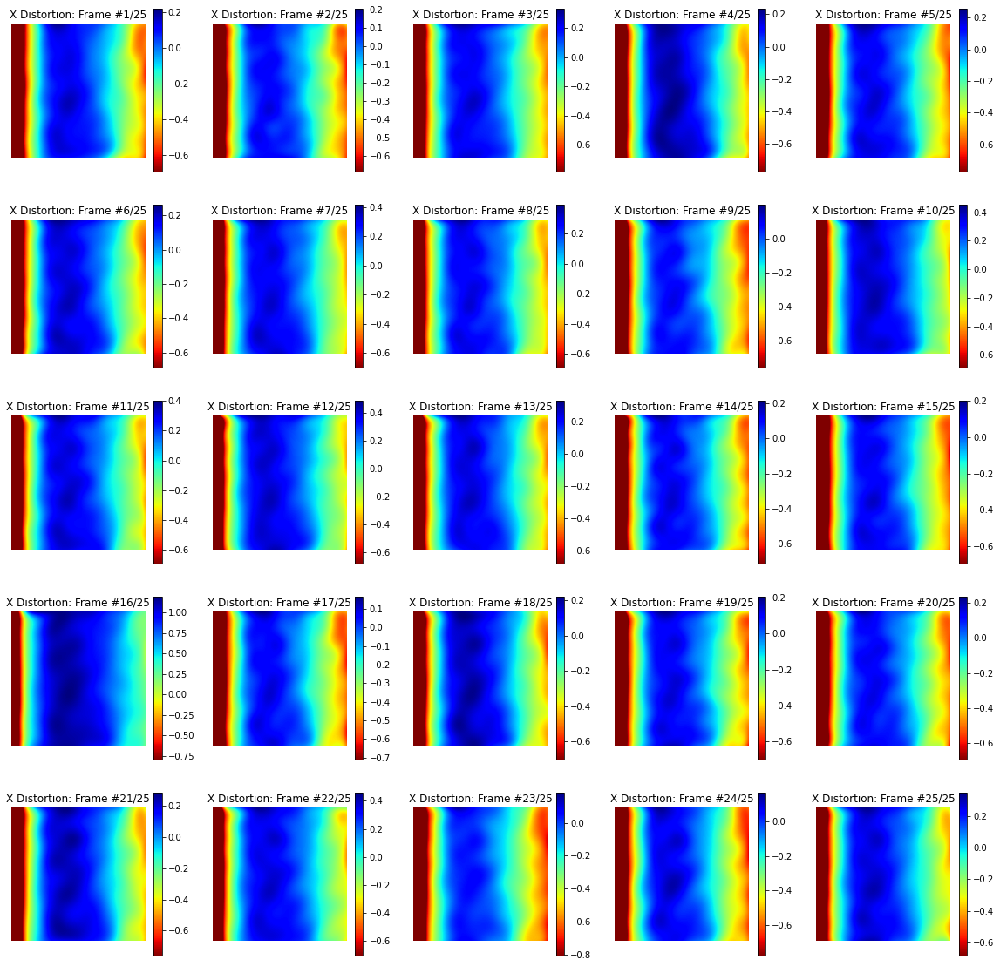

In [ ]:
percent = 0.25
colormap = 'jet_r'

m,n= 5,5
plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(m,n)
for s in range(5):
  for q in range(5):
    ax, im = 'ax'+ str(s) + str(q), 'im'+ str(s) + str(q)
    ax = plt.subplot(gs[s,q])
    im = ax.imshow(GP_all_x[m*s+q], cmap = colormap, vmin = percent*GP_all_x[m*s+q].min())
    plt.colorbar(im, ax=ax)
    ax.set_title('X Distortion: Frame #{}/{}'.format(5*s+q+1,stacksize))
    ax.axis('off')

Y Distortion for all frames

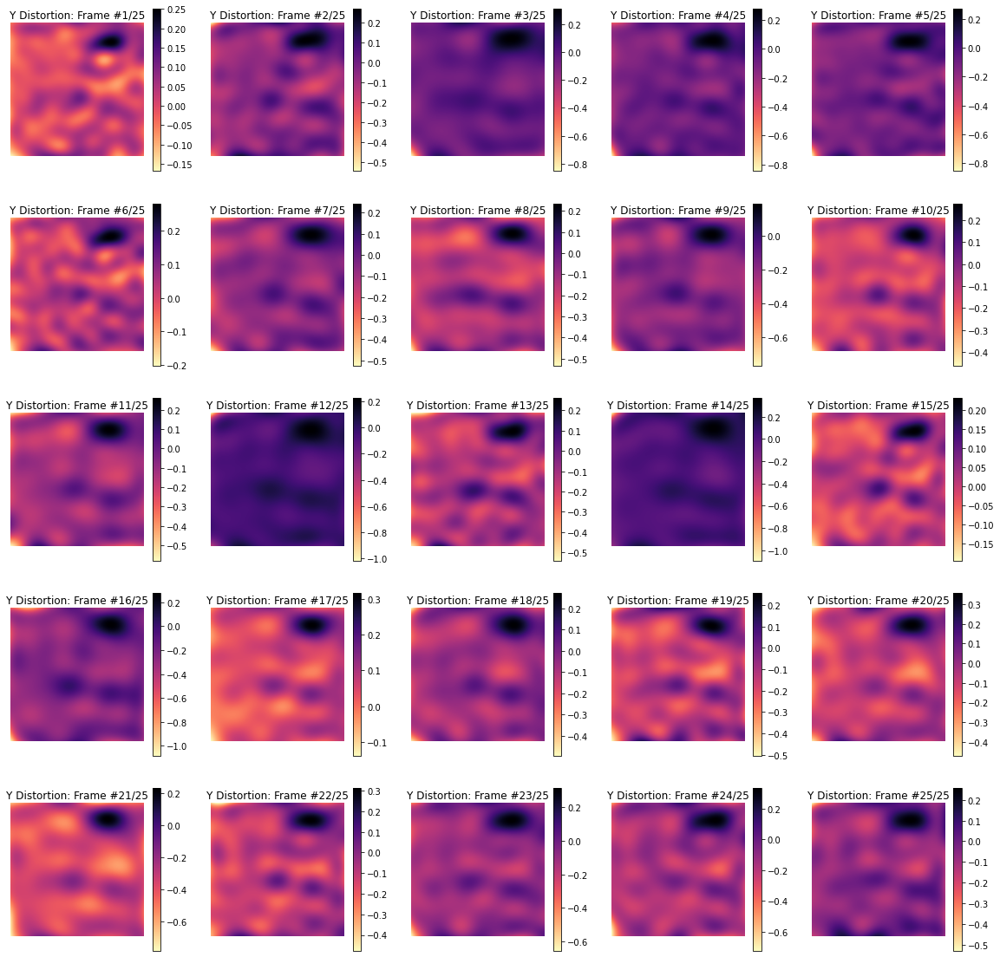

In [ ]:
colormap = 'magma_r'

m,n= 5,5
plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(m,n)
for s in range(5):
  for q in range(5):
    ax, im = 'ax'+ str(s) + str(q), 'im'+ str(s) + str(q)
    ax = plt.subplot(gs[s,q])
    im = ax.imshow(GP_all_y[m*s+q], cmap = colormap)
    plt.colorbar(im, ax=ax)
    ax.set_title('Y Distortion: Frame #{}/{}'.format(5*s+q+1,stacksize))
    ax.axis('off')

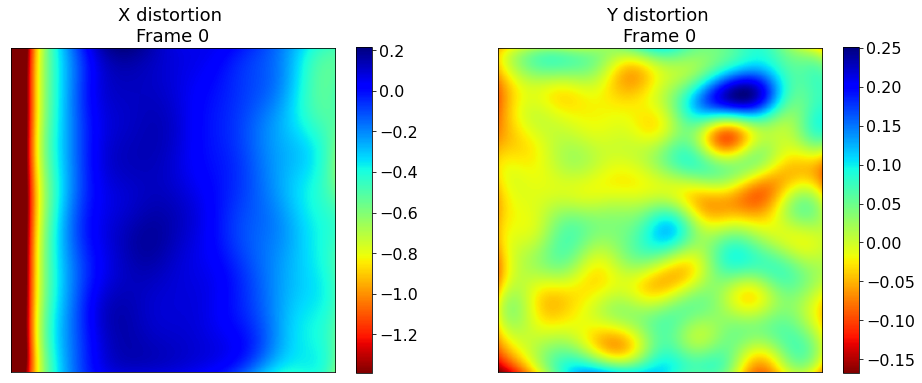

In [ ]:
ii = 0 # frame select

percent = 0.5
colormap = 'jet_r'

f,ax = plt.subplots(1,2,figsize=(16,6))
im0 = ax[0].imshow(GP_all_x[ii], cmap = colormap, vmin = percent*GP_all_x[ii].min())
im1 = ax[1].imshow(GP_all_y[ii], cmap = colormap)
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])
cbar0 = plt.colorbar(im0, ax=ax[0])
cbar0.ax.tick_params(labelsize=16)
cbar1 = plt.colorbar(im1, ax=ax[1])
cbar1.ax.tick_params(labelsize=16)
ax[0].set_title('X distortion \nFrame {}'.format(ii), fontsize = 18)
ax[1].set_title('Y distortion \nFrame {}'.format(ii), fontsize = 18);

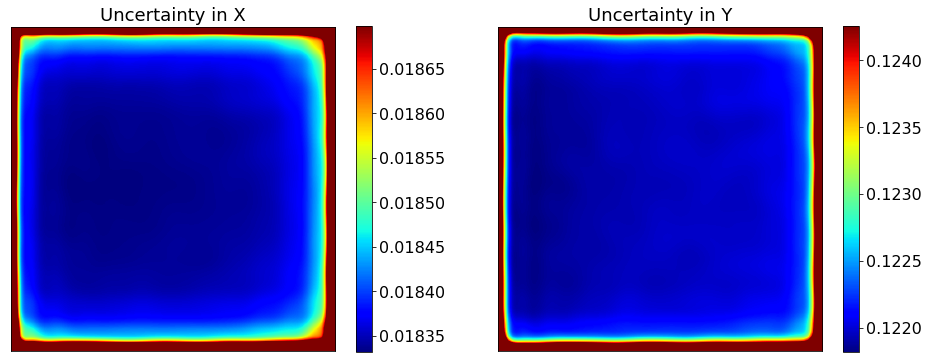

In [ ]:
ii = 0

percent = 1.02

colormap = 'jet'
f,ax = plt.subplots(1,2,figsize=(16,6))
im0 = ax[0].imshow(GP_all_x_unc[ii], cmap = colormap, vmax = percent*GP_all_x_unc[ii].min())
im1 = ax[1].imshow(GP_all_y_unc[ii], cmap = colormap, vmax = percent*GP_all_y_unc[ii].min())
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])
cbar0 = plt.colorbar(im0, ax=ax[0])
cbar0.ax.tick_params(labelsize=16)
cbar1 = plt.colorbar(im1, ax=ax[1])
cbar1.ax.tick_params(labelsize=16)
ax[0].set_title('Uncertainty in X', fontsize = 18)
ax[1].set_title('Uncertainty in Y', fontsize = 18);

## Multivariate analysis on GP stack

In [ ]:
np.savez('GP_reconstructed_shortflyback33120_4.npz',
         GP_all_x,
         GP_all_y,
         GP_all_x_unc,
         GP_all_y_unc
         )

## PCA for partial reconstructions...

In [ ]:
# Reshape
GP_all_x_r = np.reshape(GP_all_x, (GP_all_x.shape[0], GP_all_x.shape[1]*GP_all_x.shape[2]))
GP_all_y_r = np.reshape(GP_all_y, (GP_all_y.shape[0], GP_all_y.shape[1]*GP_all_y.shape[2]))

# GP_all_full_x_r = np.reshape(GP_all_full_x, (GP_all_full_x.shape[0], GP_all_full_x.shape[1]*GP_all_full_x.shape[2]))
# GP_all_full_y_r = np.reshape(GP_all_full_y, (GP_all_full_y.shape[0], GP_all_full_y.shape[1]*GP_all_full_y.shape[2]))

Scree plots

X top 5 variance:  [0.9682011209808155, 0.026826084090663203, 0.001454782643229185, 0.0005150925774620864, 0.0003896700789654182]
Y top 5 variance:  [0.8766185812405209, 0.02177645776323705, 0.01779072904397556, 0.012320932664804028, 0.010411075016229242]


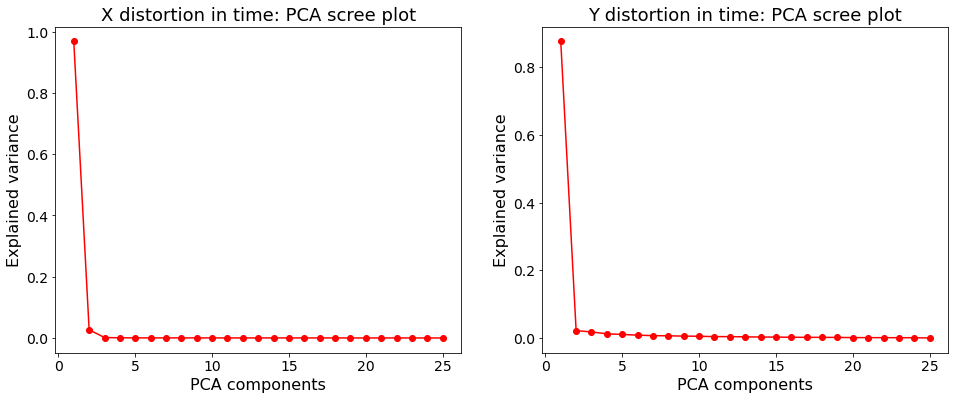

In [ ]:
# Initialize PCA
pca = decomposition.PCA(svd_solver='full')
# "Fit" the data
pca.fit(GP_all_x_r)
# Calculate explained variance
explained_var = pca.explained_variance_ratio_
print('X top 5 variance: ',list(explained_var[0:5]))
# Plot results
fig, ax = plt.subplots(1, 2, figsize=(16, 6))


ax[0].plot(np.arange(1, len(explained_var)+1), explained_var, '-o', c = 'red')
ax[0].set_xlabel('PCA components', fontsize=16)
ax[0].set_ylabel('Explained variance', fontsize=16)
ax[0].set_title('X distortion in time: PCA scree plot', fontsize=18)

# Similarly for Y:
pca.fit(GP_all_y_r)
explained_var = pca.explained_variance_ratio_
print('Y top 5 variance: ', list(explained_var[0:5]))
ax[1].plot(np.arange(1, len(explained_var)+1), explained_var, '-o', c = 'red')
ax[1].set_xlabel('PCA components', fontsize=16)
ax[1].set_ylabel('Explained variance', fontsize=16)
ax[1].set_title('Y distortion in time: PCA scree plot', fontsize=18);

ax[0].tick_params(labelsize = 14)
ax[1].tick_params(labelsize = 14)

Plot the PCA eigenmodes and the associated loading maps

For X distortion

NUMBER OF COMPONENTS: 6


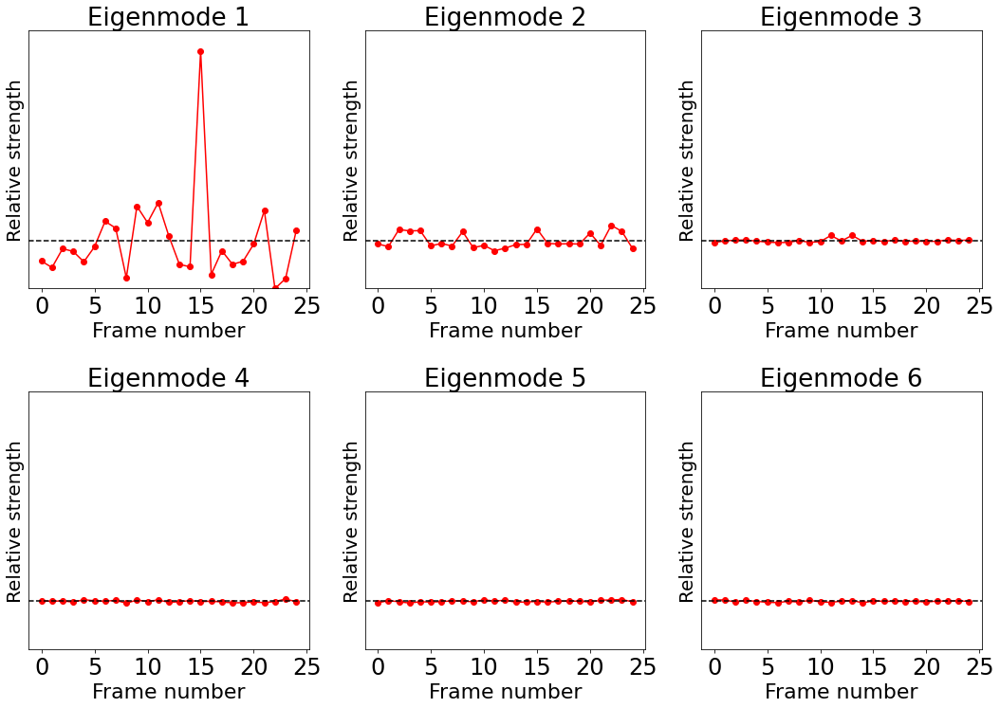

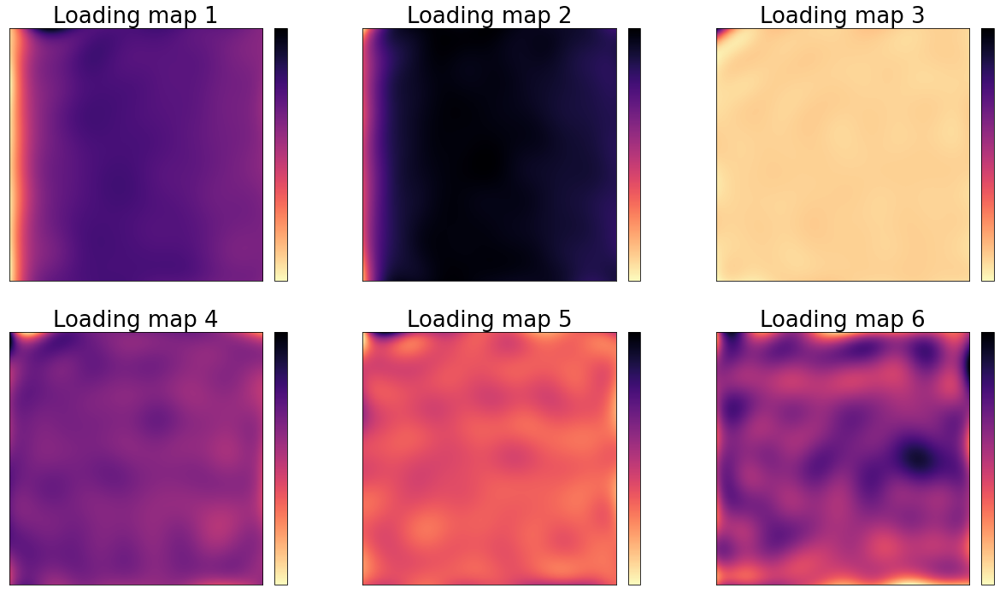

In [ ]:
nc = 6 # specify number of components

figureplot = True # set True for figure quality picture but without fine details. Set False for finer details
img_w, img_h = GP_all_x.shape[1:3]

# pca transformation
pca = decomposition.PCA(n_components=nc)
X_GP_t = pca.fit_transform(GP_all_x_r)
components = pca.components_
components = components.reshape(nc, GP_all_x.shape[1], GP_all_x.shape[2])

# Plot
cols = 3
rows = int(np.ceil(float(nc/cols)))
print('NUMBER OF COMPONENTS: ' + str(nc))
gs1 = gridspec.GridSpec(rows, cols, hspace = 0.4)
fig1 = plt.figure(figsize=(6*cols, 6*rows)) 
# Plotting eigenmodes
for i in range(nc):
    ax1 = fig1.add_subplot(gs1[i])
    # ax1.plot(X_GP_t[:, i], np.arange(len(lengthtest)), '-o', c='red')
    ax1.plot(X_GP_t[:, i], '-o', c='red')
    ax1.set_xlabel('Frame number', fontsize=22)
    ax1.set_ylabel('Relative strength', fontsize=20)
    ax1.set_title('Eigenmode {}'.format(i+1), fontsize=26)
    ax1.set_ylim(-50,220)
    ax1.axhline(0,c='k',ls='--')
    ax1.tick_params(labelsize = 24)
    plt.setp([ax1], yticks=[])
    ax1.set_xticks(np.arange(0,26,5))
# Plotting loading maps    
gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize=(7*cols, 6*rows) ) 
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(components[i,:],
                cmap='magma_r')
    ax2.axis('on')
    ax2.set_title('Loading map {}'.format(i+1), fontsize=26)
    cbar = plt.colorbar(im2, ax=ax2,fraction=0.046, pad=0.04)
    if figureplot == True:
      cbar.set_ticks([])
    plt.setp([ax2], xticks=[], yticks=[])

For Y distortion

NUMBER OF COMPONENTS: 6


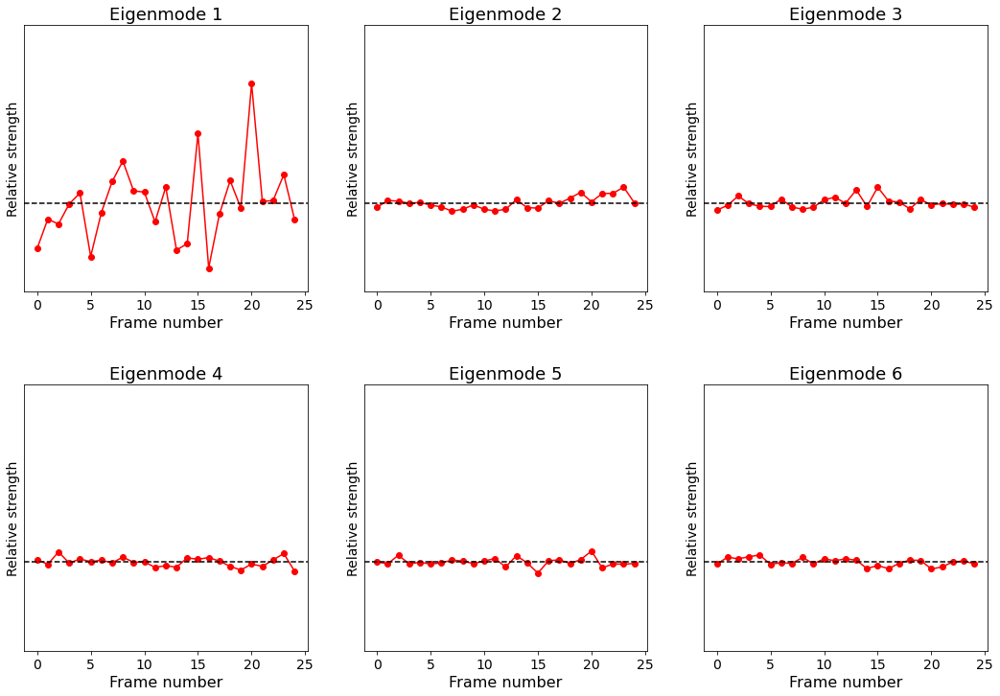

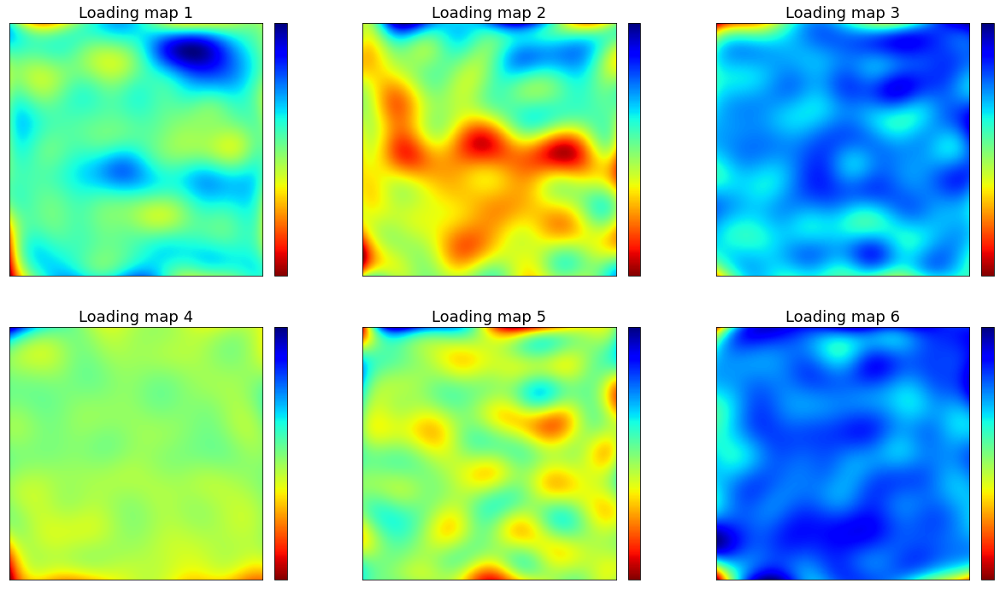

In [ ]:
nc = 6 # specify number of components

figureplot = True # set True for figure quality picture but without fine details. Set False for finer details
img_w, img_h = GP_all_y.shape[1:3]

# pca transformation
pca = decomposition.PCA(n_components=nc)
X_GP_t = pca.fit_transform(GP_all_y_r)
components = pca.components_
components = components.reshape(nc, GP_all_y.shape[1], GP_all_y.shape[2])

# Plot
cols = 3
rows = int(np.ceil(float(nc/cols)))
print('NUMBER OF COMPONENTS: ' + str(nc))
gs1 = gridspec.GridSpec(rows, cols, hspace = 0.35)
fig1 = plt.figure(figsize=(6*cols, 6*rows)) 
# Plotting eigenmodes
for i in range(nc):
    ax1 = fig1.add_subplot(gs1[i])
    # ax1.plot(X_GP_t[:, i], np.arange(len(lengthtest)), '-o', c='red')
    ax1.plot(X_GP_t[:, i], '-o', c='red')
    ax1.set_xlabel('Frame number', fontsize=16)
    ax1.set_ylabel('Relative strength', fontsize=14)
    ax1.set_title('Eigenmode {}'.format(i+1), fontsize=18)
    ax1.set_ylim(-50,100)
    ax1.axhline(0,c='k',ls='--')
    ax1.tick_params(labelsize = 14)
    plt.setp([ax1], yticks=[])
# Plotting loading maps    
gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize=(7*cols, 6*rows) ) 
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(components[i,:],
                cmap='magma_r')
    ax2.axis('on')
    ax2.set_title('Loading map {}'.format(i+1), fontsize=18)
    cbar = plt.colorbar(im2, ax=ax2,fraction=0.046, pad=0.04)
    if figureplot == True:
      cbar.set_ticks([])
    plt.setp([ax2], xticks=[], yticks=[])

NUMBER OF COMPONENTS: 6


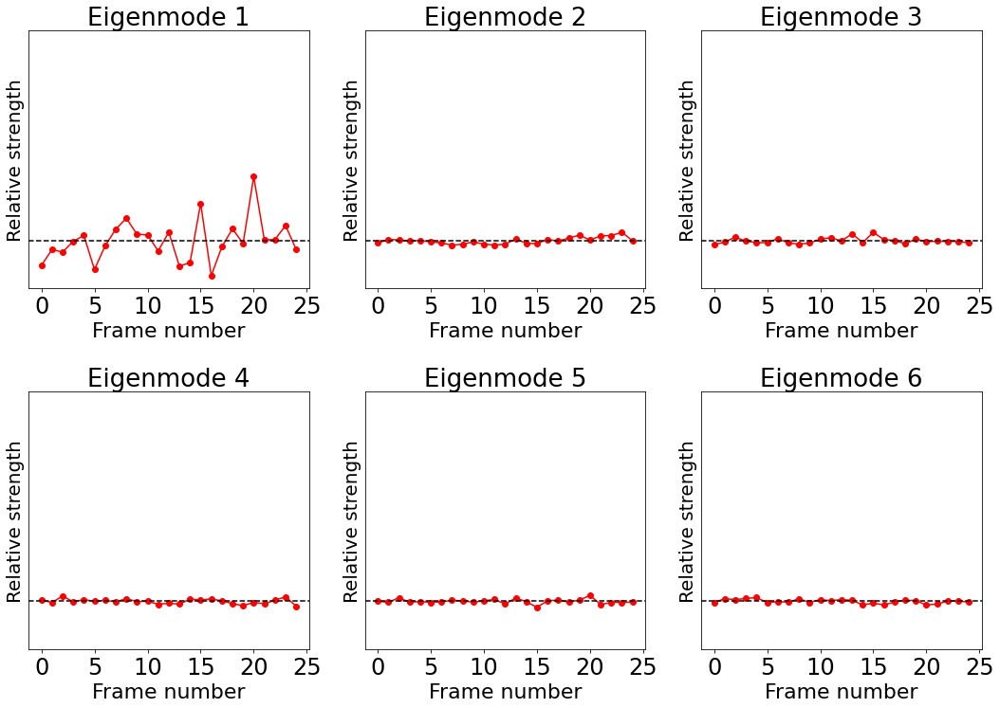

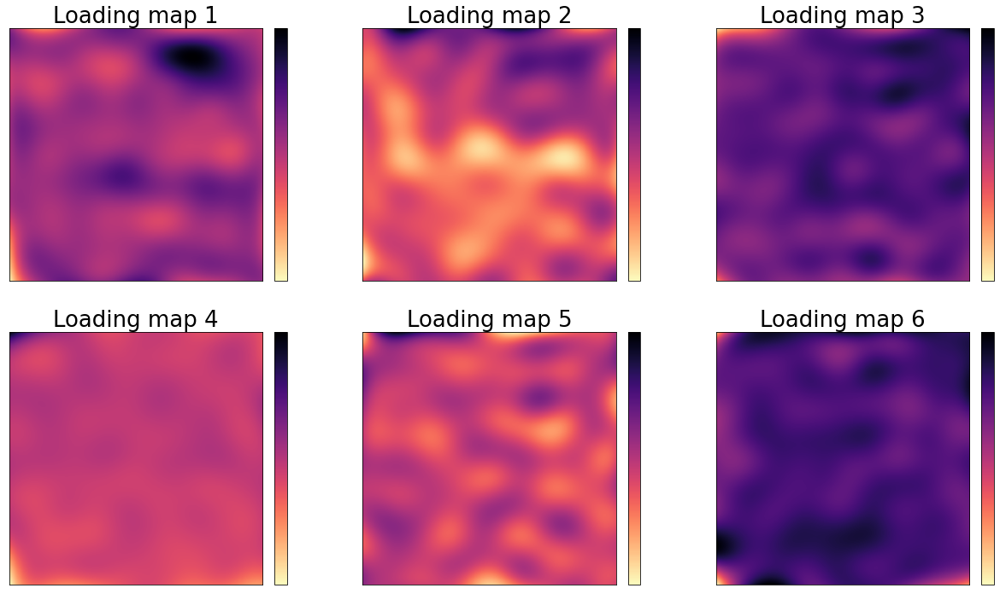

In [ ]:
nc = 6 # specify number of components

figureplot = True # set True for figure quality picture but without fine details. Set False for finer details
img_w, img_h = GP_all_y.shape[1:3]

# pca transformation
pca = decomposition.PCA(n_components=nc)
Y_GP_t = pca.fit_transform(GP_all_y_r)
components = pca.components_
components = components.reshape(nc, GP_all_y.shape[1], GP_all_y.shape[2])

# Plot
cols = 3
rows = int(np.ceil(float(nc/cols)))
print('NUMBER OF COMPONENTS: ' + str(nc))
gs1 = gridspec.GridSpec(rows, cols, hspace = 0.4)
fig1 = plt.figure(figsize=(6*cols, 6*rows)) 
# Plotting eigenmodes
for i in range(nc):
    ax1 = fig1.add_subplot(gs1[i])
    # ax1.plot(Y_GP_t[:, i], np.arange(len(lengthtest)), '-o', c='red')
    ax1.plot(Y_GP_t[:, i], '-o', c='red')
    ax1.set_xlabel('Frame number', fontsize=22)
    ax1.set_ylabel('Relative strength', fontsize=20)
    ax1.set_title('Eigenmode {}'.format(i+1), fontsize=26)
    ax1.set_ylim(-50,220)
    ax1.axhline(0,c='k',ls='--')
    ax1.tick_params(labelsize = 24)
    plt.setp([ax1], yticks=[])
    ax1.set_xticks(np.arange(0,26,5))
# Plotting loading maps    
gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize=(7*cols, 6*rows) ) 
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(components[i,:],
                cmap='magma_r')
    ax2.axis('on')
    ax2.set_title('Loading map {}'.format(i+1), fontsize=26)
    cbar = plt.colorbar(im2, ax=ax2,fraction=0.046, pad=0.04)
    if figureplot == True:
      cbar.set_ticks([])
    plt.setp([ax2], xticks=[], yticks=[])

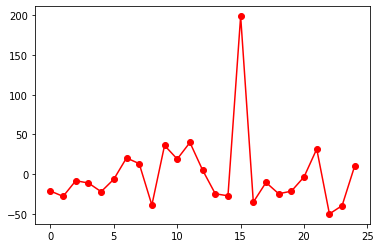

In [ ]:
# Random component visualization

X_GP_t[:,0]
plt.plot(X_GP_t[:, 0], '-o', c='red')

# CHECKPOINT 3 (GP reconstructed)

Load the results of the distortion maps obtained by applying trained GP models:

In [ ]:
!gdown https://drive.google.com/uc?id=1bTred3RfgSnF4JVM_jYvV1sR83j_MMSQ # center start (older version)
!gdown https://drive.google.com/uc?id=1OQlpWqekkzlXp2afrlRBdw8XFs0G56n1
!gdown https://drive.google.com/uc?id=1FxHr1_NOEOxH1U-IpIZb7phjZw5_ncbc # lower right start

# We also need the scalefactor information.
#    we converted previously to show distortion in terms of lattice spacing
#    but now we need to undistort in units of pixels
# In case we did not load that:

!gdown https://drive.google.com/uc?id=1UM1jzlVq032JTp2A28-5jfnT7fbVCHum  # center start
!gdown https://drive.google.com/uc?id=1vVOZJ2UBXbfU8d15VFAP-V_N1LsuP1i6 # short flyback, CENTER start
!gdown https://drive.google.com/uc?id=15_PYuxXDa5U6XIto6tjRuMEuPJqBEwM5 # GP full stack v4

!gdown https://drive.google.com/uc?id=1x8Zbirpitw0YMIya_nO9S06j2hrN9-OH # lower right start
!gdown https://drive.google.com/uc?id=1fuT3ei8Pn_lca768cf1n5HBrXd824WKo # lower right start

# In case we did not load the image data:
!gdown https://drive.google.com/uc?id=1ENrmtL3SQ4PfiDDxUedBsBnQvvHPZm-8 # Short (strong) flyback
!gdown https://drive.google.com/uc?id=1BqmLZi3c2Fb-2hlCR0NkoMpiiX9S8-at # Long (weak) flyback


# LONG flyback data
!gdown https://drive.google.com/uc?id=1nbAdulZHi_XwKYbHQTr1h5gtKHbiErkd  # Long flyback

Downloading...
From: https://drive.google.com/uc?id=1bTred3RfgSnF4JVM_jYvV1sR83j_MMSQ
To: /content/GP_reconstructed_shortflyback33120.npz
52.4MB [00:01, 30.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1OQlpWqekkzlXp2afrlRBdw8XFs0G56n1
To: /content/GP_reconstructed_shortflyback33120_4.npz
52.4MB [00:01, 30.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1FxHr1_NOEOxH1U-IpIZb7phjZw5_ncbc
To: /content/GP_reconstructed_shortflyback33120_LRstart.npz
52.4MB [00:01, 51.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1UM1jzlVq032JTp2A28-5jfnT7fbVCHum
To: /content/GP_full_stack_shortflyback3b.npz
9.33MB [00:00, 25.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=1vVOZJ2UBXbfU8d15VFAP-V_N1LsuP1i6
To: /content/Checkpoint_shortflyback1.npz
124MB [00:03, 33.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=15_PYuxXDa5U6XIto6tjRuMEuPJqBEwM5
To: /content/GP_full_stack_shortflyback4.npz
10.9MB [00:00, 34.4MB/s]
Downloading...
From: https://drive.g

## Correction of distortion
* Here we USE the acquired distortion map in previous steps to undistort a distorted image
* We will first attempt to undistort the first frame using the first frame's distortion map
* Then, to examine temporal behavior, we undistort the first frame using the *last* frame's distortion map

In [ ]:
# Choose saved GP reconstruction data

savedGPrecon = np.load('/content/GP_reconstructed_shortflyback33120_4.npz')
# savedGPrecon = np.load('/content/GP_reconstructed_longflyback33120.npz')

GP_all_x = savedGPrecon['arr_0']
GP_all_y = savedGPrecon['arr_1']
GP_all_x_unc = savedGPrecon['arr_2']  # Don't really need the uncertainties for undistortion
GP_all_y_unc = savedGPrecon['arr_3']  # Don't really need the uncertainties for undistortion

In [ ]:
imgdata = np.load('/content/Recording25 75 4 0 16.npy')
# imgdata = np.load('/content/20-3D Stack_10.npy')

savedGP = np.load('/content/GP_full_stack_shortflyback4.npz', allow_pickle=True)
checkpointfile = np.load('/content/Checkpoint_shortflyback1.npz')

# savedGP = np.load('/content/GP_full_stack_shortflyback3_LRstart.npz', allow_pickle=True)
# checkpointfile = np.load('/content/Checkpoint_shortflyback1_LRstart.npz')

# Other parameters

scalefactor_all = savedGP['arr_7']
nnd_aver = checkpointfile['arr_8']
bestfit_ideal_all = checkpointfile['arr_6']
optimized_params_all = checkpointfile['arr_5']

Frame 1

It may be helpful to check **overlay** of the distortion map with the distorted image itself:

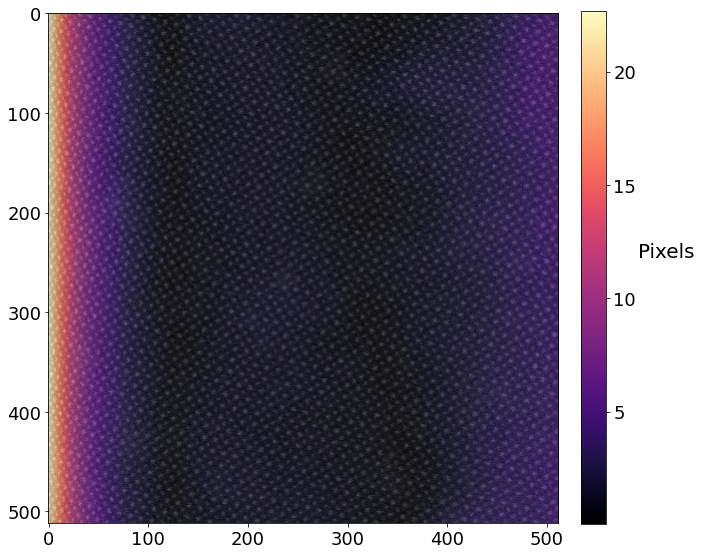

In [ ]:
ii = 0  # Frame select

in_pixel = True

colormap = 'magma'

fig,ax = plt.subplots(1,1,figsize=(10,10))
if in_pixel == True:
  im0 = ax.imshow(resize(np.sqrt(GP_all_x[ii]**2+GP_all_y[ii]**2)*scalefactor_all[ii], (imgdata[ii].shape[0],imgdata[ii].shape[1])), cmap = colormap);
  scaleunits, pad = "Pixels", 30
else:
  im0 = ax.imshow(resize(np.sqrt(GP_all_x[ii]**2+GP_all_y[ii]**2), (imgdata[ii].shape[0],imgdata[ii].shape[1])), cmap = colormap);
  scaleunits, pad = "Lattice \nconstants", 60

ax.imshow(imgdata[ii],cmap='gray')
ax.tick_params(labelsize=18)
ax.imshow(resize(np.sqrt(GP_all_x[ii]**2+GP_all_y[ii]**2), (imgdata[ii].shape[0],imgdata[ii].shape[1])), cmap = colormap, alpha = 0.7);
cbar = plt.colorbar(im0,fraction=0.046, pad=0.04)
cbar.set_label('{}'.format(scaleunits), labelpad = pad, y = 0.55,fontsize = 20, rotation = 0)
cbar.ax.tick_params(labelsize=18)

In [ ]:
ii = 0 # image select
jj = 0 # distortion map select

img2coords_undistorted, img2coords_distorted, corrected_image = undistort(imgdata[ii], GP_all_x[jj], GP_all_y[jj], scalefactor_all[jj],)

[]

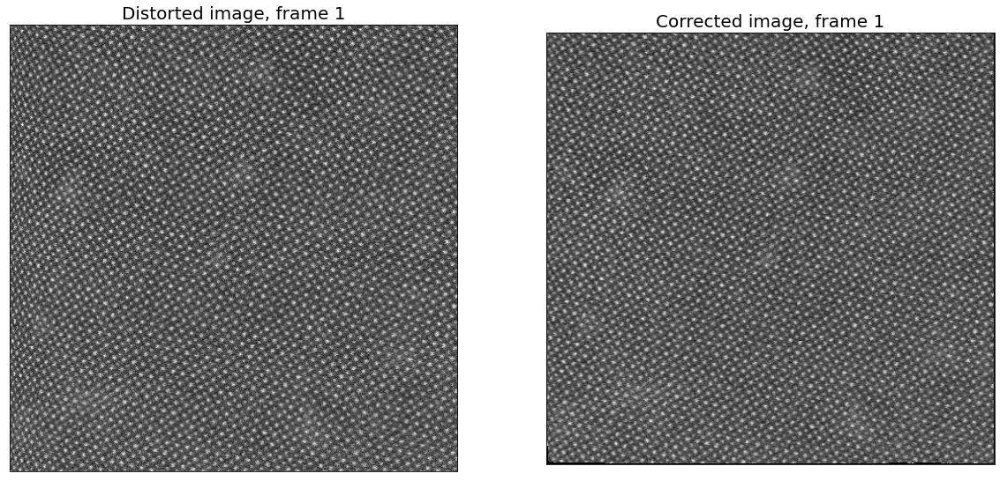

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(20,10))
colormap = 'gray'
ax[0].imshow(imgdata[ii], cmap = colormap)
ax[1].imshow(corrected_image, cmap = colormap, vmin = np.min(imgdata[ii]), vmax = np.max(imgdata[ii]))

ax[0].set_title("Distorted image, frame {}".format(ii+1), fontsize=20)
ax[1].set_title("Corrected image, frame {}".format(jj+1), fontsize=20)

plt.setp([ax[0],ax[1]],xticks=[], yticks=[])

It is instructive to show the DISTORTED image with apparent and actual beam positions

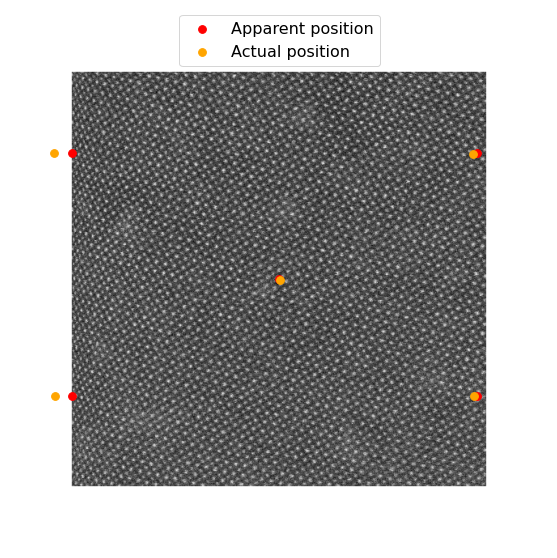

In [ ]:
# select various coordinate pairs for view, packaged in m and n

m, n = [0, 0, 256, 500, 500], [100, 400, 256, 100, 400]

fig,ax = plt.subplots(1,1,figsize=(10,10))
pad = 80
ax.imshow(np.pad(imgdata[ii], pad, mode = 'constant', constant_values = 1), alpha = 1, cmap = 'gray')
# ax.scatter(img2coords_distorted[:,:,0]+pad, img2coords_undistorted[:,:,1]+pad, c=img2coords_undistorted[:,:,2], s=1, cmap = 'gray')

ax.scatter(img2coords_distorted[m,n,0]+pad, img2coords_distorted[m,n,1]+pad, c='r', facecolors = 'none', s = 60, label = 'Apparent position')
ax.scatter(img2coords_undistorted[m,n,0]+pad, img2coords_undistorted[m,n,1]+pad, c='orange', s = 60, label = 'Actual position')
ax.legend(bbox_to_anchor = (0.7,1), fontsize=16)
ax.axis('off')
plt.setp([ax],xticks=[], yticks=[]);

For a zoomed in view:

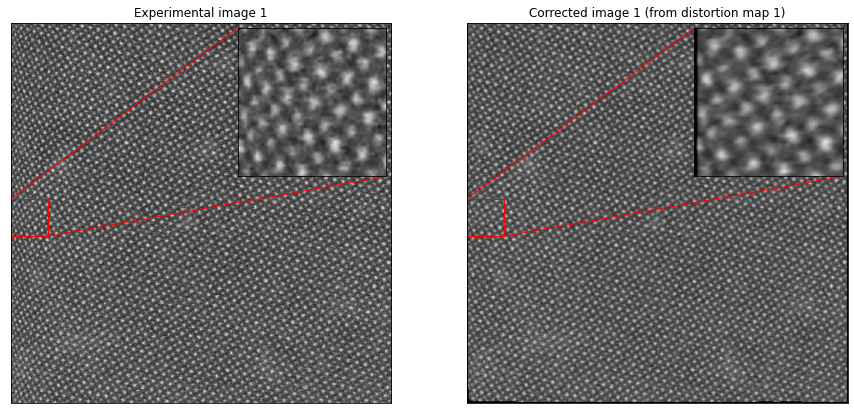

In [ ]:
k = 0  # frame to vizualize

# Parameters for zoomins
zmx1, zmx2 = 0, 100
zmy1, zmy2 = 450, 550 
extent =(0, imgdata.shape[1]*2, 0, imgdata.shape[2]*2)

# do plotting
fig, ax = plt.subplots(1, 2, figsize = (15, 12))
ax[0].imshow(imgdata[k,: , :], extent=extent, cmap = 'gray')
ax[0].set_title('Experimental image {}'.format(k+1))
ax[1].imshow(corrected_image, extent=extent, Interpolation = 'Gaussian', cmap = 'gray', vmin=np.min(imgdata[ii]), vmax=np.max(imgdata[ii]))
ax[1].set_title('Corrected image {} (from distortion map {})'.format(k+1, jj+1))
axins_00 = zoomed_inset_axes(ax[0], 4, loc=1)
axins_00.imshow(imgdata[k,:,:], extent=extent, cmap='gray', Interpolation='Gaussian')
axins_00.set_xlim(zmx1, zmx2)
axins_00.set_ylim(zmy1, zmy2)
axins_00.set_xticks([])
axins_00.set_yticks([])
mark_inset(ax[0], axins_00, loc1=2, loc2=4, fc="none", ec="r")
axins_01 = zoomed_inset_axes(ax[1], 4, loc=1)
axins_01.imshow(corrected_image, extent=extent, Interpolation='Gaussian', cmap = 'gray', vmin=np.min(imgdata[ii]), vmax=np.max(imgdata[ii]))
# axins_01.set_edgecolor('green')
axins_01.set_xlim(zmx1, zmx2)
axins_01.set_ylim(zmy1, zmy2)
axins_01.set_xticks([])
axins_01.set_yticks([])
mark_inset(ax[1], axins_01, loc1=2, loc2=4, fc="none", ec="r")
for ax_ in fig.axes:
    ax_.set_xticks([])
    ax_.set_yticks([])

## Various frame combinations

As an example, let us apply distortion functions learned from different frames to images in the stack, where $DF$ means distortion function and $k$ is the frame number
* DF(k=1) applied to Image 1
* DF(k=25) applied to Image 1
* DF(k=25) applied to Image 13

In [ ]:
import warnings
warnings.filterwarnings("ignore")   # suppresses warnings arising from indexing

In [ ]:
# Select image frame number (f), and distortion frame (d)

Batch 1/1
1 image was decoded in approximately 1.3585 seconds
Batch 1/1
Refining atomic positions... Done

1 image was decoded in approximately 26.1937 seconds


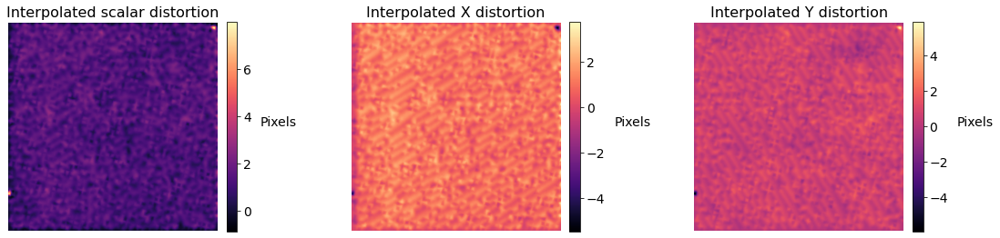

In [ ]:
f, d = 0, 0   
colormap = 'magma'

plt.figure(figsize=(13,2))
plt.text(0.5,0.5, "DF {} applied to Image {}".format(d+1, f+1), fontsize = 24)
plt.axis('off')
# xydist_f0d0, xdist_f0d0, ydist_f0d0 = analyze_correction(imgdata[f], GP_all_x[d], 
#                                                         GP_all_y[d], scalefactor_all[d], 
#                                                         pixthresh = 1, intensitythresh = 0.2,
#                                                         colormap = 'magma')

xydist_f0d0, xdist_f0d0, ydist_f0d0 = analyze_correction(imgdata[f], GP_all_x[d], 
                                                        GP_all_y[d], scalefactor_all[d], 
                                                        pixthresh = 1, intensitythresh = 0.2,
                                                        colormap = colormap)


                                                        
np.save("xydist_f0d0.npy", xydist_f0d0)
np.save("xdist_f0d0.npy", xdist_f0d0)
np.save("ydist_f0d0.npy", ydist_f0d0)

Batch 1/1
1 image was decoded in approximately 1.2499 seconds
Batch 1/1
Refining atomic positions... Done

1 image was decoded in approximately 25.0684 seconds


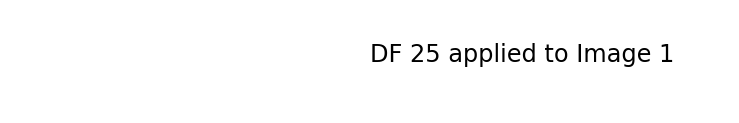

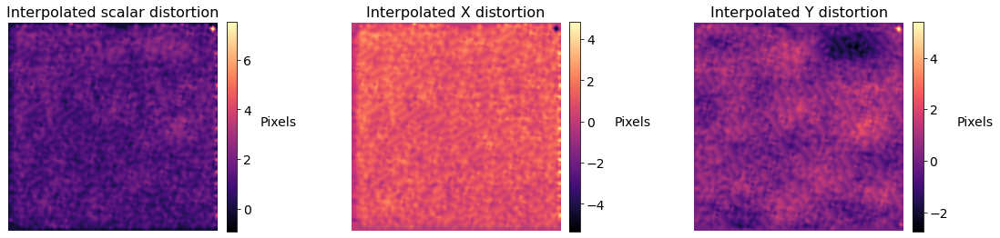

In [ ]:
f, d = 0, 24
colormap = 'magma'

plt.figure(figsize=(13,2))
plt.text(0.5,0.5, "DF {} applied to Image {}".format(d+1, f+1), fontsize = 24)
plt.axis('off')
xydist_f0d24, xdist_f0d24, ydist_f0d24 = analyze_correction(imgdata[f], GP_all_x[d], 
                                                            GP_all_y[d], scalefactor_all[d], 
                                                            pixthresh = 1, intensitythresh = 0.2,
                                                            colormap = colormap)

np.save("xydist_f0d24.npy", xydist_f0d24)
np.save("xdist_f0d24.npy", xdist_f0d24)
np.save("ydist_f0d24.npy", ydist_f0d24)

Batch 1/1
1 image was decoded in approximately 1.2264 seconds
Batch 1/1
Refining atomic positions... Done

1 image was decoded in approximately 24.893 seconds


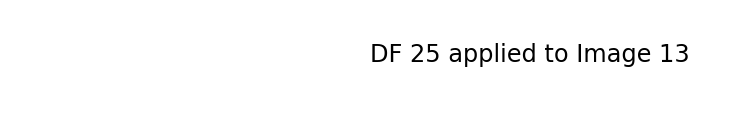

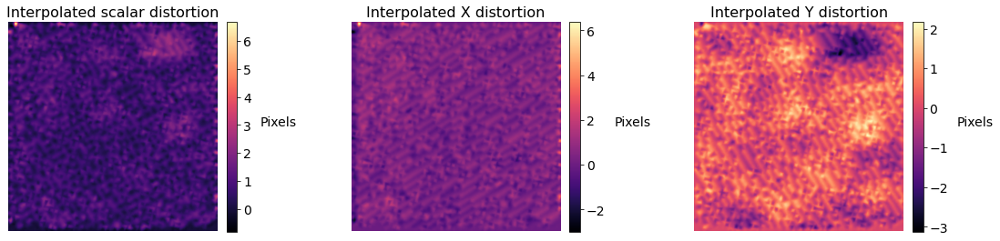

In [ ]:
f, d = 12, 24
colormap = 'magma'

plt.figure(figsize=(13,2))
plt.text(0.5,0.5, "DF {} applied to Image {}".format(d+1, f+1), fontsize = 24)
plt.axis('off')
xydist_f12d24, xdist_f12d24, ydist_f12d24 = analyze_correction(imgdata[f], GP_all_x[d], 
                                                            GP_all_y[d], scalefactor_all[d], 
                                                            pixthresh = 1, intensitythresh = 0.2,
                                                            colormap = colormap)

np.save("xydist_f12d24.npy", xydist_f12d24)
np.save("xdist_f12d24.npy", xdist_f12d24)
np.save("ydist_f12d24.npy", ydist_f12d24)

Distortion correction overview figure:

In [ ]:
# Re-initialize some variables for plotting:

ii = 0 # image select
jj = 0 # distortion map select

img2coords_undistorted, img2coords_distorted, corrected_image = undistort(imgdata[ii], GP_all_x[jj], GP_all_y[jj], scalefactor_all[jj],)

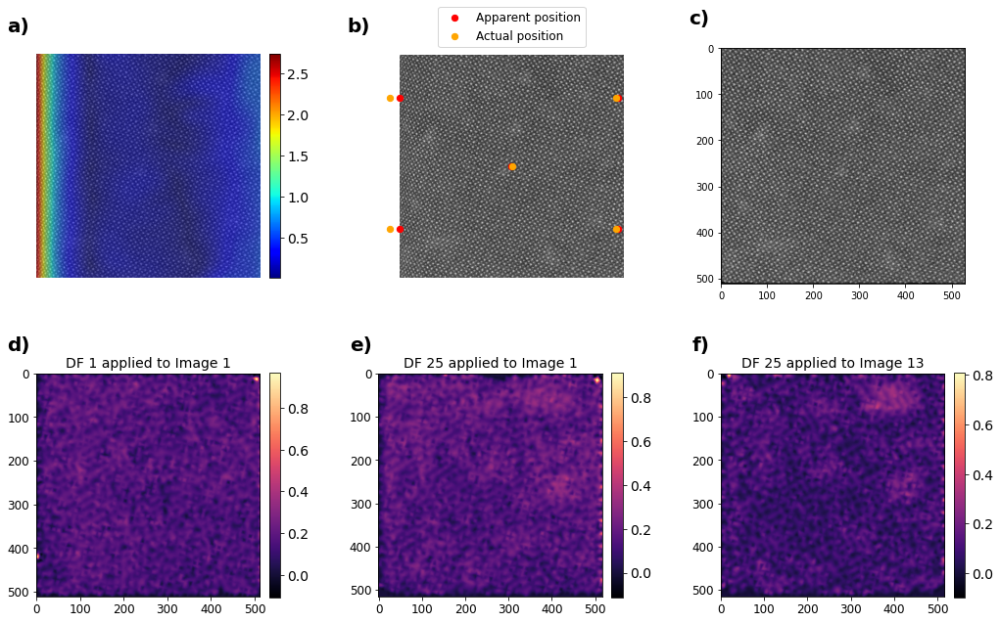

In [ ]:
in_pixels = False

figscale = 2.2
plt.figure(figsize=(int(figscale*8),int(figscale*5)))
gs=gridspec.GridSpec(2,3, wspace = 0.4)
ax00, ax01, ax02 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2])
ax10, ax11, ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])

colormap = 'magma'

ii = 0
if in_pixels == True:
  im00 = ax00.imshow(resize(np.sqrt(GP_all_x[ii]**2+GP_all_y[ii]**2)*scalefactor_all[ii], (imgdata[ii].shape[0],imgdata[ii].shape[1])), cmap = 'jet');
else:
  im00 = ax00.imshow(resize(np.sqrt(GP_all_x[ii]**2+GP_all_y[ii]**2), (imgdata[ii].shape[0],imgdata[ii].shape[1])), cmap = 'jet');

ax00.imshow(imgdata[0], cmap = 'gray')
ax00.imshow(resize(np.sqrt(GP_all_x[ii]**2+GP_all_y[ii]**2), (imgdata[ii].shape[0],imgdata[ii].shape[1])), cmap = 'jet', alpha = 0.5);

cbar00 = plt.colorbar(im00,ax=ax00,fraction=0.046, pad=0.04)
cbar00.ax.tick_params(labelsize=14)
ax00.axis('off')

if in_pixels == True:
  im10 = ax10.imshow(xydist_f0d0, cmap = colormap)
  im11 = ax11.imshow(xydist_f0d24, cmap = colormap)
  im12 = ax12.imshow(xydist_f12d24, cmap = colormap)
else:
  im10 = ax10.imshow(xydist_f0d0/scalefactor_all[ii], cmap = colormap)
  im11 = ax11.imshow(xydist_f0d24/scalefactor_all[ii], cmap = colormap)
  im12 = ax12.imshow(xydist_f12d24/scalefactor_all[ii], cmap = colormap)
ax10.set_title("DF 1 applied to Image 1", fontsize = 14)
ax11.set_title("DF 25 applied to Image 1", fontsize = 14)
ax12.set_title("DF 25 applied to Image 13", fontsize = 14)
ax10.tick_params(labelsize=12)
ax11.tick_params(labelsize=12)
ax12.tick_params(labelsize=12)
cbar10 = plt.colorbar(im10,ax=ax10,fraction=0.046, pad=0.04)
cbar11 = plt.colorbar(im11,ax=ax11,fraction=0.046, pad=0.04)
cbar12 = plt.colorbar(im12,ax=ax12,fraction=0.046, pad=0.04)

# cbar00.set_label("Pixels", labelpad = pad, y = 0.55,fontsize = 16, rotation = 0)
# cbar10.set_label("Pixels", labelpad = pad, y = 0.55,fontsize = 16, rotation = 0)
# cbar11.set_label("Pixels", labelpad = pad, y = 0.55,fontsize = 16, rotation = 0)
# cbar12.set_label("Pixels", labelpad = pad, y = 0.55,fontsize = 16, rotation = 0)

cbar10.ax.tick_params(labelsize=14)
cbar11.ax.tick_params(labelsize=14)
cbar12.ax.tick_params(labelsize=14)


# select various coordinate pairs for view, packaged in m and n
m, n = [0, 0, 256, 500, 500], [100, 400, 256, 100, 400]
pad = 0
ax01.imshow(np.pad(imgdata[0], pad, mode = 'constant', constant_values = 1), alpha = 1, cmap = 'gray')
ax01.scatter(img2coords_distorted[m,n,0]+pad, img2coords_distorted[m,n,1]+pad, c='r', facecolors = 'none', s = 40, label = 'Apparent position')
ax01.scatter(img2coords_undistorted[m,n,0]+pad, img2coords_undistorted[m,n,1]+pad, c='orange', s = 40, label = 'Actual position')
ax01.legend(bbox_to_anchor = (0.87,1.24), fontsize=12)
ax01.axis('off')

ax02.imshow(corrected_image, cmap = 'gray', vmin = np.min(imgdata[0]), vmax = np.max(imgdata[0]))
plt.setp([ax01],xticks=[], yticks=[]);

axs = [ax00, ax01, ax02, ax10, ax11, ax12]
for n, ax in enumerate(axs): 
    ax.text(-0.13, 1.1, "{})".format(string.ascii_lowercase[n]), transform=ax.transAxes, 
            size=20, weight='bold')

## Analysis of corrected images

Try running atom finding and analyze histograms from it

In [ ]:
# Redo frame 1 using distortion from frame 1

ii = 0 # image select
jj = 0 # distortion map select

img2coords_undistorted, img2coords_distorted, corrected_image = undistort(imgdata[ii], GP_all_x[jj], GP_all_y[jj], scalefactor_all[jj])

In [ ]:
corrected_image1 = np.reshape(corrected_image, (1, corrected_image.shape[0], corrected_image.shape[1]))

# load a pre-trained network; select symmetry
model = dcnn.load_torchmodel('cubic')

# Make a prediction without refinement
nn_input, (img_dec, coord) = aoi.atomnet.predictor(
    corrected_image1, model, refine=False, logits=False, use_gpu=True).run()

# # Make a prediction with refinement. Use ‘d’ argument to define a half-size of a window
# # around each predicted coordinate where refinement is performed (it defaults to 1/3 of NN distance when not specified)
nn_input, (img_dec, coord_r) = aoi.atomnet.predictor(
    corrected_image1, model, refine=True, d=4, logits=False, use_gpu=True).run()
    

/usr/local/lib/python3.6/dist-packages/atomai/atomnet.py:443: UserWarning: The output of predictor.run() has changed from 'nn_input, nn_output' to 'nn_input, (nn_output, coordinates)'. Example: 'nn_input, (nn_output, coordinates) = predictor(args).run()'
  warnings.warn(warn_msg, UserWarning)


1 image was decoded in approximately 0.0542 seconds
1 image was decoded in approximately 0.0501 seconds
Refining atomic positions... Done


In [ ]:
coord_r_cor_f0_d0, _ = refinementcorrection(coord, coord_r, corrected_image1, pixthreshold = 1, intensitythresh = 0.2)

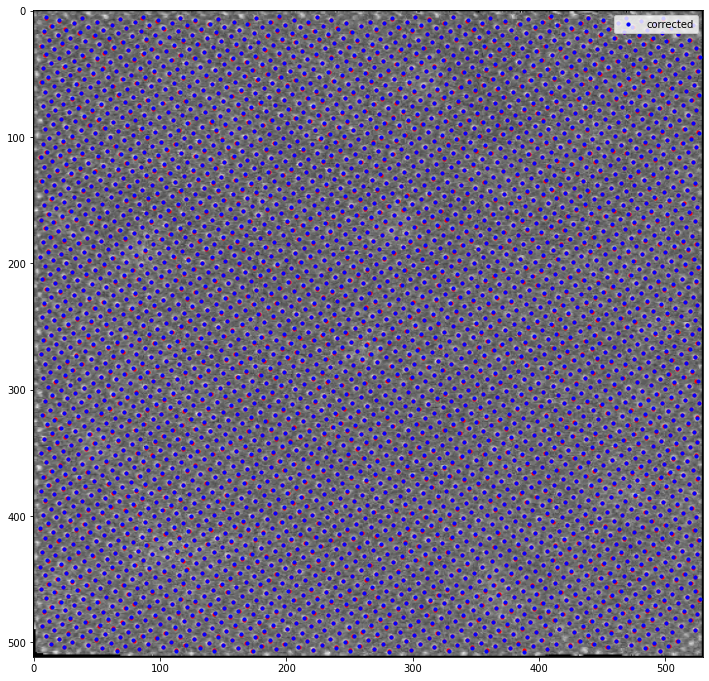

In [ ]:
k = 0
plt.figure(figsize=(12, 12))
plt.imshow(corrected_image1[k], cmap='gray'),
plt.scatter(coord[k][:, 1], coord[k][:, 0], c='r', s=10)
plt.scatter(coord_r_cor_f0_d0[k][:, 1], coord_r_cor_f0_d0[k][:, 0], c='b', label='corrected', s=10)
plt.legend(loc='upper right')

In [ ]:
distances_all_cor_f0_d0 = []
checked_coord_cor_f0_d0 = []
for i1, c in enumerate(coord_r_cor_f0_d0[0][:,:2]):
    d, i2 = spatial.cKDTree(coord_r_cor_f0_d0[0][:,:2]).query(c, k=2)
    if tuple((i2[-1], i1)) not in checked_coord_cor_f0_d0:
        checked_coord_cor_f0_d0.append(tuple((i1, i2[-1])))
        distances_all_cor_f0_d0.append(d[-1])
nnd_aver_cor_f0_d0 = np.mean(distances_all_cor_f0_d0)
nnd_aver_cor_f0_d0

7.843700643287095

and plot it:

(4.521966285239693, 9.051002765871667)

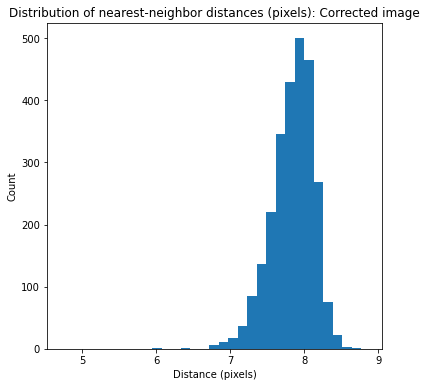

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6,6))
_ = ax.hist(distances_all_cor_f0_d0, bins=50)
ax.set_title('Distribution of nearest-neighbor distances (pixels): Corrected image')
ax.set_xlabel('Distance (pixels)')
ax.set_ylabel('Count');
ax.set_xlim(4.521966285239693,9.051002765871667)

If we have the variable from beginning of notebook still active:

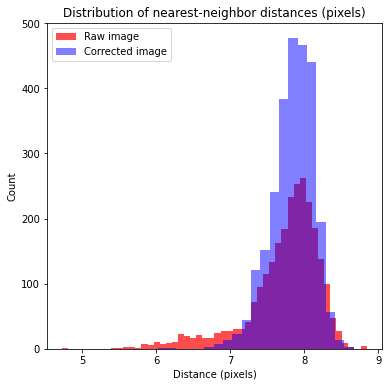

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(6,6))
_ = ax.hist(distances_all, bins=50, color='r', alpha = 0.7, label = 'Raw image')
_ = ax.hist(distances_all_cor_f0_d0, bins=50, color = 'b', alpha = 0.5, label = 'Corrected image')
ax.set_title('Distribution of nearest-neighbor distances (pixels)')
ax.set_xlabel('Distance (pixels)')
ax.set_ylabel('Count');
ax.set_xlim(4.521966285239693,9.051002765871667)
ax.legend()

## In depth analysis of the correction
* Here we simply repeat the indexing and distortion mapping to have a better representation of the effectiveness of correction performance
* Note, the following steps are packaged into a single function (analyze_correction) which is used above in the "Various frame combinations" tab. 
* The folloowing cells simply show the process in detail

In [ ]:
kk = 0 
atomcoords_cor = np.zeros((coord_r_cor_f0_d0[kk].shape[0], 2))
for ii in range(coord_r_cor_f0_d0[kk].shape[0]):
  atomcoords_cor[ii,0] = coord_r_cor_f0_d0[kk][ii,0]
  atomcoords_cor[ii,1] = coord_r_cor_f0_d0[kk][ii,1]

* Get the rotation angle

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:632: RuntimeWarning: invalid value encountered in long_scalars


58.57

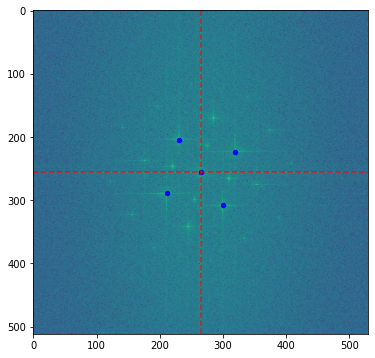

In [ ]:
angles,spacings = extract_lattice_params(corrected_image1[0], plot  = True)
angle = angles[0]
angle

* Choose start location for indexing (normally the center of the image)

In [ ]:
# find atom closest to center of image
startloc_ = int(round(corrected_image1[0].shape[0]/2)), int(round(corrected_image1[0].shape[1]/2))
atomdistances_cor = np.zeros((atomcoords_cor.shape[0]))
for ii in range(atomcoords_cor.shape[0]):
  atomdistances_cor[ii] = np.sqrt((atomcoords_cor[ii,0] - startloc_[0])**2 + (atomcoords_cor[ii,1] - startloc_[1])**2)
startloc_center = atomcoords_cor[np.nanargmin(atomdistances_cor)][1], atomcoords_cor[np.nanargmin(atomdistances_cor)][0]


# find atom in lower right quadrant (as an example)
startloc_ = int(round(3*corrected_image1[0].shape[0]/4)), int(round(3*corrected_image1[0].shape[1]/4))
atomdistances_cor = np.zeros((atomcoords_cor.shape[0]))
for ii in range(atomcoords_cor.shape[0]):
  atomdistances_cor[ii] = np.sqrt((atomcoords_cor[ii,0] - startloc_[0])**2 + (atomcoords_cor[ii,1] - startloc_[1])**2)
startloc_lowerright = atomcoords_cor[np.nanargmin(atomdistances_cor)][1], atomcoords_cor[np.nanargmin(atomdistances_cor)][0]

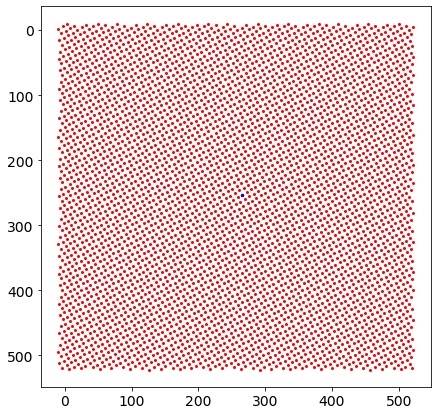

In [ ]:
startloc = startloc_center
# startloc = startloc_lowerright

iters = 100  # Must be multiple of 4
imgsize = 512

idealcoordinates_cor = generate_ideal_lattice_square(startloc, angle, nnd_aver_cor_f0_d0, 
                                                     offset=10, iters = iters, imgsize = imgsize,
                                                     plot = True, axisdisplay = True)

Check overlay on image and overlay on ideal coordinates

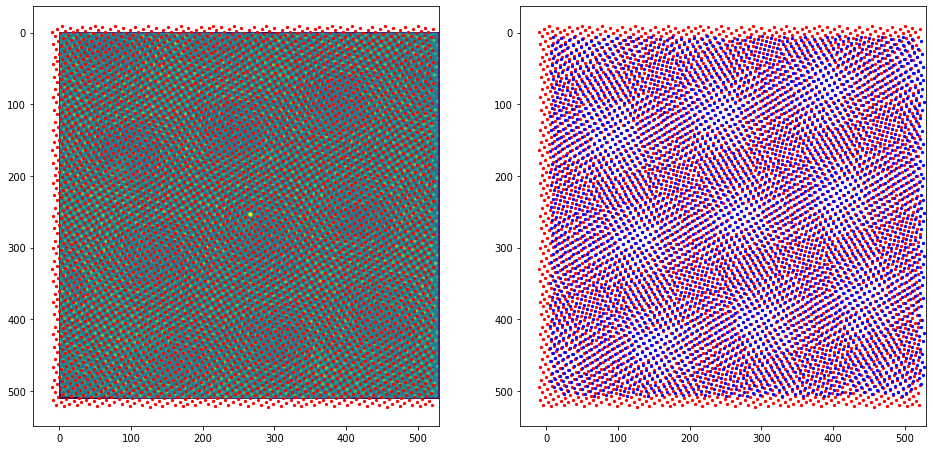

In [ ]:
f,ax= plt.subplots(1,2,figsize=(16,8))
ax[0].imshow(corrected_image1[0])
ax[0].scatter(idealcoordinates_cor[:,:,0], idealcoordinates_cor[:,:,1], c='r', s = 5)
ax[0].scatter(startloc[0], startloc[1], c='yellow', s=10);

ax[1].imshow(corrected_image1[0], alpha = 0.01)
ax[1].scatter(idealcoordinates_cor[:,:,0], idealcoordinates_cor[:,:,1], c='r', s=5)
ax[1].scatter(atomcoords_cor[:,1], atomcoords_cor[:,0], c = 'b', s = 5)

In [ ]:
for kk in range(coord_r_cor_f0_d0.shape[0]):
  for ii in range(coord_r_cor_f0_d0[kk].shape[0]):
    if coord_r_cor_f0_d0[kk][ii,0] == 0 and coord_r_cor_f0_d0[kk][ii,1] == 0:
      coord_r_cor_f0_d0[kk][ii] = np.nan, np.nan, np.nan

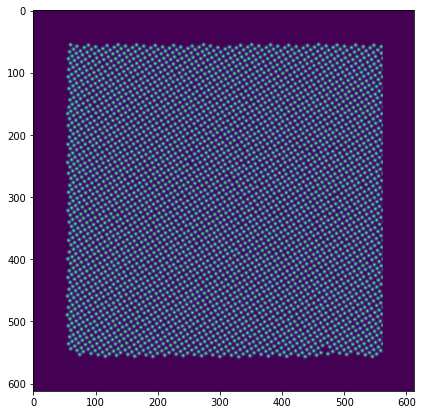

In [ ]:
# Take a few minutes to generate the distorted images
distorted_gaussians_cor, distorted_gaussians_cor_padded = generate_gaussian_image_padded(atomcoords_cor)

Indexing

In [ ]:
distorted_coords_cor = index_atoms_NEW(distorted_gaussians_cor_padded, idealcoordinates_cor,
                                   startloc, nnd_aver_cor_f0_d0, angle, thresholdangle = 40,
                                   windowsize = 30, padwidth = 50, gaussthresh = 0.3, thresh = 3,
                                   dfactor = 3, threshold42 = 3, gauss_size = 3, newpos_thresh = 7,
                                   newpos_close = 4, threshold43 = 2, newpos_thresh2 = 8)

# Ignore the RuntimeWarnings below
# Refer to the function definition for help on what these function variables mean and do

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:521: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:314: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:330: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:331: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:349: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:350: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:617: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1083: RuntimeWarning: invalid value encountered in double

In [ ]:
# Find local minimum by varying alpha and delta parameters
# Our guess starts at (0,0) meaning no perturbations applied to the angle or lattice spacing 
# (we don't know which way + or - they should go)

guess = (0,0)
optimized_params_cor = minimize(minimize_distance, guess, args=(distorted_coords_cor, idealcoordinates_cor, startloc), method = 'nelder-mead')

[]

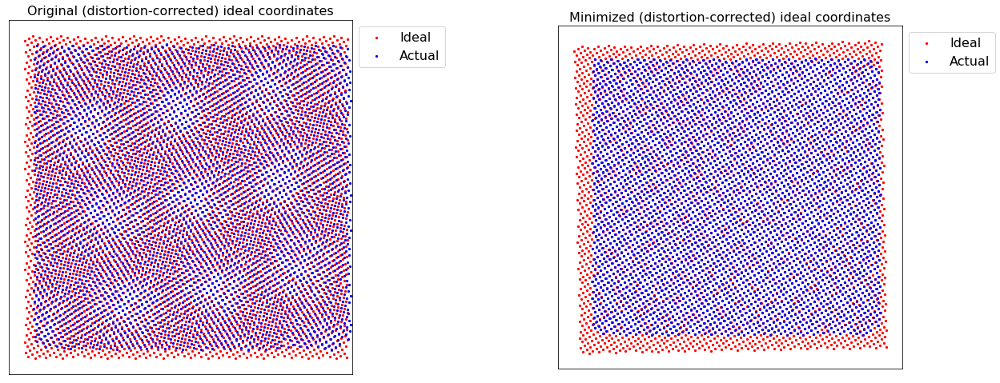

In [ ]:
bestfit_ideal_cor = modify_lattice(startloc, idealcoordinates_cor, optimized_params_cor['x'][0], optimized_params_cor['x'][1])

plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1,2, wspace = 0.6)
ax1 = plt.subplot(gs[0])
ax2 = plt.subplot(gs[1])

ax1.imshow(corrected_image1[0], alpha= 0.01)
ax1.scatter(idealcoordinates_cor[:,:,0], idealcoordinates_cor[:,:,1],c='r',s=5, label = 'Ideal')
ax1.scatter(atomcoords_cor[:,1], atomcoords_cor[:,0], c = 'b', s = 5, label='Actual')
ax1.legend(bbox_to_anchor=(1.0,1.0), fontsize = 16)
ax1.tick_params(labelsize=14)


ax2.imshow(corrected_image1[0], alpha= 0.01)
ax2.scatter(bestfit_ideal_cor[:,:,0], bestfit_ideal_cor[:,:,1],c='r',s=5, label='Ideal')
ax2.scatter(atomcoords_cor[:,1], atomcoords_cor[:,0], c = 'b', s = 5, label='Actual')
# ax2.scatter(distorted_coords_cor[:,:,0], distorted_coords_cor[:,:,1], c = 'b', s = 5, label='real')
ax2.legend(bbox_to_anchor=(1.0,1.0), fontsize = 16)
ax2.tick_params(labelsize=14)

ax1.set_title('Original (distortion-corrected) ideal coordinates', fontsize = 16)
ax2.set_title('Minimized (distortion-corrected) ideal coordinates', fontsize = 16);

plt.setp([ax1,ax2], xticks=[], yticks=[])

* Do a quick view of the displacement map (interpolation done here)

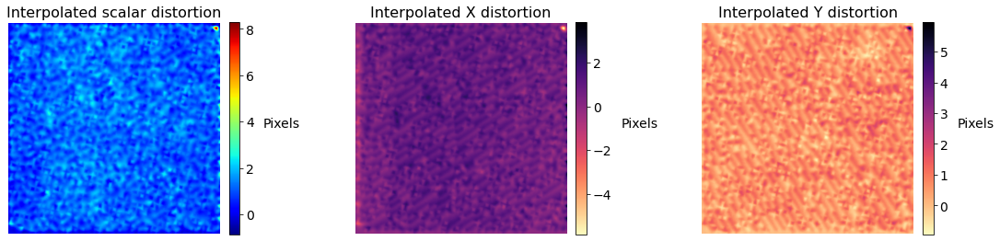

In [ ]:
xydistortion_cor_f0d0, xdistortion_cor_f0d0, ydistortion_cor_f0d0 = displacement_interp(corrected_image1[0], 
                                                                                        distorted_coords_cor, 
                                                                                        bestfit_ideal_cor, 
                                                                                        nnd_aver_cor_f0_d0, 
                                                                                        optimized_params_cor, 
                                                                                        units = "pixels");

# (extra) Lower right start indexing (frame 0)

In [ ]:
k = 0  # ONLY ON FRAME k


# load a pre-trained network; select symmetry
model = dcnn.load_torchmodel('cubic')

# Make a prediction without refinement
img_dec, coord = aoi.atomnet.predictor(model, refine=False, logits=False, use_gpu=True).run(imgdata[k])

# # Make a prediction with refinement. Use ‘d’ argument to define a half-size of a window
# # around each predicted coordinate where refinement is performed (it defaults to 1/3 of NN distance when not specified)
img_dec, coord_r = aoi.atomnet.predictor(model, refine=True, d = 4, logits=False, use_gpu=True).run(imgdata[k])

/usr/local/lib/python3.7/dist-packages/atomai/atomnet/infer.py:163: UserWarning: The default output of predictor.decode() and predictor.run() is now ```nn_output, coords``` instead of ```nn_input, (nn_output, coords)```
  warnings.warn(warn_msg, UserWarning)


Batch 1/1
1 image was decoded in approximately 0.0937 seconds
Batch 1/1
Refining atomic positions... Done

1 image was decoded in approximately 22.2904 seconds


Corrections to refined postions

* If refined positions are $x$ distance from the unrefined position, don't use refined --> default to unrefined position
* Also, in the original normalized image: if the average pixel intensity in a small region around each coordinate in the real image is less than some value, this coordinate is thrown out. Dubbed a "false positive" in this case. Default is 0.2  

Number of atoms corrected in each frame:  [6.]


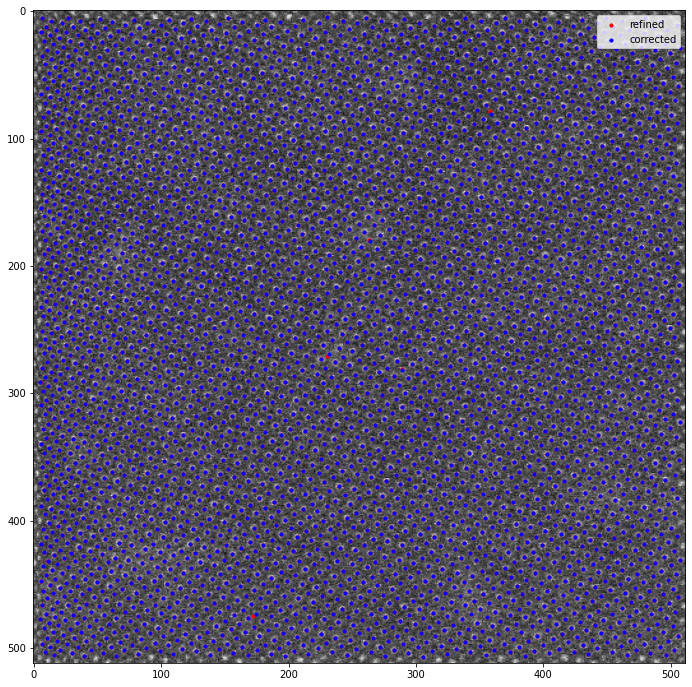

In [ ]:
coord_r_cor, numreverts = refinementcorrection(coord, coord_r, imgdata, pixthreshold = 1, intensitythresh = 0.2)

k = 0
plt.figure(figsize=(12, 12))
plt.imshow(imgdata[k], cmap='gray'),
plt.scatter(coord_r[k][:, 1], coord_r[k][:, 0], c='r', label='refined', s=10)
plt.scatter(coord_r_cor[k][:, 1], coord_r_cor[k][:, 0], c='b', label='corrected', s=10)
plt.legend(loc='upper right')

print("Number of atoms corrected in each frame: ",numreverts) # number of atoms in each frame that were corrected after refinement

In [ ]:
kk = 0 # first frame (we'll do all frames at a later step)
atomcoords = np.zeros((coord_r_cor[kk].shape[0], 2))
for ii in range(coord_r_cor[kk].shape[0]):
  atomcoords[ii,0] = coord_r_cor[kk][ii,0]
  atomcoords[ii,1] = coord_r_cor[kk][ii,1]

* Get the rotation angle

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:635: RuntimeWarning: invalid value encountered in long_scalars


57.6

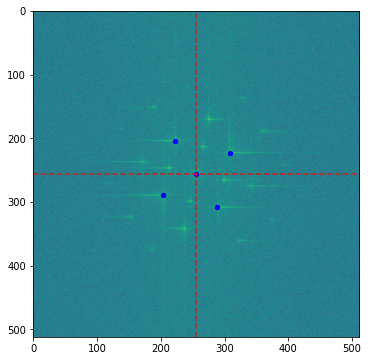

In [ ]:
angles,spacings = extract_lattice_params(imgdata[0], plot  = True)
angle = angles[0]
angle

* Choose start location for indexing (normally the center of the image)

In [ ]:
# find atom closest to center of image
startloc_ = int(round(imgdata[0].shape[0]/2)), int(round(imgdata[0].shape[1]/2))
atomdistances = np.zeros((atomcoords.shape[0]))
for ii in range(atomcoords.shape[0]):
  atomdistances[ii] = np.sqrt((atomcoords[ii,0] - startloc_[0])**2 + (atomcoords[ii,1] - startloc_[1])**2)
startloc_center = atomcoords[np.nanargmin(atomdistances)][1], atomcoords[np.nanargmin(atomdistances)][0]

### Optional ###
#  we may select other areas in the image, e.g., upper right or lower right

# find atom in upper right quadrant (as an example)
startloc_ = int(round(1*imgdata[0].shape[0]/4)), int(round(3*imgdata[0].shape[1]/4))
atomdistances = np.zeros((atomcoords.shape[0]))
for ii in range(atomcoords.shape[0]):
  atomdistances[ii] = np.sqrt((atomcoords[ii,0] - startloc_[0])**2 + (atomcoords[ii,1] - startloc_[1])**2)
startloc_upperright = atomcoords[np.nanargmin(atomdistances)][1], atomcoords[np.nanargmin(atomdistances)][0]

# find atom in lower right quadrant (as an example)
startloc_ = int(round(3*imgdata[0].shape[0]/4)), int(round(3*imgdata[0].shape[1]/4))
atomdistances = np.zeros((atomcoords.shape[0]))
for ii in range(atomcoords.shape[0]):
  atomdistances[ii] = np.sqrt((atomcoords[ii,0] - startloc_[0])**2 + (atomcoords[ii,1] - startloc_[1])**2)
startloc_lowerright = atomcoords[np.nanargmin(atomdistances)][1], atomcoords[np.nanargmin(atomdistances)][0]

startloc_center, startloc_upperright, startloc_lowerright

((252.93337560256663, 255.53992613676547),
 (379.56985567005603, 128.0232925950267),
 (383.30388648659766, 380.4679503196206))

* Choose starting location (default is center of image)

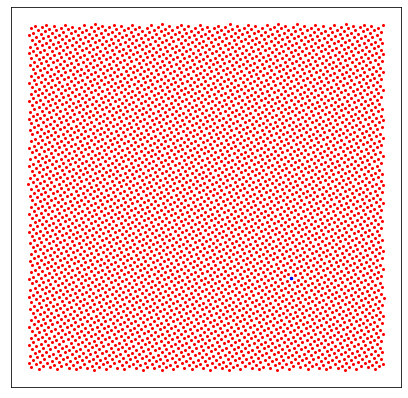

In [ ]:
# choose one of these examples for start location

# startloc = startloc_center
# startloc = startloc_upperright
startloc = startloc_lowerright

iters = 140  # Must be multiple of 4
imgsize = 512
nnd_aver = 7.724905013805765

idealcoordinates = generate_ideal_lattice_square(startloc, angle, nnd_aver, offset=10, 
                                                 iters = iters, imgsize = imgsize,
                                                 plot = True, axisdisplay = False)

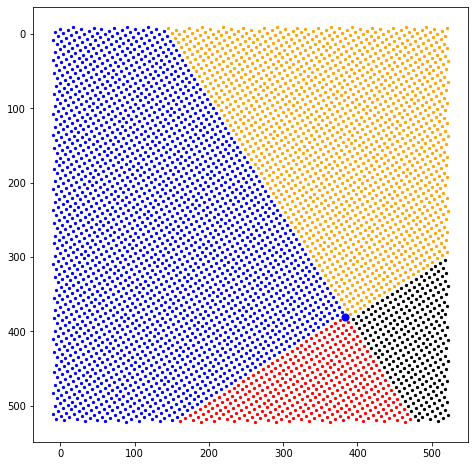

In [ ]:
#####################
### Quadrant view ###
#####################

plt.figure(figsize=(8,8))
plt.imshow(imgdata[0],alpha=0.01)
plt.scatter(idealcoordinates[:int(iters/2),:int(iters/2),0], idealcoordinates[:int(iters/2),:int(iters/2),1], c='r', s=5)
plt.scatter(idealcoordinates[int(iters/2):,:int(iters/2),0], idealcoordinates[int(iters/2):,:int(iters/2),1], c='b', s=5)
plt.scatter(idealcoordinates[:int(iters/2),int(iters/2):,0], idealcoordinates[:int(iters/2),int(iters/2):,1], c='orange', s=5)
plt.scatter(idealcoordinates[int(iters/2):,int(iters/2):,0], idealcoordinates[int(iters/2):,int(iters/2):,1], c='k', s=5)
plt.scatter(startloc[0], startloc[1], c='b', s=50)
# plt.gca().invert_yaxis()

Check overlay on image and overlay on ideal coordinates

[]

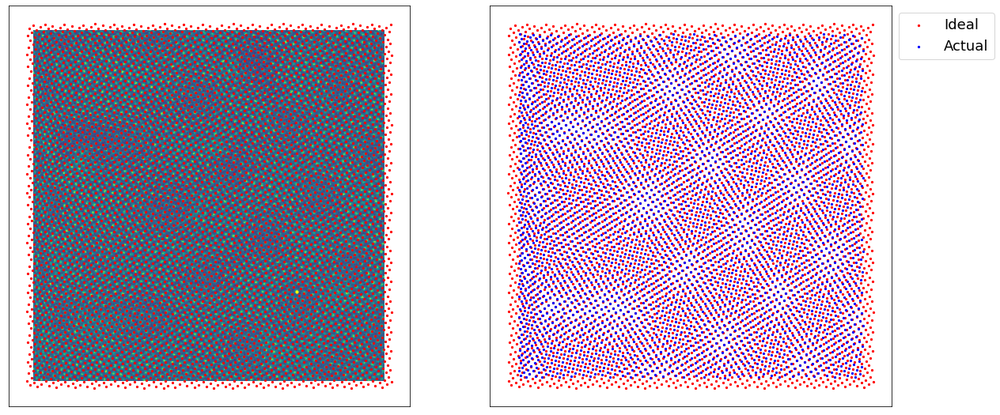

In [ ]:
f,ax= plt.subplots(1,2,figsize=(20,10))
ax[0].imshow(imgdata[0])
ax[0].scatter(idealcoordinates[:,:,0], idealcoordinates[:,:,1], c='r', s = 5)
ax[0].scatter(startloc[0], startloc[1], c='yellow', s=10);

ax[1].imshow(imgdata[0], alpha = 0.01)
ax[1].scatter(idealcoordinates[:,:,0], idealcoordinates[:,:,1], c='r', s=5, label = 'Ideal')
ax[1].scatter(atomcoords[:,1], atomcoords[:,0], c = 'b', s = 5, label = 'Actual')
ax[1].legend(bbox_to_anchor=(1.0,1.0), fontsize = 18)

# Turn off X and Y axes:
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])

In [ ]:
for kk in range(coord_r_cor.shape[0]):
  for ii in range(coord_r_cor[kk].shape[0]):
    if coord_r_cor[kk][ii,0] == 0 and coord_r_cor[kk][ii,1] == 0:
      coord_r_cor[kk][ii] = np.nan, np.nan, np.nan

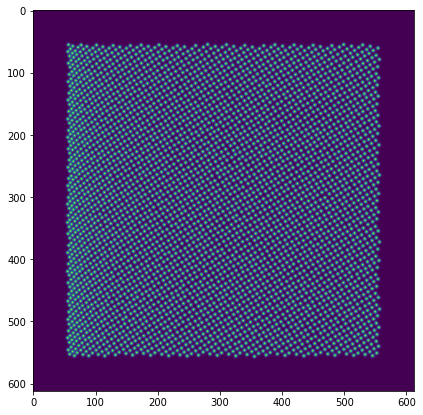

In [ ]:
# Take a few minutes to generate the distorted images
distorted_gaussians, distorted_gaussians_padded = generate_gaussian_image_padded(atomcoords)

### Index with LR start

In [ ]:
distorted_coords = index_atoms_NEW(distorted_gaussians_padded, idealcoordinates,
                                   startloc, nnd_aver, angle, thresholdangle = 40,
                                   windowsize = 30, padwidth = 50, gaussthresh = 0.3, thresh = 3,
                                   dfactor = 3, threshold42 = 3, gauss_size = 3, newpos_thresh = 7,
                                   newpos_close = 4, threshold43 = 2, newpos_thresh2 = 8)

# Ignore the RuntimeWarnings below
# Refer to the function definition for help on what these function variables mean and do

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:522: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:315: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:331: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:332: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:350: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:351: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1084: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/skimage/feature/blob.py:125: RuntimeWarning: invalid value encountered in doub

In [ ]:
# Find local minimum by varying alpha and delta parameters
# Our guess starts at (0,0) meaning no perturbations applied to the angle or lattice spacing 
# (we don't know which way (+ or -) they should go)

guess = (0,0)
optimized_params = minimize(minimize_distance, guess, args=(distorted_coords, idealcoordinates, startloc), method = 'nelder-mead')

[]

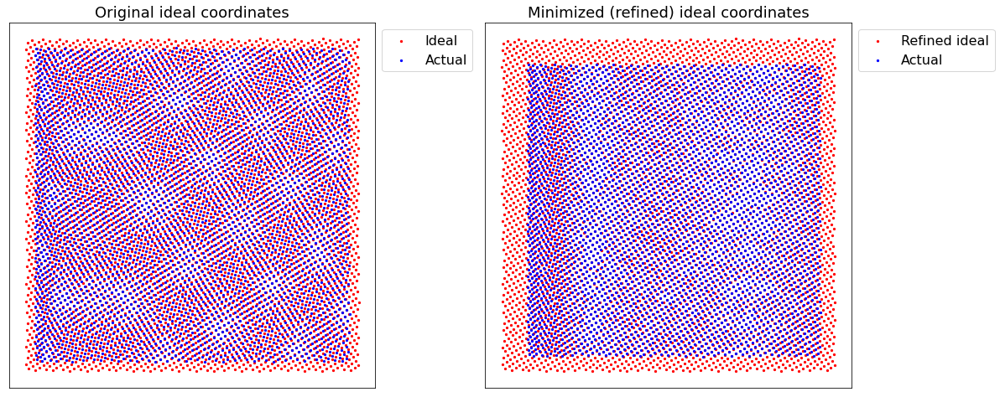

In [ ]:
bestfit_ideal = modify_lattice(startloc, idealcoordinates, optimized_params['x'][0], optimized_params['x'][1])

plt.figure(figsize=(18,9))
gs = gridspec.GridSpec(1,2, wspace = 0.3)
ax1 = plt.subplot(gs[0])
ax2 = plt.subplot(gs[1])

ax1.imshow(imgdata[0], alpha= 0.01)
ax1.scatter(idealcoordinates[:,:,0], idealcoordinates[:,:,1],c='r',s=5, label = 'Ideal')
ax1.scatter(atomcoords[:,1], atomcoords[:,0], c = 'b', s = 5, label='Actual')
ax1.legend(bbox_to_anchor=(1.0,1.0), fontsize = 16)

ax2.imshow(imgdata[0], alpha= 0.01)
ax2.scatter(bestfit_ideal[:,:,0], bestfit_ideal[:,:,1],c='r',s=5, label='Refined ideal')
ax2.scatter(atomcoords[:,1], atomcoords[:,0], c = 'b', s = 5, label='Actual')
ax2.legend(bbox_to_anchor=(1.0,1.0), fontsize = 16)

ax1.set_title('Original ideal coordinates', fontsize = 18)
ax2.set_title('Minimized (refined) ideal coordinates', fontsize = 18);

plt.setp([ax1,ax2], xticks=[], yticks=[])

* Do a quick view of the displacement map (interpolation done here)

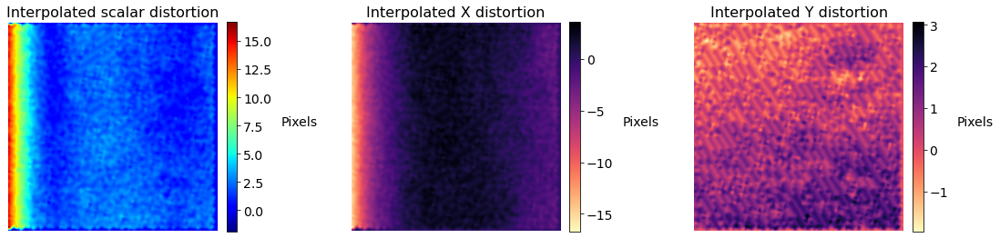

In [ ]:
colormap = 'magma'
units = 'pixel'  # or lattice

scalardistortion_f0, xdistortion_f0, ydistortion_f0 = displacement_interp(imgdata[0],
                                                                          distorted_coords, 
                                                                          bestfit_ideal, 
                                                                          nnd_aver,
                                                                          optimized_params, 
                                                                          units = units,
                                                                          colormap = colormap);

In [ ]:
## Train GP, and get corrected image from that

### GP regression

In [ ]:
# # Calculate the difference

# distortion_array = np.zeros((idealcoordinates.shape[0], idealcoordinates.shape[1], idealcoordinates.shape[2]))

distortion_array = bestfit_ideal - distorted_coords
scalefactor = (nnd_aver)*(1+optimized_params['x'][1])  # The new lattice constant. Recall that index [1] in opt param all is the length param, while [0] is the angle


# Reshape

distortedcoords = np.reshape(distorted_coords,     (distorted_coords.shape[0]*distorted_coords.shape[1],distorted_coords.shape[2]))
distortion = np.reshape(distortion_array, (distortion_array.shape[0]*distortion_array.shape[1],distortion_array.shape[2]))

# # remove nans (see which has more nan in it and remove the larger from both)

distortedcoords = distortedcoords[~np.isnan(distortion)]
distortion = distortion[~np.isnan(distortion)]

# # Reshape back
distortedcoords = np.reshape(distortedcoords, (int(distortedcoords.shape[0]/2),2))
distortion = np.reshape(distortion, (int(distortion.shape[0]/2),2))

In [ ]:
atoms_xy = distortedcoords
delta_xy = distortion
delta_xy_scaled = distortion/scalefactor   # in terms of lattice constants...

In [ ]:
# Define GPP inputs and outputs

X = atoms_xy
y1 = delta_xy_scaled[:,0]
y2 = delta_xy_scaled[:,1]

# Normalize

y1 = (y1 - np.min(y1))/np.ptp(y1)
y2 = (y2 - np.min(y2))/np.ptp(y2)

 <font color = 'crimson'>**Warning**</font>! 
**This cell can may take a long time (~hours) if # epochs on the order of 500**

(Also depends on number of atom columns)

In [ ]:
# Final cell
%%time
epochs = 150 # ~5 epochs for testing'  Currently takes 50 minutes to run (150 epochs, 25 frames, short flyback dataset)


model1, mean1, sd1, loss1 = GP_Regressor_showloss(X, y1, epochs = epochs)
model2, mean2, sd2, loss2 = GP_Regressor_showloss(X, y2, epochs = epochs)

Iteration 150 / 150CPU times: user 51 s, sys: 1.59 s, total: 52.6 s
Wall time: 52.7 s


Fix the scaling

In [ ]:

# Normalize [0,1]
mean1 = (mean1 - np.min(mean1)) / (np.ptp(mean1))
mean2 = (mean2 - np.min(mean2)) / (np.ptp(mean2))
# convert back to appropriate scale as determined by the actual data points 
# (we really only care about the uncertainty values which do not require any normalization processes)
mean1 = mean1*np.ptp(delta_xy_scaled[:,0]) + np.min(delta_xy_scaled[:,0])
mean2 = mean2*np.ptp(delta_xy_scaled[:,1]) + np.min(delta_xy_scaled[:,1])

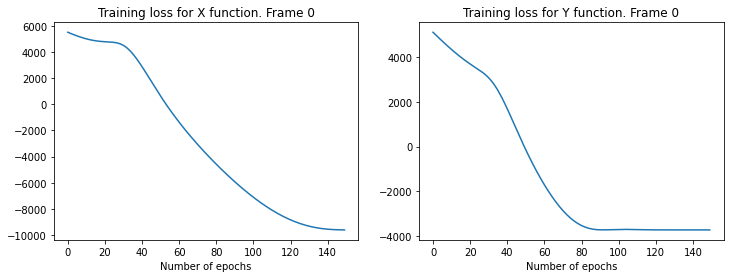

In [ ]:
# Loss inspection

ii = 0 # Frame number

f,ax=plt.subplots(1,2,figsize=(12,4))
ax[0].plot(loss1)
ax[1].plot(loss2)
ax[0].set_title('Training loss for X function. Frame {}'.format(ii))
ax[1].set_title('Training loss for Y function. Frame {}'.format(ii))
ax[0].set_xlabel('Number of epochs')
ax[1].set_xlabel('Number of epochs');

Check the trained model on "itself" with some interpolation between points

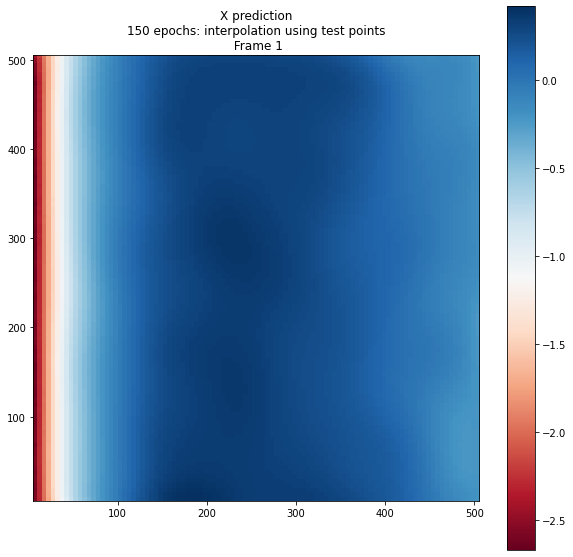

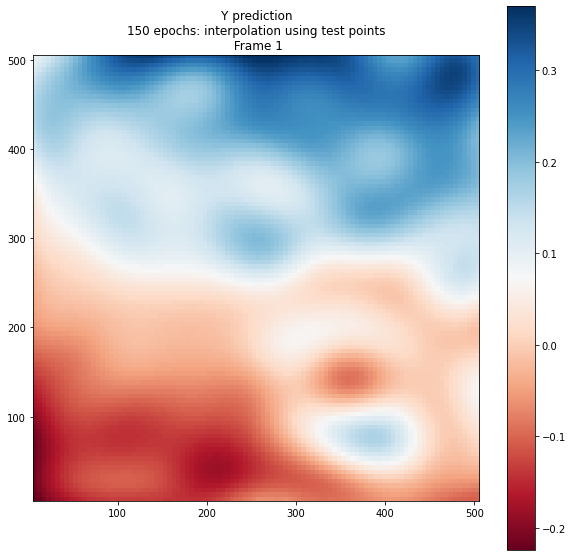

In [ ]:
ii = 0
xy_test = atoms_xy

contour_plot2(xy_test[:, 1], xy_test[:, 0],
             mean1, npoints=100,
             figtitle='X prediction\n{} epochs: interpolation using test points\n Frame {}'.format(epochs, ii+1)
             );
contour_plot2(xy_test[:, 1], xy_test[:, 0],
             mean2, npoints=100,
             figtitle='Y prediction\n{} epochs: interpolation using test points\n Frame {}'.format(epochs, ii+1)
             );

In [ ]:
## Partialframe GP reconstruction

In [ ]:
numpix = 256
imgsize = 512

X_dense, Y_dense = np.meshgrid(np.linspace(0,imgsize,numpix), np.linspace(0,imgsize,numpix))

densecoords_ = np.vstack([X_dense.ravel(), Y_dense.ravel()])
densecoords = np.swapaxes(densecoords_, 0, 1)

In [ ]:
GP_x_ =     np.zeros((numpix*numpix))
GP_x_unc_ = np.zeros((numpix*numpix))
GP_y_ =     np.zeros((numpix*numpix))
GP_y_unc_ = np.zeros((numpix*numpix))

GP_x =     np.zeros((numpix,numpix))
GP_x_unc = np.zeros((numpix,numpix))
GP_y =     np.zeros((numpix,numpix))
GP_y_unc = np.zeros((numpix,numpix))


GP_x_, GP_x_unc_ = UseTrainedGP(densecoords, model1)
GP_y_, GP_y_unc_ = UseTrainedGP(densecoords, model2)

In [ ]:

GP_x     = np.reshape(GP_x_, (numpix,numpix))
GP_x_unc = np.reshape(GP_x_unc_, (numpix,numpix))
GP_y     = np.reshape(GP_y_, (numpix,numpix))
GP_y_unc = np.reshape(GP_y_unc_, (numpix,numpix))

In [ ]:
# Scaling step

# Normalize [0,1]

GP_x = (GP_x - np.min(GP_x )) / (np.ptp(GP_x))
GP_y  = (GP_y - np.min(GP_y)) / (np.ptp(GP_y))
# convert back to appropriate scale as determined by the actual data points 
# (we really only care about the uncertainty values which do not require any normalization processes)

GP_x = GP_x*np.ptp(delta_xy_scaled[:,0]) + np.min(delta_xy_scaled[:,0])
GP_y = GP_y*np.ptp(delta_xy_scaled[:,1]) + np.min(delta_xy_scaled[:,1])

X Distortion for all frames

(-0.5, 255.5, 255.5, -0.5)

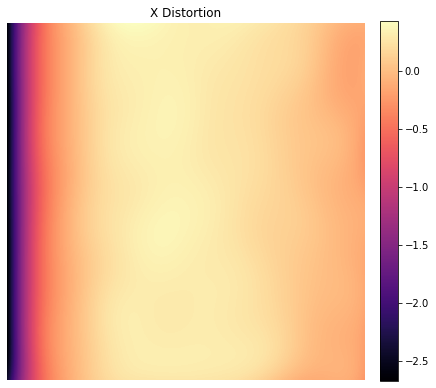

In [ ]:
colormap = 'magma'

_,ax = plt.subplots(1,figsize=(7,7))

im = ax.imshow(GP_x, cmap = colormap)
plt.colorbar(im, ax=ax, fraction = 0.046, pad = 0.04)
ax.set_title('X Distortion')
ax.axis('off')

(-0.5, 255.5, 255.5, -0.5)

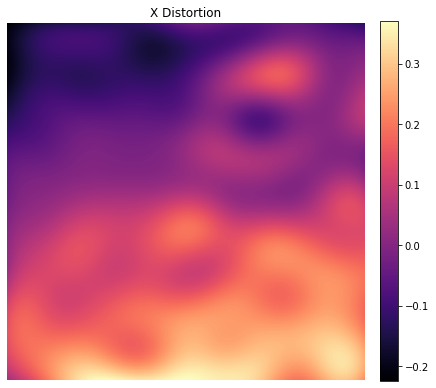

In [ ]:
colormap = 'magma'

_,ax = plt.subplots(1,figsize=(7,7))

im = ax.imshow(GP_y, cmap = colormap)
plt.colorbar(im, ax=ax, fraction = 0.046, pad = 0.04)
ax.set_title('X Distortion')
ax.axis('off')

* In case flyback is very strong, it may be hard to see other distortions
* Adjust vmin and vmax to saturate the flyback and make clear others
  * This can be done with the $percent$ parameter below in a somewhat more reasonable manner

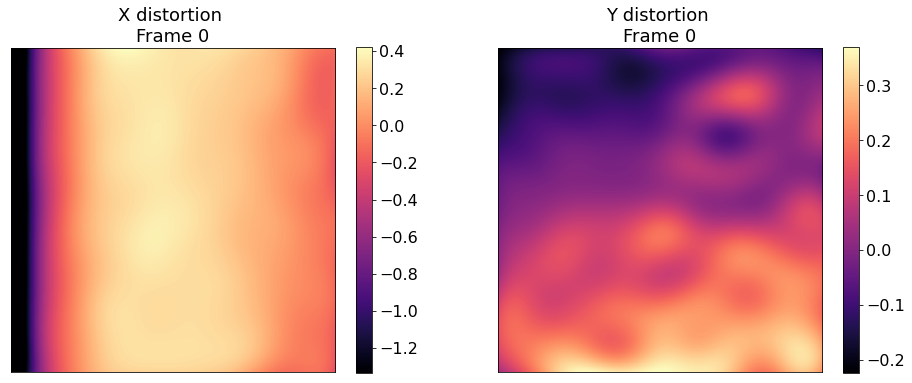

In [ ]:
ii = 0 # frame select

percent = 0.5
colormap = 'magma'

f,ax = plt.subplots(1,2,figsize=(16,6))
im0 = ax[0].imshow(GP_x, cmap = colormap, vmin = percent*GP_x.min())
im1 = ax[1].imshow(GP_y, cmap = colormap)
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])
cbar0 = plt.colorbar(im0, ax=ax[0])
cbar0.ax.tick_params(labelsize=16)
cbar1 = plt.colorbar(im1, ax=ax[1])
cbar1.ax.tick_params(labelsize=16)
ax[0].set_title('X distortion \nFrame {}'.format(ii), fontsize = 18)
ax[1].set_title('Y distortion \nFrame {}'.format(ii), fontsize = 18);

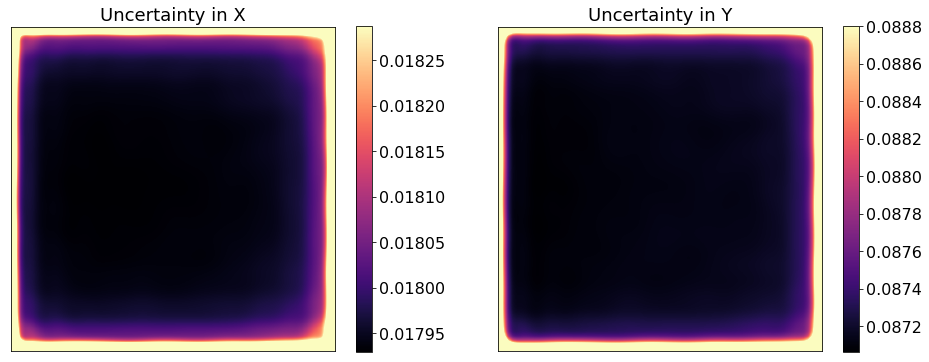

In [ ]:
ii = 0

percent = 1.02

colormap = 'magma'
f,ax = plt.subplots(1,2,figsize=(16,6))
im0 = ax[0].imshow(GP_x_unc, cmap = colormap, vmax = percent*GP_x_unc.min())
im1 = ax[1].imshow(GP_y_unc, cmap = colormap, vmax = percent*GP_y_unc.min())
plt.setp([ax[0],ax[1]], xticks=[], yticks=[])
cbar0 = plt.colorbar(im0, ax=ax[0])
cbar0.ax.tick_params(labelsize=16)
cbar1 = plt.colorbar(im1, ax=ax[1])
cbar1.ax.tick_params(labelsize=16)
ax[0].set_title('Uncertainty in X', fontsize = 18)
ax[1].set_title('Uncertainty in Y', fontsize = 18);

## Correct the LR indexed

In [ ]:
img2coords_undistorted_LR, img2coords_distorted_LR, corrected_image_LR = undistort(imgdata[ii], GP_x, GP_y, scalefactor)

[]

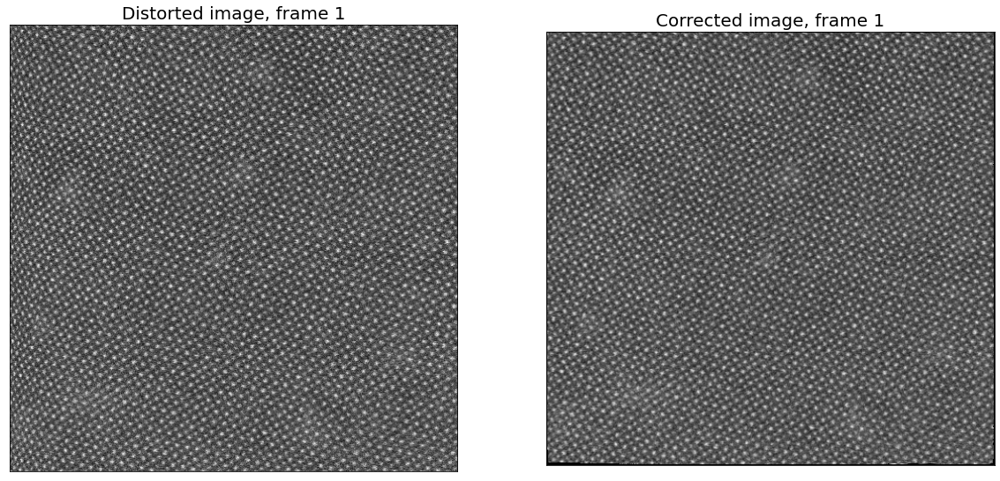

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(20,10))
colormap = 'gray'
ax[0].imshow(imgdata[0], cmap = colormap)
ax[1].imshow(corrected_image_LR, cmap = colormap, vmin = np.min(imgdata[0]), vmax = np.max(imgdata[0]))

ax[0].set_title("Distorted image, frame {}".format(0+1), fontsize=20)
ax[1].set_title("Corrected image, frame {}".format(0+1), fontsize=20)

plt.setp([ax[0],ax[1]],xticks=[], yticks=[])

It is instructive to show the DISTORTED image with apparent and actual beam positions

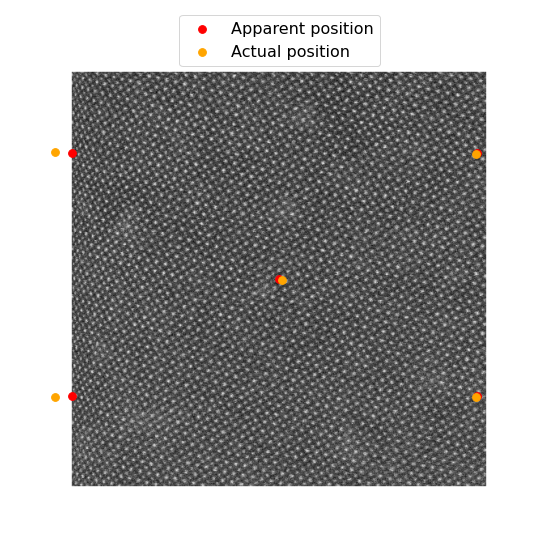

In [ ]:
# select various coordinate pairs for view, packaged in m and n

m, n = [0, 0, 256, 500, 500], [100, 400, 256, 100, 400]

fig,ax = plt.subplots(1,1,figsize=(10,10))
pad = 80
ax.imshow(np.pad(imgdata[0], pad, mode = 'constant', constant_values = 1), alpha = 1, cmap = 'gray')
# ax.scatter(img2coords_distorted[:,:,0]+pad, img2coords_undistorted[:,:,1]+pad, c=img2coords_undistorted[:,:,2], s=1, cmap = 'gray')

ax.scatter(img2coords_distorted_LR[m,n,0]+pad, img2coords_distorted_LR[m,n,1]+pad, c='r', facecolors = 'none', s = 60, label = 'Apparent position')
ax.scatter(img2coords_undistorted_LR[m,n,0]+pad, img2coords_undistorted_LR[m,n,1]+pad, c='orange', s = 60, label = 'Actual position')
ax.legend(bbox_to_anchor = (0.7,1), fontsize=16)
ax.axis('off')
plt.setp([ax],xticks=[], yticks=[]);

In [ ]:
import warnings
warnings.filterwarnings("ignore")   # suppresses warnings arising from indexing

/usr/local/lib/python3.7/dist-packages/atomai/atomnet/infer.py:163: UserWarning: The default output of predictor.decode() and predictor.run() is now ```nn_output, coords``` instead of ```nn_input, (nn_output, coords)```
  warnings.warn(warn_msg, UserWarning)


Batch 1/1
1 image was decoded in approximately 0.054 seconds
Batch 1/1
Refining atomic positions... Done

1 image was decoded in approximately 20.7979 seconds


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:635: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:522: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:469: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:315: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:331: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:332: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:350: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:351: RuntimeWarning: invalid value encountered in double_sc

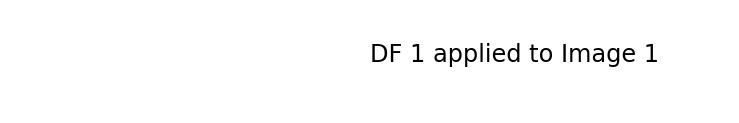

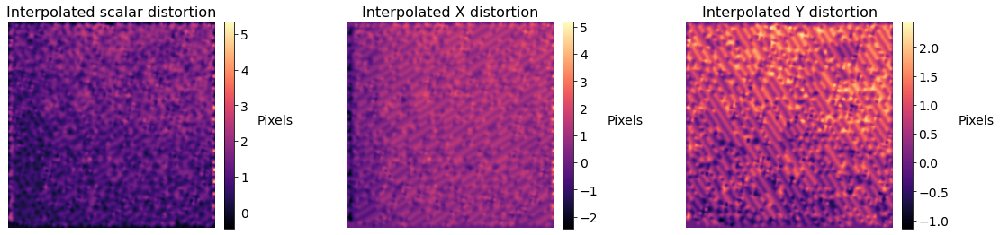

In [ ]:
# Select image frame number (f), and distortion frame (d)
colormap = 'magma'
f, d = 0, 0   

plt.figure(figsize=(13,2))
plt.text(0.5,0.5, "DF {} applied to Image {}".format(d+1, f+1), fontsize = 24)
plt.axis('off')
xydist_f0d0_LR, xdist_f0d0_LR, ydist_f0d0_LR = analyze_correction(imgdata[0], GP_x, 
                                                            GP_y, scalefactor, 
                                                            pixthresh = 1, intensitythresh = 0.2,
                                                            colormap = colormap)

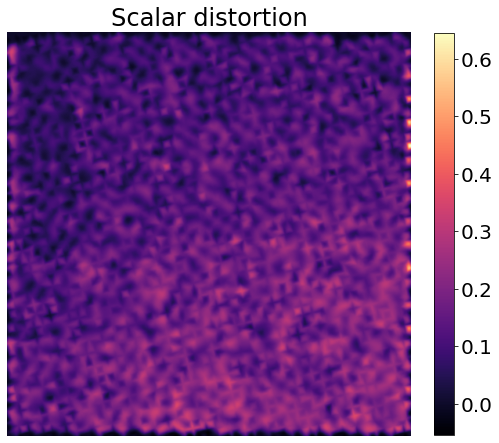

In [ ]:
pixels = False
colormap = 'magma'

_,ax = plt.subplots(1,figsize=(8,8))
if pixels:
  im = ax.imshow(xydist_f0d0_LR, cmap = colormap, origin = 'lower')
else:
  im = ax.imshow(xydist_f0d0_LR/scalefactor, cmap = colormap, origin = 'lower')

cbar = plt.colorbar(im, ax=ax, fraction = 0.045)
plt.axis('off')
cbar.ax.tick_params(labelsize=20) 

ax.set_title("Scalar distortion", fontsize = 24);

((-0.5, 515.5, -0.5, 515.5), (-0.5, 515.5, -0.5, 515.5))

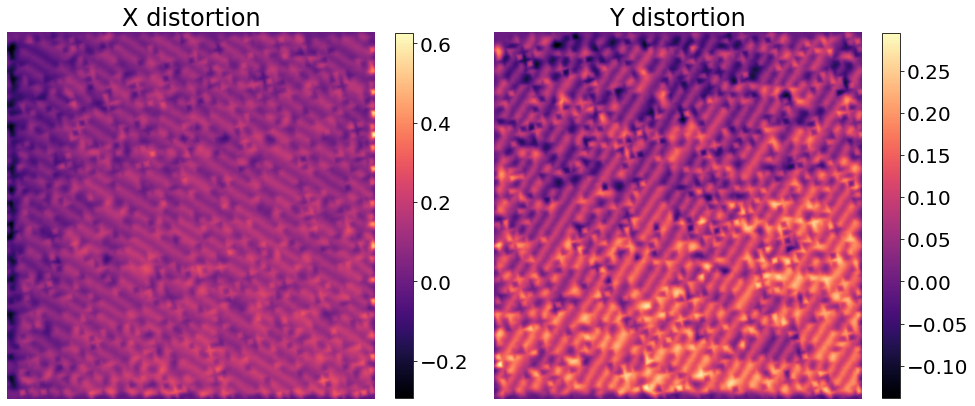

In [ ]:
colormap = 'magma'

_,ax = plt.subplots(1,2,figsize=(16,8))

im0 = ax[0].imshow(xdist_f0d0_LR/scalefactor, cmap = colormap, origin = 'lower')
im1 = ax[1].imshow(ydist_f0d0_LR/scalefactor, cmap = colormap, origin = 'lower')

cbar0 = plt.colorbar(im0, ax=ax[0], fraction = 0.045)
cbar1 = plt.colorbar(im1, ax=ax[1], fraction = 0.045)

# plt.axis('off')
cbar0.ax.tick_params(labelsize=20) 
cbar1.ax.tick_params(labelsize=20) 


ax[0].set_title("X distortion", fontsize = 24);
ax[1].set_title("Y distortion", fontsize = 24);

ax[0].axis('off'), ax[1].axis('off')

## (extra) Compare start location corrected image (OLD)

In [ ]:
# Can anything be seen from image overlay?

plt.figure(figsize=(8,8))
plt.imshow(corrected_image_f0_center, alpha = 0.5)
plt.imshow(corrected_image_f0_LR, alpha = 0.5)

NameError: ignored

<Figure size 576x576 with 0 Axes>

In [ ]:
corrected_image_f0_center.shape, corrected_image_f0_LR.shape

((512, 530), (516, 532))

compare atom positions (atom finder)

In [ ]:
corrected_image_center = np.reshape(corrected_image_f0_center, (1, corrected_image_f0_center.shape[0], corrected_image_f0_center.shape[1]))
corrected_image_LR = np.reshape(corrected_image_f0_LR, (1, corrected_image_f0_LR.shape[0], corrected_image_f0_LR.shape[1]))

# load a pre-trained network; select symmetry
model = dcnn.load_torchmodel('cubic')

##############
### Center ###
##############
# Make a prediction without refinement
nn_input, (img_dec_center, coord_center) = aoi.atomnet.predictor(
    corrected_image_center, model, refine=False, logits=False, use_gpu=True).run()

# # Make a prediction with refinement. Use ‘d’ argument to define a half-size of a window
# # around each predicted coordinate where refinement is performed (it defaults to 1/3 of NN distance when not specified)
nn_input, (img_dec_center, coord_center_r) = aoi.atomnet.predictor(
    corrected_image_center, model, refine=True, d=4, logits=False, use_gpu=True).run()

###################
### Lower right ###
###################
# Make a prediction without refinement
nn_input, (img_dec_LR, coord_LR) = aoi.atomnet.predictor(
    corrected_image_LR, model, refine=False, logits=False, use_gpu=True).run()

# # Make a prediction with refinement. Use ‘d’ argument to define a half-size of a window
# # around each predicted coordinate where refinement is performed (it defaults to 1/3 of NN distance when not specified)
nn_input, (img_dec_LR, coord_LR_r) = aoi.atomnet.predictor(
    corrected_image_LR, model, refine=True, d=4, logits=False, use_gpu=True).run()

/usr/local/lib/python3.6/dist-packages/atomai/atomnet.py:443: UserWarning: The output of predictor.run() has changed from 'nn_input, nn_output' to 'nn_input, (nn_output, coordinates)'. Example: 'nn_input, (nn_output, coordinates) = predictor(args).run()'
  warnings.warn(warn_msg, UserWarning)


1 image was decoded in approximately 0.0511 seconds
1 image was decoded in approximately 0.0479 seconds
Refining atomic positions... Done
1 image was decoded in approximately 0.0493 seconds
1 image was decoded in approximately 0.0498 seconds
Refining atomic positions... Done


In [ ]:
pixthresh = 1  # if all atoms are well-resolved, keep this value higher (~5 seems good) so numreverts is zero.
                 # if some atoms are questionable due to few number of pixels/noise/etc., keep this value ~1

coordlist_center = []
coordlist_LR = []

for ii in range(len(coord_center_r)):
  coordlist_center.append(coord_center[ii].shape[0])

for ii in range(len(coord_LR_r)):
  coordlist_LR.append(coord_LR[ii].shape[0])
  
coordshape_center0 = np.max(coordlist_center)
coordshape_LR0 = np.max(coordlist_LR)

coord_center_r_cor = np.zeros((len(coord_center_r), coordshape_center0, coord_center_r[0].shape[1]))
coord_LR_r_cor = np.zeros((len(coord_LR_r), coordshape_LR0, coord_LR_r[0].shape[1]))

numreverts_center = np.zeros((len(coord_center_r)))
numreverts_LR = np.zeros((len(coord_LR_r)))

for kk in range(len(coord_center_r)):
  for ii in range(coordlist_center[kk]):
    if np.sqrt((coord_center[kk][ii, 0] - coord_center_r[kk][ii, 0])**2 + (coord_center[kk][ii, 1] - coord_center_r[kk][ii, 1])**2) > pixthresh:
      coord_center_r_cor[kk][ii] = coord_center[kk][ii]
      numreverts_center[kk] += 1
    else:
      coord_center_r_cor[kk][ii] = coord_center_r[kk][ii]

for kk in range(len(coord_LR_r)):
  for ii in range(coordlist_LR[kk]):
    if np.sqrt((coord_LR[kk][ii, 0] - coord_LR_r[kk][ii, 0])**2 + (coord_LR[kk][ii, 1] - coord_LR_r[kk][ii, 1])**2) > pixthresh:
      coord_LR_r_cor[kk][ii] = coord_LR[kk][ii]
      numreverts_LR[kk] += 1
    else:
      coord_LR_r_cor[kk][ii] = coord_LR_r[kk][ii]

# set extra array elements that are by default (0,0) instead to (NaN, NaN)
for kk in range(coord_center_r_cor.shape[0]):
  for ii in range(coord_center_r_cor[kk].shape[0]):
    if coord_center_r_cor[kk][ii,0] == 0 and coord_center_r_cor[kk][ii,1] == 0:
      coord_center_r_cor[kk][ii] = np.nan, np.nan, np.nan

for kk in range(coord_LR_r_cor.shape[0]):
  for ii in range(coord_LR_r_cor[kk].shape[0]):
    if coord_LR_r_cor[kk][ii,0] == 0 and coord_LR_r_cor[kk][ii,1] == 0:
      coord_LR_r_cor[kk][ii] = np.nan, np.nan, np.nan

With some **scaling** and **shifting**, the two lattices line up well

* Does it suggest a non-unique solution to the distortion then?

* The different scale exists because the ideal lattice determined from different locations may have different lattice spacing in the local environment of where the referencing began (start location)

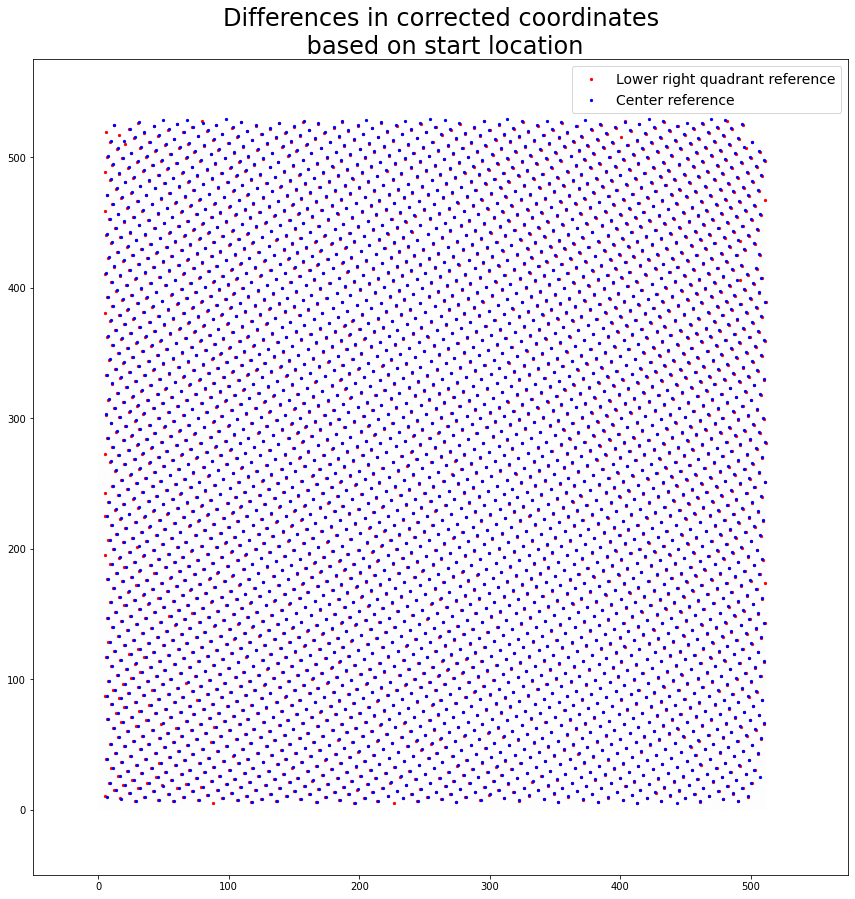

In [ ]:
offsetx = 1
offsety = 0
scalex = 1.005
scaley = 1.005

plt.figure(figsize=(15,15))
plt.imshow(imgdata[0], alpha = 0.01)
plt.scatter(coord_LR_r_cor[:,:,0], coord_LR_r_cor[:,:,1], c='r', s=5, label = 'Lower right quadrant reference')
plt.scatter((coord_center_r_cor[:,:,0]+offsetx)*scalex, (coord_center_r_cor[:,:,1]+offsety)*scaley, c='b', s=5, label = 'Center reference')
plt.xlim(-50, 575)
plt.ylim(-50, 575)
plt.legend(loc = 'upper right', fontsize = 14)

plt.title("Differences in corrected coordinates\n based on start location", fontsize = 24);

In [ ]:
# Measure the displacement between the two, much like was done for ideal vs actual. 
# Now just actual_1 vs actual_2
offsetx = 1
offsety = 0
scalex = 1.005
scaley = 1.005

coord_center_r_cor2 = np.zeros((coord_center_r_cor.shape[0], coord_center_r_cor.shape[1], coord_center_r_cor.shape[2]))
coord_center_r_cor2[:,:,0] = (coord_center_r_cor[:,:,0]+offsetx)*scalex
coord_center_r_cor2[:,:,1] = (coord_center_r_cor[:,:,1]+offsety)*scaley